<a href="https://colab.research.google.com/github/inkatown/Computer-Vision/blob/main/ClusteringHuacosUsingTwoTechniques.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



```
# This is formatted as code
```

# **Image preprocessing**
**Image clustering** 

**Face Clustering** Here we are using two techniques. One of them using GPU, the other using pure cv2

# **Installing necessary dependencies**


In [ ]:
# OpenCV
#!apt-get -qq install -y libsm6 libxext6 && pip install -q -U opencv-python



# **Python Code using Opencv and matplotlib libraries **

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab import drive

# Accessing My Google Drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
# defining global variable path
# Location of my dataset on My Google Drive
image_path = "drive/My Drive/huacos/validimages"
import tensorflow as tf

def loadImages(path):
    '''Put files into lists and return them as one list with all images 
     in the folder'''
    image_files = sorted([os.path.join(path, 'sifaces', file)
                          for file in os.listdir(path + "/sifaces")
                          if file.endswith('.jpg')])
    return image_files



# **Displaying Images**

In [ ]:
# Display two images
def display(a, b, title1 = "Original", title2 = "Edited"):
    plt.subplot(121), plt.imshow(a), plt.title(title1)
    plt.xticks([]), plt.yticks([])
    plt.subplot(122), plt.imshow(b), plt.title(title2)
    plt.xticks([]), plt.yticks([])
    plt.show()

# Display one image
def display_one(a, title1 = "Original"):
    plt.imshow(a), plt.title(title1)
    plt.show()



# Initialize the folders and model files

In [ ]:
# USAGE
# python extract_embeddings.py --dataset dataset --embeddings output/embeddings.pickle \
#	--detector face_detection_model --embedding-model openface_nn4.small2.v1.t7

# import the necessary packages
from imutils import paths
import argparse
import imutils
import pickle

# construct the argument parser and parse the arguments
dataset = "drive/My Drive/huacos/MarioFloresHoy"
dataset1 = "drive/My Drive/huacos/validimages/sifaces"
dataset2 = "drive/My Drive/huacos/dataset"

embeddings = "drive/My Drive/huacos/output/embeddings.pickle"
embeddings1 = "drive/My Drive/huacos/output/embeddings.pickle1"
detector = "drive/My Drive/huacos/face_detection_model"
embeddingmodel = "drive/My Drive/huacos/openface_nn4.small2.v1.t7"
confidence = 0.5

In [ ]:



# load our serialized face detector from disk
print("[INFO] loading face detector...")
protoPath = os.path.sep.join([detector, "deploy.prototxt"])
modelPath = os.path.sep.join([detector,
	"res10_300x300_ssd_iter_140000.caffemodel"])
detector = cv2.dnn.readNetFromCaffe(protoPath, modelPath)

# load our serialized face embedding model from disk
print("[INFO] loading face recognizer...")
embedder = cv2.dnn.readNetFromTorch(embeddingmodel)

# grab the paths to the input images in our dataset
print("[INFO] quantifying faces...")
imagePaths = list(paths.list_images(dataset1))





[INFO] loading face detector...
[INFO] loading face recognizer...
[INFO] quantifying faces...


# Clustering images:
* Read image
* Resize image 
* Remove noise(Denoise)
* Segmentation
* Morphology(smoothing edges)

# Image clustering using cv2 only

[INFO] processing image 1/310
0.28354394
[INFO] processing image 2/310
0.98515296


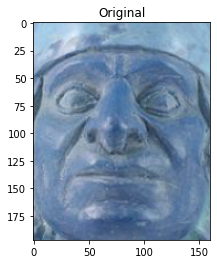

197 160
(226, 175, 386, 372)
226 isss [ 3.96909490e-02  1.15083240e-01  1.78730533e-01 -6.17200285e-02
  2.14687288e-02  9.24869906e-04 -4.65691555e-03 -5.92980720e-02
 -5.79598323e-02 -5.52961007e-02  1.99314468e-02 -7.14275762e-02
 -7.40524381e-02  1.10140584e-01  1.23457640e-01  4.82956134e-03
 -1.25021851e-02 -1.09992415e-01  8.33870769e-02 -8.16282257e-02
  7.52721578e-02  2.17883945e-01 -1.13840871e-01 -2.92131747e-03
  8.15339535e-02  2.15220340e-02 -1.14433728e-02  9.80927274e-02
  1.57407627e-01  1.13601446e-01 -7.79842064e-02 -1.80901751e-01
 -3.55825499e-02 -5.82813136e-02  7.86525160e-02  6.10063411e-02
  4.27095183e-05 -8.24362412e-02  7.07160756e-02  7.04034343e-02
 -7.82196075e-02  8.50418136e-02  2.78906571e-03 -4.35649864e-02
  8.47549066e-02  2.84124702e-01  2.86999363e-02 -7.85624906e-02
 -6.97602704e-02 -9.72555727e-02  1.70075614e-02  2.14132443e-01
 -2.42015328e-02  8.31105746e-03  6.01421595e-02 -9.82346362e-04
 -1.44336587e-02  3.38961259e-02 -8.74002948e-02  1.

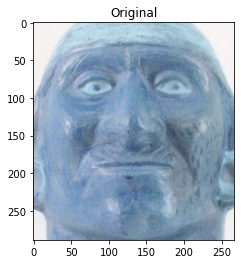

289 267
(160, 67, 427, 356)
160 isss [ 0.08602862  0.03400401  0.06419242 -0.06065522 -0.03868859 -0.06896497
  0.0082942  -0.04075889  0.03384779 -0.05292555  0.09137444 -0.1174043
  0.01707681  0.27627054  0.16609932 -0.09128463  0.13356657 -0.10022414
  0.06804284 -0.01015681 -0.05032396  0.17983903 -0.03819669 -0.05389116
 -0.030434   -0.01321086  0.0022497   0.12690274  0.07496215  0.05358876
 -0.04809612 -0.09557998  0.04182072 -0.07109644  0.04722305  0.13676766
  0.07356588  0.1113769   0.02011988  0.08824681 -0.11718435  0.17294915
 -0.15675159 -0.09618686  0.00422809  0.2534163  -0.11401935 -0.02053513
  0.06882589 -0.08720158 -0.08970077  0.2671018  -0.00494885  0.04726669
 -0.03299477 -0.03512703 -0.0158961   0.00354589 -0.07150838  0.12368063
 -0.02475682 -0.0305974  -0.03761161  0.01186117 -0.05658982 -0.05293421
  0.14951807  0.14131151  0.11193529  0.06442363  0.19012001 -0.04114868
  0.00896057 -0.09220176  0.05411131  0.05136686 -0.06857043 -0.01292638
  0.01070044 -0

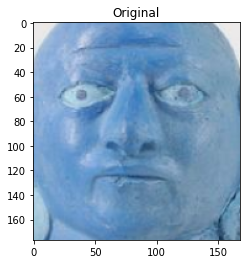

177 168
(212, 206, 380, 383)
212 isss [ 0.00309949  0.06903397  0.14573802 -0.10810684 -0.11679719  0.05657592
 -0.08004674  0.08652069 -0.00403824  0.02933896  0.07039091 -0.13547733
 -0.00671222  0.17952394  0.14744018 -0.02539173  0.04081175 -0.07506118
  0.08581118 -0.13107204  0.04002125  0.22338057 -0.08762423  0.06292111
 -0.01454343  0.02152647  0.10511406  0.08746148  0.09243096  0.03578812
 -0.05017807 -0.22960727 -0.00596513 -0.04052402  0.01210709  0.11199007
  0.0135517  -0.00129851 -0.01362507  0.19616385 -0.14872617  0.10026978
 -0.1325373  -0.04152583  0.11647277  0.11894799 -0.03131807 -0.06828031
 -0.00256428 -0.09101255  0.09582695  0.20726386 -0.04963824  0.04127105
 -0.0022605   0.06030028  0.03165416  0.0013248   0.03751564  0.0157125
  0.01598746 -0.05231035 -0.06176723  0.0250267  -0.06337302 -0.11570152
  0.1560867   0.09002543  0.14783747  0.15432328  0.1266865   0.01220367
 -0.01021347 -0.14543806  0.0799429   0.02922353 -0.12519477  0.12441879
  0.00133875  

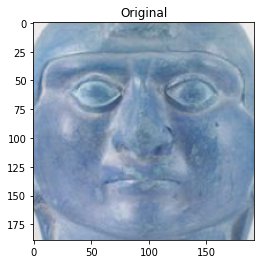

189 192
(196, 198, 388, 387)
196 isss [ 0.02248499  0.03507921  0.1758827  -0.15475261  0.0426054   0.09758388
  0.01710628  0.06478921 -0.08084613  0.01397495 -0.01220594 -0.02225252
 -0.00886695  0.15618175  0.16857482 -0.06479205 -0.02862338 -0.07911575
  0.08027959 -0.08871776  0.0580497   0.23069021 -0.07083245 -0.00086006
 -0.0192622   0.03338927  0.00499857  0.06983104  0.11316854  0.04831108
 -0.09990967 -0.20741685 -0.06418837 -0.04064443  0.05119802  0.08178087
 -0.01234    -0.00930438  0.01199749  0.12784481 -0.05603589  0.13788597
 -0.09433743 -0.07224987 -0.01958087  0.18539362 -0.02419914 -0.07389123
 -0.03974499 -0.06429933  0.0330191   0.16125272 -0.08989739  0.05916403
  0.05600321  0.02907239  0.02866407  0.07595126 -0.10884982  0.0908871
  0.05810747  0.00776103  0.00180013  0.02779284  0.03375497 -0.11316344
  0.08333019  0.13451292  0.11303372  0.15621969  0.16780092  0.11799968
 -0.00347962 -0.09671792  0.0494698   0.14197181 -0.12352895  0.05699055
  0.06513597 -

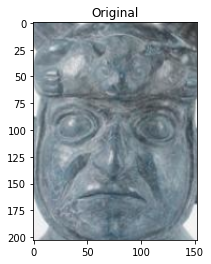

203 153
(217, 173, 370, 376)
217 isss [ 0.07723175  0.11221925  0.04221911 -0.04802922  0.01113736  0.06431646
  0.06096275 -0.09859545 -0.02300401  0.08378842  0.05513572 -0.0231285
 -0.04668262  0.09448978  0.08035652 -0.06921104  0.0872715   0.05046127
  0.13922103 -0.09680762 -0.0155628   0.20245166 -0.17255543  0.04289543
 -0.01726895  0.03575598  0.04161229  0.09309118  0.170646    0.18478873
 -0.1212084  -0.04338517 -0.03624688 -0.07304759  0.13252828  0.03687334
  0.02869063 -0.1201869   0.03820582 -0.0121429  -0.0900501   0.01668913
 -0.02968079  0.01349416  0.02293629  0.20860393 -0.00201993  0.04205029
 -0.07005234 -0.1275978   0.07951784  0.23996265 -0.00709504 -0.04400807
  0.0607506   0.06181685 -0.07426523  0.04358931 -0.10102972  0.11204424
  0.04899554 -0.04428139  0.08585867 -0.01901988  0.04035229 -0.08458938
  0.05939639 -0.04259291 -0.01864632  0.1421823   0.05436102 -0.0255904
 -0.04399057 -0.0942343  -0.06521098  0.02579438  0.02349097  0.08016456
  0.03578847 -0

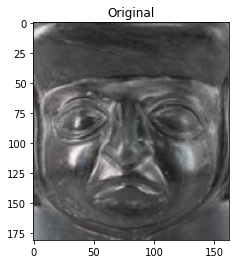

181 163
(220, 200, 383, 381)
220 isss [ 0.0090505   0.08187412  0.1366542  -0.02017925  0.02029691  0.27426797
 -0.00947443 -0.11467542 -0.01353359  0.00708882 -0.0310306   0.00035038
 -0.06106689 -0.01651861  0.21365738 -0.09547292 -0.14931218  0.09218755
  0.03237788 -0.12648962 -0.0404423   0.14999223  0.06409359  0.07791248
  0.04365765 -0.03840894 -0.04585205 -0.13095655  0.00824572  0.00479447
  0.05542528  0.02190745 -0.08323123 -0.02828954  0.12250492  0.05722144
 -0.03932584 -0.0372555   0.03447251  0.06961196  0.04787845 -0.03912725
 -0.17969377 -0.07331289 -0.16371052  0.04207981  0.01053834 -0.02098039
 -0.13177636 -0.03496994  0.06688812  0.01396104  0.11027309 -0.03410287
 -0.06199244  0.07413802  0.06164229  0.13709222 -0.0801177   0.02216242
 -0.07788186  0.10960489  0.08377674 -0.1644231   0.1311686   0.07055394
  0.10783038  0.01265946 -0.14036058  0.21227546  0.03044851  0.11938635
 -0.01748053 -0.01828028  0.03241803  0.00303    -0.16699156 -0.1489836
  0.03203572  

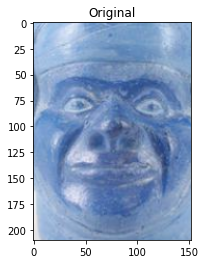

210 152
(223, 203, 375, 413)
223 isss [ 0.11595774  0.08012531  0.0936591  -0.13433537  0.03285393  0.11412306
  0.08807506 -0.0556984  -0.00577553  0.00350765  0.03931982 -0.03182082
  0.03729035  0.16107495  0.16172116 -0.10105217  0.02147121 -0.03306984
 -0.01313359 -0.13256827  0.01409125  0.20057936 -0.15939617 -0.01462478
  0.03375741  0.02384272 -0.006717    0.09728796  0.0748515   0.11889131
 -0.06731924 -0.02224004 -0.10089762 -0.01587137  0.07848813 -0.00250852
  0.0294925   0.00533973  0.14697546  0.03195016  0.00233438  0.04116045
 -0.04878955 -0.05712233  0.00281931  0.14116034 -0.09890178 -0.00955268
 -0.06929602 -0.16757573  0.03749444  0.17075232  0.00846206  0.02778957
 -0.01600226  0.01849487 -0.09669721  0.13226442 -0.14705972  0.04470769
  0.01098695 -0.04448861  0.03051469  0.00536329 -0.03312243  0.06635688
  0.08222216  0.16806795  0.00713991  0.01976421  0.14358826  0.00772817
 -0.03225764 -0.16806173  0.02256336  0.09739807 -0.06955308 -0.12981771
  0.042759   

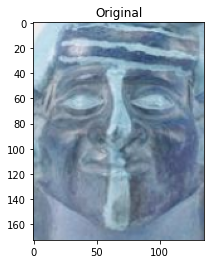

173 136
(219, 236, 355, 409)
219 isss [ 0.06847243  0.02030843  0.20183042 -0.0750304   0.07233434  0.00979793
  0.08808468 -0.03110925 -0.06500578 -0.035616    0.02359881  0.03580349
 -0.02967546  0.14467649  0.1322676  -0.04627388  0.05005871 -0.01524463
  0.07265035 -0.03738061  0.08610253  0.22392459 -0.13767081  0.05062425
  0.0034584   0.11416554 -0.04576444  0.03068873  0.15244555  0.09382251
 -0.11285175 -0.10737737 -0.05863524 -0.05315802  0.12553942  0.00676764
  0.04979341  0.07799278  0.09333274  0.01351796 -0.0076198   0.17267156
 -0.03026851 -0.06383629 -0.02857626  0.15993062  0.00356295 -0.12349087
 -0.05450566 -0.15447034  0.0114159   0.09603477 -0.04010697  0.0655205
  0.11547883  0.01260947 -0.01971779  0.13865982 -0.15854989  0.07586692
  0.06947228 -0.06957229  0.03096825  0.01517126  0.086783   -0.0398352
  0.07424147  0.03784398  0.06648707  0.04973751  0.15049993  0.06692405
  0.0168839  -0.08203725  0.02958247  0.08175126 -0.09722205  0.04375167
  0.08804088 -0

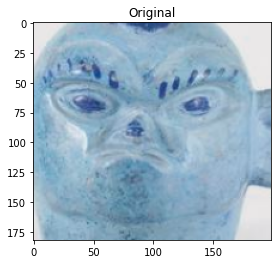

182 199
(209, 208, 408, 390)
209 isss [ 0.05214952  0.01502057  0.14990206  0.14219868  0.06420287  0.16658957
  0.02591513 -0.12737417  0.08428984 -0.01980257 -0.05595681  0.02780155
 -0.09362036  0.04301293  0.22685564 -0.10111304  0.02780648  0.06249333
  0.03591642 -0.10682751 -0.08908705  0.08458555  0.06967057  0.18429191
  0.16215125 -0.18511266 -0.00368958  0.00905158 -0.10329303  0.00329964
  0.12595998  0.0516005  -0.07060168  0.04853282  0.05354996  0.01558832
  0.04128722 -0.0964087  -0.04902702 -0.01790534  0.12607756 -0.01214819
 -0.004861   -0.12888223 -0.12518302 -0.0781144  -0.07163467  0.00868566
  0.09456756  0.03567028  0.18439227 -0.04821222  0.13478874 -0.07219898
  0.01919316  0.05724803 -0.05569123  0.0871565   0.04708103  0.00036429
 -0.08939483  0.05212484 -0.10009764 -0.23678546  0.09520996  0.12554438
  0.08103996 -0.07199582 -0.22159448  0.18886898 -0.01735701  0.15871282
 -0.01600429 -0.00123953 -0.02218931  0.01653194  0.03543074 -0.12029184
  0.00734491 

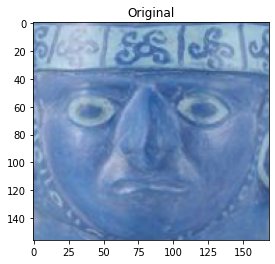

156 169
(203, 224, 372, 380)
203 isss [ 0.03889387  0.10480066  0.04028891 -0.14132665 -0.06252795  0.11325856
 -0.02541526  0.10623106 -0.11047069  0.11735429  0.04175807 -0.09827968
  0.02974614  0.18220668  0.1997386  -0.12947325  0.16686952  0.0172256
  0.19197752 -0.13574728 -0.05123783  0.2030695  -0.04740116  0.07645567
 -0.00359389 -0.02243433  0.14053439  0.09089844  0.137317    0.04912807
 -0.05319291 -0.1946232   0.01436422 -0.06346682  0.02654105  0.01091479
  0.04531329 -0.0145918   0.01106695  0.15362337 -0.09565529  0.09574185
 -0.11515944 -0.00024763 -0.06462871  0.07493324 -0.01024151 -0.03161038
 -0.05192392 -0.09307835  0.12600027  0.19281118 -0.00131156  0.00783539
 -0.06674401  0.08036435  0.04464501  0.07953302  0.03333297 -0.0111317
 -0.05504571 -0.01836593 -0.00478129 -0.08116194 -0.03028891 -0.0403705
  0.15007065  0.02970556  0.00496071  0.09794509  0.09741735  0.00966789
 -0.04413995 -0.1119411   0.05629782  0.03707549 -0.09897025  0.04816023
  0.06240554 -0.

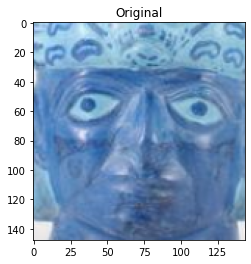

148 144
(219, 232, 363, 380)
219 isss [ 1.36088580e-01  4.65155095e-02  5.66163361e-02 -1.30420879e-01
  9.77143943e-02  1.59880236e-01  3.76229770e-02  2.57547852e-02
 -7.63183385e-02 -7.14231953e-02 -7.56754726e-02  2.66978592e-02
  3.40755433e-02  1.46001652e-02  5.81306703e-02 -3.42922807e-02
  2.23418158e-02 -5.66674583e-02 -8.60569924e-02  4.77399901e-02
  8.64199996e-02  1.75948784e-01 -1.42959533e-02  8.88233632e-02
 -4.03471962e-02  5.30818887e-02 -1.52548729e-02 -8.97545591e-02
  4.07995880e-02  5.26668094e-02 -8.21036547e-02 -3.11468188e-02
 -1.00976281e-01  5.31498305e-02  4.82210405e-02 -1.23217301e-02
  4.63374779e-02  1.49940252e-01 -1.52302478e-02 -1.14369381e-03
  6.79815828e-04  6.24208972e-02 -2.57466640e-02  2.29362007e-02
 -7.10627213e-02  1.51822269e-01  7.19265863e-02 -2.26660874e-02
 -1.26299053e-01  3.94455791e-02  1.17808960e-01  1.56812277e-02
 -2.38079950e-02  6.30750284e-02  1.62735716e-01 -5.05899861e-02
  4.88711987e-03  1.37148380e-01 -9.17672832e-03 -1.

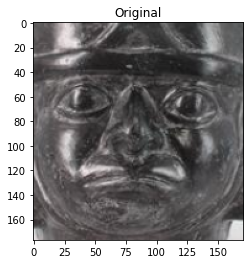

177 171
(211, 228, 382, 405)
211 isss [ 0.03586608  0.07017296  0.0307896  -0.1010111   0.04403638  0.07066362
  0.02505867 -0.05239547  0.01822931 -0.07456266  0.04522688 -0.06201161
 -0.02557013  0.11371603  0.15313065 -0.11952713  0.03644181 -0.09958282
  0.07979438  0.02559605 -0.06511433  0.16230936 -0.01255315 -0.05315231
 -0.03055983  0.07251643 -0.00925324 -0.0067816   0.18400286 -0.04891253
  0.04586984 -0.06119574 -0.03031598 -0.08783618  0.08645395  0.11102854
  0.07422557  0.12251538  0.07365724  0.06151899  0.03513942  0.09424615
 -0.2228664  -0.03946814 -0.13544203  0.20729032 -0.02655174  0.00774111
 -0.04834738 -0.12112656 -0.20579334  0.18758994  0.02706471 -0.00362456
 -0.05181558 -0.01413371 -0.02273663  0.15912375 -0.18050338  0.07942498
 -0.08393846  0.02928201  0.16814916 -0.05738641  0.04852973  0.01374718
  0.16398169  0.06005917  0.0662404   0.06466546  0.1020283   0.02574163
 -0.0129772   0.02450447  0.10484917 -0.01951524 -0.12927748  0.02124773
  0.04044588 

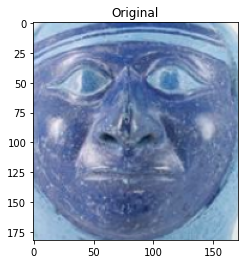

182 171
(213, 212, 384, 394)
213 isss [ 0.07151986  0.01513731  0.15679371  0.10358723  0.08585279  0.1389927
 -0.02139558 -0.16319475  0.06259792 -0.1471812   0.01880534  0.05845584
 -0.15399674  0.05901644  0.05175129 -0.01363439 -0.01249427 -0.0354519
  0.03911131 -0.04983553  0.04115206  0.17608154 -0.08065234  0.08680692
  0.11506722  0.00594667 -0.042751    0.03108647  0.02034003  0.04434862
  0.00455001 -0.06218954 -0.09233647 -0.07416013  0.09931566  0.09929071
  0.02044819 -0.09801026  0.05378634 -0.01247293  0.07379827  0.11349112
 -0.02532629 -0.16402513 -0.01270225  0.09132091 -0.0088862  -0.10311895
  0.02759901 -0.07731576  0.05673581  0.12555568  0.08223971  0.03672359
  0.12608795 -0.00674856 -0.01232637  0.05841386 -0.10151003  0.0471549
  0.00680684  0.03841849  0.03321134 -0.08948674  0.06326715  0.01736571
  0.10833806  0.03352341  0.01808168  0.20292036  0.12475704  0.13166305
  0.02166078 -0.07182723  0.07585913  0.11030876 -0.07680562  0.01353989
 -0.0444367   0.

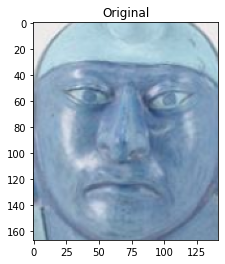

167 142
(221, 232, 363, 399)
221 isss [ 4.2846929e-02  4.8722405e-02 -1.4411008e-02 -1.1991857e-01
 -8.2011685e-02  1.7408195e-01 -8.2874998e-02  9.4221368e-02
 -9.1831468e-02  6.0423303e-02  3.4891829e-02 -3.8989052e-02
  3.6937166e-02  1.4262435e-01  1.2773274e-01 -1.3970132e-01
  1.4056781e-01 -2.5600040e-02  1.8796708e-01 -2.7543703e-02
 -5.9390184e-02  1.5218049e-01  2.6508896e-02  9.8265119e-02
 -5.7922706e-02  1.6303483e-02  1.5846862e-01  9.4270293e-04
  4.8193034e-02  1.1097305e-02 -2.1271246e-02 -2.0111081e-01
  5.6093227e-02 -9.1619510e-03  1.9622363e-02  8.8392310e-02
  4.3588683e-02  7.8080654e-02 -6.0804758e-02  8.9193635e-02
 -1.3365553e-01  6.8502225e-02 -1.6430637e-01 -1.1681196e-04
 -9.2570372e-02  5.0446309e-02  2.9073505e-02 -1.0824192e-02
 -1.0444001e-01  3.3164959e-02  5.1553015e-02  1.4672613e-01
  3.8502675e-02  3.0489074e-02  7.0555089e-03  9.3091741e-02
  3.0432321e-02  9.9370353e-02  1.3431125e-02 -7.6636232e-02
 -9.3962580e-02  2.3544079e-02  1.2286007e-01 -

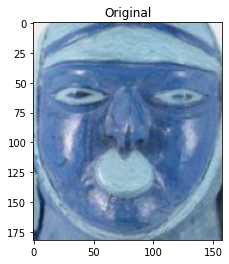

182 158
(217, 222, 375, 404)
217 isss [ 0.05478634  0.16695035  0.06357963 -0.04388468 -0.01865121  0.10312619
  0.01033031 -0.04467305 -0.16553693  0.12176107 -0.00044738 -0.00588882
  0.0246529   0.07436035  0.05398484  0.00906599  0.12132863  0.09816033
  0.06739104 -0.06244686 -0.0059751   0.14366059 -0.14558962 -0.03308482
 -0.00348297  0.10656532 -0.00491507  0.06581602  0.0921447   0.13827848
 -0.18675233  0.14091353 -0.03000201 -0.00419322  0.06481484 -0.02263588
  0.0877435  -0.04015731  0.10529397 -0.04815787 -0.046206   -0.06342244
  0.09304918 -0.08529452  0.00940667  0.19562456  0.10701375 -0.06095009
 -0.24776837 -0.13721567  0.20203196  0.16627982 -0.02348665  0.06598116
  0.06361774  0.03676411  0.01868184 -0.04273681 -0.010358   -0.01416912
  0.0784142  -0.03603126 -0.0195489  -0.07370883  0.05304873  0.01772465
  0.00608276  0.05306509 -0.05993665  0.09457161  0.03568767 -0.05143776
 -0.04626525 -0.123425    0.01416496  0.09654526 -0.00431469  0.06609718
  0.02662145 

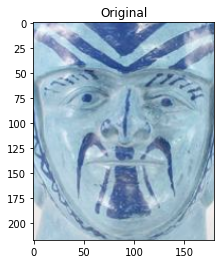

217 180
(204, 177, 384, 394)
204 isss [ 0.01290203  0.17794268  0.08999144 -0.15752727 -0.04826687  0.03611445
 -0.03488344  0.03743059 -0.0888164   0.10265928  0.04568283 -0.06436896
  0.06585937  0.10059804  0.100114   -0.05692445  0.12373973  0.05748819
  0.04885959  0.01538057 -0.00841596  0.22809942 -0.06530504  0.16070445
 -0.10346038  0.03198675  0.11730927  0.11276929  0.18860272  0.09367696
 -0.14612663 -0.13440944  0.06335811  0.0285974   0.08780311 -0.00672746
  0.15260953  0.0845792  -0.04213125  0.04963149 -0.09940813  0.0161109
  0.01819951  0.03207133 -0.05410696  0.11090628  0.09822568  0.06046063
 -0.12554294  0.02179834  0.12919775  0.12345389 -0.06766839  0.06266362
  0.10345017  0.04661729 -0.01573889  0.01939162  0.00815805 -0.11367977
 -0.03527517 -0.04319831  0.02775258 -0.0197685  -0.04116593 -0.05346934
  0.07843897 -0.03264405 -0.05900796  0.0642245   0.02283765 -0.10732677
 -0.01813767 -0.05250438  0.10337493 -0.00222053 -0.04849998  0.14332783
  0.15488671 -

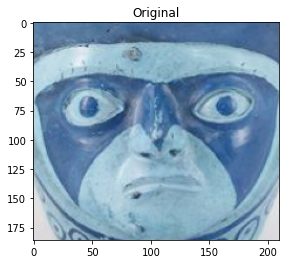

186 210
(188, 222, 398, 408)
188 isss [ 0.04203178  0.01228875  0.18021215 -0.04679421 -0.08609861 -0.04336813
  0.02186643  0.00942579 -0.09113643  0.01467155  0.02174787 -0.01724822
 -0.01034074  0.20238386  0.15780467 -0.09196857  0.1232692  -0.0649184
  0.1765174  -0.02292256 -0.02592696  0.15126702 -0.05880716  0.12885557
 -0.04972875  0.14200741  0.03616934  0.01329148  0.09483664  0.03190464
 -0.10997138 -0.08513331  0.01162849  0.01112842  0.05256877  0.03268732
  0.11319438  0.20312247  0.05786469  0.07695367 -0.10722695  0.10951777
 -0.12263507 -0.1423964  -0.0020226   0.16256633  0.02500216 -0.10451952
 -0.04337477 -0.07438137  0.05624658  0.15129738  0.01711096  0.08842038
  0.1361136   0.02241882  0.07300737  0.10093177 -0.06028248  0.02426426
  0.04752288 -0.04803743 -0.02099334 -0.07717727  0.04231291 -0.02586386
  0.14282401  0.03415139  0.04067289  0.09535417  0.04316161 -0.00576278
 -0.06273344  0.05392424  0.08812723 -0.02097635 -0.03187613  0.08197664
  0.14096591 -

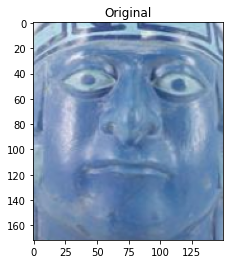

172 150
(224, 236, 374, 408)
224 isss [ 0.08792972  0.05228927 -0.00645374 -0.13603728  0.004579    0.14653197
 -0.04154548  0.04182953 -0.1173297  -0.0180733   0.04033731 -0.04410771
 -0.00978894  0.16522813  0.10019977 -0.09273577  0.0970153  -0.12050339
  0.17840089 -0.0688776  -0.02699359  0.23044112 -0.08985794 -0.01364729
  0.00678396  0.08217345  0.14540672  0.10936695  0.08096608  0.03696732
 -0.05302238 -0.23893684 -0.06352143 -0.05655055  0.02387127  0.08279068
  0.00135385 -0.06699871  0.04783244  0.12079106 -0.066211    0.11799914
 -0.07046828  0.04381294 -0.02849325  0.14005756 -0.00106201 -0.02048776
 -0.03091049 -0.0450085   0.04571705  0.18139711 -0.04043689  0.03085163
  0.03654304  0.0249441  -0.06287136  0.15440802 -0.03828958  0.03200596
 -0.02362011 -0.00571596  0.1214749  -0.05940676 -0.00607805 -0.09542742
  0.13096322  0.08174784  0.08907714  0.12422859  0.12799811  0.06702714
 -0.00445269 -0.0926211   0.02927003  0.05231771 -0.06301565  0.05962915
  0.02609087 

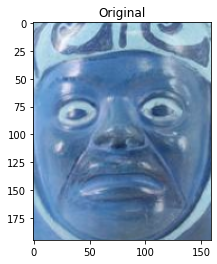

195 159
(222, 182, 381, 377)
222 isss [ 0.05776265  0.0625334  -0.00881199 -0.04910842  0.02945608  0.12815814
  0.09549359 -0.07459648  0.01030066  0.0145144   0.01585232  0.00725173
  0.00069885  0.02809528  0.11087508 -0.1596767  -0.01682642 -0.02017473
  0.14463252 -0.06051101  0.00501529  0.11396024 -0.05805307  0.03532371
  0.01652193  0.00049885  0.02021275 -0.08787561  0.05973332  0.15698573
 -0.01914354 -0.15824434  0.02462026 -0.07035071  0.19839773  0.00693871
  0.06376257  0.01318489 -0.0270759  -0.10998136 -0.00370755  0.00769606
 -0.03554739  0.13612632 -0.16781025  0.15359074  0.02720263  0.01721847
 -0.07333925 -0.08714608 -0.00155224  0.07799608  0.09530966 -0.03896755
  0.13508034  0.08650354 -0.10836653  0.11833629 -0.08034846 -0.03278686
 -0.05810453 -0.08291078  0.1545869  -0.08816244  0.15972865 -0.05507261
  0.03768975 -0.00631209 -0.03578446  0.06804353  0.07598156 -0.00404069
 -0.06418616 -0.18685493 -0.01649818  0.0829821  -0.08983917  0.01304727
  0.08629761 

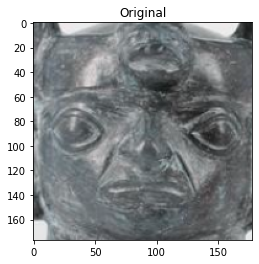

177 178
(203, 190, 381, 367)
203 isss [ 0.04821077  0.00965279  0.1304676  -0.16516557  0.07335756  0.10040366
  0.03626021  0.01108695 -0.06112332 -0.00676753 -0.04107719  0.03327896
  0.05623455  0.0130057   0.11025976 -0.08857907 -0.04513683 -0.008419
 -0.01483668  0.05869067  0.10435435  0.11012311  0.00889026  0.13271251
 -0.05197281  0.09404415 -0.01035175 -0.14074562  0.10641817  0.04029178
 -0.06184382 -0.11329383 -0.03759203  0.03049831  0.12487055  0.00933701
  0.03256017  0.19372454 -0.00924933 -0.04412185 -0.01626007  0.03340169
 -0.10703401  0.04648769 -0.10998572  0.15546137  0.07516497  0.01980406
 -0.1719877  -0.02059599 -0.0270736   0.01120839  0.01374353  0.01906233
  0.15236273  0.00853737 -0.00373152  0.16833052 -0.10509942 -0.10827991
  0.03917093 -0.02174863  0.12491919  0.0022956   0.11018799 -0.09605186
  0.01582868  0.12719105  0.01563145  0.08057886  0.04405764  0.01801091
 -0.06187897 -0.09621571  0.03147715  0.04942597 -0.13857792  0.08826387
  0.1772285   0

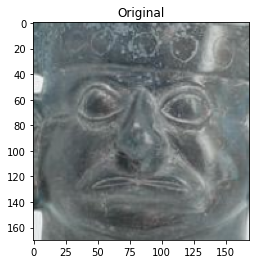

170 169
(195, 214, 364, 384)
195 isss [ 0.08786786  0.09662565  0.14106312 -0.05197714  0.10910156  0.16237403
  0.0675707  -0.07283342  0.00615284  0.02734797 -0.01858925  0.06131079
 -0.02271718  0.03383127  0.1125436  -0.08081936 -0.03014035  0.06452697
  0.00902191 -0.07364638  0.07376599  0.207089    0.00134098  0.09153485
  0.01925469 -0.06457002 -0.00651314 -0.00470689  0.12713684  0.1675433
 -0.11096656 -0.03936908 -0.03021808 -0.0145105   0.13041304 -0.05667245
  0.0342427   0.01436407 -0.00202138 -0.02012909 -0.02352808  0.02878042
 -0.07014768 -0.07926556 -0.16023473  0.13101529 -0.01819687 -0.01582051
 -0.07491989 -0.02259909  0.13614456  0.17331043  0.02695286  0.01524799
  0.08779404  0.01703684  0.05683991  0.05885909 -0.15642422  0.01571968
  0.01151204 -0.03359989  0.06706046 -0.07930885  0.1012962  -0.05418835
  0.02528614  0.07069585 -0.08686864  0.19132887  0.08293985  0.08322429
 -0.06244107 -0.10342871  0.00133784  0.133315   -0.07202405 -0.04275669
  0.07749823 -

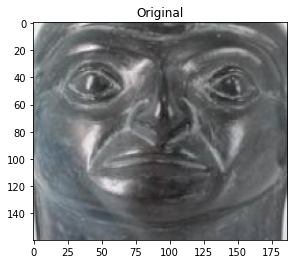

160 187
(197, 225, 384, 385)
197 isss [ 0.06448824  0.02633681  0.1829122  -0.10623197  0.06211156  0.01589998
  0.0171738  -0.0165793   0.00243754  0.01429553  0.07957673 -0.01850918
 -0.01888884  0.10875688  0.18662015 -0.02055302 -0.03458457 -0.00795871
  0.03102003 -0.06741872  0.07464601  0.256848   -0.04204453 -0.07278769
  0.01039577  0.08903363  0.0399796   0.03440038  0.11073522  0.06244166
 -0.10244469 -0.11786457  0.02864651 -0.01304949  0.14943896  0.02452627
  0.08768041  0.07455347  0.10863301  0.00369739 -0.03446132  0.07997171
 -0.05381786 -0.03319132 -0.10139833  0.15096645 -0.04903007 -0.04765732
 -0.0413187  -0.0938879   0.01051235  0.1563923  -0.07135275  0.09589099
  0.07529033 -0.01535783  0.01619733 -0.01342305 -0.20518538  0.08317151
  0.01373658 -0.1640031   0.03108942  0.05217614  0.07439793 -0.05123889
  0.01961327  0.1401607   0.11625878  0.1384552   0.12914732  0.04531413
 -0.00702776 -0.15155877  0.03838827  0.05596767 -0.12490968  0.02322291
  0.03451973 

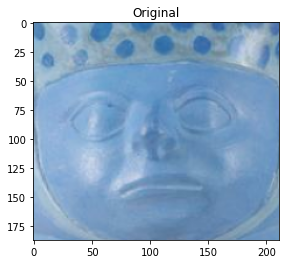

187 211
(190, 170, 401, 357)
190 isss [ 0.07547069  0.08147665  0.01592749 -0.11085984 -0.05869606  0.03768914
  0.01398539  0.0375853  -0.16716687  0.14301664  0.08207093 -0.05774619
  0.00557318  0.12567316  0.2241331  -0.09332632  0.15548906 -0.0401104
  0.2786651  -0.04074076 -0.09489217  0.18165645 -0.043392    0.08840229
 -0.00366307  0.10550135  0.170949    0.01264277  0.13970998  0.06147111
 -0.11595654 -0.17594326  0.0475779  -0.04486606  0.07010735  0.00279574
  0.10744225  0.04786535  0.0748255   0.06383916 -0.09519976  0.02700232
 -0.06530903  0.02383512 -0.10276854  0.15910026  0.04679324 -0.02558782
 -0.09997617 -0.08528806  0.09838772  0.1364455   0.01263331  0.01602306
  0.03941575  0.0596922   0.00521844  0.10607745 -0.02646435  0.04002525
 -0.04436838 -0.09137402  0.06218001 -0.0841816   0.06698142 -0.00977916
  0.07630516 -0.01795661  0.00954257  0.01269601  0.01304575 -0.00602062
 -0.07732049 -0.071099    0.09121159 -0.02065525 -0.0376776   0.09943349
  0.12413476  

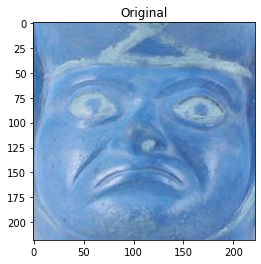

218 222
(192, 147, 414, 365)
192 isss [ 0.02601123  0.07539923  0.22365093 -0.15159053 -0.01805324 -0.00686247
  0.03085043  0.03706248 -0.0903528   0.09213353 -0.00570119 -0.07524695
  0.01362002  0.20057784  0.28029975 -0.07689844  0.08809441 -0.01298027
  0.09004501 -0.09173541 -0.04276705  0.24122487 -0.0456429   0.07529654
 -0.02243481  0.03787004  0.06444982  0.11353508  0.15105921  0.03964272
 -0.13307326 -0.09122846  0.06336509  0.03410096  0.09223102  0.01424067
  0.12397578  0.08448622  0.01484349  0.00928165 -0.06282844  0.02956517
 -0.00541595 -0.0995639  -0.05182979  0.21943523 -0.02301665  0.00854407
 -0.11905489 -0.08414198  0.05297297  0.12750472  0.01786766  0.03283644
  0.06926104  0.05765308  0.00947015  0.04031676 -0.06643606  0.03096929
 -0.00525455 -0.03377771 -0.08550579  0.01249447  0.03306205  0.08144147
  0.01145266  0.0641024  -0.02727415  0.08426273  0.03294937 -0.06548461
 -0.06640013 -0.08698376  0.10562336  0.05217204 -0.05108281  0.01822248
  0.1496106  

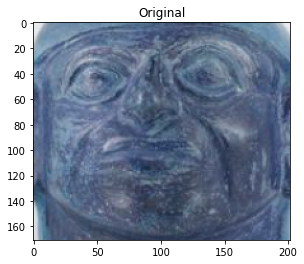

171 202
(192, 221, 394, 392)
192 isss [ 0.06461164  0.18030824  0.11046693 -0.04225078 -0.04365082  0.06499982
 -0.01383396  0.00890452  0.10278898 -0.04663203  0.13861135 -0.13973618
 -0.10530232  0.07099652  0.0655108  -0.02488417  0.02379746 -0.04399541
  0.01632941 -0.13975032  0.08271518  0.19239582 -0.11076307  0.02479712
  0.04462235 -0.06929859  0.09872562  0.1137431   0.17966215  0.04831632
 -0.0604237  -0.1955774  -0.02440262 -0.01974153  0.03632294  0.07544864
  0.06524824 -0.05758949  0.01189763  0.13144606 -0.06784729  0.06955067
 -0.09058145 -0.03642688  0.08695979  0.16146605 -0.02064794 -0.07147837
 -0.04597922 -0.08303641 -0.00879407  0.30387375 -0.09735714  0.05004177
 -0.0121769   0.02656426  0.01028762 -0.05100527 -0.09233423  0.03994754
  0.03365453 -0.07757363  0.03166697 -0.00406723 -0.05035926 -0.09068332
  0.13260704  0.03911266  0.14431988  0.23778899  0.09144763  0.01194698
 -0.02498804 -0.09844531  0.09021899  0.00115083 -0.05262443  0.18206058
 -0.08723799 

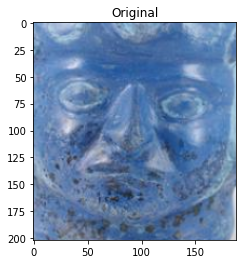

202 188
(206, 210, 394, 412)
206 isss [ 0.06469557  0.19636016  0.07549208 -0.07893506 -0.0234149   0.03223807
  0.06079883 -0.01393006  0.05089854  0.03860215  0.06650122 -0.11206207
 -0.02152673  0.11977045  0.14890441 -0.07240612  0.0996493  -0.05804017
  0.04614489 -0.08704561 -0.01033132  0.18250291 -0.03752195  0.05267073
  0.00520791 -0.06243256  0.07894455  0.06735958  0.19614351  0.0909601
 -0.08729998 -0.1188456   0.02774434 -0.04018869  0.07283976 -0.00250213
  0.14608146  0.11639845 -0.01979277  0.07153991 -0.07312053  0.04064535
 -0.11634459 -0.04520668 -0.05184082  0.26523817 -0.0359524  -0.01615292
 -0.06369537 -0.08395785  0.04605171  0.30588967 -0.02612317  0.00556276
  0.03291174  0.01792511  0.04095948 -0.00653988 -0.06658743  0.02518924
 -0.02154761 -0.11305337  0.00033875 -0.06367806  0.03259303 -0.08828304
  0.10761813  0.07202438  0.03823494  0.16357045  0.09135688 -0.01733946
 -0.06368407 -0.10584208  0.11194517  0.06361858 -0.06377372  0.15656194
  0.02138298 -

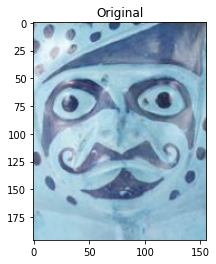

196 156
(218, 186, 374, 382)
218 isss [ 9.62413996e-02 -6.19565919e-02  1.28077380e-02 -8.59966129e-02
  8.04846659e-02  2.03570172e-01 -4.81260382e-02 -8.88338126e-03
 -1.42315775e-01 -1.31743655e-01 -8.45920816e-02  6.03331551e-02
  3.86087857e-02 -5.27058542e-02  4.29861322e-02 -9.46831927e-02
 -1.29718691e-01 -5.35030179e-02 -3.88574414e-02  1.20585650e-01
  2.59583816e-02  1.00781940e-01  6.92235231e-02  4.07786369e-02
 -2.60358118e-02  7.06038103e-02 -1.27423927e-02 -1.35648251e-01
 -9.81509015e-02 -4.35601212e-02 -3.18203634e-03 -1.17912687e-01
 -1.55359298e-01  3.92586850e-02  6.12612963e-02  6.75441772e-02
 -6.87125847e-02  7.90922716e-02 -3.97882760e-02 -4.01245989e-03
  4.39239927e-02  3.31495367e-02 -5.68205230e-02  1.36041254e-01
 -1.71043262e-01  5.13759395e-03  1.07190140e-01  4.92788292e-02
 -5.16430996e-02  1.67418450e-01  5.13326749e-02 -9.90052968e-02
 -3.25264148e-02  7.76791498e-02  1.57881364e-01 -1.02557249e-01
 -4.19092588e-02  1.67686820e-01  4.00768630e-02 -1.

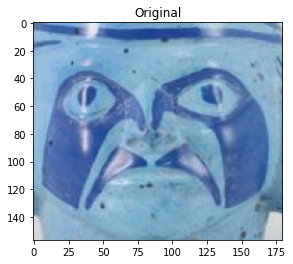

157 180
(207, 239, 387, 396)
207 isss [ 0.03465667  0.10698182  0.09118545 -0.10746869 -0.02533468  0.09644349
  0.04228614 -0.10085287 -0.08001678  0.05554354  0.06749734  0.01799463
  0.07007118  0.20302798  0.14806743 -0.1595561   0.02621309 -0.04212726
  0.07360466 -0.02578624 -0.05255665  0.15693076 -0.10167853  0.07998864
 -0.03763169  0.05856375  0.02337619  0.08218146  0.05217678  0.12072887
 -0.12155301 -0.12268534 -0.00523898 -0.01735659  0.0705341   0.08651745
  0.05341656  0.06030292  0.026008    0.05445972 -0.04073252  0.04285746
 -0.05139791 -0.03183514 -0.103305    0.15398116  0.0167375  -0.00887472
 -0.10012002 -0.08157323  0.05730402  0.11654927 -0.02930927  0.06453738
  0.10997377  0.08001185 -0.11949374  0.15091513 -0.08562418  0.03167488
 -0.04913963 -0.01019018  0.08365874 -0.06215849  0.06230823  0.03573467
  0.09263757  0.08451436 -0.05995274  0.06746537  0.1383188  -0.00451758
 -0.00610984 -0.0769658   0.09606221  0.11857487 -0.07504856 -0.03573806
  0.11871164 

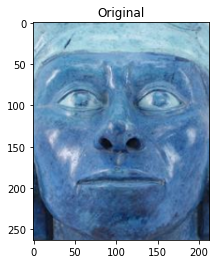

263 213
(197, 141, 410, 404)
197 isss [ 0.08564     0.03635937  0.22286402  0.00452659 -0.01351757  0.10856798
 -0.06927362  0.00745155  0.03147255 -0.12300358  0.02153637 -0.08755387
 -0.1066168   0.03257698  0.19233759 -0.08766011  0.04802766 -0.08452167
  0.04138327 -0.07958539  0.03530127  0.1838106  -0.11783496  0.03397442
  0.09416111  0.01469743 -0.05758699  0.01484616  0.0202988  -0.05550309
  0.09606418 -0.10125615 -0.06672997  0.0047174   0.10343243  0.1282522
  0.04917185 -0.0518192   0.08305536 -0.01100032  0.04896479  0.05379616
 -0.11206088 -0.11828239  0.07231819  0.16289215 -0.04621068 -0.05872612
 -0.04401621 -0.08904418 -0.03390304  0.20363455  0.08325272  0.01678752
  0.03301091 -0.04169835 -0.01603762 -0.03698272 -0.06290683 -0.02827714
  0.00721157  0.02714079 -0.07907404 -0.0352491  -0.04089445 -0.01420324
  0.16327624  0.09291463  0.09627698  0.153986    0.11656018  0.01481096
 -0.04328285 -0.13909943  0.07872929  0.01623562 -0.13105203  0.06240211
  0.0283757   

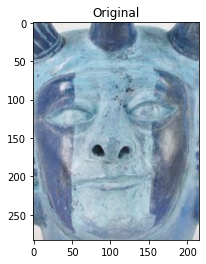

283 216
(198, 121, 414, 404)
198 isss [ 1.08642787e-01  3.13614532e-02  7.55747408e-02 -9.63093191e-02
 -1.74406506e-02  4.69788983e-02  5.15176207e-02  4.21390031e-03
 -7.99282491e-02  1.07600503e-01  2.07605418e-02 -9.02936384e-02
  8.65098238e-02  1.34248450e-01  1.99565023e-01 -8.86381939e-02
  1.21567011e-01 -9.71791428e-03  6.62146062e-02 -6.70460686e-02
 -1.00542568e-02  1.78957775e-01 -1.05573148e-01  3.05562112e-02
 -1.92604342e-03  4.99778874e-02 -1.06695620e-02  9.62685561e-04
  3.17677744e-02  1.19663529e-01 -9.70911309e-02 -4.28934246e-02
 -4.87815924e-02 -3.23132286e-03  1.24217443e-01 -4.49458421e-05
  1.11182913e-01  6.32645488e-02  8.14721733e-02 -4.41024527e-02
 -7.35582858e-02  2.23320313e-02 -6.67235404e-02 -2.55490337e-02
 -1.65863149e-02  1.91460148e-01 -3.81373055e-02  3.82419787e-02
 -4.87717576e-02 -1.22374661e-01  1.22615710e-01  1.28053427e-01
  4.81828935e-02  4.02642451e-02  5.37763946e-02 -2.48533785e-02
 -7.87246879e-03 -2.39399839e-02  2.45907512e-02 -4.

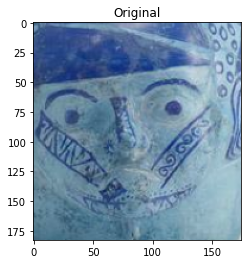

183 175
(226, 232, 401, 415)
226 isss [ 0.09445922  0.10394347  0.1002358  -0.04620918  0.09372244  0.22085844
  0.07230085 -0.05802743 -0.01768052 -0.07527589 -0.00669008 -0.0122151
 -0.0295358   0.0730377   0.1603729  -0.10982458 -0.03830107 -0.0431613
 -0.02693201 -0.08620393  0.00848339  0.13495097  0.06275871 -0.04874416
  0.05319944 -0.07206833 -0.06812923 -0.00808624  0.08391931 -0.02730452
  0.0249543   0.0090151  -0.10800394 -0.01407544  0.08127698  0.02851876
  0.0502902   0.10670901  0.06179057  0.03466995  0.09578093  0.0484768
 -0.16919418 -0.13590981 -0.22070973  0.12085985 -0.09211942 -0.03402472
 -0.06016576 -0.0639135  -0.01998912  0.19987927  0.02169839  0.06633165
 -0.04631911 -0.04386072  0.0939155   0.08603948 -0.17012367  0.02618303
 -0.08694617  0.03211563  0.07313327 -0.1651941   0.1085005   0.04095852
  0.11340416  0.13574022 -0.04196184  0.19320579  0.10802524  0.12209203
 -0.01681885 -0.02521702  0.09264102  0.09305956 -0.12364239 -0.10361889
  0.01228551  0.

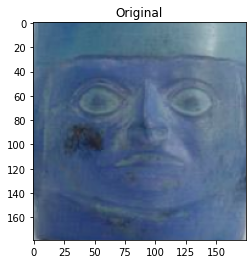

179 175
(215, 250, 390, 429)
215 isss [ 0.10624803  0.02725637  0.11311402 -0.11607035 -0.0012299   0.13974833
  0.08218151  0.0223833  -0.06760595  0.00266742  0.01012816  0.05542091
  0.08484418  0.05694989  0.06994262 -0.12373018 -0.08912674 -0.05707266
 -0.03899816 -0.05263466  0.08227985  0.17427929 -0.02931392  0.09456197
 -0.06082835  0.02187577  0.00734892 -0.04140006  0.03708526  0.12689471
 -0.15169272 -0.11566328 -0.06944986  0.03638671  0.04659408 -0.06879742
 -0.0307347   0.11393247 -0.01654971  0.07614272 -0.0569758   0.02562262
 -0.1257753   0.00054829 -0.10185768  0.05586651 -0.03353199 -0.03617952
 -0.05820473  0.02717959  0.12793043  0.13167827 -0.01431452  0.08413982
  0.10147607 -0.00740292  0.02813483  0.11239213 -0.07984977 -0.04642851
  0.00879079 -0.06077458  0.07390785 -0.0043687   0.01129497 -0.1136048
  0.08482002  0.12319659 -0.01126992  0.05135179  0.07858212  0.03846296
 -0.02694086 -0.08540504  0.02512397  0.11900113 -0.12532382 -0.10486769
  0.11054137  

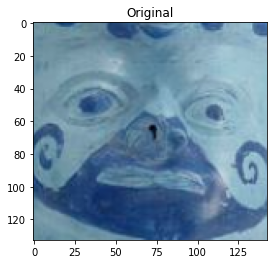

133 143
(231, 238, 374, 371)
231 isss [-0.02659408 -0.00624191  0.09685252  0.02819856 -0.02791584  0.09421933
  0.00834753 -0.14953965  0.04627475  0.05934054  0.05038618 -0.00356867
  0.02291756  0.09232432  0.22240321 -0.09055427 -0.0647672  -0.04063401
  0.08346375 -0.07997173 -0.05548864  0.01032556 -0.02155058  0.07655916
  0.08593706  0.07125888 -0.07121345 -0.11713971  0.02634078  0.04259179
  0.0987624   0.0689884   0.00062985 -0.03462666  0.05793667  0.09820095
 -0.0210129   0.07047541  0.07401331 -0.02468492  0.04979253 -0.0599298
 -0.17092355 -0.09048595 -0.06615762  0.05478432 -0.03963802 -0.00821414
 -0.02712075 -0.22246535 -0.05421202  0.04795028  0.2229931  -0.08246
  0.01013195  0.10235904 -0.03885309  0.12758741 -0.06780072  0.00399469
 -0.12272928  0.01331746  0.04369012 -0.06842186  0.07346253  0.25411218
  0.10817789  0.09066508 -0.04529073  0.00674145  0.00808302  0.04032772
 -0.08262908 -0.0878444   0.12445682  0.02969929 -0.12588416 -0.1582154
  0.04173022  0.11

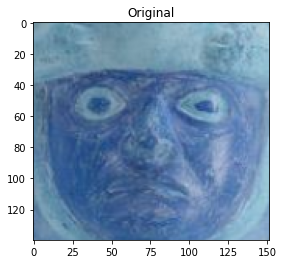

140 152
(210, 227, 362, 367)
210 isss [ 0.0902995   0.0786925   0.00996919 -0.18827341  0.02367155  0.15931208
  0.07199334  0.00198446 -0.10242233  0.03297408  0.03255342  0.06136324
  0.12563679  0.0495571   0.08972812 -0.12149625 -0.07804349 -0.00537824
 -0.06373123  0.02383273  0.03239864  0.10747211  0.01430588 -0.01188061
 -0.09824377  0.0816129   0.01788204 -0.06883214  0.05906004  0.06871947
 -0.1465267   0.00636568 -0.05947893  0.02601259  0.01136863 -0.03507349
 -0.01176403  0.20594034  0.04665127  0.07674728 -0.00207666 -0.03110394
 -0.15264459  0.0166124  -0.20499645  0.09560897  0.01954998 -0.03290343
 -0.19176564 -0.00819468  0.02276927  0.09290262 -0.0835264   0.10256937
  0.0238199  -0.00276421 -0.00101838  0.17092459 -0.16157545 -0.04100962
 -0.04644131 -0.05365005  0.19610202 -0.06413677  0.06759562 -0.03885462
  0.05776351  0.17811553 -0.06090771  0.04635784  0.09528512  0.02736133
 -0.03749098 -0.04077215  0.05948108  0.08653887 -0.1237292  -0.11836059
  0.08543033 

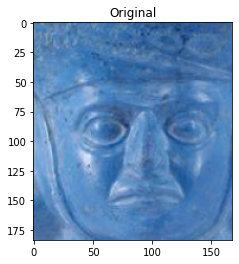

184 168
(205, 178, 373, 362)
205 isss [ 0.07121389 -0.0082921   0.0935632  -0.21203418 -0.04651649  0.19609909
  0.00606773  0.13327758 -0.17677188  0.06387491 -0.06464262 -0.02023313
  0.06289665  0.08538003  0.21296446 -0.1075014  -0.04484595 -0.090368
  0.11747742 -0.1033817  -0.00540846  0.17704417  0.05216535  0.00336389
 -0.07524686  0.09680346  0.05040195 -0.09072147  0.0133012  -0.02835927
 -0.08306718 -0.15008062 -0.04694439  0.03131254  0.05364318 -0.02186398
  0.02958159  0.13983655  0.04053614  0.09961882 -0.0671571   0.03377701
 -0.15412469 -0.05021149 -0.11429673  0.07296133 -0.00291333 -0.04780109
 -0.14145355  0.02380933  0.07165476  0.03656705  0.02352834  0.09667069
  0.02821751  0.02750741  0.10421584  0.13965179 -0.05578376 -0.06280755
 -0.01410532  0.01528375  0.0543605  -0.09073521  0.06258847 -0.00125416
  0.06740559  0.15804234  0.01962815  0.06529986  0.04378836  0.05353923
 -0.07040552 -0.05328952  0.04891065  0.05468947 -0.14466806 -0.1037531
  0.16949981  0.

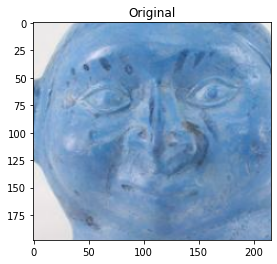

198 216
(167, 201, 383, 399)
167 isss [ 0.04370503  0.03290662  0.13495378 -0.13917291  0.0602942   0.08542411
 -0.04460905  0.01625613 -0.04583963  0.02322111 -0.01423335 -0.07755202
  0.02698865  0.09027956  0.27746344  0.00572173  0.01070585 -0.1324754
  0.0393299  -0.09409118  0.03714228  0.18692671 -0.01819763 -0.07639848
  0.04703892  0.07196745 -0.05455496 -0.06988321  0.04111412  0.01044777
  0.03241755  0.00779329 -0.03599008  0.01578585  0.05085018  0.09040058
  0.0754601   0.01843576  0.1365903   0.07677481  0.00515284  0.01496001
 -0.1129775  -0.12078219  0.03153165  0.25161067 -0.02986073 -0.03318658
 -0.07895603 -0.1473428   0.00421323  0.10912991  0.02737703  0.00783818
 -0.02922817 -0.00218495  0.05850629 -0.01646241 -0.08701964  0.06879944
  0.03572994 -0.02427068 -0.11702962 -0.01273326  0.02062863 -0.04340841
  0.0714842   0.25430667  0.1707462   0.05988312  0.08269549  0.07358157
 -0.10233572 -0.1969299   0.07402012  0.10381333 -0.15242003  0.02600988
  0.02568283  

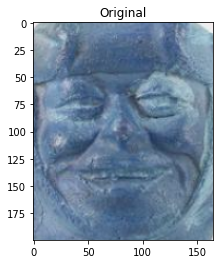

200 165
(216, 193, 381, 393)
216 isss [ 0.15957107 -0.02503082 -0.01529611 -0.05208002  0.10198029  0.19011255
  0.10537131  0.08557077  0.04603456 -0.16078302 -0.11409941  0.04141112
 -0.00366571 -0.11896217 -0.00595194 -0.04543206 -0.07528633 -0.09280203
 -0.18766628  0.02936744  0.0877607   0.1215193  -0.00553195  0.04418902
 -0.07172209 -0.06027772 -0.0724664  -0.16362166 -0.07632165  0.03530937
 -0.02916229 -0.00059467 -0.12818128  0.07804049  0.03229968 -0.04377755
  0.01634531  0.08519146 -0.12458439 -0.02074283  0.05027562  0.04846342
 -0.05171414  0.05580842 -0.04455065  0.07994575  0.01218231 -0.02665995
 -0.04662227  0.13202804  0.06645039 -0.07799096  0.02111615  0.03530571
  0.13713066 -0.06457332 -0.01136384  0.08914565  0.02096046 -0.14981999
  0.01184954  0.01184249  0.03562985 -0.08660658  0.01564357 -0.18461002
  0.05266368  0.1008664   0.0128859   0.01598973  0.07534426  0.04579585
  0.03934822 -0.09806255 -0.06762998  0.10339909 -0.09146754 -0.02981986
  0.03302976 

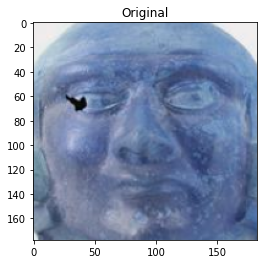

178 183
(209, 193, 392, 371)
209 isss [ 0.00068776  0.0814191   0.17871259 -0.10908025 -0.0376371  -0.0091845
 -0.02380039  0.11224019 -0.04609325  0.0402695   0.03273763 -0.10152024
 -0.03837711  0.0541736   0.17370327 -0.01424883  0.10637785 -0.07997282
  0.10393509 -0.09987454  0.04422792  0.12973528 -0.10335728 -0.00326345
  0.01674549  0.09029475  0.01330097 -0.01419947  0.14437383 -0.0432316
  0.00040295 -0.10009595 -0.01271822 -0.00471651  0.02898162  0.03096339
  0.08370155  0.06918713  0.127487    0.12198428 -0.03419248  0.06134252
 -0.12906073 -0.13048008  0.12113404  0.21431437 -0.01771501 -0.1261528
 -0.12364197 -0.20771144 -0.03113086  0.19775726 -0.02528321  0.01072654
 -0.0721183   0.02724231  0.08625212 -0.03039651 -0.10074119  0.07139515
  0.08063304 -0.06276003 -0.10163895 -0.0019483   0.00333887 -0.07865154
  0.10318962  0.12278491  0.1655966   0.06024545  0.06226656 -0.00984294
 -0.10462859 -0.11990497  0.09945088  0.028291   -0.10787325  0.18214405
  0.03384894  0.

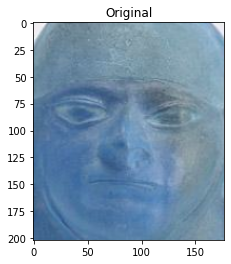

202 177
(203, 170, 380, 372)
203 isss [ 0.12492211 -0.12269867 -0.00750418 -0.1520093   0.07037359  0.12455208
  0.07343128  0.13490191 -0.15333223 -0.03554248 -0.0757117   0.05949749
  0.14895022  0.00675665  0.06537478 -0.12568898 -0.04055703 -0.03018092
 -0.06550494  0.13282344  0.08759066  0.02401538  0.07946874  0.0240765
 -0.11322679  0.04611951 -0.0711477  -0.18866266 -0.03038677 -0.01382533
 -0.07678694 -0.01973568 -0.10145383  0.05484986  0.00295993 -0.02332151
 -0.0742228   0.23947372 -0.09041512 -0.03436709 -0.00307938  0.0460237
 -0.17492534  0.09944143 -0.17905362  0.03390245  0.01617844  0.01597191
 -0.10143659  0.08979525 -0.02330277 -0.08021906 -0.02697276  0.06473665
  0.07507171 -0.0665545  -0.00769995  0.17238511 -0.01460577 -0.13743125
  0.01406579  0.0141789   0.1133448  -0.02226678  0.05176704 -0.13163275
  0.05827163  0.15143313  0.01896083 -0.02990745  0.06089273  0.05889736
  0.01872126 -0.02904009 -0.09090076  0.03169495 -0.1195671  -0.08366279
  0.15307279  0

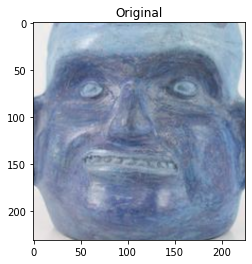

231 225
(179, 183, 404, 414)
179 isss [ 0.02576797  0.11313168  0.06327314 -0.17334926 -0.05628985  0.00712816
 -0.00906439  0.0964283  -0.13661413  0.09236636  0.03088322 -0.15984921
  0.05367272  0.1623112   0.23029023 -0.04802874  0.10833424 -0.11277498
  0.14213651 -0.10575801 -0.03505819  0.14388198 -0.09900866 -0.06993549
  0.01077262  0.0675121   0.02856729  0.0333715   0.14470159  0.01632086
 -0.04569633 -0.09423581 -0.03096462 -0.0512952   0.01396713  0.04227452
  0.04172717  0.04106004  0.11245049  0.12734738 -0.07790479  0.0368815
 -0.12533839 -0.05123441  0.05852877  0.27697954 -0.02324753 -0.04356857
 -0.13254684 -0.21002157 -0.0257232   0.18940341 -0.00269839 -0.02087438
 -0.10752314  0.0325362  -0.00158405  0.04100899 -0.03696104  0.06833438
  0.02872089 -0.03546182 -0.06766862  0.01912104 -0.02987567  0.00907583
  0.11285342  0.15060434  0.14428778 -0.0417679   0.08498189 -0.0052725
 -0.06640305 -0.14743474  0.09131806  0.0489431  -0.10803246  0.04010366
  0.06809705  0

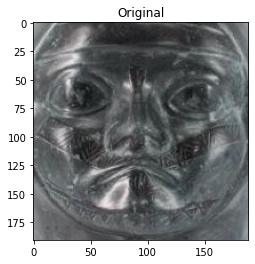

191 189
(205, 188, 394, 379)
205 isss [ 0.06154499 -0.04352757  0.17030574  0.07752843  0.02900789  0.16782859
  0.10025387 -0.02900137 -0.02903682 -0.03732295  0.00710556  0.06117463
 -0.03754276  0.01508686  0.18525413 -0.17799315 -0.07797597  0.00110675
  0.02860617  0.0055164  -0.03554321 -0.01399882  0.07456349  0.08513013
  0.09073669 -0.06242248 -0.09796234 -0.0669871  -0.02137608 -0.08211366
  0.05945138 -0.01511872 -0.09887689  0.02776652  0.05711827 -0.01347755
 -0.0187214   0.13188949  0.02848869 -0.03976196  0.14173257 -0.00076653
 -0.1521271  -0.12822151 -0.24226646 -0.14853728 -0.07584953 -0.06572087
  0.01063788  0.02487539 -0.02264773  0.01539125  0.06871019  0.05363199
  0.02911979 -0.01758671  0.00426947  0.13818555 -0.12129314 -0.02947045
 -0.10730261  0.02881882  0.07129876 -0.19668695  0.1260801   0.19760886
  0.12201008 -0.0397581  -0.1562031   0.07634277  0.01596537  0.16212736
  0.01262043  0.12754849  0.05285304 -0.04612147 -0.03919084 -0.19632193
  0.10619476 

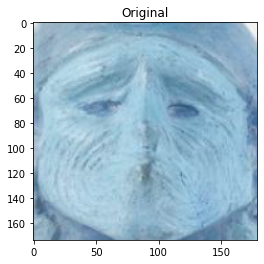

174 179
(208, 194, 387, 368)
208 isss [ 9.36293304e-02 -8.36436525e-02 -2.31868569e-02 -1.66865885e-01
 -3.87512632e-02  6.54589385e-02 -3.51798199e-02  6.18507862e-02
 -1.40171289e-01  5.79920448e-02  4.35130149e-02  6.54559955e-02
  1.31151825e-01  6.96295574e-02  5.49357980e-02 -4.11786095e-05
  2.30003963e-03 -5.19847982e-02  7.88265690e-02  3.14099267e-02
  9.77628827e-02  1.41423762e-01 -6.12522941e-03  3.15582752e-02
 -1.01687372e-01  1.97386205e-01  9.48823020e-02 -1.68589473e-01
  1.84655620e-03  1.07699342e-01 -1.36100665e-01 -6.43736050e-02
 -2.66476311e-02 -1.83624737e-02  4.63816617e-03 -1.47167696e-02
 -5.96892536e-02  1.72827050e-01  7.63027370e-02  9.89822820e-02
 -1.69641048e-01  4.46198173e-02 -1.78293630e-01  6.33678213e-02
 -1.39577147e-02  5.11608422e-02  2.31907275e-02 -7.70977661e-02
 -9.47870612e-02 -5.05475737e-02  1.12922281e-01  9.80143715e-03
 -2.46778484e-02  6.16676845e-02  1.94811113e-02  8.32694676e-03
  4.59213369e-02  1.30625546e-01 -5.37047572e-02 -1.

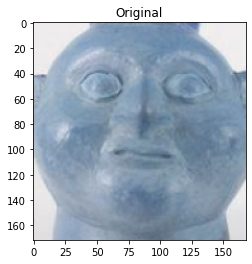

172 168
(208, 220, 376, 392)
208 isss [ 7.98296090e-03  1.49881929e-01  1.98835447e-01 -3.37028913e-02
 -1.14468355e-02  4.90341000e-02  5.36622107e-02  8.47218037e-02
 -9.42339003e-03  7.63743371e-02  4.64308113e-02 -1.01874344e-01
 -5.68374246e-02  6.69882149e-02  1.59164697e-01 -3.22925560e-02
  2.99814716e-03 -1.16637750e-02  3.57052721e-02 -1.43332258e-01
  9.23314914e-02  1.65503904e-01 -1.13097005e-01  6.25844393e-03
  6.26565367e-02 -2.89668106e-02 -3.16323224e-03  4.12578955e-02
  1.53633386e-01  7.02491030e-02 -8.63849446e-02 -1.33049443e-01
 -3.40559520e-02 -4.99884551e-03  6.17296286e-02  2.19096188e-02
  4.21911739e-02 -1.03490232e-02 -3.01653724e-02  6.93257898e-02
 -3.98516692e-02  5.52840196e-02 -4.69964407e-02 -1.92159805e-02
  2.55290549e-02  1.86022252e-01  2.32872814e-02 -1.04322135e-01
 -7.40361661e-02 -1.31206706e-01  1.10450417e-01  2.31453538e-01
 -1.12248890e-01  2.33806614e-02  7.23791346e-02  5.13966382e-02
  1.50456820e-02 -6.79173470e-02 -6.75015198e-03  3.

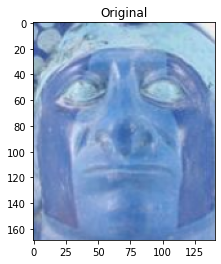

169 141
(230, 208, 371, 377)
230 isss [ 7.98264295e-02  5.83081730e-02  5.12692779e-02 -4.82897721e-02
 -6.49016276e-02 -8.95542875e-02  5.18935211e-02 -8.93639624e-02
  3.45994830e-02 -2.51281187e-02  1.09212682e-01 -1.95152033e-02
 -5.38336905e-03  2.21428499e-01  9.86004174e-02 -6.98199123e-02
  7.99276903e-02 -9.49966237e-02  1.20215207e-01 -7.82424361e-02
 -2.38835369e-03  2.09039450e-01 -1.60227790e-01 -3.55118923e-02
 -8.32488819e-04  1.00167222e-01  4.92338426e-02  1.07371613e-01
  7.38224760e-02  1.94928840e-01 -1.19385660e-01 -5.98345585e-02
  6.52190149e-02 -6.07003681e-02  5.52773438e-02  2.40839273e-02
  1.03429526e-01  5.39178327e-02  1.25009313e-01  8.69259089e-02
 -9.13684815e-02  1.01598978e-01 -3.72589156e-02 -4.21996452e-02
  3.47708985e-02  1.75462142e-01 -4.53822203e-02 -1.04407951e-01
  4.75092083e-02 -1.46993861e-01  1.99334715e-02  2.25336105e-01
 -2.53484701e-03  9.48512852e-02  7.13631064e-02  2.84021515e-02
 -4.66367714e-02  3.34254950e-02 -1.36751696e-01  1.

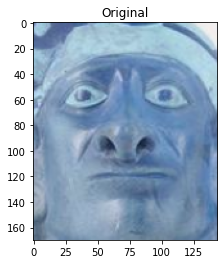

170 144
(228, 199, 372, 369)
228 isss [-0.05421298 -0.06998727  0.01893171 -0.07388616 -0.09231845 -0.01335953
 -0.05191319  0.02995953  0.00382402  0.05329508  0.0400684  -0.01532352
  0.02994956  0.15621474  0.15349604 -0.09657825  0.08696354 -0.08050512
  0.24935864 -0.0429619  -0.0561983   0.11270285 -0.03288378  0.03720029
 -0.06712709  0.14783818  0.07772613 -0.09279718 -0.00152186  0.01971414
  0.04299785 -0.2047339   0.09543531 -0.11032934  0.07516272  0.1263998
  0.06135727  0.10991901 -0.01500224  0.12321919 -0.08805063  0.15435235
 -0.18085596  0.02586582 -0.03662342  0.05719647  0.00096019 -0.08760642
  0.08410243 -0.13945729 -0.03020817  0.00731661  0.05971441  0.00359594
  0.02533414  0.10509714 -0.00488916  0.10071883 -0.01451525  0.05064546
 -0.05096589 -0.09661933  0.02569779 -0.06976507  0.11277669 -0.10961275
  0.16577049  0.02966561  0.11997063 -0.00847453  0.10386811  0.00507011
 -0.03424833 -0.11922756  0.03070923  0.02988246 -0.15145785  0.07125821
  0.05732986  

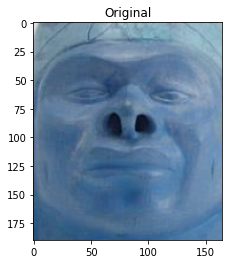

190 165
(209, 209, 374, 399)
209 isss [ 0.0281935   0.00444391  0.19622459  0.09773757  0.10362256  0.14475729
  0.03794369 -0.08757792  0.05557236 -0.07335267 -0.08196638  0.0491998
 -0.13600537  0.00157635  0.14597045 -0.09356228 -0.0336929   0.08070479
  0.06438139 -0.12924048  0.09350269  0.12962142 -0.01096851  0.04937867
  0.1489154  -0.08841461 -0.11047745 -0.08777632 -0.05140614  0.09075219
  0.08770115 -0.0301229  -0.03898459 -0.02170711  0.19984666  0.01200561
  0.00236714 -0.07108349 -0.01674588 -0.10714588  0.06271167  0.08258333
 -0.01604731 -0.04968444 -0.09586246  0.06868347 -0.01253483 -0.09005839
  0.01468617 -0.05355883  0.10230718  0.05571224  0.13219969 -0.03239199
  0.11021081  0.03583523  0.02944153  0.00817575 -0.06064807 -0.0375739
  0.03389169 -0.01525742 -0.0602664  -0.11808451  0.17098366 -0.05965725
  0.04164864  0.01211444 -0.06465369  0.24441698  0.10438382  0.13446513
 -0.02881103 -0.14969142 -0.09845932  0.09626412 -0.11678152 -0.05584802
  0.01450077  0

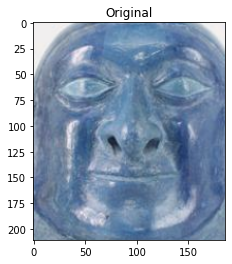

211 186
(202, 166, 388, 377)
202 isss [ 6.10018857e-02 -4.03421894e-02  1.94913700e-01 -6.39028382e-04
  2.93274294e-03  7.93259009e-04 -2.56211730e-03 -8.35769698e-02
 -5.03121503e-03 -6.57874867e-02  4.00864482e-02 -1.52702462e-02
 -7.29886517e-02  1.80151209e-01  1.62889391e-01 -6.95962384e-02
  3.90847586e-02 -3.58175226e-02  1.27170950e-01 -4.23988104e-02
 -1.32619739e-02  2.62822807e-01 -6.86601549e-02  8.23156908e-02
 -7.06341583e-03  1.98594350e-02  7.03510363e-03  8.34040642e-02
  5.38960956e-02  6.43927157e-02 -9.80868861e-02 -1.65867716e-01
  6.51381072e-03 -6.64327517e-02  1.23625487e-01  1.08876131e-01
  3.41054611e-02 -5.25845811e-02 -2.20077056e-02  2.82778591e-02
 -5.29721677e-02  1.43765852e-01 -7.34456629e-02 -9.62894559e-02
 -2.57372297e-02  1.87832281e-01 -5.18779047e-02 -3.75560112e-02
  5.72284386e-02 -5.08053266e-02  3.70418504e-02  1.23560704e-01
  5.75424470e-02  4.07990515e-02  1.17131472e-01  3.58999614e-03
  4.40866034e-03  1.45429410e-02 -6.03355430e-02  1.

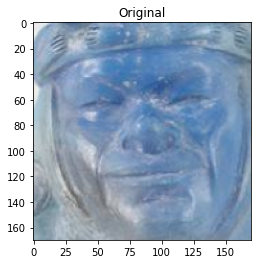

170 170
(203, 219, 373, 389)
203 isss [ 0.04376313  0.09499487  0.04698921 -0.14099447 -0.01726959  0.06240902
  0.03933157 -0.0281723  -0.0628673   0.01751966  0.03775488 -0.05520255
  0.01380502  0.08878099  0.08987437 -0.09397791 -0.02128625 -0.08932237
  0.08950226 -0.10891519 -0.00491601  0.15540317 -0.10147502 -0.09256614
 -0.02992517  0.10395784 -0.01419845  0.00986447  0.1177079   0.05507927
 -0.08059357 -0.11253984 -0.07006831 -0.09114403  0.07100945 -0.01011617
  0.03857055  0.04705271  0.15891512  0.12709332 -0.03450271  0.06156161
 -0.1705626  -0.07158235 -0.01452737  0.20298827 -0.05471881 -0.05409499
 -0.06115597 -0.17280892 -0.05872175  0.22422826  0.02204913  0.05361526
 -0.07840816 -0.00532374  0.080851    0.05351213 -0.1639129   0.07340328
  0.05399119  0.00173186  0.07475964  0.03628756 -0.02287508 -0.02700585
  0.14009064  0.14898004  0.15958567 -0.01015333  0.11647259  0.00792302
 -0.01878245 -0.09190146  0.1006862   0.09576704 -0.16903381 -0.03471547
  0.04127929 

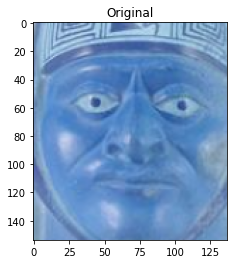

154 137
(223, 236, 360, 390)
223 isss [ 6.21860176e-02  1.53402269e-01  1.23736769e-01 -1.19976923e-01
 -4.95999381e-02  1.16825044e-01 -6.08872250e-02  3.04805078e-02
 -4.09590006e-02 -5.33234105e-02  3.96873020e-02 -1.20805822e-01
 -5.36323190e-02  8.65184441e-02  7.47098625e-02 -4.35010158e-02
  4.96110059e-02 -9.04508904e-02  4.82669882e-02 -9.71324593e-02
  3.13249901e-02  2.24080086e-01 -1.04115039e-01  5.55810938e-03
 -1.83294676e-02  2.22696234e-02  8.65775645e-02  9.44180563e-02
  1.39687940e-01  5.71087468e-03 -6.84858039e-02 -2.00195283e-01
 -6.03839494e-02 -3.42343785e-02  3.89824510e-02  6.76120371e-02
  5.45747578e-02 -3.28113958e-02  4.84148636e-02  1.38089702e-01
 -9.23577622e-02  4.96946052e-02 -1.11810334e-01 -7.11913928e-02
  8.76235515e-02  2.38348305e-01 -7.94968009e-03 -4.34147753e-02
 -1.27788678e-01 -7.96934664e-02  2.00951528e-02  2.75134206e-01
 -2.68161371e-02  5.38929328e-02 -3.20687145e-02  1.49708241e-04
  5.21117486e-02  1.13776121e-02 -6.35559335e-02  2.

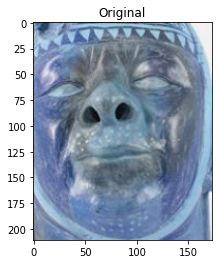

211 173
(219, 187, 392, 398)
219 isss [ 0.12274484 -0.11353865 -0.01065497  0.02425518  0.05289014  0.1441146
  0.06928426  0.07480497  0.10010367 -0.16521862 -0.12495816  0.06005954
 -0.02671497 -0.09389912  0.03601559 -0.09085107 -0.02254245 -0.10359941
 -0.00892527  0.02439753  0.09132345  0.09464329 -0.0571168   0.10805422
 -0.01728985 -0.04733294 -0.06011987 -0.2025549  -0.13321054  0.09204866
  0.02330242 -0.01037957 -0.0211868   0.04808311  0.10354671 -0.00736848
  0.10140235  0.01395376 -0.08707426 -0.13336633  0.05843376  0.01113817
 -0.01145401 -0.00642435 -0.00703455  0.04774886  0.01192892 -0.04844423
  0.02842412  0.05238251  0.02643546 -0.09030066  0.2060042   0.04121659
  0.21936262  0.0059217  -0.01928473  0.01240087 -0.01695035 -0.16555321
  0.02366526  0.00241228 -0.02653951 -0.13311571  0.02666763 -0.1028365
  0.06210926  0.03017637  0.01538115 -0.06730668  0.00478305 -0.03178008
 -0.07884891 -0.1874593  -0.04806919  0.12377271 -0.03667091 -0.03696259
  0.08118526  0

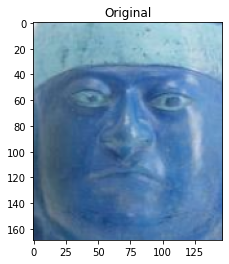

169 147
(224, 225, 371, 394)
224 isss [-0.0371605   0.07986122  0.04878794 -0.11761472 -0.06088866  0.07385917
 -0.08196381 -0.02053485 -0.03444642  0.01987775  0.06688379 -0.02994168
 -0.02253702  0.17128545  0.10824816 -0.07957783  0.00226812 -0.03929963
  0.15965714 -0.04287904 -0.04686577  0.19282092 -0.02246395 -0.0188547
 -0.05154077  0.08502067  0.06507745  0.05937536  0.14150688  0.02062308
 -0.04166291 -0.17601927  0.04157869 -0.13751292  0.03677516  0.11955655
 -0.01927533  0.07176654  0.04026397  0.19765921 -0.10647254  0.15567857
 -0.20038737 -0.0622866  -0.04972699  0.09908848  0.00125924 -0.10060118
 -0.02903106 -0.08873453 -0.0595309   0.22581296 -0.01765967  0.04773415
 -0.06913562  0.05940584  0.04801998  0.11516101 -0.12889051  0.08264074
 -0.07204766  0.02608893  0.1444259  -0.02509526  0.00755819 -0.03289492
  0.15451431  0.05314709  0.04041239  0.10810727  0.1593152   0.03104941
  0.00787374 -0.00265758  0.11578993  0.03121333 -0.1525798  -0.03324314
  0.00752335 -

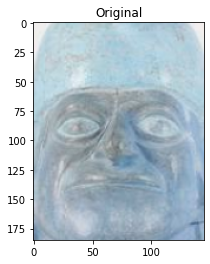

185 145
(227, 195, 372, 380)
227 isss [ 1.44788893e-02  8.28608945e-02  8.43938440e-02 -1.33559301e-01
  3.88150997e-02  1.33779064e-01  2.96454187e-02 -2.40692799e-03
  1.93459745e-02 -1.43766599e-02  3.12160794e-02 -1.55401519e-02
  3.57544646e-02  8.12342912e-02  1.35398760e-01 -1.28428280e-01
 -1.66600551e-02 -5.74231930e-02  2.57191435e-02 -3.09349801e-02
  6.28878549e-02  9.71639603e-02  3.01649161e-02  1.15605652e-01
  1.85582023e-02  4.00644029e-03  7.71955773e-02 -5.80117293e-02
  1.40696183e-01  3.13459747e-02  6.22061975e-02 -2.07600668e-01
  2.49275025e-02 -1.21455947e-02  9.26396996e-02  7.18628988e-02
  1.81520823e-02  1.61263928e-01 -7.51403794e-02  7.39003718e-03
 -9.16232169e-03  4.83314507e-02 -1.20788656e-01  1.15486346e-01
 -1.45241752e-01  9.86208096e-02  3.05011123e-02  2.45371722e-02
 -9.09997150e-02 -5.29893339e-02 -4.30026166e-02  1.04642972e-01
 -1.68663077e-02 -4.50225621e-02  1.06442355e-01  7.67909512e-02
 -8.72299969e-02  2.01572269e-01 -7.61298388e-02 -8.

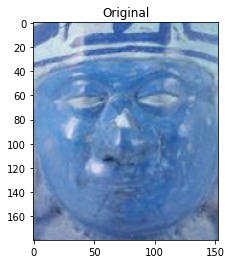

180 153
(224, 237, 377, 417)
224 isss [ 9.59712490e-02  1.07568912e-01  1.39559910e-01 -3.96108739e-02
  2.71433499e-02  1.52228683e-01 -1.39712514e-02 -9.51339751e-02
 -2.67782547e-02 -7.15122616e-04  4.01212424e-02 -3.46208625e-02
 -4.40870188e-02  8.28499943e-02  1.01610422e-01 -1.06704824e-01
  1.30177692e-01  6.72268569e-02  6.75036162e-02 -1.36586130e-01
  1.54951178e-02  2.28936613e-01 -1.64413005e-01  8.86514187e-02
  4.40958850e-02  3.57809588e-02  4.25241366e-02  7.59505183e-02
  1.06732242e-01  7.61805847e-02 -1.22560216e-02 -5.70154525e-02
 -1.15125120e-01 -3.83358225e-02  1.22792788e-01  1.55070191e-02
  5.96866757e-02 -1.09041959e-01  1.15840510e-01  2.30812412e-02
  1.01758679e-02  5.35784699e-02 -7.47464150e-02 -4.81125452e-02
  2.71646287e-02  1.35899469e-01 -3.40016373e-02 -1.47320563e-02
 -8.49266946e-02 -1.69583410e-01  1.16907604e-01  1.94392934e-01
  3.94437313e-02 -9.84272268e-03 -4.08154391e-02  3.01435646e-02
 -2.80818399e-02  5.62966093e-02 -5.73702566e-02  2.

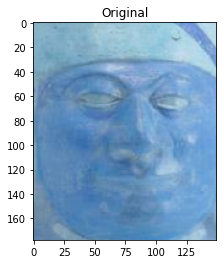

178 150
(209, 217, 359, 395)
209 isss [ 0.00660786  0.17183028  0.01870672 -0.13911816 -0.014576    0.13084665
 -0.04735184 -0.08938404 -0.03063205  0.07515935  0.06596319 -0.06795619
  0.00050935  0.14374694  0.10439643 -0.0766626  -0.02009798  0.0826836
  0.08944055 -0.08863294 -0.02610684  0.22355625 -0.02617345 -0.05638398
 -0.02014903  0.0546732   0.04755088  0.04309877  0.18867207  0.10722498
 -0.05759279 -0.05894744 -0.00882113 -0.11634365  0.11748522  0.05574463
  0.00281853  0.06707545  0.08741955  0.12426849 -0.11669037  0.09781519
 -0.15503061  0.03057085 -0.1119956   0.11975393  0.0281298  -0.01271596
 -0.08312148 -0.09596568  0.01092448  0.2805247  -0.04199045  0.01856901
 -0.08743829  0.03910936  0.06847411  0.0840765  -0.09487179  0.01402536
 -0.07237467 -0.03205282  0.17619394 -0.00355525 -0.00654412 -0.06724999
  0.12099233  0.07473541  0.02752619  0.19977064  0.16120394  0.04294324
  0.01438693 -0.04021786  0.02436915 -0.0240533  -0.18224484 -0.04371376
 -0.01661004 -

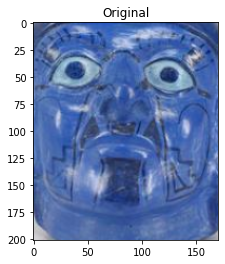

201 171
(211, 213, 382, 414)
211 isss [ 0.08931383  0.06510632  0.25176668 -0.07111839  0.09745634  0.166745
  0.09685121  0.13036704 -0.11993231  0.00661105 -0.056198   -0.10337825
  0.01272168  0.07639602  0.23152325 -0.07380471  0.09015229 -0.04498963
 -0.0882828  -0.08346777  0.01056086  0.1335141  -0.03708496 -0.03687466
  0.05810697 -0.08391037 -0.12913723  0.10630945  0.11036172 -0.12184956
  0.0259939  -0.05363304 -0.1629045   0.02771302  0.05554293  0.00702268
  0.00100753  0.03757722 -0.00578835 -0.04526338  0.08413351  0.06724751
 -0.05359209 -0.10476913 -0.07995516  0.13530633 -0.115809    0.01686035
 -0.11095566 -0.08408149  0.02976413  0.11287823 -0.0698052  -0.02085896
 -0.02873607 -0.06658944 -0.04734053  0.05456666 -0.0071885  -0.02160894
 -0.01224399  0.06525142 -0.11649655 -0.06898863  0.0534687   0.08427523
  0.04542682  0.14938238 -0.04378651  0.1205806   0.11953061  0.11314517
  0.05828779 -0.093805    0.00440047  0.07310157 -0.05381875  0.01639484
  0.11886243 -0

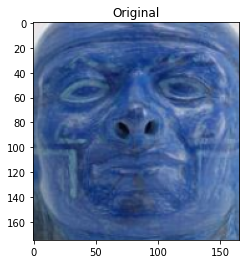

175 166
(208, 202, 374, 377)
208 isss [ 0.03881638  0.06900142  0.18214431 -0.02078176  0.08740581  0.05808936
  0.04400123 -0.01140753  0.0445959  -0.07174236  0.0303982  -0.00459571
 -0.07159655  0.05044987  0.09444617 -0.01763109  0.03402429  0.01280715
 -0.02764969 -0.08125298  0.12967236  0.16489692 -0.15692869 -0.02532555
  0.07117754 -0.00570683 -0.06181608  0.04599019  0.06193072  0.08253086
 -0.03752543 -0.09326842 -0.00814394 -0.0168557   0.14480367  0.05312496
  0.08132864 -0.06635299  0.03897605 -0.08338805  0.0483731   0.09551462
  0.07030537 -0.0327387   0.0155152   0.18654482  0.00787518 -0.11308279
 -0.09391917 -0.14296073  0.00104622  0.09441661 -0.04075845  0.03917775
  0.11310113  0.02826839 -0.10313787 -0.01783901 -0.14583875  0.0314745
  0.06564026 -0.08790061 -0.04576293 -0.0086538   0.10542977 -0.06512201
 -0.00141569  0.08835094  0.0592558   0.1348225   0.17109543  0.01140865
 -0.00578173 -0.24679288  0.01811003  0.16481489 -0.07977775  0.11696035
 -0.01130001 -

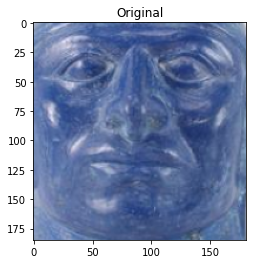

185 181
(205, 215, 386, 400)
205 isss [ 1.04342930e-01  5.49053913e-03  1.55800879e-01 -3.22760129e-03
  5.26133813e-02  1.41878054e-01  1.95965990e-02  3.82034034e-02
  7.57911205e-02 -1.28034502e-01  1.19753350e-02 -7.74682164e-02
 -8.67581517e-02  9.72169414e-02  1.43023401e-01 -8.98766965e-02
  5.13112806e-02 -1.15882590e-01  2.08174083e-02 -1.41119152e-01
  8.89053419e-02  1.56624913e-01 -5.17456345e-02 -2.96841506e-02
  1.08130537e-01 -8.00256431e-02 -7.17555583e-02  5.58919236e-02
  5.08594885e-02 -4.64162193e-02  1.16990671e-01 -1.54641494e-01
 -1.04856923e-01 -4.88515422e-02  6.82578236e-02  8.57019499e-02
  2.71930103e-03 -2.05626450e-02  5.21960892e-02  2.82009654e-02
  4.42388728e-02  1.62547395e-01 -1.43332407e-01 -1.00425474e-01
  4.32168180e-03  6.63293228e-02 -1.47565469e-01 -7.26423264e-02
  8.26170743e-02 -8.41579586e-02 -4.16380242e-02  2.21798792e-01
  2.10416242e-02  2.15032361e-02 -4.17287229e-03 -5.07266335e-02
  1.42399492e-02  3.66348140e-02 -8.52676183e-02 -1.

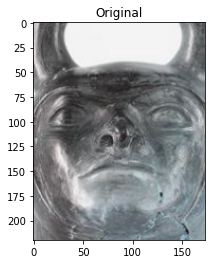

220 174
(210, 142, 384, 362)
210 isss [ 1.16994735e-02 -1.75131205e-02 -3.67753357e-02 -1.01583697e-01
  5.76499291e-03  1.38915226e-01  3.54116522e-02 -1.95346121e-03
 -2.25856714e-02 -2.93635875e-02 -2.63908897e-02  6.21703118e-02
  9.61618200e-02  8.23610127e-02 -1.29084820e-02 -1.53251886e-01
 -5.13411164e-02 -5.17753810e-02 -1.98651571e-02  1.16711378e-01
  1.90943107e-02 -2.47459169e-02  6.91079050e-02  9.41913277e-02
 -9.25383866e-02  8.89694765e-02  5.21416310e-03 -1.28354803e-01
  6.85547339e-03 -2.27492340e-02 -8.88748735e-04 -9.45100263e-02
 -3.57193835e-02  1.18211126e-02  3.02053317e-02  5.78643829e-02
 -2.40946244e-02  2.99985766e-01 -1.30528778e-01 -3.78471650e-02
 -8.39152467e-03  6.23185970e-02 -1.62747309e-01  1.08643927e-01
 -1.71133295e-01 -3.62751191e-03  5.11940233e-02  2.07131617e-02
 -6.31362423e-02  5.49600534e-02 -8.46458524e-02 -2.28168685e-02
 -1.07613152e-04  4.60336208e-02  1.49167404e-01  2.09366865e-02
 -6.91555813e-02  2.30620965e-01  2.27605342e-04 -1.

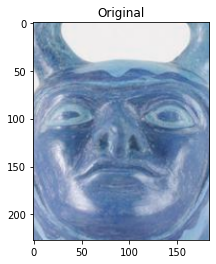

227 184
(209, 128, 393, 355)
209 isss [ 0.06475378  0.09107322 -0.01928585 -0.08602743  0.03569119  0.08267696
  0.06852138  0.00866114 -0.05370519  0.06919517 -0.011816   -0.05323765
  0.08557155  0.16412064  0.16586302 -0.1112322   0.12263631 -0.01830596
  0.01009795  0.05554559 -0.07698013  0.00494275  0.10827599 -0.04604344
 -0.02395994  0.01384657 -0.04317637 -0.0221452   0.11480122 -0.04119366
  0.01063212  0.09816711 -0.00788695 -0.01227579  0.01525641  0.04034088
  0.06027056  0.3325314  -0.00175156 -0.03867922 -0.0157263   0.05109217
 -0.18652733 -0.07226986 -0.20469299  0.14307953 -0.03961285  0.02451368
 -0.08730419 -0.04824412 -0.06436937  0.1949464  -0.00118733  0.00697959
 -0.01687406 -0.0310985   0.04463365  0.11193795 -0.03161412 -0.07564224
 -0.12120201 -0.02145394  0.09309487 -0.16181673  0.07578407  0.0759514
  0.08237192  0.16244727 -0.07142819  0.10953691  0.07724797  0.0468508
 -0.0305503   0.03907685  0.05022058 -0.02358387 -0.05027534 -0.03144521
  0.09681721 -0

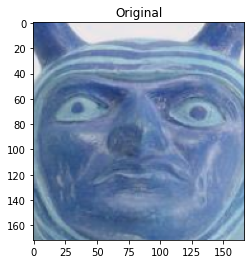

172 167
(208, 166, 375, 338)
208 isss [ 0.06238362  0.04230946  0.13367802 -0.15331812  0.01570357  0.02281464
 -0.03530857 -0.01334818 -0.00572647 -0.08826818  0.04378064 -0.06663363
  0.00850655  0.18803696  0.14427413 -0.07565558  0.0298864  -0.13382049
  0.01112504  0.0005455   0.02355718  0.22667876 -0.08851261 -0.02317037
 -0.03749792  0.06899563 -0.0021833   0.10745349  0.08238896  0.01263679
 -0.05794855 -0.17890725 -0.02628387 -0.0219217   0.07327179  0.11485644
  0.07975978  0.09189096  0.07817995  0.08256794 -0.04663317  0.13349736
 -0.09977392 -0.09767327  0.01903126  0.21108413 -0.04489876 -0.01365026
 -0.02748829 -0.06092352 -0.09102689  0.16518691 -0.0334397   0.09358615
  0.05107074 -0.03475708 -0.0496977   0.0673219  -0.15280062  0.04404454
  0.01180932  0.00550944  0.01684516  0.04104279 -0.05630459 -0.02595704
  0.11712906  0.18045324  0.12505582  0.04023798  0.17958872 -0.00389281
  0.01117997 -0.10180819  0.11319939  0.09200628 -0.1221427   0.01488878
  0.08369867 

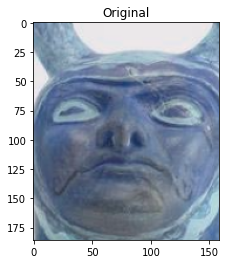

186 159
(211, 173, 370, 359)
211 isss [ 0.06840384  0.11257218  0.07414211 -0.09320088  0.07541779  0.01308002
  0.01643938 -0.00178698 -0.04486755 -0.08324175  0.0256041  -0.06816829
 -0.00215435  0.21346684  0.14765012 -0.09192822  0.17620869 -0.10890175
  0.03830866  0.01525592  0.00059388  0.11578126 -0.01534313 -0.03218493
  0.06227342 -0.0026853   0.02326128  0.10731207  0.12909558  0.00291546
  0.0135858  -0.10302858  0.01845888 -0.00195658  0.03393174  0.08453417
  0.07962119  0.1554037   0.01608029 -0.00447342 -0.00449894  0.13935034
 -0.03959182 -0.0328251  -0.08931867  0.26320344 -0.01344197 -0.0454934
 -0.07917214 -0.0918984  -0.08660264  0.20266756 -0.05440816  0.01206444
  0.0468815  -0.02436594 -0.08606905  0.12088673 -0.08890763  0.01322747
 -0.06210217 -0.03698945  0.02710539 -0.08504218  0.05922864 -0.00478824
  0.06116476  0.13910611  0.01227902  0.12111861  0.17343423  0.02973494
 -0.0246721  -0.09513525  0.09153096  0.07208784 -0.03296072  0.08124028
  0.04700455 -

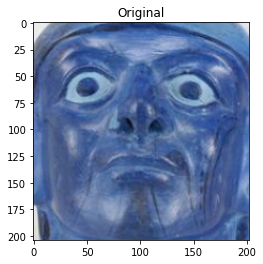

204 202
(194, 175, 396, 379)
194 isss [ 8.27727914e-02  1.73024878e-01  1.94674954e-01  1.99766160e-04
  3.34990360e-02  1.18157551e-01  6.79300502e-02 -6.92397263e-03
 -2.56275646e-02  6.54285355e-03  7.61725977e-02 -7.91706815e-02
  1.33604519e-02  3.58762741e-02  1.91385657e-01 -1.39824957e-01
  6.71267286e-02  3.79653238e-02 -5.98720126e-02 -8.74284878e-02
  5.10991812e-02  1.37626126e-01 -1.25771001e-01  1.25107709e-02
  1.13136716e-01 -1.15739062e-01 -8.70023966e-02  1.01372950e-01
  6.58102259e-02  6.91031292e-02  9.49750189e-03 -1.08989477e-01
 -5.51674850e-02  3.66134234e-02  1.37113407e-01 -1.28208078e-03
  7.05987066e-02 -4.75560315e-02  2.75937729e-02 -7.51503259e-02
  5.86821847e-02  1.18108317e-02  2.10402608e-02  7.43002584e-03
 -8.25596079e-02  9.35381427e-02 -3.99410687e-02  1.24229537e-02
 -9.84888300e-02 -8.71747658e-02  8.71492997e-02  1.47003502e-01
 -6.99546933e-02  3.06140748e-03  3.17699425e-02 -9.84668266e-03
 -1.68103203e-01 -3.62800173e-02 -4.37209830e-02 -5.

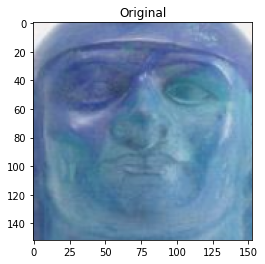

152 153
(229, 215, 382, 367)
229 isss [ 0.09630928  0.03259529  0.14650421 -0.06640059  0.05186052  0.09943432
  0.06901775  0.06846824 -0.11634659 -0.02828695  0.02422273  0.07505968
 -0.00229009  0.04192595  0.11052813 -0.0767478   0.00334204 -0.05881587
  0.01503562 -0.018603    0.09650677  0.20297885 -0.14491923  0.05317341
  0.02674014  0.05390556  0.00164232 -0.00153994  0.0309648   0.10538832
 -0.12802157 -0.11358895 -0.0852031   0.02276503  0.03947674 -0.00163819
  0.00400497 -0.02227542  0.0244569   0.05287093  0.01985991  0.06179364
 -0.00534115  0.0357897  -0.03843588  0.13471687  0.06135923 -0.13298145
 -0.1127883  -0.04640932  0.14163291  0.07907057 -0.11101948  0.07207115
  0.13802756  0.01460838 -0.10454636  0.08345932 -0.07698826  0.01439677
  0.06357639 -0.11159013  0.00577788 -0.00920803  0.05298878 -0.16462062
  0.07922652  0.07203273  0.06776834  0.0733832   0.13981162  0.09249627
  0.01355242 -0.13303486  0.00427968  0.12544821 -0.09924871  0.07230748
  0.05373842 

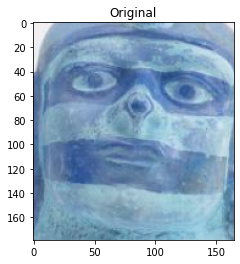

179 165
(205, 205, 370, 384)
205 isss [ 0.10095612  0.00301974  0.11770856 -0.00895647  0.15871261  0.17490079
  0.07438683 -0.08594924 -0.01792879 -0.19844608 -0.04151397  0.10309089
 -0.01719346  0.09102938  0.02737025 -0.08148073 -0.02893871  0.01917197
 -0.05090939  0.0213872   0.1581811   0.14886029 -0.02943242  0.01225664
  0.04398148 -0.0118807  -0.11309697 -0.02309973  0.04254599  0.11233539
 -0.05057811  0.00533093 -0.0821084   0.00352661  0.15196262  0.01803668
  0.02901256  0.04593312  0.0073932  -0.12993218  0.07996774  0.10926493
  0.03470665 -0.02027119 -0.163529    0.08921827  0.04131099 -0.06476346
 -0.061009   -0.03021787  0.0079596   0.05588676  0.0225654   0.08261935
  0.17571191 -0.01999994 -0.04293403  0.14581446 -0.14680928 -0.06065707
  0.01527843  0.0265767   0.10322262 -0.08148106  0.13660783 -0.0302892
  0.02755206  0.065068   -0.04842589  0.15736319  0.134694    0.07334505
  0.02201163 -0.1191176  -0.02436437  0.13004778 -0.07744801 -0.07638652
  0.04692036  

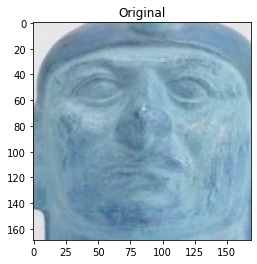

169 169
(207, 210, 376, 379)
207 isss [ 0.05502314 -0.02006772  0.10922118 -0.07586399 -0.04128144  0.04621423
  0.08259377 -0.01030383 -0.04526099  0.01077984  0.07115861  0.00159691
 -0.04206172  0.0945114   0.17208706 -0.16213308 -0.09721347 -0.01331732
  0.14743981 -0.08712165 -0.03426727  0.1890716  -0.12726216 -0.10539549
 -0.04028333  0.15761155 -0.05430396 -0.01934437  0.06669401  0.02735163
 -0.07652562 -0.06475505 -0.01703667 -0.0772019   0.14502123  0.03586135
  0.01463703  0.05145013  0.12805091  0.02896254  0.02559201  0.07523466
 -0.13408525 -0.00176381 -0.11313666  0.05715805 -0.03603581 -0.08488053
 -0.02925456 -0.12882122 -0.10819634  0.14973241  0.02295363  0.10545322
  0.02931773  0.02268922 -0.00968852  0.06222755 -0.19001159  0.06277511
 -0.0303676  -0.06405538  0.12292689  0.04129091  0.02248747  0.07718468
  0.15565081  0.00912856  0.1096926   0.02092901  0.11647461  0.0096103
  0.04365341  0.04106864  0.02264224 -0.04001188 -0.17247288 -0.1558938
  0.04971476 -0

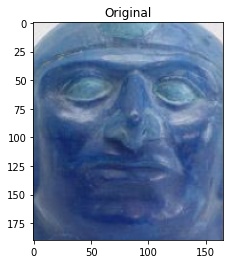

190 166
(211, 195, 377, 385)
211 isss [ 8.96453932e-02  2.03223843e-02  1.38633773e-01 -5.00394702e-02
  1.06987961e-01  1.44225627e-01  1.14724264e-01 -6.92405878e-03
 -1.34834489e-02 -7.86046609e-02 -4.13623638e-02  6.07913211e-02
 -2.46035140e-02 -2.15615835e-02  3.94677892e-02 -5.90206794e-02
 -4.65903245e-02  1.00174500e-03 -3.03618629e-02 -3.21975425e-02
  1.42693326e-01  1.83416992e-01 -1.01319194e-01  8.56750533e-02
 -1.61358044e-02  1.71790253e-02 -7.80404508e-02 -8.02783072e-02
  7.88465962e-02  9.79276747e-02 -7.99072012e-02 -1.11504175e-01
 -1.16160825e-01 -2.49784645e-02  1.74449295e-01 -2.98351552e-02
  3.27930264e-02  4.87145446e-02 -9.54810902e-03 -6.48350567e-02
  3.11835650e-02  1.17589131e-01 -2.25593131e-02  2.71186121e-02
 -9.13845375e-02  1.27133355e-01  3.83179300e-02 -6.95647523e-02
 -1.01470836e-01 -4.67308871e-02  4.37593535e-02  1.95750780e-02
 -1.31321345e-02  4.50893901e-02  1.73244566e-01 -1.12545953e-04
 -4.80044708e-02  1.35953039e-01 -1.16866268e-01 -5.

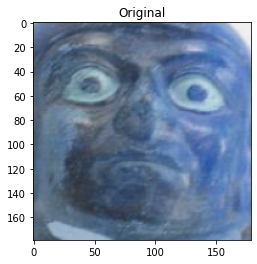

179 179
(219, 206, 398, 385)
219 isss [ 0.01135384  0.08872963  0.19461638  0.01286091 -0.04945215 -0.00827117
 -0.01485883 -0.05655224  0.08357518 -0.01986576  0.10696787 -0.02658992
 -0.10496064  0.08407807  0.07776071 -0.03917496 -0.03289913  0.00346083
  0.0515155  -0.10828003  0.04897054  0.22293422 -0.1399395  -0.02664136
  0.01582898  0.03481215  0.01825303  0.09351075  0.10346096  0.09856101
 -0.10967993 -0.06680164  0.03719466 -0.03431743  0.08484834  0.05444754
  0.08894555 -0.05666864  0.06487572  0.07994302 -0.01546264  0.05064417
 -0.05689687 -0.11237159  0.04485535  0.12667404 -0.01778328 -0.12257747
  0.00827098 -0.12922966  0.04526605  0.26815045 -0.03354349  0.10498399
  0.05779582  0.026479    0.04359563 -0.13986255 -0.14729972  0.09519383
  0.05966179 -0.11488723 -0.05499282  0.0617121  -0.01772059 -0.06223505
  0.12401881  0.00824708  0.14374645  0.18008693  0.0993763  -0.03084977
  0.00414151 -0.06932396  0.08311052  0.04778398 -0.096653    0.07995399
 -0.06843681 

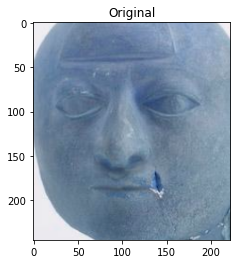

245 222
(168, 121, 390, 366)
168 isss [ 0.06495219  0.07833052  0.00833444 -0.1776805   0.04545666  0.12377108
  0.00576556  0.15203632 -0.09539843  0.020206    0.00583855 -0.01761308
  0.09027702 -0.01253075  0.11789203 -0.08877698 -0.06147529 -0.03870689
 -0.07415958  0.05639189  0.07365166  0.10566981  0.10944077 -0.05346962
 -0.06278651 -0.00799905  0.00691495 -0.10974862  0.0181617  -0.01688346
 -0.05723533 -0.12943533 -0.02873475  0.04624514 -0.01082312 -0.01129429
 -0.02331688  0.20230451 -0.06894258  0.1107109  -0.03397844  0.05483195
 -0.17281675  0.10594109 -0.19635487  0.07829293  0.03980816 -0.02345959
 -0.0867378   0.10544918  0.0421602   0.08938921 -0.16637832  0.08057902
  0.00865137 -0.05625344  0.05981158  0.0463442  -0.01111834 -0.11580119
 -0.03938809 -0.09280167  0.09049629 -0.02373986  0.0242174  -0.22050802
  0.07371715  0.18882488  0.09286123  0.11260828  0.13969532  0.12426961
  0.02591923 -0.05475287 -0.00557048  0.03454218 -0.19640279  0.03912493
  0.05052702 

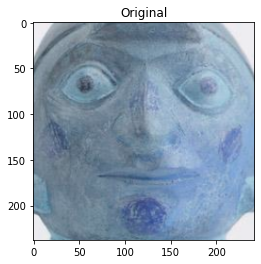

238 242
(197, 84, 439, 322)
197 isss [ 0.00561299 -0.02448534  0.05251729 -0.09544978 -0.10455833  0.01160493
  0.06276054  0.09723649 -0.00335679  0.08283295  0.09079124 -0.07902414
  0.05866936  0.11254535  0.18685116 -0.07672355  0.01182854 -0.08507427
  0.14337878 -0.10289574 -0.00846944  0.10364714 -0.03541847 -0.06197361
 -0.06287283  0.13868877 -0.00680938 -0.10227972  0.12745227 -0.00951477
  0.02443425 -0.04157103  0.00533936 -0.09122212  0.03656073  0.01842557
  0.03931237  0.21968038  0.1005857   0.1663555  -0.0314018   0.09477631
 -0.27763703 -0.03535239 -0.0501548   0.01745169 -0.07628212 -0.10505952
  0.03903766 -0.22448038 -0.07412904  0.1467542   0.02273276  0.0357322
 -0.09013956  0.04130634  0.08999689  0.06623879 -0.08041394  0.05112514
 -0.06691815 -0.13779837  0.04432989 -0.0206101   0.02800067 -0.00756151
  0.20053387  0.0875687   0.16099104 -0.04131895  0.07469988  0.03696167
 -0.0272129  -0.00746855  0.07007369 -0.04751851 -0.17661814 -0.01699038
  0.01836152  0

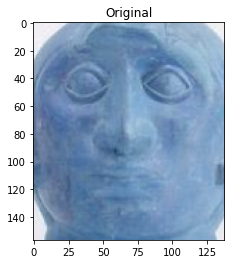

157 138
(230, 218, 368, 375)
230 isss [ 9.60807949e-02  2.43244078e-02  9.63130686e-03 -9.32977349e-02
  2.15469438e-04  1.75363332e-01 -9.49023571e-03  1.40574694e-01
 -4.29559611e-02  1.50818909e-02  5.98076209e-02  2.21580099e-02
  3.95682827e-02 -3.85217778e-02  1.23136252e-01 -1.18446358e-01
 -7.49577582e-02 -5.72930686e-02 -1.44523438e-02 -7.23486114e-03
  5.94904497e-02  1.22206338e-01  1.21683426e-01  1.04119675e-02
 -4.75657210e-02 -2.83882599e-02  8.42122287e-02 -1.59018353e-01
 -4.10542190e-02  3.62817518e-05 -4.69534583e-02 -1.48470312e-01
 -5.80821466e-03  4.37779687e-02 -1.21965380e-02 -5.48618892e-03
 -3.58121432e-02  1.15987279e-01 -8.45188573e-02  1.31725997e-01
 -3.92182805e-02  4.37339186e-04 -2.52540767e-01  9.17453989e-02
 -1.93176448e-01  5.24523221e-02  7.94743828e-04 -4.99898382e-02
 -6.02779761e-02  1.14234239e-01  1.12881288e-01  1.47810772e-01
 -8.92629251e-02  5.11571206e-02  1.13148466e-02 -1.40422340e-02
  8.36170018e-02  1.88780446e-02 -2.28619706e-02 -4.

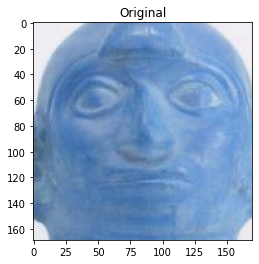

169 170
(219, 175, 389, 344)
219 isss [ 1.14141375e-01 -5.12576774e-02  1.72445718e-02 -7.28660524e-02
  4.48624976e-02  1.23573035e-01  1.34281725e-01 -1.30877845e-04
 -1.15079887e-01  1.09857701e-01  9.60778743e-02  3.70611995e-02
  4.00839932e-02  1.33208260e-01  1.93463206e-01 -1.34006500e-01
 -4.96483333e-02  6.69357777e-02  1.12416610e-01 -7.92360008e-02
 -2.12426018e-03  1.44352674e-01  1.71483159e-02 -6.54244944e-02
 -8.23362824e-03  7.20688850e-02 -4.65892581e-03 -5.99277578e-02
  6.83891103e-02  6.99274763e-02 -9.50326324e-02 -4.94759604e-02
 -7.41765797e-02 -7.49036521e-02  8.68034214e-02 -2.85108183e-02
 -8.79557580e-02  1.00679241e-01  8.58825371e-02  6.47452921e-02
 -2.85413861e-02  1.06912203e-01 -1.89519361e-01  7.29493871e-02
 -2.51401603e-01 -4.74825092e-02 -7.27207139e-02 -4.40251231e-02
  3.00000627e-02 -9.45175961e-02  6.01877198e-02  1.17251068e-01
 -7.00837597e-02  4.87151295e-02 -3.10002808e-02  7.08504627e-03
  2.44142227e-02  1.69632137e-01 -8.47543925e-02  7.

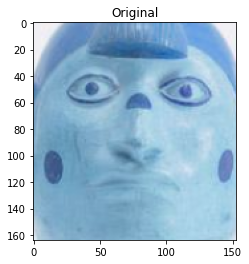

164 153
(231, 157, 384, 321)
231 isss [ 0.03275843 -0.07997347  0.10508052 -0.16134943  0.05906877  0.13868168
 -0.01130836  0.15558566 -0.17832227 -0.0147771  -0.05831669 -0.0360463
  0.05628278  0.01713694  0.251137   -0.10503821 -0.09249808 -0.07832093
  0.03023941  0.06351864  0.05306903  0.04914499  0.13027917 -0.04094303
 -0.0112172   0.05264845 -0.07542787 -0.17212379 -0.01486589 -0.15369463
  0.03953509 -0.13350047 -0.08220747  0.03222258  0.05389166  0.0856619
 -0.0603175   0.17739505 -0.03676351  0.02289272  0.03944037  0.05204533
 -0.17053044  0.07137556 -0.18355812  0.08121849  0.05014578 -0.00422646
 -0.11751509  0.05675806 -0.08397956 -0.0530141  -0.070752    0.04392279
  0.03499996 -0.05342471  0.00305058  0.14025784 -0.04242503 -0.08678191
 -0.02849666  0.03047131  0.0609213  -0.02074707  0.12179528 -0.0508618
  0.05553339  0.15444197  0.07622845  0.07844047  0.09197073  0.16593497
  0.01926799 -0.0131694   0.00426204 -0.02260703 -0.1900467  -0.02961343
  0.15332553  0.

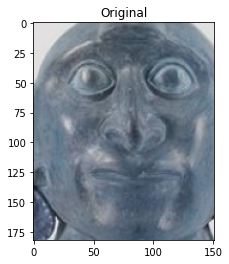

182 151
(217, 190, 368, 372)
217 isss [ 5.62753156e-02 -2.06748843e-02  7.22203031e-02 -1.28908157e-01
  3.45051615e-03  8.85766596e-02 -4.32504863e-02 -1.21692494e-02
  9.59357992e-03 -5.14715351e-02  5.80639206e-02 -5.73598109e-02
  4.67216317e-03  2.52716869e-01  1.55270785e-01 -4.41842116e-02
  5.63582666e-02 -4.70771194e-02  7.25981295e-02 -1.60487592e-01
  2.79540550e-02  2.53882468e-01 -8.32203999e-02 -4.23173979e-02
 -1.16182659e-02  4.53505330e-02  7.12402910e-02  8.33279714e-02
 -2.49888725e-03  5.42004071e-02 -1.88259222e-02 -1.63033903e-01
 -1.59930717e-02 -7.21172318e-02  6.53594285e-02  1.39225185e-01
  3.74890328e-03 -5.94668202e-02  4.84407656e-02  1.39115974e-01
 -6.38825744e-02  1.81071445e-01 -8.46488476e-02 -1.05827786e-02
  1.79624856e-02  1.24721229e-01 -8.07191506e-02 -6.01589270e-02
  3.28538828e-02 -1.41565591e-01  1.51399691e-02  8.62447396e-02
 -1.83042884e-02  4.55914140e-02 -1.53567223e-02  6.51720241e-02
 -3.81474122e-02  1.06393203e-01 -5.19641973e-02  1.

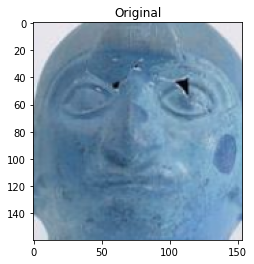

160 154
(219, 192, 373, 352)
219 isss [ 0.00287775 -0.02504389  0.01251283 -0.07500982 -0.09748236  0.06355268
 -0.02889723 -0.02053342  0.05857132  0.00029917  0.09558517 -0.09575512
  0.02002238  0.21082507  0.18465318 -0.07274486 -0.03710122 -0.05968177
  0.12321018 -0.13145985 -0.04375084  0.20050514 -0.01243268 -0.10687831
 -0.06477061  0.0680736   0.01092758 -0.01309013  0.0436088   0.04094298
  0.03580821 -0.06765863  0.03441413 -0.13623528  0.05826427  0.14601724
 -0.00724053  0.0707192   0.03408037  0.19334975 -0.07965165  0.13775751
 -0.24122737  0.0134239  -0.05701238  0.04231371 -0.07707947 -0.0646901
  0.10198697 -0.14325549 -0.05558459  0.15557976  0.03240034  0.03835415
 -0.09408902  0.05498965  0.03615968  0.06338775 -0.0280794   0.08525682
 -0.12032135 -0.06457085  0.06070294  0.00346431 -0.00592404 -0.03317551
  0.20435959  0.07804322  0.13955478  0.07332116  0.15991922  0.02271883
  0.04221424 -0.06555753  0.02906943 -0.01328037 -0.20702362 -0.12341093
 -0.07553367  

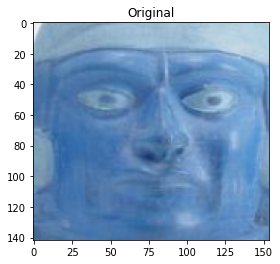

142 154
(220, 243, 374, 385)
220 isss [ 4.36051041e-02  7.78319314e-02  2.18617231e-01 -9.78838187e-03
 -1.57468226e-02  7.70591274e-02 -2.29217801e-02 -2.27871239e-02
 -4.61189891e-04 -3.77844553e-05  8.60371590e-02 -3.81322913e-02
 -6.33939132e-02  6.60169125e-02  1.27368391e-01 -2.85737421e-02
 -1.15365358e-02  3.95482071e-02  3.93118225e-02 -1.07869290e-01
  9.79032591e-02  2.24134624e-01 -8.08488801e-02 -2.96238740e-03
  2.28947122e-02  9.32060461e-03 -3.09865717e-02  1.31184300e-02
  9.84430239e-02  8.09563920e-02 -6.92044497e-02 -1.24515131e-01
 -3.25853527e-02 -4.70205434e-02  1.20609596e-01  5.15569337e-02
  2.01340970e-02 -1.34884156e-02  7.50901029e-02  8.52847025e-02
 -8.11379775e-02  9.89882424e-02 -1.38921693e-01 -9.11502093e-02
  1.66199659e-03  1.31389543e-01 -2.38353088e-02 -1.14424698e-01
 -4.55478467e-02 -9.88996327e-02  8.33595246e-02  2.48253912e-01
 -5.65908104e-02  6.51548952e-02 -1.55601241e-02 -7.02219782e-03
  8.16782266e-02 -7.08870515e-02 -1.20357506e-01  7.

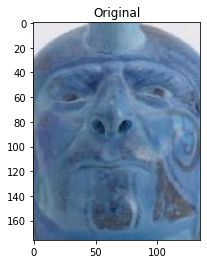

176 135
(232, 216, 367, 392)
232 isss [-0.00919324  0.01959266  0.21580961  0.03484638  0.06345916  0.02231772
  0.01859628 -0.14913534  0.01446152 -0.10332572 -0.02269788  0.03480367
 -0.06457251  0.14221372  0.07968192 -0.1023391   0.11135007  0.07711589
  0.02241667 -0.0223308   0.01319887  0.15116455 -0.12213242 -0.01807428
  0.01413714  0.07105159 -0.15072167  0.0649142   0.08228349  0.04363183
  0.00783078  0.11052361  0.01375347 -0.03831758  0.16347855  0.06539067
  0.08023854  0.03884086  0.04133361 -0.11698436  0.09749559  0.11137299
 -0.00801446 -0.15255117 -0.02952752  0.17310719 -0.01861136 -0.06347895
 -0.05289848 -0.19500408 -0.06240462  0.14522131  0.12756658  0.01006787
  0.06141341  0.03376491 -0.01297154  0.00656888 -0.12955983  0.03787106
  0.01811354  0.06915008 -0.06068457  0.00445013  0.09146844  0.07169333
  0.08564146 -0.00472214 -0.04138954  0.13114187  0.11791641 -0.09971968
  0.01087726 -0.07824311  0.02301815  0.08336774 -0.10036752 -0.06462366
  0.02150883 

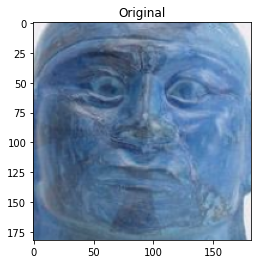

182 182
(217, 202, 399, 384)
217 isss [ 5.42571247e-02  5.64309657e-02  7.63928592e-02 -9.78152007e-02
 -2.54517067e-02  1.68262813e-02 -1.93834957e-02 -3.38397659e-02
  1.75761078e-02 -9.14697573e-02  8.38016272e-02 -8.79397169e-02
 -5.46745770e-02  2.37189829e-01  1.68021098e-01 -9.70336348e-02
  2.63563655e-02 -1.11228026e-01  9.50568914e-02 -7.49178827e-02
 -5.39576784e-02  2.34329939e-01 -3.44299786e-02 -1.22064643e-01
 -9.24783200e-03  2.01786775e-02  7.36422688e-02  1.00687206e-01
  6.49047270e-02  1.51478052e-02 -4.77083661e-02 -1.46105006e-01
  5.20973727e-02 -8.18732306e-02  5.64560220e-02  1.28139794e-01
  5.50513268e-02  4.42494899e-02  2.81862151e-02  1.22186385e-01
 -5.31146899e-02  1.41698599e-01 -1.32926151e-01 -4.28394675e-02
 -5.85373789e-02  2.37964869e-01 -6.26472831e-02 -9.10357311e-02
 -1.44439237e-02 -9.84794125e-02 -9.33045745e-02  2.23289043e-01
 -7.35734496e-03  7.39298612e-02 -3.90441529e-02  1.06274746e-02
 -1.48331206e-02  4.05462198e-02 -1.26292631e-01  1.

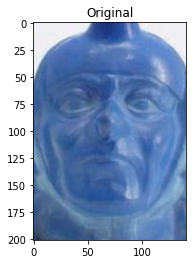

201 141
(237, 209, 378, 410)
237 isss [ 0.14004494 -0.06603557  0.04717679 -0.10615371  0.09395256  0.08396948
  0.09138287  0.03805906 -0.10196879 -0.10544193 -0.04924795  0.03114466
  0.03341945  0.09982728  0.10038339 -0.11567185  0.02390116 -0.09268574
  0.05212632  0.03729238  0.08152834  0.13912785 -0.04219091 -0.02860313
 -0.02485948  0.10820631 -0.06972634 -0.09333288  0.03473493  0.02842284
 -0.05799879 -0.0729344  -0.11501704 -0.01882981  0.10146073 -0.00658208
  0.01382454  0.17985874  0.06223272 -0.03493929  0.0224991   0.15767886
 -0.11771029  0.01667475 -0.11854644  0.12818648 -0.00737004 -0.06841337
 -0.03408932 -0.0546682  -0.06116746  0.03440992  0.01635584  0.08859804
  0.09494459 -0.05996144 -0.00534453  0.17432499 -0.11939908 -0.05224009
  0.0519509  -0.03408433  0.09345788 -0.03055169  0.0770207  -0.09296792
  0.11625699  0.13568462  0.12520546 -0.0187137   0.1354249   0.09653155
  0.02564575 -0.07655162 -0.04541637  0.06568135 -0.13646705 -0.05291521
  0.11290938 

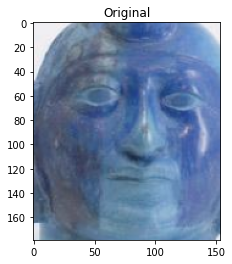

179 154
(218, 209, 372, 388)
218 isss [ 1.25312731e-01 -1.30842090e-01 -2.00990401e-03 -7.35414624e-02
  1.17811620e-01  1.36855617e-01  9.47824344e-02 -2.24361560e-04
 -5.60183898e-02 -7.49140009e-02 -5.77678159e-02  1.91063702e-01
  7.88721219e-02  1.64263546e-02  2.35220045e-03 -1.31057367e-01
 -7.30490386e-02  6.76053902e-03 -7.45532438e-02  1.19820498e-01
  4.63430993e-02  1.13926202e-01  9.47822481e-02  9.31970552e-02
 -1.44831896e-01  4.97465655e-02 -2.23254114e-02 -1.40540406e-01
 -8.03261176e-02  6.47016913e-02 -1.37563288e-01  1.60459299e-02
 -7.18291029e-02  6.76751360e-02  3.88126075e-02 -3.51526216e-02
 -1.38533730e-02  1.99187070e-01 -8.76112580e-02 -1.53333042e-02
  1.55668780e-02  7.99465850e-02 -1.29980236e-01  2.30873339e-02
 -2.54793108e-01 -3.79498936e-02  9.18917172e-03 -1.36460504e-03
  7.07255397e-03  1.74021319e-01  5.62949404e-02 -7.60291517e-02
 -2.33072415e-02  1.26723468e-01  1.73894614e-01 -5.95813692e-02
  3.32113765e-02  1.67999730e-01 -9.12049860e-02 -7.

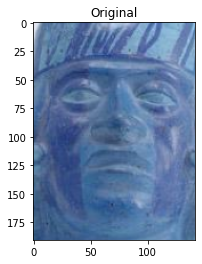

191 142
(222, 196, 364, 387)
222 isss [ 0.11519283 -0.02689146  0.01657534 -0.16108482  0.06868863  0.11032136
  0.04459621 -0.00064153 -0.00281313 -0.15304166 -0.02463462  0.00736428
  0.03228094  0.12446053  0.04049513 -0.13245572 -0.05227122 -0.09575782
 -0.01158331 -0.00607623  0.05927997  0.19495185 -0.02834485 -0.08875064
 -0.07686708  0.03484308 -0.00345073 -0.01405239 -0.00860061  0.05811061
 -0.09019516 -0.12796637 -0.04327951 -0.04422674  0.10892735  0.02594668
  0.03671973  0.11746261  0.02573228  0.01725545 -0.01315902  0.13380304
 -0.12871501 -0.00342143 -0.09857357  0.17259541 -0.05287857 -0.02760606
 -0.03504753 -0.0135734  -0.11672646  0.1123333   0.04380181  0.1191831
  0.04197085 -0.05621578  0.01452797  0.08991793 -0.17776422 -0.0370389
  0.04022544  0.02138974  0.12244194  0.01343961 -0.00931221 -0.08869601
  0.11190245  0.19943853  0.13412601  0.0315052   0.17436801 -0.00598312
  0.01798266 -0.1415298  -0.00036358  0.14249314 -0.1651154  -0.11911456
  0.05016242  0

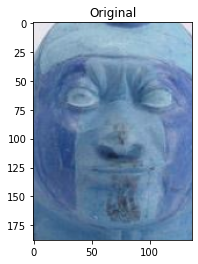

188 137
(232, 209, 369, 397)
232 isss [ 0.00897598  0.06973585  0.1967581  -0.12632467  0.0262029   0.0984156
 -0.01804646  0.0870261  -0.12786616  0.06673359 -0.05921268  0.02027121
 -0.0016802   0.02205618  0.22747281 -0.11833342 -0.00057409 -0.06056657
  0.11397227  0.00833693  0.00940481  0.13011627  0.04413052  0.10251696
 -0.00087997  0.04824432 -0.00501077 -0.08787267  0.07481506  0.00390029
 -0.0410813  -0.14222816 -0.01047734  0.02988379  0.045947    0.01429009
  0.04828397  0.12457385  0.01701174  0.08919562 -0.01810236  0.03764607
 -0.13712151 -0.09349699 -0.11544897  0.17678839  0.06547336 -0.08181119
 -0.11785503  0.03264554  0.07756086  0.143106   -0.01442889  0.03553392
  0.07757283  0.01210733  0.11692452  0.0398057  -0.08020957 -0.03122259
  0.01558246 -0.01560859 -0.02469648 -0.06575309  0.06221773 -0.12933174
  0.08000597  0.10200205  0.00931544  0.14053015  0.07551966  0.09574677
 -0.10432525 -0.02163781  0.0807446   0.07970839 -0.15058963  0.07737377
  0.17095554  

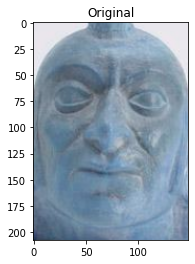

208 148
(216, 177, 364, 385)
216 isss [ 0.09662703  0.02851039  0.00493183 -0.12538674 -0.03313591  0.10988009
 -0.00781744 -0.01518462 -0.02796746  0.02890908  0.08897938  0.00812167
  0.00995423  0.15762714  0.08984921 -0.09456901 -0.0088472  -0.0263165
  0.09540161 -0.07191585 -0.0188213   0.27276963 -0.03368489  0.08472414
 -0.06942751  0.05967733  0.1985325   0.06701698  0.04587131  0.12458966
 -0.15014823 -0.20010146  0.02153417 -0.00235335  0.0404744   0.03961804
  0.0145891   0.01068997 -0.02478953  0.14023888 -0.1219634   0.07762332
 -0.08863964  0.08042823 -0.0893773   0.05650456 -0.00434334  0.00067057
 -0.00334916  0.05078378  0.14152141  0.15362911 -0.0542565   0.07429897
  0.1051643   0.05348003 -0.02149621  0.1183088  -0.02987738  0.01663899
 -0.05938037 -0.08259334  0.13759647 -0.00374693 -0.03052146 -0.10829647
  0.08671503  0.05735745  0.04150249  0.17667817  0.09148953  0.00631102
  0.00398552 -0.05519327  0.02147682  0.01797869 -0.08142699 -0.01416227
  0.02204257  

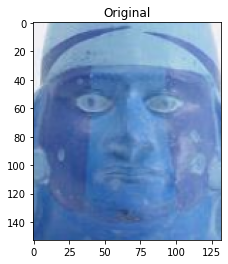

153 132
(230, 235, 362, 388)
230 isss [ 0.06795614 -0.01538193  0.19966047  0.0106713   0.05777827  0.08006227
  0.12396434  0.07525253 -0.1900655  -0.03817976 -0.03694579  0.06667938
 -0.05554128 -0.00791736  0.15584275 -0.1700411  -0.04346624  0.04721928
  0.1009096  -0.00347884  0.04586111  0.09857685 -0.04132154 -0.03593807
  0.04825035  0.06536338 -0.16127926 -0.06980355  0.06971841 -0.01103039
 -0.05074824 -0.02427609 -0.10774133 -0.00901901  0.11884543 -0.05621916
 -0.0177167   0.07714304  0.06832837 -0.03115035  0.10553908  0.10880728
 -0.051566    0.00421713 -0.2090767   0.00416037  0.07516234 -0.15948893
 -0.07122911 -0.01450857  0.00531669  0.07606045 -0.06051136  0.0961979
  0.07365719 -0.0428767   0.03853881  0.09401962 -0.11336486 -0.03615679
  0.02412943 -0.0233942   0.05230267 -0.03763904  0.09088356 -0.02550701
  0.11908246 -0.08060735  0.01626085  0.10306894  0.1014323   0.15449676
  0.06562211  0.12940715 -0.05046084 -0.04370591 -0.1398129  -0.0640662
  0.11322046  0

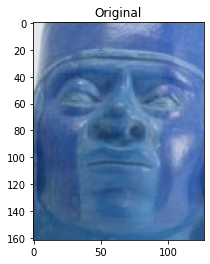

162 127
(218, 220, 345, 382)
218 isss [ 0.05450731  0.08476509  0.33725613  0.00656993  0.01040866  0.15865567
  0.02557243  0.08448424 -0.13272078  0.01050849 -0.06227088 -0.04009948
 -0.094289    0.00358097  0.2111189  -0.1193391  -0.01662405  0.05618595
  0.06378075 -0.09848751  0.04227629  0.1598148  -0.02710072  0.06258459
  0.08867934 -0.07822777 -0.06696254  0.05481039  0.07644074 -0.04068923
 -0.06362928 -0.13195239 -0.0780737   0.04009668  0.1199815  -0.05375941
  0.02913374 -0.04110136  0.00807809 -0.04700627  0.03632182  0.02324583
 -0.01645831 -0.16586211 -0.0714166   0.04569658 -0.00187256 -0.08956905
 -0.1597204   0.00445846  0.10656319  0.11348547  0.03566369  0.05847102
  0.05182619  0.00699738  0.06185559 -0.03548519 -0.06118574 -0.06952522
  0.0530892   0.07495659 -0.08383873 -0.0853271   0.0605629   0.11932071
  0.06339917 -0.02553406 -0.08961899  0.18843924  0.02733096  0.0806438
 -0.0044665  -0.00630804  0.02889177  0.0294352  -0.0648316  -0.05023722
  0.14695103 -

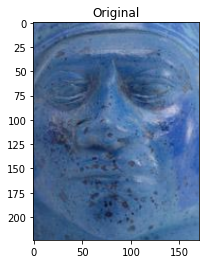

224 171
(218, 120, 389, 344)
218 isss [ 0.08551098 -0.00033253  0.2168786  -0.05808412  0.08370347  0.16771892
  0.06591122  0.01573874  0.03749216 -0.11976463 -0.04352541  0.02865901
 -0.04061887  0.05330418  0.15355942 -0.10399199 -0.07275863 -0.09420259
 -0.0489866  -0.03614539  0.09499898  0.14961857  0.01053651  0.05994547
  0.00231715 -0.01757271 -0.10148411 -0.05961669  0.04476954 -0.03607618
  0.01682603 -0.10511757 -0.11074173  0.00730033  0.0905339   0.05542605
  0.01767883  0.13327667 -0.01037493  0.01376426  0.04735146  0.10870776
 -0.16523063 -0.12949266 -0.09909654  0.09622205 -0.06471569 -0.07187968
 -0.03485308  0.00652769 -0.0288128   0.11312943  0.00777064  0.0716076
  0.10619052 -0.02723273  0.03275659  0.11988098 -0.1564776  -0.01137567
 -0.01052192  0.022739    0.03578518 -0.10448828  0.10482832 -0.04728828
  0.11401588  0.13448788  0.01025855  0.19000156  0.13460356  0.12738517
 -0.01202163 -0.03978489  0.04512528  0.09730051 -0.12842031 -0.02970598
  0.09787909  

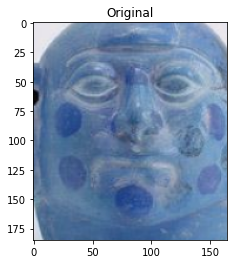

185 165
(205, 206, 370, 391)
205 isss [ 0.06582428  0.01545357  0.17017034  0.02354291  0.08133461  0.15164408
  0.04036051 -0.13407299  0.06533246 -0.08217373  0.00172297  0.00516176
 -0.08322938  0.13332622  0.13956933 -0.12921137 -0.02336088  0.01635442
  0.01550284 -0.15219438  0.04814417  0.16936667 -0.06037356 -0.01977036
  0.11913965 -0.05940758 -0.09798891  0.07266836 -0.00441403  0.05315975
  0.05070919 -0.06916057 -0.09615777 -0.04942225  0.13492215  0.05268348
 -0.01791375 -0.0616569   0.06475779 -0.01064591  0.06010687  0.12517782
 -0.08678658 -0.10676407 -0.07079918  0.03887238 -0.12646787 -0.03725087
  0.08528049 -0.10902402  0.03281866  0.15210837  0.07134547  0.01633274
  0.00950394 -0.00019504 -0.0137339   0.060477   -0.12467283  0.02834464
  0.01834747  0.02511452 -0.01645021 -0.03728767  0.04687272  0.03996997
  0.11997531  0.10905115 -0.00159194  0.19276403  0.17460826  0.12453938
  0.04377448 -0.12106281 -0.02535665  0.09841838 -0.13264498 -0.15869303
 -0.01149983 

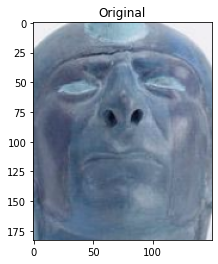

183 150
(228, 207, 378, 390)
228 isss [-6.80557936e-02 -5.27067296e-02  4.66639064e-02 -1.19832251e-02
  7.67103210e-02 -2.60797865e-03 -2.09717974e-02 -9.62534994e-02
  6.80842772e-02 -4.77162115e-02 -2.79264916e-02  2.60222014e-02
 -5.03419004e-02  1.22894183e-01  1.11488849e-01 -4.66787778e-02
  5.25649413e-02  5.04564643e-02  1.48280993e-01 -5.28999083e-02
  5.40764630e-02  9.63378474e-02 -4.86445390e-02 -9.01012123e-02
  3.76644991e-02  7.94785246e-02 -7.84353241e-02 -9.91986096e-02
 -3.92910726e-02  6.89403489e-02  6.93572536e-02 -5.54860123e-02
  1.13620088e-01 -1.25054017e-01  2.16209546e-01  1.13276444e-01
  7.22362623e-02  2.18289122e-02  2.63021011e-02 -1.02434009e-01
  2.24860925e-02  1.76014140e-01  7.34812580e-04  1.77109353e-02
 -7.84364492e-02  1.55063286e-01  2.89187767e-02 -1.01181872e-01
  1.56804733e-02 -1.80543467e-01 -1.08605109e-01 -4.05844226e-02
  1.21105485e-01 -4.54272842e-03  7.94924572e-02  8.46568570e-02
 -1.18551645e-02  8.82629957e-03 -1.06286742e-01  2.

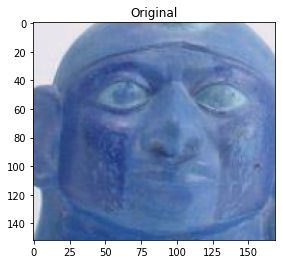

152 169
(201, 223, 370, 375)
201 isss [ 0.10050096  0.08548823  0.18153264 -0.00818602  0.02889517  0.05096612
  0.06217868 -0.03724085 -0.12476353 -0.02433201 -0.00835251 -0.03187466
 -0.00711502  0.11873198  0.17351905 -0.03229536  0.03319876 -0.08023722
  0.07922345 -0.05599928  0.06701788  0.17409025 -0.00792508  0.01660165
  0.03289756  0.01421366 -0.10835087 -0.01745312  0.13422428  0.09818407
 -0.10724597 -0.05022119 -0.07368883 -0.03748963  0.06927073  0.00717841
  0.03500044  0.08136087  0.08864387  0.08152961 -0.07351246  0.10638912
 -0.10179216 -0.15937828 -0.04819418  0.23792352  0.00484327 -0.11927591
 -0.04674902 -0.05724969  0.08592903  0.24252427  0.00254151  0.07931089
  0.05745356 -0.05427112  0.16198272  0.02051914 -0.06350341  0.06905487
  0.06969126  0.00183566 -0.05886414 -0.04855802  0.02987261 -0.08547073
  0.11259742  0.09017041  0.06478763  0.10660037  0.11224242  0.1107372
 -0.03748598 -0.03528235  0.06790601  0.09928017 -0.11456864  0.00281157
  0.07488707  

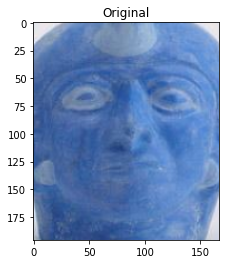

196 167
(219, 209, 386, 405)
219 isss [ 0.04384356  0.06286116  0.04354579 -0.16266717  0.01158545  0.06065285
  0.03298122  0.0984242  -0.19343641  0.12821375  0.00864745 -0.04433872
  0.0919237   0.17438935  0.18034802 -0.04434311  0.12017908 -0.02282646
  0.15318842 -0.02649015  0.01758656  0.16455585  0.00507065 -0.03237702
 -0.06117421  0.07195825  0.03784169 -0.01984766  0.16183738  0.05978179
 -0.13649358 -0.10542081 -0.00251442 -0.06707904  0.05262722 -0.00491368
  0.04831428  0.1703332   0.03294856  0.0884757  -0.10625511  0.11769152
 -0.13564213 -0.02453025 -0.12387592  0.19514035  0.01598613 -0.06817991
 -0.09944715 -0.11575289  0.06690802  0.17436118 -0.07089191  0.04925584
 -0.00672354  0.01778511  0.09839386  0.07411237 -0.04951514  0.03961518
  0.00821952 -0.07384346  0.01944773 -0.06078221  0.10341258 -0.0955023
  0.07522606  0.13531023  0.05865455  0.03049807  0.12186757  0.06870579
 -0.02927535 -0.10719173  0.03040403  0.0950946  -0.10836213  0.05865612
  0.11362039 -

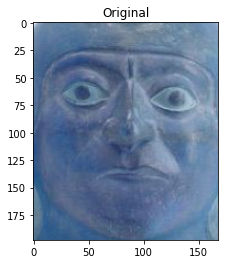

198 168
(220, 184, 388, 382)
220 isss [ 0.11030729  0.05349111  0.07251997 -0.0986019   0.07317278  0.13679403
  0.03089671  0.04635707 -0.05059449 -0.04074133  0.02347413  0.07113808
  0.01895333  0.04835329  0.01958582 -0.02192324 -0.03425535 -0.04787338
 -0.07467491  0.02247611  0.1200867   0.21175475 -0.04654245  0.06870713
 -0.04052761  0.00508493  0.03895669  0.01189071  0.04301257  0.11711331
 -0.17761998 -0.14720024 -0.08076783  0.02754789  0.00918234  0.00261308
 -0.03688164  0.05526608 -0.06060125  0.08775666 -0.06046665  0.11370137
 -0.05223496  0.01494835 -0.05896622  0.10381118  0.03391937 -0.0702894
 -0.0770582   0.07551715  0.13978384  0.11576641 -0.1311386   0.08376411
  0.15113692 -0.02685163 -0.03420236  0.09675533 -0.06218748 -0.03119604
  0.03089083 -0.06336233  0.09238961 -0.01675131  0.0166978  -0.1911115
  0.04576952  0.14262898  0.0378284   0.14270286  0.15555497  0.11114746
  0.03289702 -0.10119987 -0.00314998  0.13853295 -0.0868938   0.03805346
  0.04056404  0

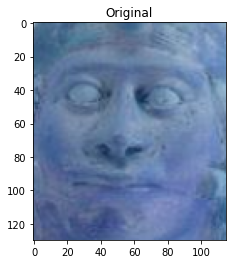

130 115
(233, 232, 348, 362)
233 isss [ 0.12790592 -0.00292239  0.08815867 -0.0990952  -0.03722269  0.10735829
  0.02480943  0.06540252 -0.15559277 -0.00721462 -0.02719012 -0.04362212
  0.03360345  0.10387249  0.13609698 -0.06637662 -0.01606622 -0.10597248
  0.11622165 -0.09489554  0.06416225  0.18616945 -0.03450222  0.00616729
  0.01276045  0.06066244  0.00623417 -0.05141708  0.03754335  0.09863664
 -0.12338831 -0.12302443 -0.10563441 -0.02101919  0.05096422 -0.05084148
 -0.0117638   0.0788541   0.1061754   0.08601457 -0.10520865  0.0620421
 -0.13074528 -0.06980018 -0.00582495  0.11215942 -0.02830334 -0.08198582
 -0.03242469 -0.03416005  0.12358865  0.1668797   0.05761373  0.10174684
  0.04557333 -0.04587505  0.13034941  0.05923923 -0.02618446 -0.04038355
  0.07722862 -0.0285738  -0.00499588 -0.00380918 -0.04241457 -0.07208949
  0.12551227  0.13148448  0.11515339  0.01390651  0.07485953  0.08366276
 -0.04946444 -0.09855364  0.02359384  0.06692597 -0.12163614 -0.09314143
  0.10071712  

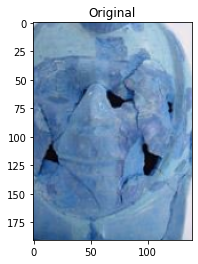

191 139
(233, 220, 372, 411)
233 isss [ 7.56520629e-02 -3.17905918e-02  1.16075147e-02 -1.59936011e-01
  7.60824755e-02  7.05328658e-02  2.93309093e-02  1.89824998e-02
 -2.00596407e-01  1.11720838e-01 -2.54050083e-02  8.84274766e-02
  1.02813542e-01  9.71448794e-02  1.57600716e-01 -4.97831181e-02
  3.07479296e-02 -1.67601313e-02  1.46309748e-01  2.72735506e-02
  3.64112481e-02  9.30946618e-02  5.04196249e-02  5.48268519e-02
 -2.48285662e-02  1.60047516e-01  5.19779697e-02 -1.52095392e-01
  4.49802764e-02  9.58355144e-02 -1.56925678e-01 -6.90694079e-02
  2.50488450e-03  6.35491824e-03  3.88920084e-02 -3.94265614e-02
  4.39367956e-03  1.71412259e-01  8.67038146e-02  3.22348140e-02
 -6.11168183e-02  5.34702465e-02 -7.65819252e-02 -2.50808289e-03
 -1.54085174e-01  1.41424417e-01  6.23940714e-02 -7.45134279e-02
 -1.13702632e-01 -5.85047267e-02  1.07479550e-01  1.86287146e-02
  1.51100773e-02  4.53680642e-02  9.73756015e-02  3.33973393e-02
  1.05127841e-01  1.58764377e-01 -7.16968551e-02 -5.

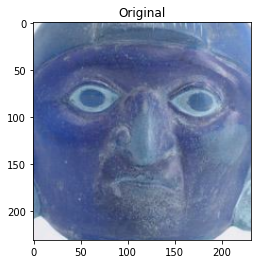

231 231
(184, 128, 415, 359)
184 isss [ 0.08692468  0.04575659  0.09493994 -0.09051653  0.06223701  0.12214928
  0.0565647  -0.06172077 -0.01941461 -0.06666589  0.04011653  0.00208507
 -0.02900731  0.14647903  0.21017396 -0.07722606 -0.03199282 -0.08701336
  0.07995073 -0.09865801  0.0339473   0.24070571 -0.04017138  0.01258595
  0.0277654  -0.01594536  0.01226452 -0.01482379  0.04943074  0.11662468
 -0.07801259 -0.1492928  -0.02650461 -0.03463415  0.10341581  0.0846958
  0.04942688 -0.02050993  0.03927973  0.08641721 -0.00824654  0.10059039
 -0.07406648 -0.04851206 -0.10470077  0.22518042 -0.01618789 -0.0914465
 -0.03988107 -0.07047591  0.02143586  0.1040326   0.01402735  0.05578656
  0.07474327  0.04778241 -0.01608311  0.13466655 -0.14435668  0.1259636
 -0.01783289 -0.02868478  0.0373832  -0.07791476  0.10342386 -0.05786573
  0.07657008  0.0998329   0.048194    0.12015696  0.15083113  0.09232966
 -0.04285542 -0.15579692  0.07611826  0.15968682 -0.1206002  -0.03841562
  0.01162269  0.

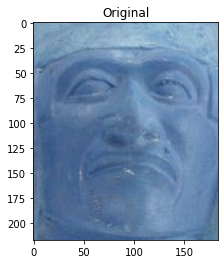

217 184
(200, 147, 384, 364)
200 isss [ 1.50736542e-02  1.32001728e-01  9.46871117e-02 -1.16589189e-01
 -5.90025671e-02  4.30488251e-02 -2.49547753e-02  1.32730622e-02
 -5.09501882e-02  5.43041751e-02  7.17093945e-02 -4.44671623e-02
  4.25092829e-03  1.83675215e-01  9.45108756e-02 -8.55892375e-02
  7.36453086e-02 -5.80257028e-02  8.93038511e-02 -4.47330438e-02
 -3.92761193e-02  2.24571496e-01 -8.05315897e-02  6.24943525e-02
 -5.33262305e-02  2.89591104e-02  1.52283460e-01  1.59315243e-01
  9.36193690e-02  7.89138600e-02 -1.58754632e-01 -2.21874282e-01
  5.30837663e-02 -4.79470566e-03  1.59734767e-02  7.07680881e-02
  6.08165413e-02  3.90490294e-02 -6.65948018e-02  1.33208752e-01
 -1.10310927e-01  7.21925870e-02 -4.74906415e-02 -2.80786883e-02
 -1.84186455e-02  1.83916718e-01  1.14695281e-02 -3.53196003e-02
 -7.55253881e-02 -2.34391615e-02  1.03867292e-01  2.16992185e-01
 -9.21643227e-02  6.95038810e-02  9.52212736e-02  7.02623278e-02
 -4.51951101e-02  3.46919969e-02 -3.51941288e-02  3.

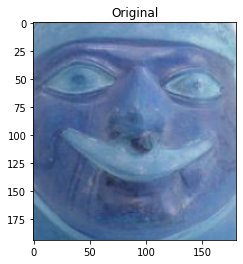

194 181
(216, 185, 397, 379)
216 isss [ 0.10804372  0.13436598  0.15332209 -0.01922014  0.06077718  0.0633394
  0.02801378 -0.03543192 -0.06596795 -0.05675337  0.03879148 -0.07615204
  0.01453583  0.11330817  0.10283715 -0.0095413   0.0990666   0.00551601
 -0.04438724 -0.05969003  0.1491458   0.13555305 -0.0821717  -0.07929819
  0.08915889 -0.01774748 -0.15496525  0.06785993  0.10183605  0.09707184
 -0.04304938 -0.01481305 -0.0456176  -0.0108039   0.10662803  0.00136095
  0.05531573  0.06456739  0.13074873 -0.05147979 -0.02645045  0.12000421
  0.02532747 -0.07641137 -0.0031324   0.17010444 -0.00282578 -0.08267386
 -0.08771621 -0.12465232  0.03615783  0.22085224 -0.0461916   0.08083928
  0.0262817  -0.07044437  0.02441163 -0.0457616  -0.0637144  -0.05265457
  0.05877686 -0.04545176 -0.06271114 -0.01538327 -0.00070633 -0.02647674
  0.05380156  0.15721019  0.07026874  0.08019452  0.19206727  0.03754532
  0.01209938 -0.17333119  0.01887851  0.09317619 -0.11061509  0.0112324
  0.02952494  0

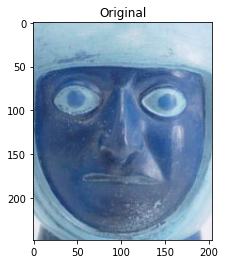

248 204
(196, 91, 400, 339)
196 isss [-1.48374401e-03  3.68668735e-02  9.76637229e-02 -9.51959193e-02
 -2.48338841e-02  1.59769937e-01  3.83990519e-02  3.60381640e-02
 -7.66915008e-02  1.29917273e-04  3.03704012e-02  5.81914186e-02
  1.69267394e-02  5.94349317e-02  1.48958847e-01 -1.38159484e-01
 -2.95759086e-02  1.81215780e-03  9.00593400e-02 -4.81649078e-02
  1.73031092e-02  1.39020339e-01 -4.33634110e-02  6.17719181e-02
 -4.33388874e-02  1.03549972e-01  1.53627181e-02 -1.19983666e-01
  5.70199117e-02  2.03179494e-02 -1.53552275e-02 -1.04795374e-01
 -3.45249684e-03 -3.31892557e-02  8.96870121e-02  6.09383844e-02
  6.52238028e-03  1.31416053e-01 -9.14663356e-03  8.03320184e-02
  2.34771278e-02  8.66586864e-02 -1.50836363e-01  5.52676059e-02
 -1.68270230e-01  5.84802851e-02  7.74651319e-02 -1.51084736e-01
 -1.70174569e-01 -9.80855376e-02 -5.96011477e-03  2.28319168e-02
 -1.41926156e-02  4.22467180e-02  5.09235449e-02  1.11363836e-01
 -5.23147509e-02  2.08003372e-01 -1.10409871e-01 -2.6

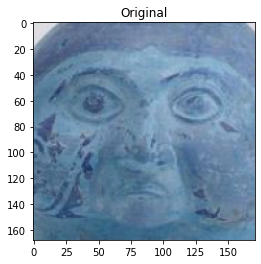

168 171
(201, 204, 372, 372)
201 isss [ 0.13018815 -0.01132157  0.05891366 -0.09273979  0.08551959  0.22434951
  0.12175652  0.00649738 -0.05179645 -0.05495539  0.02055865  0.14427802
  0.07999904 -0.05313139  0.05509409 -0.15249306 -0.14263517  0.05622351
 -0.14560309  0.02069657  0.09106295  0.16724193 -0.04255657  0.10509341
 -0.0789432  -0.04029868 -0.07346398 -0.09833768 -0.0559048   0.12616588
 -0.09702521 -0.04239234 -0.13060388  0.09149686  0.05356034 -0.02450212
 -0.06684185 -0.01525848 -0.03252799  0.06500711  0.04840729  0.01602438
 -0.07068959  0.09450633 -0.17785944 -0.06058703  0.03656978 -0.00675783
 -0.09295713  0.1322951   0.09143128 -0.08087968 -0.09917554  0.07995444
  0.07295608 -0.00136991 -0.10992628  0.19182836 -0.09885086 -0.0215445
 -0.013917    0.01374139  0.1415578  -0.0615832   0.00084717 -0.15145026
  0.08237094  0.05020672 -0.08272636  0.05652683  0.10315396  0.09469142
  0.05150424 -0.01315017 -0.08127088  0.06617646 -0.12782474 -0.13685448
  0.06621462  

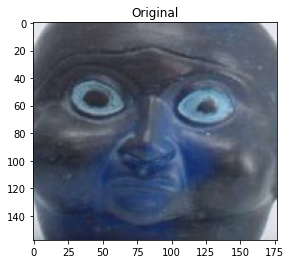

158 177
(217, 236, 394, 394)
217 isss [ 0.03711907 -0.06996246  0.03205099 -0.047532    0.05041404  0.13845746
  0.0630301   0.03988293 -0.03082474 -0.06168607 -0.02037972  0.18492681
  0.10005213 -0.13369215 -0.03538522 -0.11409565 -0.18810329  0.00073107
 -0.11652538  0.13884568  0.1293311  -0.02354778  0.07351953  0.16240202
 -0.09666952  0.01968643 -0.0542912  -0.2432579  -0.05604064  0.06804139
 -0.08063473 -0.05408197 -0.03800044  0.06998879 -0.00206524 -0.04174069
 -0.08378227  0.17553829 -0.11067852  0.00241218  0.04495757 -0.03825419
 -0.12826148  0.08368455 -0.1970954  -0.08472548  0.07476548 -0.05850809
 -0.07252138  0.11889615  0.04915065 -0.10677141 -0.02529036  0.0588945
  0.16033572  0.01490594 -0.01438857  0.1513874  -0.0963647  -0.09397919
 -0.02297733 -0.02988671  0.16985244 -0.03784541  0.11629081 -0.16814058
  0.01519569  0.03171433 -0.08947103  0.01844609  0.02265128  0.05617183
 -0.0227113   0.00067221 -0.00292866  0.08900681 -0.11034062 -0.0598232
  0.10121188  0

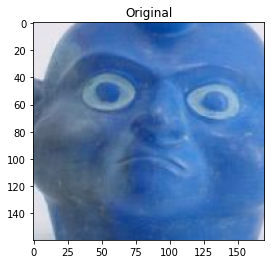

160 170
(201, 229, 371, 389)
201 isss [ 0.00480814  0.05223285  0.15799211 -0.08594215 -0.03639076  0.15341727
  0.00092723  0.00784316 -0.09130291  0.05090822  0.05679373 -0.02730489
  0.0447546   0.0856989   0.2945266  -0.14366621 -0.02969565 -0.00032301
  0.10145054 -0.03558497 -0.02799244  0.12787111  0.04842173  0.08190097
  0.00748563  0.05756134  0.01146404 -0.11925448  0.08430083 -0.01568582
 -0.00280274 -0.06932887  0.02540949 -0.01181178  0.10123012  0.06392016
  0.0631839   0.15742181  0.01403488  0.01973246  0.03194053 -0.02364278
 -0.1750257  -0.0249003  -0.21697815  0.08257168  0.03535667 -0.06125966
 -0.16636911 -0.10787221 -0.00911733  0.04269784  0.06189745  0.03222946
  0.01314808  0.09042826  0.00039191  0.11561553 -0.07714236 -0.03379017
 -0.1143078  -0.03624118  0.06682593 -0.10905842  0.15490603  0.10137539
  0.12054881  0.03651116 -0.05726488  0.08813543  0.03367103  0.01114921
 -0.05127008 -0.08510592  0.12967473  0.0032956  -0.1822614  -0.0529664
  0.11375809  

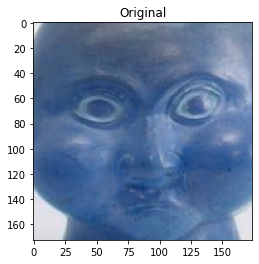

173 174
(204, 219, 378, 392)
204 isss [ 0.10312822 -0.02904528  0.02942517 -0.12657201  0.01551642  0.1809578
  0.03576045  0.16460663 -0.12671873 -0.04541726 -0.02620568  0.12906997
  0.07581325 -0.11267182  0.06024988 -0.12330055 -0.0344865  -0.04491989
 -0.10591841  0.08935873  0.0188861   0.1159194   0.0514909   0.12954019
 -0.11102313  0.02592833  0.04453641 -0.1502272  -0.05842324 -0.0476995
 -0.08213    -0.093595   -0.03617627  0.12610205 -0.06562757 -0.06003578
 -0.04597512  0.13215548 -0.13959369  0.10394102  0.05026162 -0.00981354
 -0.12539186  0.10237519 -0.1708748  -0.02012676  0.06346269 -0.06149837
 -0.149       0.17648655  0.11876202 -0.10383181 -0.08342461  0.05574692
  0.05782797 -0.00285704 -0.04423187  0.15082012  0.00775297 -0.10114052
 -0.06376496 -0.00786147  0.08286315 -0.07732227  0.0440032  -0.18851791
  0.06546099  0.04708752 -0.08203179  0.02915692  0.03911295  0.01543035
  0.0249934   0.01366493  0.01245738  0.05773645 -0.13045403 -0.04065161
  0.09126648  0

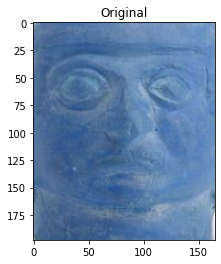

198 165
(205, 182, 370, 380)
205 isss [ 0.05622947  0.08910307  0.22796603 -0.08055974  0.01649621  0.11983068
  0.05278278 -0.00025185 -0.10618469  0.0171569  -0.00082803 -0.03447903
 -0.03367763  0.0953512   0.20695205 -0.07160054 -0.08920377 -0.06538869
  0.00392195 -0.11345375  0.01424061  0.21808253 -0.0609243  -0.06517991
  0.01924401  0.01620412 -0.08943305  0.04955329  0.06641082  0.02750032
 -0.11639835 -0.06168633 -0.11269095 -0.02105095  0.05213647  0.0418078
 -0.0323173  -0.02759009  0.03684967  0.1070443  -0.01257121  0.04738327
 -0.11410115 -0.10610592 -0.04759564  0.23100936 -0.02461194 -0.08031531
 -0.11175665 -0.07440564  0.07924072  0.21287987 -0.07587432  0.0509022
  0.01036836 -0.02290821  0.02595671  0.0124852  -0.09548097  0.10253086
  0.06127887  0.01532977 -0.04994845  0.0229707   0.04381455 -0.03868603
  0.08014826  0.14452578  0.06293601  0.17012396  0.15550229  0.1200825
  0.02872563 -0.0532612   0.05225023  0.11915951 -0.14957497 -0.05173531
  0.04631355  0.

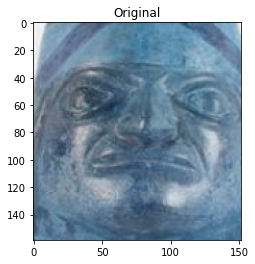

159 152
(212, 231, 364, 390)
212 isss [-3.28586958e-02  1.05740830e-01  1.54927641e-01 -1.36066929e-01
 -6.73874244e-02  4.55913916e-02  1.80426463e-02 -1.19580561e-02
  8.41719359e-02  1.31302578e-02 -3.52036790e-03 -8.22184160e-02
 -5.34118190e-02  1.92899182e-01  1.23640306e-01 -1.68563664e-01
 -2.67367940e-02 -5.14931083e-02  3.50173675e-02 -1.38015136e-01
 -8.01502913e-02  2.10060984e-01 -9.60374326e-02 -4.43419814e-02
 -6.47442490e-02  4.66617011e-03  1.63173787e-02  1.68460205e-01
  1.16555326e-01  6.32600440e-03 -4.73627411e-02 -9.15745571e-02
 -1.83579288e-02 -5.30240275e-02  5.39588071e-02  7.68270716e-02
  3.60195488e-02  5.94333820e-02  4.73446166e-03  1.27086774e-01
 -4.98465784e-02  7.95335397e-02 -1.86760515e-01 -1.29525885e-01
  1.36009911e-02  1.61113501e-01 -1.22980237e-01  7.90275168e-03
 -6.84162229e-03 -9.84959230e-02 -6.02941699e-02  3.18571538e-01
  7.86123052e-03  2.76677068e-02 -3.56262997e-02  3.43644470e-02
  1.34875709e-02  2.34674215e-02 -1.36782780e-01  5.

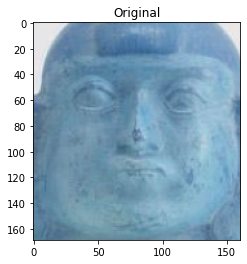

169 161
(209, 215, 370, 384)
209 isss [ 0.04628647  0.00545602  0.18296866 -0.07510244  0.08704614  0.18756542
  0.10994136  0.08356196 -0.12611198  0.073465   -0.01488329 -0.0193926
  0.0078779   0.09444357  0.31542477 -0.16170117 -0.07658734  0.01574408
  0.06094371 -0.1139449   0.01540706  0.1432678   0.01817592 -0.06995755
  0.08504447 -0.0706379  -0.12464254  0.00963851  0.0507094  -0.01795837
  0.01065124 -0.10652387 -0.1042093   0.0050708   0.10887774  0.00928775
 -0.04593839 -0.006135    0.03296178  0.01785924  0.07443079  0.08186313
 -0.07780583 -0.01720229 -0.229116   -0.02662253 -0.05595265 -0.02999443
 -0.01290604 -0.03679426  0.0259304   0.0400658  -0.0661594   0.02692053
 -0.00608217  0.01199631 -0.03704192  0.11114156 -0.09760761  0.01765095
 -0.0649033   0.00416219  0.0077127  -0.07215035  0.0984824   0.10491844
  0.08015995  0.07318613 -0.03832069  0.12235754  0.13759856  0.22879662
  0.05848919 -0.00590753 -0.03588696  0.01425662 -0.13318153 -0.18279567
  0.10618804  

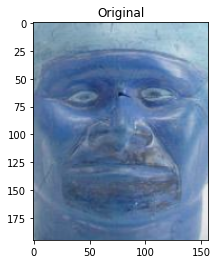

195 157
(236, 211, 393, 406)
236 isss [ 0.07509214  0.07531696  0.15045074  0.03933693  0.05128593  0.03812905
 -0.04758821 -0.12099762  0.07660227 -0.1536662   0.03929432 -0.02013411
 -0.13048695  0.16871063  0.04727347 -0.02384813  0.08793887 -0.04801754
  0.03249834 -0.04660784  0.0442131   0.17839251 -0.03322764  0.05166073
  0.08315828 -0.05929156  0.03602411  0.13572039  0.10163604  0.05587073
 -0.03530719 -0.11252176  0.01695138 -0.07401835  0.04841594  0.09524547
  0.02192416 -0.02228814 -0.00500902  0.02525665 -0.03918467  0.14112635
 -0.06049708 -0.15588151  0.02199768  0.2287588  -0.06308661 -0.09840561
  0.00650053 -0.08673747  0.01101277  0.27550992  0.04426228  0.01775979
  0.04367568 -0.01254691  0.03081847  0.01507467 -0.10221465  0.08862895
  0.02954726  0.02495758 -0.01670522 -0.02509119  0.02011546 -0.04639441
  0.07265031  0.06543913  0.02366173  0.23894496  0.14382516  0.01593839
 -0.02432823 -0.13071346  0.09710727  0.13344081 -0.02253135  0.05656026
 -0.06383177 

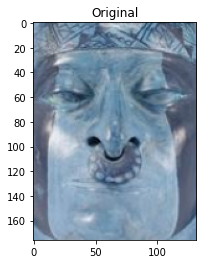

176 132
(238, 204, 370, 380)
238 isss [-1.16943307e-02  8.55525210e-03  1.41252369e-01  3.00728362e-02
  2.00642049e-02  8.22666511e-02  2.33400837e-02 -1.27567714e-02
 -8.10227823e-03  3.44054736e-02  4.39385548e-02  6.04693554e-02
 -8.45271796e-02  2.18891702e-03  8.91308933e-02 -7.54721835e-02
  6.42803460e-02  6.34395257e-02  1.78235456e-01 -5.90311363e-02
  4.20375988e-02  1.60017326e-01 -1.13311492e-01  1.20822519e-01
  1.24127157e-02  6.44890442e-02 -1.02915242e-02 -7.17881322e-02
  9.48937088e-02  7.21102655e-02  1.26098590e-02 -1.37180880e-01
 -1.96909606e-02 -1.03739552e-01  1.44384518e-01  6.19497076e-02
  4.14562151e-02 -4.97642830e-02  1.53046250e-02  5.51989302e-02
  1.86236631e-02  1.17607109e-01 -1.12401605e-01 -1.02290632e-02
 -6.71734586e-02  5.62739298e-02  4.94538099e-02 -1.28704041e-01
  2.18860097e-02 -1.40398338e-01  9.21439752e-02  1.19278982e-01
 -7.60798855e-03  1.15962524e-04  7.36027062e-02  6.90497905e-02
  3.92037630e-02  3.02992165e-02 -8.44388232e-02  7.

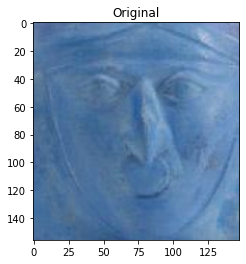

156 148
(224, 250, 372, 406)
224 isss [ 0.06367477  0.16519342  0.09490452 -0.14367881 -0.05248701  0.07088801
  0.04457546  0.06305087 -0.06974284  0.0328334   0.09139057 -0.04467272
  0.0429105   0.08793552  0.10831645 -0.06096048  0.01880867 -0.06742675
  0.00883815 -0.07257943  0.04341898  0.22875223 -0.16237387 -0.08316737
 -0.02788081  0.082934    0.02652582  0.09023204  0.11735782  0.11318558
 -0.1449672  -0.09247722 -0.01930643 -0.00346661  0.05425682 -0.03148039
  0.09152488  0.06018706  0.09460888  0.10641655 -0.04882247  0.04356708
 -0.01584579 -0.00190006  0.00255834  0.1187272   0.02065157 -0.09467656
 -0.11450015 -0.08429341  0.07683013  0.18311869 -0.11974279  0.1144629
  0.02402714  0.01146258 -0.07676182 -0.0080938  -0.12753569 -0.00351608
  0.00312411 -0.15316086  0.03018172 -0.00520808 -0.01930184 -0.06385512
  0.11779479  0.08511536  0.06860973  0.00155845  0.14353922 -0.01682012
  0.01006488 -0.11700095  0.06674159  0.07506056 -0.10208879  0.0051743
  0.02383163  0

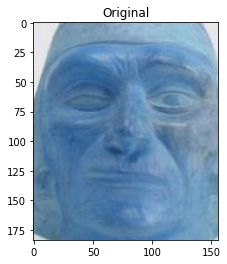

184 156
(216, 204, 372, 388)
216 isss [ 9.81655717e-02 -8.95826221e-02  8.41134638e-02 -1.62446618e-01
  8.20299461e-02  8.03819597e-02  1.72870896e-05  9.02298763e-02
 -1.68062329e-01 -4.01943065e-02 -3.23697962e-02  9.18035358e-02
  6.92261942e-03  1.31634921e-01  1.61036283e-01 -7.56125078e-02
  3.45375724e-02 -1.00787304e-01  1.21738948e-01  6.13493398e-02
  9.75415763e-03  2.37447307e-01  5.80309937e-03  2.04874836e-02
 -6.23509474e-02  1.41383812e-01  9.91107747e-02 -4.02826853e-02
  1.31672248e-02  4.11370955e-03 -1.30493358e-01 -1.58161312e-01
 -2.11910848e-02  2.54398789e-02  2.30111871e-02  5.54062910e-02
  8.51272978e-03  9.73316804e-02 -1.17043927e-02  9.13335383e-02
 -3.12551148e-02  1.40783876e-01 -7.78090283e-02  1.71961877e-02
 -1.15161076e-01  1.67515889e-01  5.55395484e-02 -1.01145141e-01
 -9.72676277e-02  5.79395555e-02  2.95022856e-02 -1.74382911e-03
 -9.32293162e-02  9.40417722e-02  1.28401950e-01  7.39706680e-04
 -2.77390927e-02  1.72446474e-01 -1.03194155e-01  7.

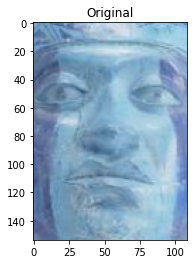

154 109
(251, 205, 360, 359)
251 isss [ 0.05826515  0.06914052  0.08337503 -0.10279699 -0.04679121  0.0545083
  0.02266715  0.10304467 -0.11670361  0.10498102  0.0636339  -0.1365948
  0.01254334  0.0973138   0.22789496 -0.06651906  0.10934983 -0.02326654
  0.17686048 -0.04513413 -0.04857335  0.14578567  0.01063872  0.00242368
 -0.04891608  0.03870989  0.05868123  0.01422511  0.17946063 -0.04626892
 -0.01243435 -0.16995414 -0.0036921  -0.07564271  0.10620584  0.07907367
  0.00958076  0.07455431 -0.02323123  0.02839721 -0.14844103  0.06735685
 -0.1804728   0.05537726 -0.06982451  0.18078928 -0.02028842  0.05179717
 -0.11510875 -0.05644485 -0.02741001  0.1920172  -0.05489614 -0.05761875
 -0.04174218  0.02047171 -0.02970897  0.07354473 -0.02816779  0.05242582
 -0.06528247 -0.0474838   0.08483353 -0.06971645  0.07946717 -0.0664078
  0.08330716  0.01250512 -0.00898239  0.12869503  0.05916214  0.01191019
 -0.04486125 -0.0441301  -0.03620312 -0.08337083 -0.0561084   0.09188972
  0.1186588  -0.

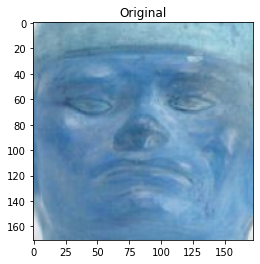

171 173
(212, 214, 385, 385)
212 isss [ 0.02146582  0.11300036  0.20935696 -0.05179161 -0.05819384  0.04365874
  0.06351605  0.0983804  -0.12127043  0.05686109  0.02018084 -0.1154318
 -0.03843036  0.13169073  0.222515   -0.1294246   0.02354079  0.02619725
  0.11741406 -0.13308764 -0.00468545  0.11886811 -0.0399092  -0.1317073
  0.04752294  0.02410632 -0.05471372  0.06358368  0.1628443  -0.03463775
 -0.04396226 -0.05516333 -0.02330402 -0.06226269  0.10608758 -0.02476043
 -0.00833407  0.09757783  0.03422594  0.00832585 -0.04039351  0.07949314
 -0.11484937 -0.02018435 -0.08719367  0.0921532  -0.03684812 -0.10023459
 -0.1350028  -0.1452655  -0.01389257  0.2269609  -0.01871108  0.02433968
 -0.07628447  0.02313479  0.00911517  0.01040886 -0.05702391 -0.03259698
 -0.00648954 -0.05530314 -0.00203816 -0.00670425  0.06133317  0.10344292
  0.11449645 -0.01461905  0.01076508  0.13833262  0.08255181  0.02366654
  0.04786132 -0.00335756 -0.01622649 -0.07800344 -0.11401395 -0.10155955
  0.07123607 -0

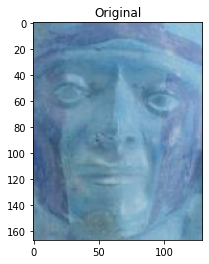

167 130
(225, 228, 355, 395)
225 isss [ 0.07653049  0.04885043  0.1656909  -0.09451823  0.04129569  0.02780745
  0.10899633  0.00263899 -0.0642537   0.05006287 -0.01175175 -0.05638479
  0.04518389  0.1892623   0.15380463 -0.05997883  0.04777442 -0.04534831
  0.02745143 -0.07811002  0.06257633  0.14999872 -0.07876153 -0.01740309
 -0.01248655 -0.00538005 -0.10132255  0.06787197  0.11752722  0.10175226
 -0.12832865 -0.07663964 -0.06593526 -0.04471646  0.08702907  0.00288144
  0.02921529  0.09318947  0.03750514  0.00285063 -0.07817348  0.11094199
 -0.08190926 -0.1297783  -0.00636574  0.22913326 -0.09037566 -0.01883863
 -0.0401964  -0.13414368  0.02890202  0.19459064 -0.01476816  0.03757612
  0.05836099 -0.02334374  0.04005053  0.02424071 -0.08501769  0.0530608
  0.09020901 -0.0173409  -0.06756944  0.02597671  0.02595788 -0.01726781
  0.06050376  0.18048011  0.06461713  0.0508993   0.15603669  0.05932824
 -0.01203546 -0.13552822  0.01529265  0.1544361  -0.08136554 -0.01390647
  0.11840278  

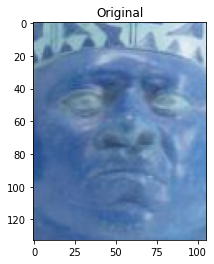

133 106
(248, 243, 354, 376)
248 isss [ 0.02180691  0.07869722  0.20201752 -0.06638977 -0.02678847  0.04898085
  0.05165439  0.01317324 -0.08699834  0.0426893   0.01159637 -0.08385391
 -0.03361409  0.12886485  0.17923887 -0.0634352   0.01847102 -0.00093286
  0.12763646 -0.13785699  0.02631598  0.22685914 -0.1320831   0.037627
 -0.01608404  0.0373377  -0.06731191  0.04036666  0.19652468  0.06913113
 -0.10297144 -0.10388653 -0.07027869 -0.08395445  0.1117792   0.03465046
  0.0207366  -0.02967386  0.05410569  0.09195057 -0.04823334  0.09932005
 -0.11487882 -0.09480119  0.0081313   0.19948009 -0.00967604 -0.07483704
 -0.07420025 -0.17452608  0.04499821  0.20918721  0.00829172  0.01990658
  0.01100729  0.04812947  0.07695447  0.03380097 -0.05751879  0.08999194
  0.06207197  0.0224633  -0.04382655  0.03545456  0.00485658 -0.02415703
  0.1437047   0.00251714  0.09623521  0.09130844  0.10244475  0.02999998
  0.00475469 -0.05633064  0.05487798  0.05943073 -0.14225352  0.04901437
  0.0665658  -0

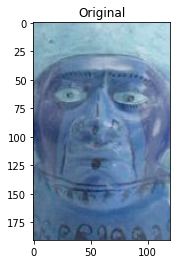

191 120
(221, 211, 341, 402)
221 isss [ 0.02989572  0.02633408  0.2135628   0.04423115  0.06433709  0.1720803
  0.01472396 -0.10499898  0.0781836  -0.08293407  0.00144968  0.0045708
 -0.10067026  0.00826029  0.15337552 -0.09054197 -0.05121447  0.05463757
 -0.01218603 -0.08971946  0.04917556  0.11028589 -0.04343925  0.04139369
  0.10031688 -0.0152956  -0.13163154 -0.03883211  0.04647622 -0.02555992
  0.11643501 -0.01023581 -0.07611225 -0.0460222   0.1772929   0.06851637
 -0.00469981  0.02481552  0.06791835 -0.091168    0.10489909  0.078247
 -0.10980683 -0.10593401 -0.09205003  0.02122558 -0.05277443 -0.05242766
 -0.06078406 -0.12943381 -0.05945364  0.123393    0.12140384 -0.02180571
  0.03044187  0.01950266 -0.02803084  0.08470901 -0.15723057 -0.03921775
 -0.07597837  0.04120787  0.06388133 -0.09144432  0.10527118  0.12787396
  0.1061951   0.05606654 -0.07736711  0.18369779  0.12218261  0.07923357
 -0.00126044 -0.07703876  0.02178396  0.02913893 -0.15479822 -0.11055271
  0.03287733  0.0

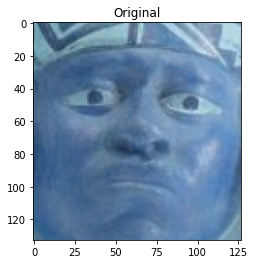

133 127
(244, 227, 371, 360)
244 isss [ 8.66894349e-02  1.22090410e-02  9.90109518e-02 -6.78199902e-02
 -2.99673174e-02  7.37299696e-02 -2.28512250e-02  1.47462599e-02
 -1.04438409e-01  7.47124702e-02  4.38030586e-02 -6.85120746e-02
  1.58998631e-02  1.49013430e-01  1.69806570e-01 -5.65470643e-02
  6.72620311e-02  5.65800164e-03  1.77972585e-01 -9.87619162e-02
  3.17970775e-02  2.24232569e-01 -8.42901692e-02  4.84118201e-02
  7.75737280e-05  7.27438927e-02  4.95465398e-02  1.62649024e-02
  8.94510075e-02  1.04520053e-01 -1.07934371e-01 -1.38017669e-01
 -5.54706790e-02 -7.10897818e-02  1.03452846e-01  3.67781185e-02
  1.25775700e-02 -2.26388201e-02  6.90830499e-02  7.26201609e-02
 -1.19251035e-01  8.54119509e-02 -1.25158325e-01 -2.43691280e-02
 -1.35031976e-02  1.33494109e-01 -1.46817751e-02 -1.62823703e-02
 -2.26884941e-03 -9.40949917e-02  1.44688532e-01  2.16613472e-01
  1.40507957e-02  4.32883985e-02  4.05759588e-02 -4.86483506e-04
  8.10958892e-02  1.29056035e-03  8.15448817e-03  1.

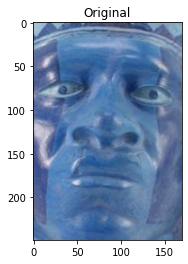

249 170
(221, 111, 391, 360)
221 isss [ 0.02679187  0.11533433  0.05460503 -0.07729077 -0.02725423  0.03668717
  0.04420345 -0.08141262 -0.09712274  0.07739734  0.03634589 -0.07014528
  0.00534739  0.15921295  0.18415992 -0.13059798  0.07244115 -0.04233241
  0.16235653 -0.03939842 -0.11204391  0.17317389 -0.10852089  0.00463674
 -0.03470045  0.06166648 -0.03311522  0.05619462  0.1297692   0.07658894
 -0.10863975 -0.06192047 -0.04594593 -0.09324381  0.09541814  0.08294766
  0.06575929 -0.00618683  0.0590237   0.07157163 -0.03290135  0.04089001
 -0.13013369 -0.07137912 -0.0628479   0.3112835   0.00735406  0.01899984
 -0.06159836 -0.13962485  0.00321479  0.23362528  0.03020885 -0.0031069
  0.0217319   0.02342754 -0.00148173  0.04948762 -0.06062861  0.10775685
  0.0095402   0.03879962  0.01118491 -0.01320233  0.0023937  -0.01336755
  0.14713094  0.05205742  0.0542126   0.04272842  0.11557302 -0.0032971
 -0.01608087 -0.04279185  0.09235002  0.06996846 -0.11316831  0.03118632
  0.0936965  -0

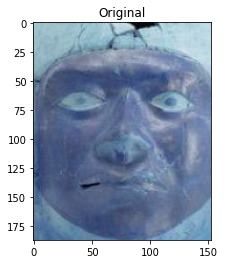

187 153
(212, 174, 365, 361)
212 isss [ 0.01925133 -0.04620849  0.09767193 -0.08863769 -0.04528453  0.14063866
  0.02755371  0.09837352 -0.07386674  0.06985417  0.04546551  0.00847215
  0.05269925  0.06892114  0.16920812 -0.12297238 -0.03759122 -0.00219085
  0.0956622  -0.07477811  0.02131057  0.04219349 -0.01567392 -0.01954457
  0.02827791  0.1598951   0.01046771 -0.10255758  0.07421193 -0.06679658
  0.03399407 -0.02793555 -0.05260894 -0.03071635  0.05444502 -0.00393378
 -0.01884267  0.21760644  0.12730135  0.03839483  0.06204939  0.03743261
 -0.16812716  0.00427587 -0.16484395 -0.1308577  -0.02476094 -0.10891838
 -0.04445345 -0.14165407 -0.00656422  0.09580548 -0.01061238  0.07341015
  0.00143772  0.02425067  0.02899021  0.13451934 -0.09764646 -0.11071003
 -0.09798855 -0.13002522  0.12247019 -0.05349292  0.07282552  0.09316978
  0.14151803  0.077908    0.04799151  0.05431509  0.06202162  0.09364394
 -0.02154255  0.00204938  0.05214971 -0.0819227  -0.16351797 -0.07428207
  0.07559372 

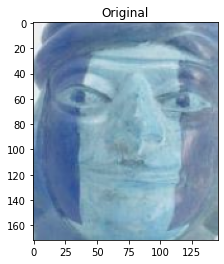

172 146
(224, 208, 370, 380)
224 isss [ 0.0851182   0.04404424  0.05894262 -0.11812168  0.0293221   0.10012846
  0.08855272 -0.01803731 -0.11576484  0.13241033 -0.0158845  -0.03897172
  0.08296741  0.18946065  0.11517607 -0.05418483  0.03804561  0.04342359
  0.07652656 -0.10485011  0.04615937  0.18264915 -0.03685275 -0.07183172
 -0.07271042  0.04330692 -0.03999521  0.01838403  0.10321071  0.15284653
 -0.18587877  0.01409602 -0.04965582 -0.04437892  0.12279021 -0.03787117
  0.03743942  0.09515403  0.05308782 -0.01519192 -0.14657725  0.06200947
 -0.09913073 -0.07491715 -0.0832539   0.17203614 -0.05421573  0.02808802
 -0.07388156 -0.09990607  0.11619664  0.1883818   0.0019236   0.06496432
  0.03283175  0.00286013  0.1098737   0.0183029  -0.07967009  0.02248118
  0.08450818 -0.0279818   0.02613536 -0.01596787  0.06144831 -0.03726863
  0.04078246  0.16870601  0.02526127  0.10974856  0.09330843  0.03128571
 -0.0208975  -0.12366065 -0.08285293  0.10458876 -0.07556501 -0.0820595
  0.10119811 -

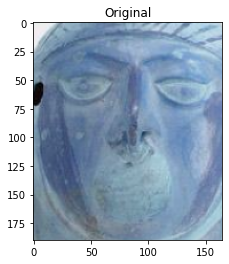

190 165
(209, 170, 374, 360)
209 isss [ 0.0218091   0.10554727  0.1973155  -0.10503485  0.02731392  0.08655769
  0.08205088  0.16300155 -0.14567454  0.07382273 -0.0366106  -0.0604424
  0.02342135  0.1172728   0.18494955 -0.04384401  0.08384759 -0.01638323
  0.05105533 -0.07793985  0.08841549  0.14176548 -0.02119846 -0.02919166
 -0.01807509 -0.02351689 -0.08518787 -0.00030728  0.16690797  0.01281846
 -0.08308337 -0.07300214 -0.02813812 -0.01642578  0.05024119 -0.02450019
  0.05148052  0.14297578 -0.02095715  0.06349012 -0.03510225  0.10106159
 -0.10113792 -0.118861   -0.07361272  0.19551894 -0.00641072 -0.12226509
 -0.12318403 -0.11471783  0.06100326  0.19570848 -0.08897197  0.0576967
  0.01491979  0.01291014  0.13143474  0.00535578 -0.0616661   0.00829539
  0.03918879 -0.0312699  -0.08762241 -0.07808066  0.11532625 -0.08021803
  0.06746832  0.11153744  0.01867305  0.1186135   0.13402858  0.07897651
 -0.02720102 -0.09630448  0.05184793  0.13920464 -0.0946342   0.09931321
  0.10598944 -0

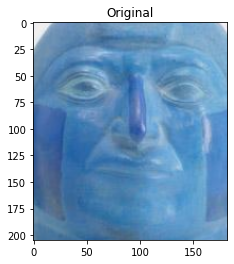

205 183
(205, 182, 388, 387)
205 isss [ 0.01539104  0.09773046  0.21967629 -0.05562995 -0.03206575  0.10212209
  0.0311015   0.08695555 -0.04340755  0.04751007  0.03940248 -0.07329178
 -0.01157594  0.1416525   0.15064496 -0.0990907  -0.00491275 -0.03012615
  0.02361894 -0.12361234  0.04646009  0.19916223 -0.07175594 -0.02094464
 -0.0103731  -0.05097421 -0.02240486  0.12823735  0.09014945  0.02924437
 -0.09876927 -0.20087269 -0.05328473 -0.03066069  0.05022886  0.04380303
  0.0010324   0.00563075 -0.0633475   0.11540395 -0.06782262  0.12305932
 -0.11081425 -0.0729198  -0.03214795  0.08992545 -0.06048144 -0.06306477
 -0.00059256 -0.05355684  0.11221389  0.2272113  -0.13009214  0.07072681
  0.03140338  0.01823309  0.0114348  -0.04134864 -0.01900708  0.0187845
  0.02924409 -0.03965442 -0.07284609 -0.014172    0.02574541 -0.08078357
  0.13781595  0.08786312  0.06631721  0.20960428  0.17211829  0.08861285
  0.07367251 -0.07517622  0.01727414  0.09223618 -0.11621258  0.05459054
  0.05456869 -

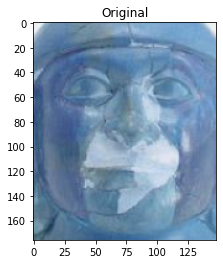

176 148
(212, 219, 360, 395)
212 isss [ 0.14230512  0.06348895  0.15036026  0.05909574  0.05349704  0.16229917
  0.03073136 -0.10106184 -0.06586033 -0.0109529   0.05352727 -0.00150931
 -0.04769415  0.09211633  0.1464533   0.01060667  0.02573896 -0.01137032
  0.02235713 -0.12603109  0.04268268  0.207556   -0.09006796  0.02719865
  0.12711711 -0.0442808   0.0036864   0.07822103  0.0198731   0.1212473
 -0.10664635  0.00433621 -0.11522788  0.00745737  0.03990196  0.01076565
  0.03224314 -0.1608853   0.10982605  0.02569259  0.02507906 -0.00133368
  0.04382714 -0.1516769  -0.01297568  0.09084284 -0.02753918 -0.07548825
 -0.02245717 -0.08414038  0.22333024  0.14307636  0.00301346  0.07209616
  0.04785471 -0.0065355   0.0133903  -0.02101467 -0.01141485  0.071551
  0.04643805 -0.02093811 -0.08160583 -0.07814129  0.00304175  0.04637369
  0.07062807  0.069446    0.01509405  0.15034401  0.05510632  0.12013661
 -0.00322518 -0.14748198  0.04415687  0.1092939  -0.01771169 -0.0306307
 -0.04697165  0.0

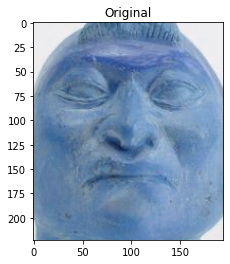

223 195
(205, 135, 400, 358)
205 isss [ 1.35945724e-04  1.14709549e-02  1.07117265e-01 -8.73683989e-02
 -8.41608718e-02  8.75464901e-02 -1.64759010e-02  1.89682357e-02
 -4.80559468e-02  4.67503890e-02  2.26306245e-02 -3.47044244e-02
 -4.21339795e-02  1.47797599e-01  1.68503568e-01 -1.35927528e-01
 -2.15179920e-02 -3.23146172e-02  1.89015925e-01 -1.23810999e-01
 -9.91469249e-02  2.51692265e-01 -7.59679526e-02  5.70689328e-02
 -6.32965043e-02  5.80231026e-02  1.01915427e-01  8.01948234e-02
  5.28927706e-02  2.18284037e-02 -7.74700865e-02 -2.28707179e-01
 -1.93272959e-02 -1.01302832e-01  7.87844881e-02  7.57679343e-02
 -1.69590116e-02 -6.23049624e-02 -3.52982022e-02  1.70904547e-01
 -7.00272620e-02  1.10379934e-01 -1.34249970e-01  1.75298899e-02
 -5.90129644e-02  6.23147078e-02 -3.37957703e-02 -3.40499058e-02
  3.24944966e-02 -3.63394693e-02  9.71456766e-02  1.24848984e-01
  1.17845018e-03  2.47604698e-02  3.42754982e-02  7.72911757e-02
 -7.82741606e-03  9.18518379e-02  8.89662839e-03  7.

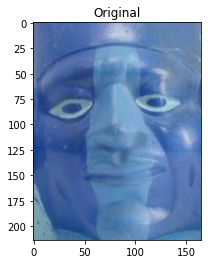

214 165
(214, 159, 379, 373)
214 isss [ 0.1551492   0.02221202  0.11810347 -0.08213271  0.09711993  0.23627937
  0.09141858  0.0624636  -0.1562757  -0.02442531 -0.09381536  0.02872961
  0.04347919  0.02671706  0.09985647 -0.04486676 -0.01619944 -0.03848098
 -0.04400443 -0.02405559  0.09746351  0.15868656 -0.01331679  0.04108769
 -0.02683081 -0.01531345 -0.09164147 -0.06714761  0.02312979  0.06410893
 -0.11460266 -0.04373563 -0.18397777  0.02416612  0.05197281 -0.02189125
 -0.0335787   0.04594752 -0.0054235   0.009245   -0.03000105  0.07336069
 -0.0544591  -0.04588647 -0.07589248  0.11907166  0.01267011 -0.04294897
 -0.13956708  0.04277216  0.14767069  0.0263819  -0.03354529  0.06306668
  0.0974396  -0.04749993  0.03008905  0.1388197   0.00214817 -0.06430615
  0.06210476  0.05772144  0.03836956 -0.11626434  0.07816974 -0.09625702
  0.05683579  0.14609289 -0.02770716  0.11194385  0.1098299   0.15366304
  0.01823027 -0.08075894 -0.0605497   0.13085333 -0.0756963  -0.03816484
  0.11685791 

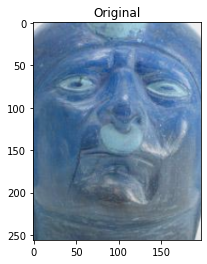

256 197
(198, 127, 395, 383)
198 isss [ 4.1201629e-02  9.7786926e-02  9.0541624e-02 -2.8540315e-02
  4.2847991e-02  5.7546124e-02 -7.6028709e-03 -8.4741898e-02
  5.0381411e-02 -4.9883891e-02  5.3965848e-02 -6.8392649e-02
 -5.3880334e-02  1.5746430e-01  3.5597872e-02 -3.0694073e-02
  6.8151973e-02 -4.3949045e-02 -1.2658564e-02 -8.0570906e-02
  2.1040184e-02  1.7391033e-01 -1.2702774e-01 -4.6200994e-02
  4.0271062e-02 -3.5223160e-02 -5.0970027e-03  1.6649033e-01
  1.1522982e-01  5.8982532e-02 -4.8690125e-02 -6.8805389e-02
 -4.9777117e-02 -8.6551934e-02  3.4984350e-02  8.7918483e-02
  3.7566256e-02 -7.9145804e-02  4.2794053e-02  4.7846586e-02
  9.4052870e-03  8.4898740e-02 -6.7360349e-02 -1.3240042e-01
  6.0760148e-02  2.1742639e-01 -9.3470268e-02 -1.6817205e-02
  2.2501089e-02 -1.8443851e-01  1.0843700e-02  2.7457941e-01
  2.9265636e-03  2.0635642e-02 -1.5194848e-02 -6.6640540e-03
  3.3918193e-03 -4.5262128e-02 -8.4304675e-02  9.3352608e-02
  5.9580788e-02  2.6217461e-02 -4.7841676e-02  

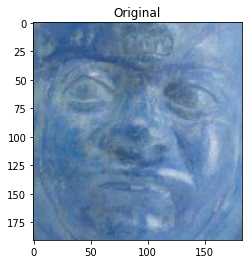

191 183
(203, 137, 386, 328)
203 isss [ 0.05042309  0.05311611  0.24404308 -0.07772247 -0.00705467 -0.01140656
  0.02450927 -0.00827103 -0.00466805 -0.05001239  0.0142747  -0.06678032
 -0.05106156  0.19293201  0.1456293  -0.04124296  0.0384771  -0.06068217
  0.02395118 -0.07637076  0.0446464   0.24700254 -0.11112703  0.08281299
 -0.00500211 -0.00084278  0.00628195  0.13960393  0.14243478  0.0636343
 -0.13180514 -0.14514235 -0.0391519  -0.02122922  0.0503339   0.06057416
  0.03473267  0.00907858  0.0012405   0.08423751 -0.06782951  0.11979977
 -0.06172942 -0.13201757  0.07358541  0.2289444  -0.04893188 -0.06016603
 -0.02349669 -0.09303448  0.03553089  0.2085259  -0.01975768  0.05015255
  0.07736991  0.00686562  0.01980204  0.03252045 -0.06611538  0.07849764
  0.08944149  0.01258365 -0.08295394  0.07918071 -0.04566156 -0.03806181
  0.09224323  0.0630815   0.08656666  0.13620901  0.11448068  0.00471073
  0.00081197 -0.07777435  0.09032789  0.09244036 -0.06839523  0.07037491
  0.05855183 -

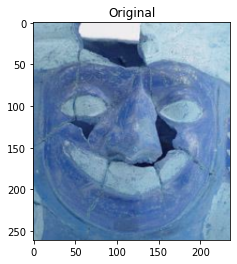

261 236
(186, 88, 422, 349)
186 isss [ 0.12426703  0.013192    0.04396841 -0.15369463  0.03386963  0.13975012
  0.04687096  0.09223011 -0.11097876 -0.13588972 -0.04953231  0.05999028
  0.04530877 -0.0372083   0.03873437 -0.09991151 -0.01302433 -0.178423
 -0.08495452  0.08368598  0.03601525  0.09493402 -0.0200988   0.04416808
 -0.05778424  0.08234888  0.02354757 -0.06232237 -0.02934402 -0.04764681
 -0.05826834 -0.08824853 -0.07299668  0.13316302 -0.03638438 -0.05444913
  0.04701307  0.20200135  0.00143685  0.0367898   0.0450126   0.00604794
 -0.03316764 -0.0015021  -0.04610996  0.07608431  0.0524689  -0.0607669
 -0.15817474  0.10898896 -0.0080913  -0.05931644 -0.02320725  0.10822294
  0.1193599  -0.04945385 -0.09226386  0.20082186 -0.11296479 -0.12148836
 -0.01395507  0.01615111  0.1138702  -0.100557    0.0300919  -0.02448057
  0.06256366  0.11759121 -0.04058292 -0.04043647  0.03386337 -0.01032606
 -0.02255702  0.0162424   0.09079956  0.05725941 -0.03359353 -0.06196347
  0.12627621  0.1

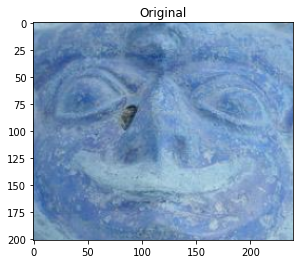

201 240
(175, 104, 415, 305)
175 isss [ 5.74966446e-02  9.57498252e-02  1.51408419e-01 -8.22607502e-02
  4.02029324e-03  4.18014638e-03  3.21171223e-03  8.76521226e-03
 -2.76359357e-02  9.08508301e-02  4.12414633e-02 -9.17652324e-02
  3.87238301e-02  1.50964260e-01  1.39262617e-01  5.85438684e-02
  6.28341213e-02 -3.91566157e-02 -3.94015685e-02 -5.28319664e-02
  5.62371537e-02  2.00057238e-01 -8.58172774e-02  4.89289239e-02
 -1.01755690e-02 -5.86269610e-03  1.23293083e-02  1.22898862e-01
  1.37983724e-01  1.11750200e-01 -1.65233687e-01 -1.83608867e-02
  1.69114803e-03  3.32229994e-02  1.15007032e-02  2.38916166e-02
  8.68661255e-02  1.86794214e-02  3.91988531e-02  3.48076448e-02
 -9.31613594e-02 -2.42781523e-03 -8.80667381e-03 -1.71328381e-01
  8.93109366e-02  2.10912049e-01 -4.54673432e-02  2.18782220e-02
 -5.05801998e-02 -9.68544260e-02  1.30166128e-01  2.12326750e-01
 -2.47078985e-02  5.38382307e-02  7.50393718e-02  1.64812652e-03
  6.30772412e-02 -9.81262475e-02 -2.06968524e-02  3.

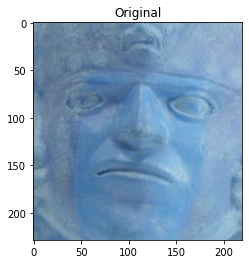

229 220
(186, 96, 406, 325)
186 isss [ 0.02063842 -0.07006961  0.08866534 -0.14968444 -0.07658655  0.08336623
 -0.07541625  0.11549254 -0.12434358  0.11143182  0.03508023 -0.05256642
  0.08670359  0.16561212  0.193583   -0.06169725 -0.02373486  0.01329967
  0.12036648 -0.03324564 -0.00694977  0.17027918  0.08781269  0.05133564
 -0.09329715  0.11742548  0.11676838 -0.05637418  0.05720964 -0.03110445
 -0.06621059 -0.15182179  0.00340253 -0.02936955  0.02847045  0.05648484
 -0.06744374  0.19072364 -0.03045246  0.13266718 -0.16625819  0.09937042
 -0.24597447  0.03352579 -0.11031829 -0.02913579 -0.027223    0.00623809
 -0.02260764  0.00353821  0.07336266  0.08528897 -0.01166728  0.05001245
 -0.01227     0.02370714  0.10780873  0.10020778  0.05994458 -0.07427059
 -0.0653685  -0.04665795  0.07757193  0.02746457 -0.01530454 -0.02520215
  0.11748728  0.12470858  0.07601564  0.10681678  0.05551014  0.04975259
  0.01586109 -0.01903692 -0.00479801 -0.0907195  -0.16973199 -0.07246899
  0.10887955  

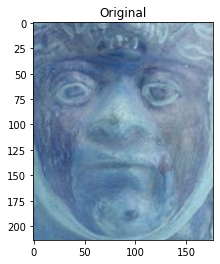

214 177
(222, 142, 399, 356)
222 isss [ 9.08299759e-02  2.19474621e-02  1.24974690e-01 -1.26121968e-01
  7.30834603e-02  1.34299666e-01  7.86068514e-02  7.85571635e-02
 -1.18699752e-01 -3.79323773e-03 -7.71364048e-02 -4.18845490e-02
  5.51107079e-02  8.54533911e-02  1.96369529e-01 -1.67101383e-01
  2.80516390e-02 -5.21931723e-02  5.87910833e-03 -3.16519588e-02
  7.25219399e-03  8.57401714e-02  4.34831297e-03 -8.66259933e-02
  1.28231635e-02 -8.78444407e-03 -9.85075384e-02 -1.15879783e-02
  1.90268438e-02 -3.97236310e-02 -1.13997525e-02 -5.81468903e-02
 -7.86084831e-02  1.22973863e-02  1.09382458e-01 -3.44881415e-02
  2.33540498e-02  1.47638813e-01  4.80942279e-02 -8.24154764e-02
  4.38729972e-02  4.08542491e-02 -1.12795606e-01 -7.64513165e-02
 -1.51941329e-01  1.34872913e-01 -9.33283940e-02  2.44253390e-02
 -9.28956643e-02 -5.70469238e-02 -3.57121527e-02  1.10578865e-01
  7.16009736e-02  3.85264717e-02 -8.46037656e-05 -6.52259365e-02
  2.32613087e-02  4.14891392e-02 -1.08705878e-01 -9.

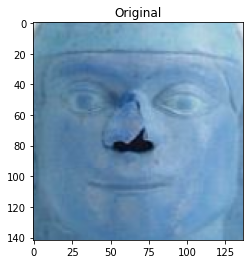

142 137
(235, 260, 372, 402)
235 isss [ 0.02873654  0.02450215  0.11691631 -0.10539771 -0.02793918  0.17853652
 -0.00293459  0.07624698 -0.04529815  0.02545725  0.0018317   0.06820948
  0.03313478 -0.02056793  0.08553115 -0.11890564 -0.1257332  -0.02033575
  0.00834666 -0.01252271  0.07636644  0.11081391  0.06281176  0.07085776
 -0.06241674  0.06402917  0.0535989  -0.12828226 -0.02377805  0.020581
 -0.06019907 -0.18589178 -0.01731373  0.03410973  0.06730984 -0.00937664
 -0.01373791  0.18344839 -0.06167286  0.06243305 -0.0634234   0.01518894
 -0.16391604  0.05429398 -0.1655345  -0.0285368   0.02182573 -0.06450823
 -0.07864966  0.09342599  0.11822687  0.0754953  -0.06038596  0.09600732
  0.12717247  0.01795006  0.04404629  0.08821857 -0.06917207 -0.11893257
 -0.03965225 -0.10132549  0.12733023 -0.07657097  0.12948766 -0.1686229
  0.065929    0.10256036 -0.0332357   0.18827365  0.08732675  0.07960857
 -0.01899289 -0.04886662  0.0019703   0.04599463 -0.15091798 -0.00749665
  0.11435731  0.

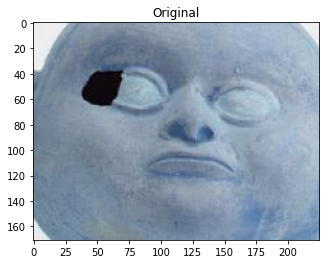

171 225
(182, 182, 407, 353)
182 isss [-1.02721257e-02  8.08222145e-02  1.48481920e-01 -1.47080168e-01
 -5.38816825e-02  9.42690820e-02 -5.53141162e-02  1.24094710e-01
 -2.19193343e-02 -2.42266599e-02 -1.02804992e-02 -3.93367857e-02
 -3.83961909e-02  1.04953744e-01  1.63309634e-01 -1.40710831e-01
 -4.12024781e-02 -8.58698562e-02  3.66445482e-02 -4.26420532e-02
 -2.60973815e-02  1.56488374e-01  4.87443097e-02  4.06082608e-02
 -3.38862017e-02  4.22046557e-02  1.12883627e-01  1.25642875e-02
  3.30470167e-02 -8.67225006e-02  2.81823770e-04 -1.83893532e-01
  3.64474095e-02  6.12126738e-02 -5.17863780e-03  7.66388327e-02
  2.31179297e-02  1.80213302e-01 -9.77305695e-02  1.43740326e-01
 -4.19235788e-02  6.77016675e-02 -1.61855161e-01  8.34800303e-04
 -7.59197250e-02  1.02370635e-01  2.51263846e-02 -7.01776743e-02
 -9.87681225e-02  7.88154230e-02 -1.47732464e-03  1.61760926e-01
 -7.31542856e-02  6.65602908e-02  7.58552104e-02  5.24150468e-02
  1.51403155e-02  9.95826200e-02 -3.28119732e-02 -8.

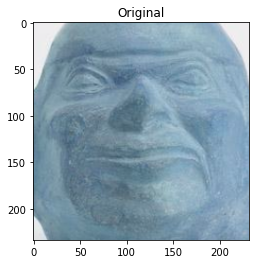

234 232
(181, 148, 413, 382)
181 isss [ 0.03797472  0.11416715  0.08633403 -0.10177817 -0.00245172  0.13841225
  0.05183914 -0.09331846  0.01633612  0.03731579  0.05098804 -0.02973146
 -0.02084947  0.1293836   0.13335441 -0.15317324 -0.08281059  0.00514397
  0.05277775 -0.13430575 -0.01437747  0.17072867 -0.08498383 -0.0593549
  0.02309755  0.01232096  0.02004175  0.08661734  0.05126923  0.10816652
 -0.084135   -0.11918039 -0.00815753 -0.04081197  0.14076693  0.01775242
  0.01022241  0.00079766  0.05061765 -0.0161804  -0.03726278  0.01727454
 -0.05093327  0.01267916 -0.10867225  0.0937542  -0.07086875  0.01876765
 -0.07341816 -0.09057248  0.02243235  0.18077949  0.02286052  0.0288949
  0.03143053  0.0712366  -0.093258    0.08546274 -0.14976455  0.00557069
 -0.03491237 -0.04400101  0.12183298 -0.0132968   0.05992326  0.07610998
  0.04694356  0.08641106 -0.05079197  0.1417433   0.11979897 -0.00919323
  0.00458825 -0.13390316  0.00687239  0.07658851 -0.10185782 -0.17059723
  0.0507522  -0

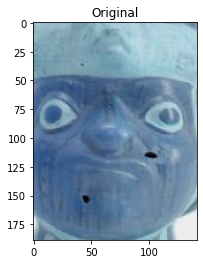

189 142
(231, 188, 373, 377)
231 isss [ 7.14820474e-02 -8.66505206e-02  2.52875476e-03 -6.99508786e-02
  1.02944769e-01  1.28837332e-01  6.02636598e-02  7.20915422e-02
 -2.16685683e-01  5.12639359e-02 -4.72380780e-02  1.18126638e-01
  1.11145765e-01  9.30037163e-03  1.12057067e-01 -8.76428708e-02
  1.09985471e-02  1.03207789e-02  7.87100643e-02  1.51351035e-01
  6.83306530e-02 -7.45364353e-02  1.37761876e-01  6.68187439e-02
 -1.67284459e-02  9.73384827e-02 -6.72799349e-02 -2.23860666e-01
  3.46458144e-02 -1.71885528e-02 -3.61762308e-02  1.41463177e-02
 -5.87087572e-02  2.20213495e-02 -1.06555279e-02 -1.85034163e-02
 -6.43063709e-02  2.42007703e-01  1.15056513e-02 -5.20654768e-02
  2.40435414e-02  3.67113017e-02 -1.38095275e-01  2.66685821e-02
 -2.52039909e-01 -3.90399843e-02  9.53836218e-02 -7.05645829e-02
 -1.09899536e-01 -3.14092729e-03  1.32846041e-02 -8.05084482e-02
 -1.94169991e-02  3.69030237e-02  5.90545945e-02 -1.49040362e-02
  5.50530516e-02  2.04271168e-01 -4.67208251e-02 -8.

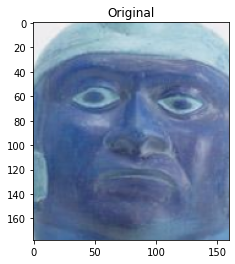

178 160
(217, 190, 377, 368)
217 isss [ 0.13201264  0.01018424  0.12504445 -0.08692315  0.00358365  0.20714614
  0.05227628  0.09185468 -0.20066385 -0.01944721 -0.0206001   0.06579296
  0.05384977 -0.02288472  0.12665382 -0.14376582 -0.06386466 -0.01447076
  0.02110139  0.02679373  0.05871966  0.14111544 -0.01981105  0.09520832
 -0.02075229  0.02779662  0.00050539 -0.09558611 -0.01225213  0.06387631
 -0.13209932 -0.12697092 -0.09348573  0.07042902  0.05766778 -0.04650915
 -0.04127474  0.04918935 -0.02748941 -0.01005626 -0.01549565 -0.01447192
 -0.04855843  0.06186953 -0.1447076   0.03575715  0.08142912 -0.06434263
 -0.21734701  0.10011436  0.1282232  -0.02580255 -0.02229274  0.07495736
  0.11120629  0.00204384 -0.08609181  0.14305195 -0.04204377 -0.09526802
  0.00166734 -0.00339157  0.10368259 -0.08887677  0.07107899 -0.05560518
  0.06243552  0.02673024 -0.10075364  0.05620556  0.0523168   0.06247297
 -0.00425767 -0.05226567 -0.02370501  0.04236076 -0.08898071 -0.10732498
  0.16501397 

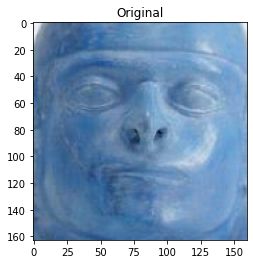

163 160
(220, 233, 380, 396)
220 isss [ 0.04911006  0.01000274  0.23510866 -0.07787134  0.05201528  0.11675054
  0.03854794  0.04218392 -0.11331081 -0.06591601 -0.04126148 -0.03182824
  0.01186119  0.10419457  0.19335271 -0.14378196 -0.0568967  -0.04038944
 -0.01303704 -0.03359409  0.0675531   0.15540636 -0.03533288 -0.07282267
  0.00934939  0.02052167 -0.18233518  0.03437084  0.01340796 -0.04127393
 -0.02326583 -0.13325535 -0.10627397 -0.00427242  0.12570629  0.07056607
 -0.03089627  0.07022054  0.00544022 -0.00956305  0.02663232  0.1491067
 -0.08864188 -0.04123382 -0.11113556  0.10340952 -0.02810712 -0.04095705
 -0.04891627 -0.02444921 -0.02753814  0.09214905 -0.05461752  0.08005673
  0.06389827 -0.05678334 -0.03059229  0.0581159  -0.07783362 -0.04440006
  0.01786096  0.05792613 -0.01042363  0.0152954   0.04652242 -0.01508789
  0.11094794  0.1432104   0.05607634  0.11904906  0.2079401   0.11575528
  0.09587738 -0.05622026 -0.00634154  0.08299696 -0.19521944 -0.10498687
  0.13073213  

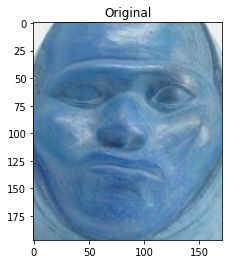

197 171
(213, 207, 384, 404)
213 isss [-0.01569105 -0.00701878  0.04886287 -0.07626714 -0.02359666  0.10618948
  0.04933633  0.1590492  -0.11100098  0.03373705 -0.00971008 -0.09320993
  0.04490927  0.08753959  0.17924033 -0.12665153 -0.0010877  -0.09781605
  0.15256387 -0.0019082   0.01440459 -0.06339608  0.03269664 -0.04832449
  0.03210029  0.05445837 -0.06657752 -0.08498121  0.12601656 -0.12851715
  0.1039618  -0.13419329 -0.04850893 -0.05819843  0.034221    0.06625738
 -0.06046029  0.16908501 -0.01378878 -0.03740909  0.00602143  0.07324912
 -0.16674758  0.04091129 -0.11037426 -0.02925058  0.00102337 -0.0275941
 -0.06701962 -0.10278955 -0.18494304  0.03485782  0.0380446  -0.0193608
 -0.00559195  0.04450643 -0.04946657  0.18484606 -0.03353284 -0.11794831
 -0.10001955  0.01434811  0.15356274 -0.09168182  0.09220947  0.16506152
  0.10158801  0.02782845  0.01826057  0.00538717  0.03731757  0.11188304
 -0.01690653  0.02378715  0.02644444 -0.08207178 -0.07147405 -0.0556539
  0.1314968   0.

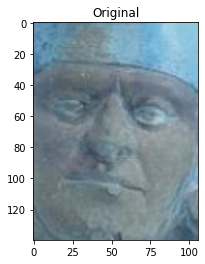

140 106
(257, 229, 363, 369)
257 isss [-0.01671301 -0.00662402 -0.01647803 -0.15734296 -0.02781368  0.13307674
  0.02772441  0.01167901  0.00547671  0.01023287  0.0563216   0.11413725
  0.06400752  0.0549927   0.00367316 -0.15886264 -0.08145463  0.01490656
  0.01787784  0.05028712 -0.01469159  0.12826306 -0.05597804  0.10196169
 -0.16239275  0.13225622  0.08761833 -0.07542276  0.03570246  0.03874682
 -0.08021213 -0.15313101  0.01859717 -0.03397859  0.04933673  0.07382938
 -0.01391517  0.15394206 -0.09659521  0.10105953  0.00069401  0.07343346
 -0.17446351  0.1206162  -0.15269682 -0.01613488  0.06690618 -0.03654339
 -0.09291685 -0.00346902 -0.06890514 -0.00958235 -0.04983457  0.06917925
  0.08920617  0.10813287 -0.10280363  0.2203658  -0.12543932 -0.0488948
 -0.09789728 -0.03517263  0.2713181  -0.05987884  0.08059692 -0.0877386
  0.1364379   0.02476789 -0.01035468  0.07322463  0.11271832 -0.01692277
  0.03513755 -0.003049    0.03737772  0.04503731 -0.16076867  0.00808092
  0.07117599 -0

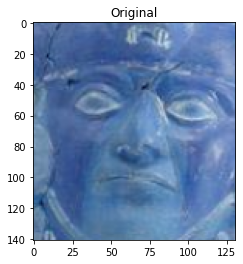

141 131
(227, 218, 358, 359)
227 isss [ 0.13334002 -0.04403354  0.13335079 -0.10573765  0.11425739  0.1347642
  0.06992064  0.00874043 -0.07606919 -0.06029335 -0.07230796  0.00930758
  0.03974533  0.16206172  0.14213179 -0.10247311  0.07106043 -0.00979571
  0.00926432 -0.02980704  0.04673411  0.2287032  -0.07213446  0.03970254
 -0.01508639  0.01615393 -0.05090532  0.04843928  0.02301919  0.06354427
 -0.0982862  -0.07762484 -0.10936414 -0.00701558  0.11274976  0.01807109
  0.03339294  0.03261892  0.00843077 -0.05400683  0.02535964  0.14290564
 -0.01668633 -0.0605026  -0.08581683  0.1467794  -0.04702741  0.00313821
 -0.02294712 -0.03491767  0.05685623  0.04156369  0.04648764  0.06678461
  0.11231872 -0.0281164  -0.01850851  0.10187326 -0.03763633 -0.04573516
  0.05913597  0.04693655 -0.0254466  -0.01707816  0.01379462 -0.02228831
  0.07493919  0.15729097  0.038934    0.07283481  0.15494955  0.06264663
  0.02250319 -0.14762832 -0.03722538  0.14301959 -0.10764302 -0.06540478
  0.11917222  

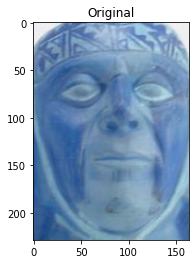

229 164
(216, 172, 380, 401)
216 isss [ 0.08239471  0.11943572  0.1297029  -0.03243271  0.00718862  0.02304674
  0.06840635 -0.0093606  -0.03868566 -0.02540307  0.02465738 -0.09511589
 -0.03715644  0.20702991  0.14515083 -0.13243544  0.17065708 -0.04811407
  0.11969152 -0.09218334 -0.01639689  0.19460607 -0.1107054   0.01843422
  0.03230616 -0.05451343 -0.00217677  0.17283851  0.15242082  0.09408012
 -0.06414996 -0.11568879 -0.02306727 -0.04938567  0.07143009  0.03707995
  0.07532944 -0.02079293  0.01175097  0.03380223 -0.04877367  0.12617044
 -0.05440485 -0.10082655 -0.00194245  0.23163475 -0.06532735 -0.03136644
 -0.00400355 -0.11033769  0.02789355  0.29716092  0.01431812  0.01497123
  0.02767543  0.01207909 -0.00798737  0.01759895 -0.04877681  0.06149957
  0.02872983  0.00929907 -0.05313494 -0.03749164 -0.02885077 -0.02940279
  0.13986559  0.02275523  0.02284902  0.12750423  0.12707081 -0.01339653
 -0.01792954 -0.08090495  0.03445177  0.0835783  -0.01477362  0.04671758
  0.04728344 

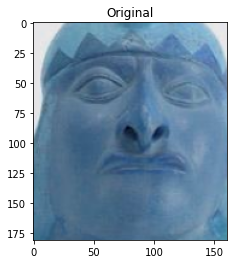

181 161
(214, 212, 375, 393)
214 isss [-0.02987926 -0.00276412  0.05828131 -0.12410074 -0.0519658  -0.053098
 -0.06260887  0.01877441  0.028137    0.04151184  0.07206205  0.00835413
  0.01122641  0.1971705   0.10376914 -0.04608803  0.04805093 -0.0284865
  0.17398691 -0.02793449  0.04184982  0.19846198 -0.02821981 -0.00860742
 -0.07368021  0.12998508  0.12015155  0.01401133  0.07947794  0.11136197
 -0.08823095 -0.17555399  0.13997427 -0.089278    0.07441738  0.06727905
  0.066154    0.12984939  0.02734399  0.1421679  -0.15341589  0.15305345
 -0.14101683 -0.02265061 -0.01517949  0.09837154 -0.02052068 -0.11380142
  0.06785709 -0.09962384  0.00978166  0.16927972 -0.0283348   0.07781313
  0.03033371  0.0812711   0.07325318  0.01257412 -0.13352397  0.06707409
  0.01465525 -0.14975807  0.03336659  0.02228463  0.05193447 -0.16691451
  0.09675753  0.06702515  0.12537584  0.0589502   0.13003916 -0.02964318
 -0.03937877 -0.1358      0.0449204   0.07533105 -0.12164975  0.04595553
  0.02422602 -0.

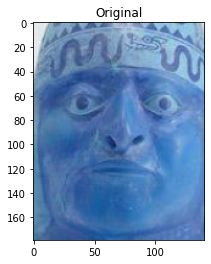

179 141
(225, 205, 366, 384)
225 isss [ 7.67969042e-02  6.84106424e-02  7.66281262e-02 -1.15024075e-01
 -4.43107355e-03  9.39070061e-02 -1.29601583e-02 -1.28354840e-02
 -6.61318675e-02 -2.92413309e-02  3.13614495e-02 -1.57053508e-02
 -1.38478270e-02  1.51796088e-01  9.27306563e-02 -7.61698782e-02
  6.07916862e-02 -5.47432788e-02  8.44051912e-02 -4.72685322e-02
 -7.10026920e-03  2.59345144e-01 -1.06884137e-01  1.26942232e-01
 -3.62295061e-02  3.80069837e-02  1.18550502e-01  8.20623413e-02
  7.60259107e-02  8.89357030e-02 -1.53081402e-01 -1.94554940e-01
 -5.67495041e-02 -2.51011774e-02  2.99916156e-02  6.04725070e-02
  4.72833216e-02 -4.46241461e-02 -2.59831613e-05  1.45208403e-01
 -4.78902757e-02  8.84068906e-02 -5.78944720e-02 -3.38163376e-02
 -4.09575441e-04  1.98614344e-01  3.24480906e-02 -4.73283343e-02
 -5.98462000e-02 -4.08807471e-02  1.17319219e-01  1.51190862e-01
 -2.58431602e-02  6.80399835e-02  9.84104723e-02  3.34792472e-02
 -3.68759705e-04  1.03014588e-01 -1.93718784e-02  3.

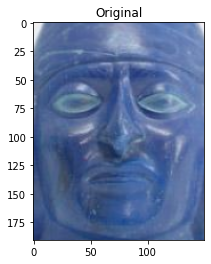

191 150
(223, 199, 373, 390)
223 isss [-3.07429396e-02  4.06891853e-02  5.81958331e-02 -4.53898162e-02
 -3.82820964e-02 -3.16701606e-02 -3.87447551e-02 -9.19350982e-02
  1.16329007e-01 -7.05470964e-02  1.02550320e-01 -2.67697033e-03
 -5.58596924e-02  1.27761811e-01  3.13045830e-02 -2.21148804e-02
  1.85421407e-02 -3.76151875e-02  1.01072252e-01 -4.53782938e-02
  3.98280285e-02  1.95776090e-01 -1.04025781e-01  3.93429548e-02
 -4.72847708e-02  8.68204311e-02  7.95079097e-02 -1.80920437e-02
  1.01597555e-01  1.09884530e-01 -1.63596515e-02 -1.63497597e-01
  7.45362118e-02 -1.13329969e-01  1.02406420e-01  1.42306998e-01
  6.44644648e-02  3.25616710e-02  6.52060006e-03  1.40201807e-01
 -7.78924078e-02  1.45243987e-01 -1.26520932e-01  2.03929245e-02
  3.51850502e-02  1.79667071e-01  3.06760129e-02 -1.25392646e-01
  2.10827664e-02 -1.53327331e-01 -6.41189516e-02  1.31258383e-01
 -1.62673853e-02  2.60276981e-02  4.18304577e-02  9.55081061e-02
 -2.41465531e-02  6.68778867e-02 -1.37631044e-01  1.

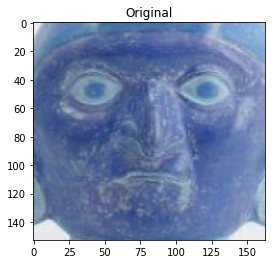

153 163
(215, 225, 378, 378)
215 isss [ 0.04267699  0.14713068  0.11603434 -0.07827304  0.05272159  0.07717947
  0.09498101 -0.00978249  0.03096298 -0.00028445  0.01405714 -0.06975853
 -0.00888114  0.12420548  0.10227995 -0.01727524  0.0314125  -0.08124612
 -0.06033009 -0.10544153  0.04738118  0.15747012 -0.12843621 -0.00795433
 -0.0012486  -0.06864961 -0.06391273  0.08828516  0.13066313  0.08439871
 -0.09292339 -0.04904621 -0.07185294 -0.04281395  0.03087394  0.05276202
  0.06683459 -0.02630978 -0.01028273  0.06600507  0.00724846  0.06043973
 -0.04325954 -0.13103575  0.04571702  0.28266326 -0.04745435 -0.04577947
 -0.0636064  -0.16276315  0.02781009  0.20076819 -0.05168696  0.02435013
  0.04881778  0.02198037 -0.00606412 -0.00157648 -0.08265975  0.08845401
  0.05577388 -0.0006676  -0.07837819 -0.02140501  0.01955322 -0.04289786
  0.06932755  0.15021493  0.08959533  0.09640779  0.15221569  0.048002
 -0.01322137 -0.17337179  0.09434616  0.21776237 -0.06086694  0.11410079
 -0.01197039 -0

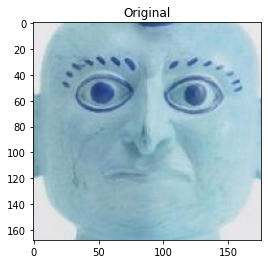

168 176
(204, 178, 380, 346)
204 isss [ 0.00655418 -0.00640199  0.08411003 -0.0713322   0.06120747  0.19413562
 -0.11115356  0.02444697 -0.09983746  0.0403934   0.05170112  0.09802959
  0.1098491   0.08876482  0.1522569  -0.02315978 -0.02956118  0.13068184
  0.00672319  0.06141835  0.13790905  0.04559678  0.16934107  0.14143151
  0.04270598 -0.02766499  0.05653438 -0.13473733  0.01127178  0.08267231
  0.01064292 -0.06941791  0.09623972  0.03013963  0.01260398  0.07832337
 -0.07940637  0.09595073 -0.05520309  0.00527857 -0.05075637  0.01074035
 -0.07180089  0.06586656 -0.23723862 -0.10949421  0.10012505 -0.07854085
 -0.11497616  0.03240431  0.12225261 -0.08282404 -0.03652038  0.02442488
  0.03673964  0.10749923  0.00436384  0.13760617 -0.01306568 -0.10463464
 -0.12555857 -0.0483669   0.11195021 -0.11312285  0.13283294 -0.02552271
 -0.02458434  0.0934302  -0.1455174   0.1586749   0.06335694  0.10067472
 -0.07083502 -0.19390239  0.02486561  0.0530226  -0.10629874 -0.06385418
  0.04710352 

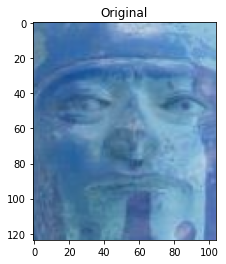

124 104
(250, 203, 354, 327)
250 isss [ 0.04648475  0.11805265  0.10105258 -0.1681804  -0.02002716  0.13454254
  0.07577667  0.00137189 -0.11096202  0.06168526  0.02827661 -0.02990425
  0.06232183  0.12590848  0.15822928 -0.10758083 -0.05401677 -0.01558927
  0.04406971 -0.08082961  0.02126074  0.20452128 -0.0260113  -0.074237
 -0.07895733  0.05829494 -0.02321322  0.00051986  0.1507293   0.08898543
 -0.13228957 -0.03766097 -0.06443657 -0.03932317  0.1059339  -0.00771412
  0.02096711  0.15913755  0.03955292  0.09602757 -0.05733886  0.04019335
 -0.17345406 -0.01844094 -0.15259804  0.16525903 -0.02251416 -0.0264913
 -0.12044239 -0.07952411  0.03513651  0.23698463 -0.06966939  0.07926548
 -0.01140985  0.00814622  0.05414633  0.08132738 -0.14210567  0.02494081
 -0.01675943 -0.06108801  0.09982645 -0.03373973  0.07957131 -0.06869216
  0.11773659  0.11215331  0.0104236   0.1214975   0.12354939  0.04509564
 -0.01216162 -0.03498657  0.01822611  0.05933024 -0.15075935 -0.07219642
  0.07774157  0.

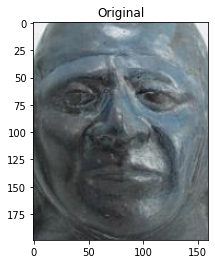

199 160
(211, 196, 371, 395)
211 isss [ 1.40803121e-02  8.56249630e-02  1.57019839e-01 -9.09650028e-02
 -2.15619486e-02  2.42016204e-02 -3.20740752e-02  8.76728818e-03
 -2.84433011e-02 -1.65441092e-02  6.15009703e-02 -7.19467476e-02
 -6.32214621e-02  1.48641214e-01  1.06139548e-01 -3.07393353e-02
  2.55623553e-02 -5.33973761e-02  8.56824294e-02 -6.61660433e-02
  2.70718448e-02  2.35494897e-01 -9.98909697e-02  5.27730510e-02
  1.71627034e-03  5.34534529e-02  1.02490127e-01  1.08830400e-01
  1.44780964e-01  3.90829518e-02 -8.56420919e-02 -2.26188570e-01
 -4.28131483e-02 -5.38691059e-02  5.30188829e-02  1.13547444e-01
 -1.35231251e-02 -8.21166486e-03 -1.03332186e-02  1.37787953e-01
 -9.27724913e-02  1.18817583e-01 -9.78485718e-02  1.03420699e-02
  3.82746868e-02  2.17166707e-01  4.75505367e-03 -5.54948673e-02
 -3.20270844e-02 -8.06906894e-02  5.04508279e-02  2.41143525e-01
 -1.07468851e-01  1.84191316e-02  6.83894008e-02  1.87520701e-02
 -1.88399386e-02  6.12098910e-02 -3.62815373e-02  7.

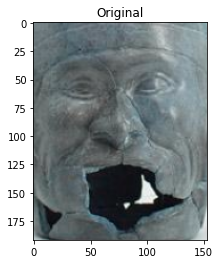

192 153
(223, 220, 376, 412)
223 isss [ 1.94079019e-02  8.98256004e-02  2.03963980e-01 -1.33281261e-01
  4.31823917e-03  5.46271577e-02  1.11108683e-02  2.86428742e-02
 -4.86487038e-02  2.41443235e-02  3.96300033e-02 -5.45083694e-02
 -2.21478380e-02  1.41881868e-01  1.52711287e-01 -2.83667501e-02
 -6.57666400e-02 -3.81695852e-02  2.91531794e-02 -1.02831207e-01
  7.54205808e-02  2.33271390e-01 -7.57998303e-02  5.01154596e-03
 -7.45005766e-03  3.42696756e-02 -7.89967272e-03  7.05633089e-02
  1.82651788e-01  5.13309278e-02 -1.13743760e-01 -1.53910562e-01
 -6.98549226e-02 -6.37502074e-02  4.78562862e-02  5.66035546e-02
 -3.71815041e-02  4.57595699e-02  5.16453013e-02  1.72037631e-01
 -8.04626718e-02  1.25415146e-01 -1.35742605e-01 -7.56269321e-02
  1.20532094e-02  1.72371820e-01 -1.93661973e-02 -8.66810381e-02
 -6.61855265e-02 -9.86863673e-02  2.42163260e-02  2.35216647e-01
 -1.16197139e-01  5.59164658e-02  1.25846937e-02  8.81185289e-03
  4.58174422e-02  6.49938211e-02 -1.28604621e-01  9.

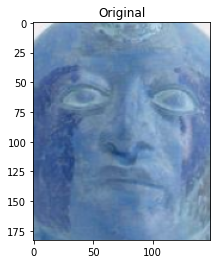

183 149
(222, 184, 371, 367)
222 isss [ 0.01345319  0.00434277  0.16762519 -0.09623919 -0.04472869  0.02990689
  0.04458281  0.10568934 -0.03373328  0.08861116 -0.00433163 -0.07780889
  0.01762452  0.14678629  0.20883346 -0.09281944 -0.00257753 -0.10399677
  0.10039715 -0.08532436  0.00492992  0.17835455 -0.06755604  0.05242052
 -0.04365609  0.03122055  0.00731882  0.0169085   0.05887829  0.0328992
 -0.09744599 -0.19086479 -0.04121621 -0.02330489  0.05144146  0.05487449
  0.03255027  0.07486933 -0.04385394  0.11364666 -0.08266426  0.09119956
 -0.1644153  -0.07272537  0.00151149  0.15982413 -0.06097504 -0.03354012
  0.04054468 -0.06873377  0.08741564  0.1644715  -0.02554077  0.035671
  0.10036082  0.02011887  0.04559758  0.00302598  0.01621057  0.02475968
  0.03793747 -0.07062841 -0.09758949  0.01568405 -0.00236062 -0.10623869
  0.14227231  0.13075842  0.14464329  0.08894948  0.11799189  0.08389264
 -0.00493323 -0.08719847  0.03910408  0.08874618 -0.13107637  0.09356871
  0.11304446  0.

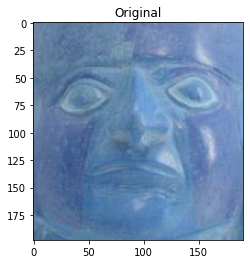

198 191
(208, 167, 399, 365)
208 isss [ 0.10052947  0.0311656   0.10413823 -0.19907485  0.04675626  0.19599888
  0.06038916  0.08136632 -0.10350766 -0.01087378 -0.04029123  0.01045289
  0.04871596  0.05614532  0.11984641 -0.09995199 -0.05946166 -0.05808559
 -0.02754791 -0.06585379  0.05980666  0.23451938 -0.07308973  0.04863339
 -0.06054268  0.0267202   0.01867693 -0.01265826  0.02877098  0.0567256
 -0.12013143 -0.1610766  -0.12950593  0.01279296  0.06216303 -0.00558376
 -0.0233007   0.00954637 -0.01082029  0.07880063 -0.01980206  0.07254062
 -0.08696486  0.02940944 -0.05924538  0.13070986 -0.00569585 -0.0174844
 -0.1346495   0.01415029  0.07436259  0.04039021 -0.04201062  0.06721579
  0.07143767 -0.00147629 -0.03656056  0.14622398 -0.06559278 -0.04403742
  0.04233383  0.02193922  0.06294556 -0.01092582  0.00555479 -0.1055673
  0.06993771  0.15588947  0.03759347  0.06600337  0.13044956  0.07294782
  0.00582448 -0.13693582 -0.00751466  0.13161506 -0.14835976 -0.03885071
  0.11518412  0.

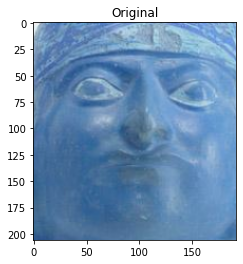

206 192
(208, 166, 400, 372)
208 isss [ 1.05423518e-02  9.64194685e-02  1.10776685e-01 -1.76847860e-01
 -2.80324277e-02  4.81515042e-02  2.46869214e-02  7.49507621e-02
 -6.68549612e-02  9.16377380e-02  1.83260012e-02 -6.08444214e-02
  3.51677649e-02  1.57097459e-01  1.27707332e-01 -7.85397887e-02
 -1.68321829e-04 -5.80263287e-02  7.69870505e-02 -5.27496450e-02
 -3.52032552e-03  2.04872727e-01 -3.80318202e-02 -5.96767990e-03
 -9.58204195e-02  4.93111238e-02  4.76177260e-02  6.68944046e-02
  1.83548987e-01  3.81038003e-02 -1.38901487e-01 -1.63838953e-01
 -1.86680835e-02 -8.33864734e-02  4.21925262e-02  1.05519397e-02
  7.63801113e-03  1.39879480e-01  1.23975258e-02  1.51654676e-01
 -1.28976762e-01  1.02488160e-01 -1.98502734e-01 -7.55356997e-02
 -4.46417630e-02  1.76975280e-01 -4.51635495e-02 -2.60598306e-02
 -6.44297227e-02 -6.55857697e-02  1.60161816e-02  2.64618665e-01
 -6.35162592e-02  5.20710237e-02 -1.35600753e-02  1.35019571e-02
  8.01563933e-02  5.07308021e-02 -1.00070588e-01  3.

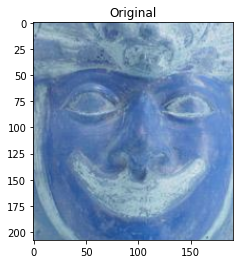

208 191
(201, 118, 392, 326)
201 isss [ 0.12533782 -0.00557753  0.18578847  0.03085867  0.09962584  0.15887605
  0.14561129  0.02221668  0.04362334 -0.11486036 -0.13384779 -0.00780785
 -0.00700404  0.05666866  0.09417767 -0.02102441  0.05296301 -0.08178043
 -0.12580658 -0.06941333  0.06495554  0.15796441 -0.02321239  0.10597427
  0.0129873  -0.10414702 -0.1489251   0.00466815  0.05769186  0.0259446
  0.01465341  0.07162027 -0.13988814  0.02817021  0.01067084 -0.05032909
  0.07895636  0.07570452 -0.04284809 -0.00769984  0.0867025   0.09510511
 -0.01272048 -0.20621783 -0.01009036  0.02083507 -0.08278227 -0.0597605
  0.0726219  -0.03962915  0.1072282   0.02097675  0.10511966  0.05117513
  0.09476965 -0.04370748  0.08578287  0.06697341  0.04962193 -0.09128651
  0.00208581  0.08230571 -0.14434835 -0.13294369  0.00480899  0.05858997
  0.10427832  0.04356821 -0.05056586  0.04065764  0.04356321  0.096766
  0.02255562 -0.03777458  0.03940403  0.1341238  -0.0243319  -0.04886984
  0.05767496  0.0

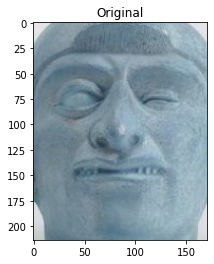

214 171
(219, 164, 390, 378)
219 isss [ 0.04595814  0.07280684  0.05503275 -0.06912939 -0.06154515  0.03131607
 -0.02083952  0.0394964  -0.00314086 -0.05335276  0.10404173 -0.04002538
 -0.05494761  0.18888839  0.05820843 -0.07687655  0.05595297 -0.0971794
  0.14791328 -0.09665744  0.03246386  0.21293905 -0.10459864  0.00323015
  0.01757362  0.03863043  0.15440631  0.12664515  0.07104243  0.09497041
 -0.09658302 -0.24576119  0.05766325 -0.03389073  0.00241533  0.08443729
  0.0369295  -0.03355915 -0.00824515  0.16073455 -0.08346332  0.12552595
 -0.03981341  0.01487273  0.01864311  0.12475318  0.0017869  -0.1385294
  0.02032862 -0.05764075  0.04077604  0.2439295  -0.07260208  0.09309664
  0.08780979  0.0706488  -0.01959668  0.03803621 -0.06939874  0.0586276
 -0.007796   -0.1092775   0.05315602 -0.01880503 -0.00824851 -0.11938213
  0.12915568  0.01995808  0.12009639  0.17911954  0.13438827  0.00493087
 -0.01141414 -0.0993083   0.08911783  0.07433391 -0.05454429  0.09908348
 -0.05432678 -0.

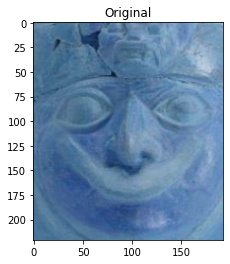

221 193
(198, 132, 391, 353)
198 isss [ 0.13605374  0.02763174  0.01679858 -0.05279361  0.04500723  0.16774228
  0.10220382  0.11778249 -0.07404569 -0.04131183 -0.03950673  0.06936181
  0.09785307 -0.13545495 -0.0593069  -0.0096654  -0.05250248  0.01220866
 -0.15071501  0.02741036  0.18409081  0.09332814 -0.00577063  0.04632426
 -0.08739305 -0.04980952 -0.08598317 -0.1613173   0.00141228  0.14338943
 -0.15007183 -0.00660963 -0.07719345  0.06046469  0.03086391 -0.15642415
 -0.02298416  0.1142084  -0.05318083 -0.01128417 -0.06483024  0.0104238
 -0.04138202  0.03630548 -0.07871358 -0.01614289  0.03275971 -0.07822932
 -0.10845596  0.09410503  0.17294808 -0.01315508 -0.01896185  0.08527406
  0.07965481 -0.06115898  0.07003932  0.01175655 -0.00845782 -0.14819278
  0.05595789 -0.05375428  0.04875184 -0.05912728  0.01864533 -0.20321131
  0.02268283  0.07500493 -0.03395979 -0.04927833  0.05917812  0.02172373
 -0.00595164 -0.12736067 -0.08008879  0.13042499 -0.07692706 -0.06320262
  0.05994188  

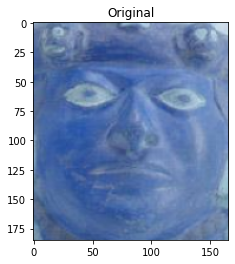

185 166
(209, 213, 375, 398)
209 isss [ 1.01096958e-01  1.22623317e-01  9.81360599e-02 -1.16655551e-01
  6.50888011e-02  1.84803560e-01  4.37571630e-02 -4.67465669e-02
 -3.94980237e-02  9.31960996e-03 -1.82773490e-02 -8.01363066e-02
  9.35133733e-03  1.00959346e-01  2.08854988e-01 -9.22040567e-02
  9.43962019e-03 -2.57090554e-02 -5.03900349e-02 -1.32139042e-01
 -3.42799984e-02  2.33827993e-01 -1.02935798e-01 -8.17460567e-02
  2.28696428e-02 -2.78688017e-02 -6.28599226e-02  5.95156401e-02
  5.29057672e-03  5.88016361e-02 -4.69820201e-02  1.87359713e-02
 -1.04702361e-01  1.68872178e-02  9.74582583e-02  4.37281281e-02
  6.49547204e-02 -6.43630102e-02  5.93071319e-02  1.55623043e-02
  4.57970016e-02 -9.41716833e-04 -4.18762416e-02 -7.11549819e-02
 -4.67513390e-02  2.28725821e-01 -4.91701625e-02  3.86632383e-02
 -1.16150558e-01 -9.33961719e-02  7.55222365e-02  1.16209276e-01
  1.01160705e-02  1.77504607e-02 -2.28375718e-02  2.57265475e-03
 -5.56274466e-02  2.91253868e-02 -6.80558905e-02  2.

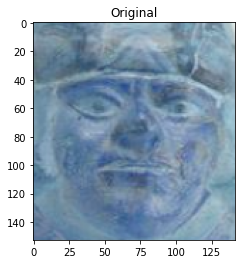

153 142
(221, 238, 363, 391)
221 isss [ 0.1199115  -0.06387968  0.04702496 -0.07802672  0.07843097  0.07231642
  0.0581081  -0.07999054 -0.05930791 -0.11935952 -0.05009023 -0.0190816
  0.00061691  0.1804352   0.14951612 -0.12837066 -0.01687521 -0.0750099
  0.11456511 -0.00177301 -0.00610066  0.16303788  0.0497743  -0.06853196
 -0.01830101  0.03579405 -0.08401845 -0.04635743  0.01498988  0.0434433
 -0.04478326 -0.08034748 -0.04074836 -0.07466144  0.1493518   0.05532957
  0.02017286  0.14150475  0.05246751 -0.03498264 -0.02766852  0.17263074
 -0.14479235 -0.07024914 -0.1621541   0.1864285  -0.04743557 -0.01134251
  0.01939474  0.00864184 -0.13816664  0.10034941  0.13512805  0.09017127
  0.05311536 -0.08487216  0.09555089  0.10807406 -0.1279987  -0.01144231
  0.00373021  0.08589806  0.09703041 -0.02507575  0.01888838  0.02341207
  0.10889787  0.1402421   0.0769371   0.02442148  0.14160591  0.06879368
 -0.00048688 -0.0279044   0.00476453  0.0713308  -0.15543823 -0.1962465
  0.10222215  0.0

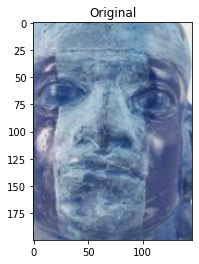

200 146
(228, 201, 374, 401)
228 isss [ 0.08867639  0.15529461  0.16525099 -0.00796723  0.06346143  0.10013228
  0.0415345  -0.1032949   0.02455927 -0.01551953  0.04804117 -0.02957
 -0.03621086  0.15507159  0.1252859  -0.03417233  0.06548794  0.03527091
 -0.08196768 -0.1034819   0.0436042   0.21241026 -0.05488393  0.00976485
  0.06005348 -0.05669956 -0.01148731  0.12203579  0.11117122  0.11205604
 -0.0740735   0.05737505 -0.05798551  0.02570593  0.06119767  0.05748023
  0.0367809   0.00884448 -0.00871791  0.01538065 -0.03007929  0.04395108
 -0.03964053 -0.08294067 -0.03978756  0.20870982 -0.03107589 -0.01206181
 -0.08173917 -0.08265541  0.1407018   0.252063   -0.0819507   0.00182116
  0.05090627  0.00219347 -0.04647423  0.04062945 -0.06305712  0.05552859
  0.01874571 -0.05652787 -0.01579129 -0.05638988  0.06846232 -0.05089724
  0.04259179  0.11434381 -0.05007794  0.32812008  0.11110751  0.05810588
 -0.00142784 -0.10498239 -0.00090021  0.07001409 -0.01896264  0.04489814
 -0.04547974 -0.

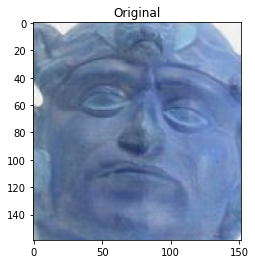

159 152
(213, 215, 365, 374)
213 isss [ 0.03673062  0.12061702 -0.01683204 -0.15265363  0.00086064 -0.0082523
 -0.03494897  0.00534239  0.02978943 -0.0269028   0.07894045 -0.10149587
 -0.00533615  0.24833906  0.14905754 -0.02806634  0.15491481 -0.10078781
  0.11553825 -0.08735751 -0.01806445  0.24234831 -0.07054335 -0.05323928
  0.00857143  0.02203848  0.14308493  0.17534156  0.19583091  0.09324377
  0.00127209 -0.08704     0.08591255 -0.06911334  0.0252331   0.10415407
  0.09749766  0.01693562  0.07179958  0.11904091 -0.09522828  0.13002583
 -0.02564502  0.01072656  0.02602404  0.17243883 -0.02331099 -0.01965654
 -0.00348579 -0.12382403 -0.07637687  0.25173244 -0.02758197  0.00788056
 -0.04592492  0.06125667 -0.07381266  0.09551057 -0.11784065  0.08356644
 -0.09164839 -0.0743131   0.06950711 -0.02490851 -0.04909247 -0.00591354
  0.09495761  0.05503996  0.05753309  0.07911978  0.10117526 -0.05255408
 -0.06178811 -0.10056796  0.0790643   0.0207547  -0.01498679  0.02232662
 -0.04660421 -

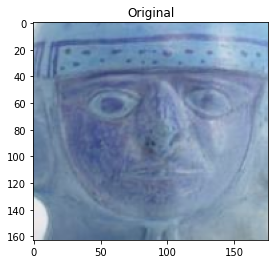

163 176
(204, 226, 380, 389)
204 isss [ 0.05599066  0.02071448  0.08998217 -0.06829276  0.03672506  0.21670178
  0.00759342 -0.00504511 -0.03009822 -0.0939379   0.05311362  0.06089039
 -0.02196345  0.05071779  0.05889012 -0.13091032 -0.02050544 -0.05716514
  0.0458395  -0.05270394  0.04930473  0.15981704 -0.08565091  0.0211381
 -0.00972905  0.07431576  0.02267978 -0.01994115  0.04977217 -0.02135469
  0.00317212 -0.16127785 -0.10058706 -0.03334947  0.06137247  0.08060534
  0.00796314  0.02181603  0.04872514  0.09761076  0.07746273  0.09804543
 -0.16869049 -0.03385294 -0.11020494  0.05072924 -0.02608933 -0.10988323
 -0.05362356 -0.10102635 -0.02063625  0.1390457  -0.04250278  0.08439311
  0.01411817  0.028881   -0.0065244   0.14885241 -0.17554347  0.04428608
 -0.02514728 -0.00036487  0.15245825 -0.11212841  0.10715836 -0.10477058
  0.16003352  0.09392972  0.04823051  0.16916545  0.15213206  0.07732061
  0.00476921 -0.0687593   0.06683383  0.09954447 -0.13378307  0.04328031
  0.00443584  

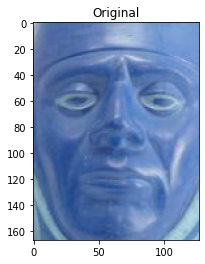

167 127
(234, 178, 361, 345)
234 isss [ 8.6887084e-02  3.1799410e-02  1.3618033e-01 -1.3695495e-01
 -2.3393480e-02  6.1509833e-02 -4.0066533e-02  6.5568544e-02
 -4.4118952e-02 -1.2264797e-01  1.8248152e-02 -9.5036104e-02
 -1.8238569e-02  1.3173622e-01  1.4898832e-01 -8.9259334e-02
  4.8305713e-02 -1.4601637e-01  6.3369609e-02 -5.5882130e-02
  5.3657670e-02  2.0184422e-01 -8.1123285e-02 -2.6890341e-02
 -1.8689269e-03  6.7137614e-02  3.1128066e-02  1.4979656e-02
  6.0696110e-02 -2.9957427e-02 -1.5893407e-02 -1.8397893e-01
 -4.7380049e-02 -9.9761514e-03  5.2388132e-02  7.6334350e-02
  6.3078307e-02  8.6504854e-02  8.0010459e-02  1.0269566e-01
 -2.8561691e-02  1.0106413e-01 -1.3787198e-01 -6.3300848e-02
  4.2385593e-02  2.1855047e-01 -3.1763963e-02 -9.0429313e-02
 -6.9831572e-02 -9.9612013e-02 -6.0728982e-02  1.7982708e-01
  2.1659338e-03  8.8313095e-02  2.4655936e-04 -2.4320109e-02
  2.2275180e-02  5.5525549e-02 -1.0410616e-01  2.9656705e-03
  5.6456048e-02 -4.1134902e-03 -1.5285344e-02  

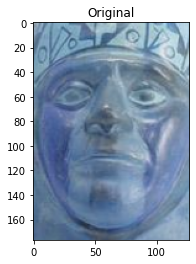

177 127
(227, 192, 354, 369)
227 isss [ 6.28312752e-02 -2.12037954e-02  3.12681235e-02 -1.10542417e-01
  9.55990627e-02  6.26380220e-02  3.41758206e-02 -6.70316517e-02
 -9.46721211e-02 -7.07724243e-02 -4.80789505e-02  4.46650013e-03
 -3.94301955e-03  1.27594277e-01  1.22015767e-01 -6.66620880e-02
 -1.15350951e-02 -3.39557864e-02  1.85331509e-01 -2.85940170e-02
  5.79743795e-02  1.82544068e-01 -1.50801558e-02 -3.63877788e-02
  1.24186787e-04  1.12805694e-01 -4.16061617e-02 -9.33676213e-02
  7.86684230e-02  1.09864593e-01 -7.44169578e-02 -1.37326166e-01
 -5.82813192e-03 -9.82067212e-02  1.83587655e-01  1.41046960e-02
  5.81749119e-02  6.84793219e-02  1.08955815e-01 -3.29595581e-02
 -2.55020503e-02  1.62821725e-01 -1.72730368e-02  5.33195259e-03
 -1.26029804e-01  1.70560211e-01  6.99663013e-02 -6.48691729e-02
 -4.20259126e-02 -7.46707618e-02 -7.48743713e-02  2.72202343e-02
  1.09547876e-01  7.84032196e-02  1.22841224e-01  1.71429210e-03
  8.87935907e-02  1.46770358e-01 -1.32620439e-01 -1.

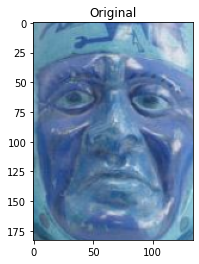

183 134
(223, 193, 357, 376)
223 isss [ 0.15705343  0.02575589  0.08676009 -0.10359187  0.04190744  0.17136909
  0.03758866  0.00177539 -0.08204111 -0.13694744 -0.02063124  0.06673193
 -0.0374499   0.00712406  0.02814024 -0.08177023 -0.04455921 -0.07514241
  0.02076942 -0.02364024  0.07454468  0.23535635 -0.08997047  0.04590539
 -0.01655887  0.06551289  0.03943181 -0.04240717  0.04903935  0.09452122
 -0.13515706 -0.09826848 -0.11176866  0.0084034   0.07100106 -0.03329874
  0.00999934  0.01376851  0.07611753  0.04080958 -0.01264228  0.03567373
 -0.07500492 -0.01933414 -0.03159003  0.17065191  0.02960543 -0.10410015
 -0.1431021   0.01876174  0.07431769  0.139073    0.01962239  0.09561785
  0.09734242 -0.0435616   0.01897056  0.11556608 -0.1476442  -0.02123157
  0.07493562  0.00613855  0.11992745 -0.03653017  0.00869112 -0.13526225
  0.0875214   0.08107756  0.03546974  0.09260721  0.09195229  0.01913493
 -0.04341177 -0.08873612  0.0213837   0.08956734 -0.08993169 -0.04021758
  0.05639016 

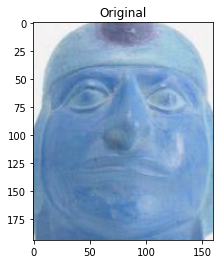

194 160
(218, 200, 378, 394)
218 isss [ 0.01478813 -0.01874576 -0.04475279 -0.06639196 -0.07383078  0.10292003
  0.05068481  0.01833146 -0.10698661  0.087088    0.01764782 -0.04310777
  0.07656198  0.20828108  0.17367595 -0.11027861  0.00876049 -0.07084145
  0.21319962 -0.06944729 -0.06809967  0.05929223 -0.06100664 -0.10539991
 -0.05566249  0.11786497 -0.09672924 -0.05243666  0.068391    0.04254686
 -0.02504865  0.009058   -0.0232711  -0.13004827  0.04744663  0.08014461
 -0.00336827  0.11661006  0.07392814  0.04510215 -0.04709015  0.10917364
 -0.17458902 -0.07417436 -0.08518618  0.02097139 -0.02768384 -0.06771621
 -0.01256395 -0.18699846 -0.0967707   0.0735634   0.10481793  0.04907009
 -0.03758475  0.06898651  0.01965433  0.1356516  -0.03884862  0.00294445
 -0.0794201   0.04210765  0.10454057 -0.08149631  0.04252363  0.1921316
  0.18176366  0.06288203  0.05528884 -0.09682848  0.09274741  0.03659178
  0.02680976  0.00692151  0.04207035  0.01961231 -0.12520304 -0.21648169
  0.07165882  

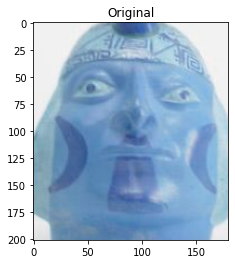

201 180
(202, 188, 382, 389)
202 isss [ 0.0051982  -0.06217804  0.00551687 -0.1006912  -0.02915569  0.03443679
 -0.02190407  0.01946262 -0.07072706  0.06041321  0.03748595 -0.03548934
  0.02999946  0.15743953  0.27068403 -0.08857293  0.04979269 -0.13848223
  0.26634958 -0.07424448 -0.08545312  0.10984823  0.04872951 -0.08495046
  0.06096533  0.15003099  0.08407287 -0.06224369  0.05710539 -0.01441972
  0.05101376 -0.08706541  0.1362023  -0.05962072  0.0629466   0.01730001
  0.07852498  0.11689877  0.14003307 -0.0048474  -0.01093399  0.02533687
 -0.11095697 -0.03674511 -0.1290414   0.02907882 -0.07099982 -0.06950163
  0.03055688 -0.15732612 -0.09150854  0.04273125  0.16963764  0.00892063
 -0.05047221  0.06633142  0.02725646  0.08145943 -0.1150154   0.03395166
 -0.11362077 -0.10007926  0.05146326 -0.0493314   0.08245771  0.18028672
  0.06675691  0.09919596  0.06057012 -0.11030502 -0.01129317 -0.00964874
 -0.11316468 -0.10869523  0.10403477  0.00619446 -0.08344429 -0.1725626
  0.06911162  

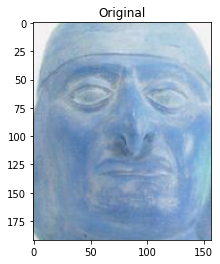

192 157
(227, 200, 384, 392)
227 isss [ 0.03288099  0.04850449  0.08617501 -0.14694656  0.0124569   0.07991105
  0.05619023  0.01208086 -0.11683562  0.03189875  0.03553651 -0.02823992
  0.05251265  0.12347078  0.18247445 -0.10566628 -0.01688144 -0.04521186
  0.10241895 -0.03430726  0.01521248  0.16999471 -0.06233938 -0.07155834
 -0.03620521  0.11047137 -0.05916019 -0.05760275  0.11317216  0.03636094
 -0.08046854 -0.09372447 -0.05117998 -0.07781028  0.10463578  0.039646
  0.0247666   0.11813825  0.08895572  0.08461588 -0.00550758  0.09147799
 -0.17000964 -0.00539039 -0.13446416  0.197479   -0.00085721 -0.07910464
 -0.0909091  -0.1546851  -0.04812595  0.14341378 -0.03326395  0.06556839
 -0.01797012  0.00307884  0.03320213  0.09109276 -0.14066747  0.05235249
  0.00190769 -0.04782103  0.06198401  0.00518541  0.07040012 -0.06354196
  0.13532291  0.12562764  0.12396074  0.00154546  0.16348976  0.06511603
  0.01032211 -0.09608971  0.06135594  0.08447451 -0.20932597 -0.0236597
  0.08202725  0.

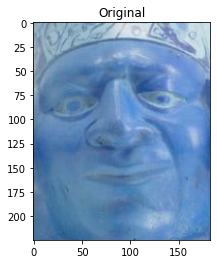

225 183
(204, 135, 387, 360)
204 isss [ 0.06825501  0.18388356 -0.00219076 -0.10866646  0.04768907  0.06854886
  0.06649344 -0.01455373 -0.05927022  0.06523627  0.06132583 -0.08360808
 -0.01805877  0.08903147  0.09021953  0.02199735  0.11674409 -0.0057378
  0.08967924 -0.08111779  0.04060407  0.17244004 -0.07913116  0.02220508
 -0.00844272  0.03223898  0.06316322  0.00628717  0.23807587  0.11202212
 -0.07258815 -0.0564336  -0.05576375 -0.06303336  0.06921865  0.04519965
  0.06234601  0.03359372  0.04687754  0.10204788 -0.09814031  0.07722791
 -0.06757416  0.03761174  0.00393345  0.28399262  0.07216451 -0.03101612
 -0.14271984 -0.13782659  0.02924672  0.23731652 -0.11055145 -0.02397376
 -0.0020621   0.04713805  0.00579386  0.11502672 -0.06454124  0.08627915
  0.02143399 -0.08181246  0.11376692 -0.08833388  0.08803955 -0.16847171
  0.05691473  0.04063673  0.06401777  0.19057955  0.0817732   0.06262974
 -0.06715585 -0.07769965  0.00817856  0.01643966 -0.02977768  0.2326453
 -0.01311974 -0

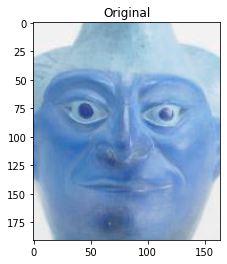

191 164
(223, 171, 387, 362)
223 isss [ 7.70661328e-03  5.46414442e-02 -3.04607246e-02 -1.11810654e-01
 -1.49098396e-01  8.70830566e-02  1.78981740e-02  8.62429067e-02
 -5.86899556e-03  1.20019250e-01  1.08198904e-01 -6.51030988e-02
  4.48950380e-02  1.07534699e-01  1.24711663e-01 -1.31534606e-01
  8.10164213e-03 -4.70174365e-02  1.53466791e-01 -9.79379341e-02
 -6.52872622e-02  9.15650874e-02  2.47829612e-02  6.64044917e-02
 -6.93378225e-02  6.23204820e-02  1.98305607e-01 -6.54870942e-02
  9.84348953e-02  7.29171792e-03 -4.13214006e-02 -1.81351840e-01
  5.88437431e-02 -8.17937851e-02  8.58899963e-04  6.06311671e-03
 -4.77596465e-03  1.75508946e-01 -5.65029308e-02  1.49248108e-01
 -1.10608250e-01  1.26959234e-02 -2.77095169e-01  8.00445080e-02
 -1.18158430e-01  4.48351204e-02 -3.84114832e-02 -5.60398251e-02
 -4.76099737e-02 -9.01593789e-02  4.03937399e-02  1.90089419e-01
  1.38486018e-02  4.20069974e-03 -3.56040746e-02  1.01105176e-01
  4.74336743e-02  1.22133449e-01 -1.01014168e-03 -2.

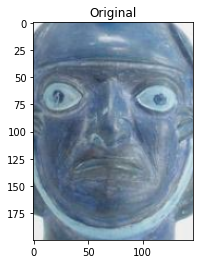

200 147
(231, 154, 378, 354)
231 isss [ 0.01954324  0.00360097  0.12704097 -0.09831887  0.05019879  0.07365935
  0.0815734  -0.06243339 -0.04025096  0.02347567  0.00186254  0.04227673
  0.02528022  0.10037739  0.15917781 -0.12508854 -0.0367774  -0.05673048
  0.06349428 -0.05876734 -0.00386695  0.14329952 -0.11289642  0.00847
 -0.01243187  0.08646825 -0.07316554 -0.02299217  0.02923411  0.06159077
 -0.05673652 -0.11524297 -0.06272314 -0.06940065  0.12484555  0.03384855
  0.02505597  0.03904621  0.08570752  0.02523978  0.04515756  0.08284427
 -0.10079681 -0.06551652 -0.08014069  0.15558669 -0.05171268 -0.05236266
 -0.0420216  -0.16750538 -0.0205574   0.05111913  0.04327284  0.02366507
  0.05981686  0.04250795 -0.05203917  0.12146762 -0.17499614  0.08074927
  0.01689426 -0.0099276   0.02496162 -0.00533112  0.10234679  0.00871543
  0.08983478  0.13642257  0.04078641 -0.03183591  0.16419846  0.06187028
 -0.00056502 -0.14017068  0.05588747  0.17782077 -0.16026609 -0.06965682
  0.10984465  0.

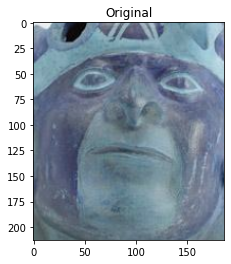

213 187
(203, 158, 390, 371)
203 isss [-3.01365070e-02  6.94386289e-02  9.67774317e-02 -1.30217984e-01
 -5.85542177e-04  2.46411767e-02 -9.53829437e-02 -3.89740504e-02
  5.40778041e-02 -4.36276458e-02  2.85469778e-02 -4.37999554e-02
 -3.32226269e-02  1.83663160e-01  5.64017221e-02 -7.59900957e-02
  4.85518090e-02 -7.96008855e-02  7.10974485e-02 -3.59317251e-02
  1.52573800e-02  1.90979227e-01 -8.94130543e-02  3.37549709e-02
  4.49943182e-05  7.65967891e-02  1.14158966e-01  1.15631707e-01
  5.12948968e-02  3.05572134e-02 -1.72538701e-02 -2.60672569e-01
  2.96375901e-02 -5.90458810e-02  7.46428818e-02  1.45778477e-01
  5.87500073e-02  3.12743597e-02 -3.40778125e-03  7.59896711e-02
 -6.72823265e-02  1.45637035e-01 -5.53395338e-02 -1.05708838e-02
  4.66132537e-02  1.79819375e-01 -1.54812112e-02 -1.65955070e-02
  1.67957395e-02 -7.86132514e-02 -2.78918352e-02  1.66772708e-01
 -2.97732279e-02  3.54532413e-02  9.01378989e-02  4.49440889e-02
 -5.32016382e-02  5.01066968e-02 -7.13146999e-02 -1.

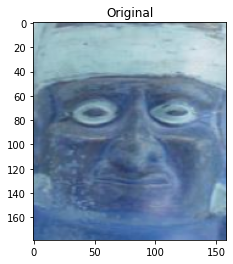

179 159
(216, 205, 375, 384)
216 isss [-0.03006841  0.19368489  0.02305072 -0.07518341 -0.00489167  0.16277337
  0.01726933 -0.03537928 -0.02213848  0.04386776  0.0329353   0.0088793
 -0.03290321 -0.01186247  0.09517761 -0.2301088   0.03104746  0.09291959
  0.13716172 -0.11104278 -0.03293563  0.11679051 -0.08496502  0.02924195
  0.03174664  0.00784811  0.05469265 -0.02872446  0.12103909  0.06766442
  0.04867567 -0.07317092  0.02203587 -0.03263316  0.12414157 -0.01909881
  0.09468577 -0.02143804  0.04111689  0.02678675  0.11677006 -0.00991084
 -0.06096784  0.09377346 -0.18839401  0.04561133  0.07251722 -0.06357425
 -0.11525858 -0.12963413  0.0057375   0.1571339   0.02278893 -0.00775289
 -0.04303967  0.12357763 -0.0140176   0.06220829 -0.11515049 -0.04344822
 -0.08610136 -0.06052674  0.12005449 -0.11935484  0.10666319 -0.05885013
  0.16145003 -0.10141527 -0.04024234  0.15458319  0.0494384  -0.03051476
 -0.04199232 -0.05337803  0.04919814  0.00387903 -0.15197347  0.05957232
  0.00154827 -

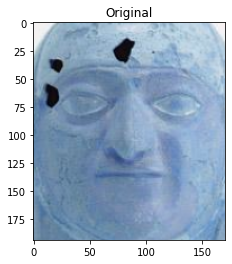

194 171
(215, 175, 386, 369)
215 isss [ 1.31094903e-01  9.24849659e-02  2.07220521e-02 -9.13022906e-02
  8.79446696e-03  7.03592822e-02 -2.18552165e-02  5.68364188e-02
 -1.10369928e-01  3.06387972e-02  4.85944003e-02 -3.71908993e-02
  2.51479428e-02  1.83007121e-01  6.64442405e-02 -2.08072131e-03
  1.86458081e-01  1.46868043e-02  2.42402796e-02  9.58472677e-03
 -4.01012745e-04  2.31592029e-01  1.33152260e-02  6.56826347e-02
 -4.75057997e-02  8.28055199e-03  1.34591371e-01  1.23549953e-01
  5.72827570e-02  5.65468706e-02 -1.60180479e-01 -9.39103886e-02
 -9.44327377e-03  4.98720445e-02 -5.72965248e-03 -5.84620703e-03
  7.26682916e-02  1.16742171e-01 -2.58583017e-02  9.69272852e-02
 -1.55248225e-01  1.46023378e-01 -8.85602087e-03 -7.98813347e-03
 -5.78584298e-02  1.07914679e-01  2.01784186e-02 -2.58451980e-02
 -3.48684974e-02  1.03350773e-01  2.21281037e-01  1.62375495e-01
 -1.39345929e-01  1.01043567e-01  8.44461247e-02 -4.72372621e-02
  5.28793372e-02  2.91625205e-02  8.74643847e-02 -6.

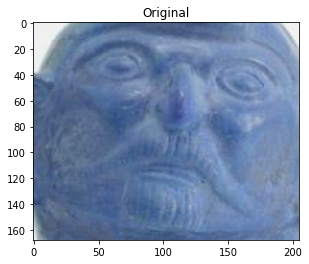

168 205
(186, 193, 391, 361)
186 isss [ 0.02269436  0.08040306  0.13274854 -0.05843663 -0.04263871 -0.00547257
  0.04531413 -0.09193046  0.05245141  0.01939274  0.1240994  -0.01909816
  0.00992467  0.21241277  0.09514175 -0.05217644  0.0115909  -0.00154088
  0.00265156 -0.09635304  0.02138841  0.23592849 -0.16161668  0.04589655
 -0.05020723  0.01990608  0.02230832  0.14384131  0.09575234  0.17273596
 -0.16064557 -0.05942913  0.03878496 -0.00610619  0.05382645  0.08695959
  0.08685682 -0.03150403  0.0192557   0.10729221 -0.04933986  0.06037182
 -0.02079261 -0.08393337  0.03199     0.1544509  -0.03915148 -0.02866971
  0.01817126 -0.13844378  0.06814547  0.20142995 -0.05769148  0.09219565
  0.0943497   0.08027484 -0.03798771 -0.01350613 -0.11580361  0.13590725
  0.01716366 -0.07841683 -0.03191999  0.05223642 -0.01707829 -0.03882552
  0.08475816  0.05305939  0.07175172  0.11566019  0.12115534 -0.07237146
  0.00115699 -0.11246414  0.10002524  0.11232327 -0.05806009  0.05530659
 -0.02804395 

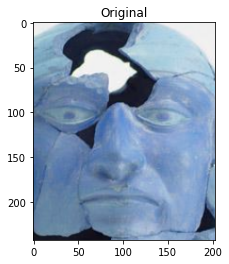

243 203
(203, 80, 406, 323)
203 isss [-0.03032433  0.11302262  0.00944771 -0.09498628 -0.07407344  0.07655949
  0.00303657 -0.01781592 -0.08254801  0.03160688 -0.00255737 -0.08447629
  0.07434367  0.19133887  0.07786269 -0.07199832  0.00791034  0.03860524
  0.12191514 -0.03473096  0.00569794  0.08997643  0.03747722  0.00855037
 -0.08760539  0.07350005 -0.08190683 -0.01643584  0.20567934  0.0368642
  0.00595492  0.02356295 -0.02107667 -0.11619359  0.08583728  0.04448598
  0.02445293  0.23973265  0.01697927  0.08840508 -0.10390415  0.15117115
 -0.14246148  0.00244747 -0.11425707 -0.0016535   0.08347662 -0.02413755
 -0.02941697 -0.05994916 -0.06711128  0.13321976  0.025067    0.05263313
 -0.02243184  0.03016015  0.11844435  0.14913966  0.01189048 -0.11915673
 -0.09534398  0.05151588  0.14529362 -0.07730301 -0.00574845  0.06676251
  0.19497286 -0.04414895  0.00648918  0.06095729  0.058799    0.03197425
  0.03633301  0.15138416  0.0572339  -0.1028844  -0.14637518 -0.09401428
  0.08073211 -0

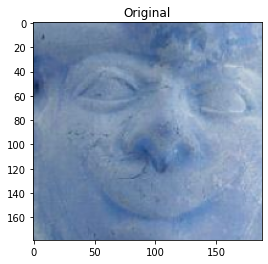

179 188
(209, 114, 397, 293)
209 isss [ 0.09625145  0.04446878 -0.01591933 -0.19507241  0.02029144  0.17525391
  0.0383554   0.0195147  -0.16676831  0.06473132 -0.00122995  0.03264459
  0.15663938  0.04134347  0.08912092 -0.06894793 -0.09007381 -0.01339904
 -0.01609746  0.04733236  0.04291028  0.12516207  0.00617858 -0.04347798
 -0.10111041  0.13304701 -0.03557637 -0.10705499  0.06490072  0.0655729
 -0.14163691  0.01830324 -0.11310478  0.00062794  0.04750299 -0.0265393
 -0.0324697   0.18973829  0.0987986   0.05474553 -0.02935494 -0.00973833
 -0.12681572  0.01748851 -0.16487649  0.0511458   0.03708866  0.01118005
 -0.14920546  0.00485043  0.04691921  0.06735644 -0.04326282  0.1166428
  0.02325327 -0.04703164  0.03760784  0.12075622 -0.09259647 -0.10072563
 -0.03031371 -0.02705011  0.16626655 -0.0200978   0.01345962 -0.02872382
  0.0898351   0.1663147   0.01620935 -0.04731204  0.08553565  0.06335038
 -0.00560551 -0.03707404  0.02193726  0.04497217 -0.17582783 -0.15289241
  0.12209409  0.

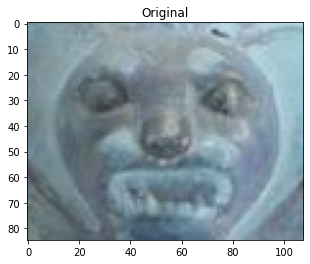

85 108
(251, 83, 359, 168)
251 isss [ 0.02831482 -0.07006104  0.17447704 -0.16568199 -0.00736653  0.05554726
 -0.00800869  0.12788658 -0.05284826 -0.05685977 -0.03327936  0.00458587
  0.04477453  0.11874778  0.150863   -0.11626605 -0.07479414 -0.11567815
  0.00883789  0.00318081  0.10533477  0.10961206  0.00861086  0.03558704
 -0.0486988   0.1047976  -0.03280564 -0.09023607  0.01641476 -0.04603391
 -0.00463942 -0.13451073 -0.05807193  0.05205013  0.00127547  0.04666147
 -0.06193165  0.23909675 -0.01832135  0.10877073 -0.03988615  0.11206377
 -0.21175905 -0.02715818 -0.0109295   0.06117291 -0.02215729 -0.07611602
 -0.06024384  0.00547701 -0.06612296  0.06710507 -0.03453287  0.07316171
  0.08219854 -0.00565398  0.02724471  0.16011846 -0.0960005  -0.071796
  0.03686684 -0.015953    0.06000571  0.03401745  0.01401794 -0.0893918
  0.11832487  0.18668377  0.11858121  0.10312878  0.12002725  0.08025855
 -0.03094826 -0.00294202  0.01847446  0.01136689 -0.15884805 -0.04678789
  0.12257502  0.11

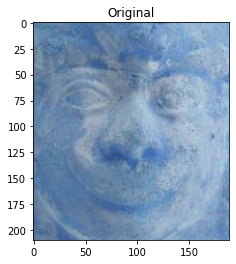

210 189
(199, 143, 388, 353)
199 isss [ 0.10081945  0.01461809  0.01244567 -0.11724708  0.01236643  0.17489286
  0.09779675  0.12296797 -0.02323421  0.01430059 -0.0132528   0.05926177
  0.1439821  -0.11032295 -0.00257502 -0.06987345 -0.10188096  0.00335074
 -0.19223282  0.06086054  0.0851052   0.12134039  0.00712215  0.07353111
 -0.17504485 -0.02144188 -0.05991775 -0.14809315 -0.02880557  0.07327592
 -0.12046786 -0.04840942 -0.09512819  0.05068842  0.01775644 -0.08171776
 -0.02971002  0.16542916 -0.1099059   0.06129125 -0.03373156  0.01380874
 -0.14064926  0.07429454 -0.12714049 -0.06508904  0.00293587  0.01178937
 -0.07199842  0.14089458  0.12074996 -0.06844872 -0.06773261  0.08839489
  0.06385679 -0.04219913 -0.01330966  0.0554579   0.00997455 -0.14558052
 -0.01598221 -0.0494328   0.08210313 -0.04151462 -0.00674368 -0.20352685
  0.09499138  0.09310939 -0.02391201 -0.06353377  0.07911375  0.03041024
  0.06182465 -0.05786792 -0.07240175  0.08311915 -0.14061004 -0.07105376
  0.09266669 

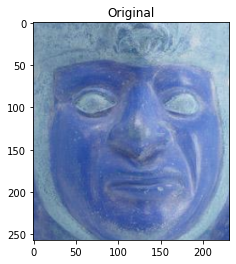

257 232
(192, 93, 424, 350)
192 isss [ 0.07801136 -0.0092034   0.03723412 -0.15734637  0.01688995  0.08462539
  0.07165633  0.00841918 -0.04083093 -0.00738413  0.03530883  0.06524562
  0.01660881  0.05484439  0.10450763 -0.12825084 -0.07752427 -0.09748575
  0.1014208  -0.06310765  0.0271641   0.22583733 -0.09164644  0.02912044
 -0.04267465  0.11579154  0.07960345 -0.03127613  0.06875461  0.11356384
 -0.12393793 -0.18627371 -0.02911848 -0.03234796  0.09916446 -0.03845427
  0.02625625  0.0658453   0.09738933  0.08871892 -0.0163718   0.0759384
 -0.12358639  0.01967661 -0.10491902  0.08545439 -0.02485734 -0.07299328
 -0.02111877 -0.04834948  0.00206553  0.11641427  0.01626755  0.08500744
  0.07753566  0.02697725 -0.00680718  0.15262309 -0.21212491  0.04485844
 -0.00470123 -0.09382331  0.15799269  0.01597937  0.02524372 -0.07114536
  0.09464718  0.09401459  0.08398482 -0.01176166  0.10340776  0.03263427
 -0.03896046 -0.07875769  0.05726617  0.09932965 -0.14291929 -0.08517294
  0.08666348  0

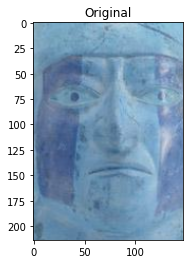

214 147
(220, 170, 367, 384)
220 isss [ 6.16817586e-02  5.68755865e-02  1.59470573e-01 -1.24414511e-01
 -1.52271139e-02  8.80940109e-02  1.79322567e-02  7.37750977e-02
 -6.50533438e-02  6.21660613e-03  2.58713402e-02 -3.89496423e-02
  1.35976914e-02  1.80807963e-01  1.37404695e-01 -8.23102817e-02
 -1.24025065e-03 -9.32844356e-02  4.54640612e-02 -8.44425857e-02
  4.59617227e-02  2.32721016e-01 -5.43464310e-02 -2.67682970e-02
 -5.25919162e-02  1.89654287e-02  3.53216492e-02  1.04402654e-01
  9.37449932e-02  4.57214117e-02 -1.39508858e-01 -1.61167085e-01
 -4.96107228e-02 -1.87178142e-02  1.50115145e-02  3.50463130e-02
  2.44801883e-02  6.48020580e-02  1.03268996e-02  1.44218907e-01
 -7.65998140e-02  1.07420705e-01 -1.35809034e-01 -1.16473258e-01
 -2.64199357e-02  1.48967460e-01 -6.88324645e-02 -7.80615211e-02
 -1.27071766e-02 -4.47243676e-02  7.33840466e-02  2.40098700e-01
 -8.30656141e-02  1.21904850e-01  3.11692264e-02  9.36489960e-04
  6.68258443e-02  1.28512429e-02 -9.37444419e-02  5.

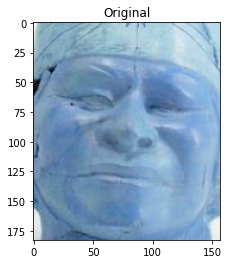

183 157
(220, 220, 377, 403)
220 isss [ 0.0721441   0.05437261  0.0382459  -0.17885964 -0.00389763  0.11461249
 -0.01073275  0.04044601 -0.17045842  0.06172769 -0.01591778 -0.0455665
  0.02925998  0.19110553  0.12919724 -0.07235733  0.04826516 -0.03451877
  0.13656047 -0.06555606 -0.03869683  0.24117349 -0.08192399 -0.01280658
 -0.06515037  0.08150554  0.08429445  0.07710954  0.08254939  0.0610119
 -0.19686592 -0.13757779 -0.05948042 -0.05468863  0.02311513  0.04753876
  0.01210316 -0.02586874  0.03704419  0.11837759 -0.07798226  0.07723347
 -0.07974045 -0.04919465 -0.02899381  0.22765325  0.01627995 -0.03347569
 -0.11543198 -0.07030433  0.08176059  0.16391651 -0.0217269   0.07674392
  0.0278103   0.02341195  0.05448064  0.07877647 -0.02372002  0.0342204
  0.05995344  0.05401392  0.02909912  0.01484612 -0.0374916  -0.03399857
  0.09493751  0.13853     0.10699248  0.07935853  0.11736831  0.02744929
  0.00146254 -0.09792615  0.06213509  0.11663425 -0.11063788  0.00394315
  0.07381841 -0.

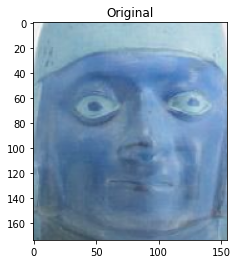

174 155
(214, 225, 369, 399)
214 isss [ 0.04263025  0.04208307  0.21131533 -0.06217762  0.01706699  0.04004658
  0.06275648  0.02625117 -0.14351326  0.05255144  0.01593264  0.02443766
 -0.02198396  0.06838761  0.16416153 -0.05408916 -0.02484065  0.03449234
  0.10203695 -0.07862749  0.08600989  0.18854313 -0.03584595 -0.02082185
 -0.00315176  0.09065556 -0.04936203 -0.0615619   0.11794928  0.09090724
 -0.14989449 -0.09396899 -0.03408211 -0.0467854   0.12407555 -0.03229759
 -0.00351917  0.08908594  0.06547721  0.0676223  -0.0669735   0.09537502
 -0.11288562 -0.03716091 -0.10721904  0.1774528   0.02876599 -0.14912824
 -0.1191908  -0.09113137  0.09513827  0.1740138  -0.08207527  0.06923537
  0.0446854  -0.00495371  0.11657615  0.02239181 -0.12185421  0.08115757
  0.08843821 -0.10195136  0.00382998  0.01791108  0.13292925 -0.15514414
  0.05552216  0.06832536  0.07212021  0.14458653  0.13688612  0.09920324
 -0.00404293 -0.07425004 -0.00945234  0.07368296 -0.1660945   0.03378999
  0.07577429 

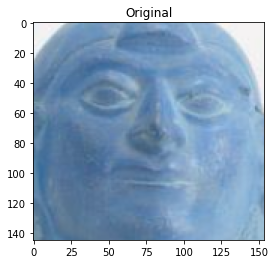

145 154
(220, 209, 374, 354)
220 isss [ 0.01538691 -0.00554756  0.01953732 -0.11613934 -0.06981785  0.05892131
  0.02745963  0.05562806 -0.06669889  0.10631505  0.02243051 -0.07783857
  0.06372141  0.20227374  0.21005364 -0.11043748  0.01045057 -0.05349164
  0.19140652 -0.07742278 -0.04432245  0.13991694  0.02887572 -0.10708958
 -0.09189036  0.08909545 -0.02655138 -0.06622181  0.09457291  0.03913275
 -0.05396988 -0.04616401  0.01693929 -0.1118992   0.07207339  0.04881535
  0.03132822  0.1772131   0.06080304  0.11586044 -0.12698334  0.11321945
 -0.26692355 -0.0769374  -0.10536768  0.09139705 -0.05840647 -0.05011664
  0.01441884 -0.1256488  -0.04676459  0.18511707  0.06582699  0.06202282
 -0.07808259  0.02026547  0.13555278  0.03314475 -0.06524267  0.03117388
 -0.03727949 -0.03461053  0.0471707  -0.04316184  0.015796    0.00889021
  0.18598305  0.12635416  0.11387922  0.00943549  0.09395955  0.04139096
 -0.0147805  -0.0278636   0.01275633  0.00874095 -0.18075332 -0.13266687
  0.07678713 

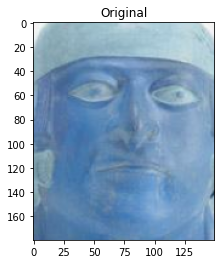

180 150
(225, 197, 375, 377)
225 isss [-0.04651583  0.17005232  0.10123702 -0.12485446 -0.00745604  0.09532199
  0.04634131  0.02201926 -0.09240025  0.0450213   0.0122104  -0.03648272
  0.03371847  0.18328199  0.16080825 -0.13176087  0.05521082  0.04423054
  0.06076945 -0.06113682  0.00257278  0.13666284 -0.01501345 -0.03905335
 -0.03286099 -0.00634236 -0.02258974  0.03437635  0.16725773  0.07596515
 -0.02816214 -0.03292884  0.03875331 -0.03596364  0.07460222  0.06102477
  0.01553062  0.13807373 -0.06786741  0.06593788 -0.05500356  0.07935271
 -0.09380673  0.03671952 -0.1375665   0.15954159  0.0641796  -0.06513572
 -0.18130633 -0.11463001 -0.02284452  0.15709665 -0.07668106 -0.01145387
 -0.02246478  0.11933456 -0.07324331  0.14788687 -0.08826862  0.02306796
 -0.0883382  -0.03493853  0.09980781 -0.12212761  0.17597549 -0.0334249
  0.08291232  0.00258591 -0.11545236  0.19340806  0.13283768  0.00270636
 -0.00234402 -0.05145138  0.00736336  0.03687259 -0.08432559 -0.01774543
  0.04166991 -

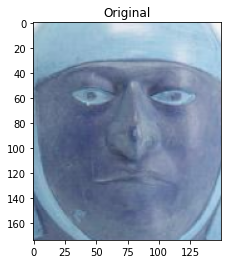

174 150
(216, 205, 366, 379)
216 isss [ 0.00244971  0.00337516  0.0575418  -0.19792953 -0.01007342  0.07449086
 -0.07331459  0.05903635 -0.06469399  0.00827942  0.05274289 -0.04793393
  0.04903325  0.17742164  0.15868667 -0.05033715  0.01050547 -0.07181996
  0.09232546 -0.0494133   0.03402251  0.19343723 -0.02825499 -0.03969004
 -0.03327363  0.10104191  0.08028093 -0.00031397  0.06897769 -0.00866508
 -0.0086858  -0.22580227 -0.00679862 -0.0783366   0.03730588  0.1241473
 -0.03310922  0.08967314  0.05015117  0.1796656  -0.08908635  0.15909357
 -0.17494617  0.03731801 -0.03297352  0.12507549 -0.01597128 -0.07947295
 -0.03020597 -0.10513452 -0.04068664  0.10120123 -0.09519219  0.04017008
 -0.03733634  0.03786077 -0.00567323  0.13530311 -0.08535839  0.05325701
 -0.01752545 -0.05168353  0.07495693  0.02663719  0.02980826 -0.1351638
  0.11640585  0.1916457   0.16318145  0.08423974  0.2090351   0.08709691
  0.006997   -0.1456409   0.04593734  0.06684183 -0.19561148  0.04255654
  0.02639034  0

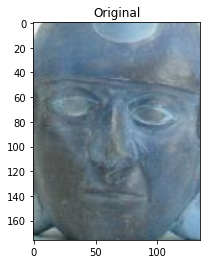

176 135
(229, 234, 364, 410)
229 isss [ 0.12139744 -0.04267583 -0.02995528 -0.10057897  0.09173741  0.13527206
  0.09263203 -0.01636693 -0.07096854 -0.00102923  0.01066145  0.11907165
  0.12797028  0.15755105  0.09959646 -0.1737785   0.00191645  0.04769209
 -0.00668897  0.0738998   0.04557165  0.09827136  0.0819736   0.11823419
 -0.05206428 -0.0229121   0.02467486 -0.09930403 -0.00541533  0.16422635
 -0.12720677 -0.02753974 -0.02493036  0.0272907   0.01040772 -0.01776136
 -0.0429085   0.16928953 -0.07200639  0.02461805 -0.05473308  0.07399311
 -0.1516586   0.0621933  -0.25520355  0.0277417   0.00682362  0.00637257
 -0.01955616  0.07214753  0.08847417  0.03260881 -0.00231998  0.05983283
  0.09716848  0.01867803 -0.01515618  0.1928567  -0.03072092 -0.07032843
 -0.04030495 -0.03152911  0.13164052 -0.08680052  0.01846041 -0.10430001
  0.09225353  0.12275122 -0.06008559  0.0733371   0.11300813  0.08334173
 -0.00766347 -0.07446315 -0.04983867  0.0845806  -0.11586129 -0.14106216
  0.10376937 

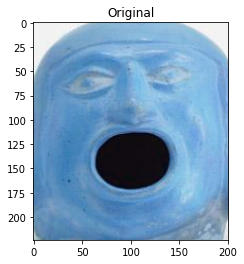

224 201
(199, 183, 400, 407)
199 isss [ 2.29258090e-02  9.90054477e-03  2.78783858e-01  4.11736034e-02
 -1.03332944e-01 -2.65008537e-04 -9.55099985e-02 -1.55032426e-02
 -5.79700917e-02 -5.84399700e-02  7.28986189e-02 -7.39265084e-02
 -7.40698650e-02  8.93909484e-02  2.42646128e-01 -4.46437299e-02
 -1.03340009e-02 -2.12103482e-02  1.08512737e-01 -3.21339853e-02
 -1.28301410e-02  2.00607404e-01  6.27468079e-02  3.89176346e-02
 -1.52046571e-03  5.64048402e-02 -2.27903575e-02 -4.31870557e-02
  7.28485212e-02 -5.91142252e-02 -2.78439112e-02 -1.26131298e-02
  7.64751732e-02  1.60295740e-02  6.72200993e-02  1.00869611e-01
  5.81417680e-02  9.65623334e-02  2.18810365e-02  8.11250731e-02
 -3.53000760e-02  1.88167170e-02 -1.90343872e-01 -1.56792596e-01
 -5.80377840e-02  1.69012696e-01  1.02186427e-02 -1.14760220e-01
 -7.99363256e-02 -5.10042459e-02  4.13285941e-03  2.14912623e-01
  8.48088637e-02  7.85684139e-02 -5.86155709e-03 -1.63066443e-02
  1.62594974e-01 -9.95188057e-02 -5.14906570e-02  6.

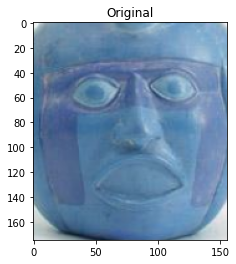

175 156
(217, 244, 373, 419)
217 isss [ 0.03895547  0.07397875  0.15829389 -0.09998328 -0.01422746  0.05975063
  0.00435847  0.01592016 -0.08114021  0.05570213  0.00419203  0.00754766
  0.04218318  0.11472087  0.09265012 -0.05655935  0.00679768 -0.04745126
  0.04091362 -0.03934921  0.06168984  0.18036018 -0.05353885  0.08652901
 -0.02088847  0.06176936  0.0357323   0.04077771  0.06878132  0.10648226
 -0.15861677 -0.17037004 -0.02281464 -0.00646827  0.05361269 -0.01928438
  0.02806725  0.10682224  0.01930369  0.07265943 -0.09551874  0.07627495
 -0.06314106 -0.07787084 -0.0199615   0.1259061  -0.00359756 -0.06531237
 -0.05113216 -0.02812035  0.1488583   0.17132795 -0.02780893  0.08513774
  0.1199996   0.00964907  0.05820933  0.02056865 -0.03894434 -0.05234782
  0.04951541 -0.07305954 -0.01524561  0.01026042  0.00428223 -0.09579904
  0.07257536  0.13641682  0.04215847  0.06899856  0.12116621  0.04491218
 -0.02041702 -0.12218589  0.06925646  0.14588249 -0.11713601  0.03000285
  0.12123206 

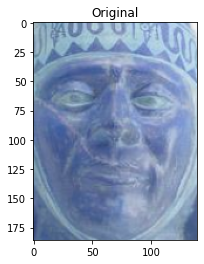

186 140
(221, 197, 361, 383)
221 isss [ 0.05702058  0.05425658  0.16682746 -0.08169494  0.04545756  0.03103245
  0.02486568 -0.06037708  0.04434897 -0.08313029  0.04510479 -0.01982448
 -0.02822073  0.09249949  0.09204458 -0.03438222  0.01346726 -0.04323819
  0.01095238 -0.0832843   0.13204485  0.22249672 -0.16302294  0.06446772
  0.03055187  0.04880447 -0.03746878  0.04205279  0.16269559  0.12546484
 -0.03859809 -0.1247097  -0.04838274 -0.05960212  0.11557215  0.02787055
  0.0377917  -0.00500899  0.10263947  0.0394288  -0.00491069  0.12063375
 -0.05030958 -0.04550445  0.06350362  0.1519791  -0.02430453 -0.05766518
 -0.02518776 -0.17497066 -0.01819426  0.15975666  0.02249765  0.02180363
  0.06637283  0.01896505 -0.04214552  0.09627224 -0.16246472  0.04041849
  0.05747445 -0.04537991  0.03266412  0.06638463 -0.00665888 -0.05849377
  0.09203554  0.07633615  0.10127515  0.04423217  0.14477102  0.010713
 -0.03115043 -0.15739216  0.06701592  0.10094342 -0.12461368  0.03936219
  0.03128884  0

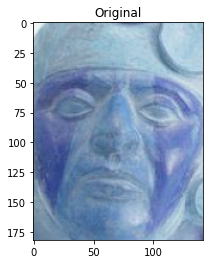

182 142
(222, 189, 364, 371)
222 isss [ 0.08787122  0.04931677  0.02195928 -0.17746437  0.05683882  0.12146887
  0.06577783  0.07635489 -0.13096002  0.04333043  0.01623332 -0.02492831
  0.02382754  0.15414447  0.176214   -0.11823248  0.09625094 -0.0394659
  0.11602388 -0.0701702  -0.03864446  0.26231563 -0.1718622  -0.05604275
 -0.02987912  0.08642793  0.05073143  0.09480937  0.11068643  0.06237103
 -0.08531992 -0.06364235 -0.10727241 -0.01150676  0.04842959  0.0643288
  0.04278122 -0.08089541  0.06832236  0.0801597   0.02515546  0.07718056
 -0.02289029  0.06624973 -0.0641019   0.16039865  0.02126755 -0.01575866
 -0.07966037 -0.09884298  0.02704239  0.1078729  -0.1151149   0.0284256
  0.02636934  0.04456054 -0.14590338  0.15509734 -0.0802567   0.07599864
 -0.00411368 -0.03094621  0.07166319 -0.03171881  0.00820488 -0.06861792
  0.12155044  0.05878959  0.0823178   0.08228977  0.13453947  0.06610733
  0.02238769 -0.05965351 -0.03623972  0.03439852 -0.05869113  0.040922
  0.04243127 -0.08

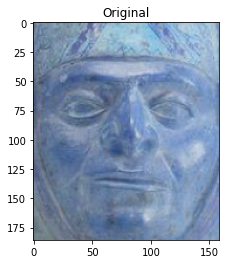

186 159
(210, 191, 369, 377)
210 isss [ 5.98803349e-03  6.15847856e-02  1.33048877e-01 -1.42490879e-01
 -1.06243305e-01  5.03288545e-02 -6.37480319e-02  7.78189003e-02
  1.78667419e-02  1.10984314e-02  5.07513620e-02 -1.36087418e-01
 -4.67312671e-02  1.37970716e-01  1.16101347e-01 -3.39005142e-02
  2.07649618e-02 -6.37087822e-02  1.11978233e-01 -1.59694254e-01
  1.26589071e-02  2.39273593e-01 -1.01698570e-01  2.72645839e-02
 -5.52415773e-02  6.97394982e-02  9.54965949e-02  8.10962021e-02
  1.75491720e-01 -1.83690358e-02 -2.71628201e-02 -1.71600401e-01
 -5.16888909e-02 -8.25379267e-02  2.65042279e-02  8.17915946e-02
  2.50454508e-02  1.04185585e-02  6.64335415e-02  2.25852922e-01
 -1.14717156e-01  1.11210272e-01 -2.04110697e-01 -8.54241252e-02
  1.22355185e-01  1.04399614e-01 -5.70878088e-02 -6.30188733e-02
 -1.91452695e-04 -1.29719973e-01 -1.62861869e-02  2.50944257e-01
 -1.97212808e-02  3.48600261e-02 -8.83187950e-02  3.61285806e-02
  9.80748162e-02  3.47614251e-02 -5.87627627e-02  4.

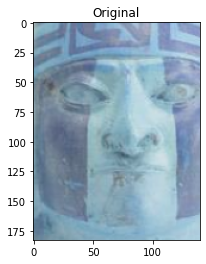

183 140
(211, 193, 351, 376)
211 isss [ 4.34340090e-02  4.33099009e-02 -5.28063886e-02 -1.06836006e-01
 -9.74531919e-02  1.05894744e-01 -9.92989168e-03 -3.37630622e-02
 -7.88140744e-02  1.07286237e-01  8.75560045e-02 -2.60167546e-03
  1.00250550e-01  9.61166099e-02  6.45335242e-02 -1.20466538e-01
 -1.76508017e-02  1.73024796e-02  1.76830083e-01 -1.37082841e-02
 -3.41234729e-02  1.58025414e-01 -4.27902453e-02  1.94126405e-02
 -1.38281897e-01  1.40729263e-01  5.48929013e-02 -7.88361579e-02
  9.39584970e-02  1.27841443e-01 -1.15623944e-01 -6.47653863e-02
 -1.92298908e-02 -1.18036352e-01  9.94225666e-02  1.71205122e-02
  3.45744938e-02  1.18747652e-01  7.04596266e-02  1.25007346e-01
 -1.06961407e-01  3.12526338e-02 -2.33348742e-01  3.35886590e-02
 -1.35313302e-01  3.02840862e-02  2.84655001e-02  8.92137352e-04
 -1.20464135e-02 -7.74387196e-02  5.97984120e-02  1.92019090e-01
  3.25835757e-02  8.80321115e-02  2.90925709e-06  3.80456261e-02
  9.01718885e-02  6.51707500e-02 -6.48127869e-02 -2.

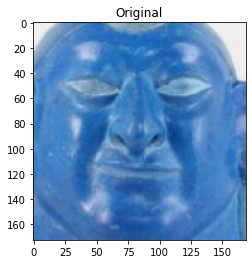

173 169
(221, 226, 390, 399)
221 isss [ 4.42298800e-02  6.30404800e-02  1.66601896e-01 -3.81087475e-02
 -5.93158975e-02 -9.13701300e-03  2.22100862e-04  1.46296024e-02
 -2.38594227e-02 -1.06916036e-02  4.99545485e-02 -7.39472359e-02
 -6.47121370e-02  1.57165244e-01  1.64925724e-01 -5.53532541e-02
  9.51037258e-02 -8.98906365e-02  1.45842746e-01 -9.00379196e-02
 -1.16939181e-02  2.37430766e-01 -1.02345273e-01  1.04563214e-01
  8.54039472e-03  1.38267353e-02  6.40111119e-02  1.00172490e-01
  1.25485688e-01  6.00339323e-02 -8.03763345e-02 -2.04282135e-01
 -2.27277745e-02 -7.16233924e-02  4.17526960e-02  7.04126284e-02
  4.04000953e-02 -3.86128388e-02  2.68460775e-04  1.58997267e-01
 -9.39155295e-02  1.32976487e-01 -1.09426901e-01 -7.45241791e-02
  6.59208298e-02  2.07571357e-01 -2.65507828e-02 -8.68869722e-02
  3.47523578e-02 -7.03009665e-02  8.61233175e-02  2.24875182e-01
 -2.28426009e-02  1.69323478e-02  5.02843745e-02  2.20028162e-02
  2.55815629e-02  2.16294657e-02 -1.01583516e-02  1.

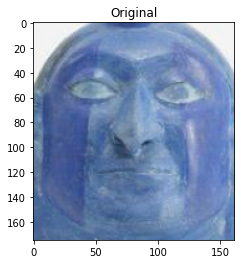

175 162
(205, 215, 367, 390)
205 isss [ 0.08299615  0.05736259  0.01307114 -0.04233107 -0.08810247  0.01871927
  0.11962039 -0.03462419 -0.06341988  0.10151546  0.09117112 -0.02364036
  0.06153926  0.17969176  0.18125741 -0.15730672  0.04401338 -0.03991579
  0.14061362 -0.07068821 -0.08107375  0.1711561  -0.14106297 -0.01863052
 -0.05971191  0.0819546  -0.03831181  0.01591519  0.08866822  0.16898002
 -0.14058082  0.05007985 -0.00268878 -0.0617123   0.06711827  0.01293295
  0.06665067  0.06823719  0.0768588   0.06964307 -0.04630682  0.02516216
 -0.12489441 -0.02512837 -0.09188369  0.13756946 -0.03486319 -0.03489562
  0.00182031 -0.1421866   0.06697525  0.23078932  0.02443923  0.06972315
  0.04599006  0.04521822 -0.02340121  0.03670076 -0.05210885  0.07520227
 -0.05165677 -0.10700963  0.02016064 -0.02858088 -0.02805493  0.01498063
  0.18483981  0.01476375  0.0512903  -0.02982578  0.09342143 -0.03442169
  0.00379745 -0.01365848  0.03491268  0.01548493 -0.10467635 -0.09432633
  0.04728713 

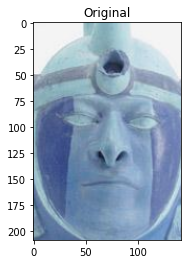

209 142
(225, 194, 367, 403)
225 isss [ 0.05152036  0.02904753  0.01355898 -0.13185976 -0.02334182  0.05222299
 -0.1184919   0.03065585 -0.13815439 -0.03902294 -0.05559068  0.01312964
  0.01377464  0.09041724  0.0273556  -0.01656769  0.04338589 -0.10189617
  0.0905863   0.02253168  0.04284931  0.15884285 -0.06996872  0.05616809
 -0.00470081  0.16615781  0.12581229 -0.02553301 -0.06182487  0.05647882
 -0.13097015 -0.13589242 -0.03079249  0.0279816  -0.00369835  0.0249794
  0.03912409  0.06599754  0.0452614   0.07306641 -0.08867729  0.05909873
  0.03880777  0.01934401  0.07466282  0.15846923  0.12668951 -0.09079008
 -0.10258508  0.01283849  0.15107198  0.01040412  0.00232143  0.10867035
  0.1572772  -0.00399451  0.01081088  0.06201765  0.04911866 -0.13663806
  0.11026638 -0.02913544  0.0047715   0.01850021 -0.03564642 -0.12618999
  0.06422991  0.15321955  0.14728837  0.00785853  0.06475883  0.00584193
 -0.01822152 -0.15092894  0.06826933  0.07461809 -0.10623156  0.06411135
  0.06644084  

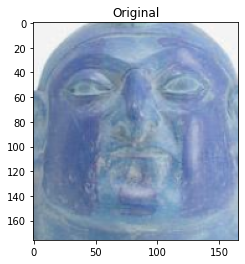

176 166
(209, 224, 375, 400)
209 isss [ 2.42935028e-02  7.97712952e-02  2.99504289e-04 -7.95674473e-02
 -6.83574239e-04  1.48237556e-01  1.13088787e-01 -2.52206586e-02
 -3.91607732e-03  5.22513315e-02  1.55649744e-02 -5.67746237e-02
 -2.57593133e-02  5.33891506e-02  2.29481712e-01 -1.80688903e-01
 -5.41431978e-02  1.09647401e-02  1.36215180e-01 -1.98834047e-01
 -3.95230502e-02  1.32706642e-01 -9.75684077e-02 -1.20379679e-01
  6.69790208e-02 -1.08329710e-02 -3.90753299e-02 -5.78434281e-02
  3.81856263e-02  8.75292644e-02  3.55893932e-02 -2.17791144e-02
  1.53579167e-04 -6.27255887e-02  1.68517098e-01 -9.41790920e-03
  1.76306628e-02 -8.18496868e-02  7.87365809e-02 -4.59538773e-02
  5.88538274e-02 -2.76206583e-02 -6.22724183e-02  9.11222473e-02
 -1.27290234e-01  1.08656950e-01 -5.37762865e-02 -2.70873755e-02
 -1.00796044e-01 -1.85820013e-01 -5.92296310e-02  7.03138858e-02
  1.08730167e-01 -4.68503274e-02 -6.37759194e-02  1.15018182e-01
 -9.99872386e-02  1.02777623e-01 -1.30474359e-01  4.

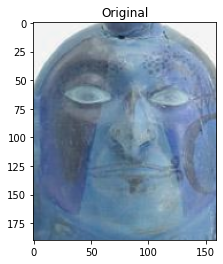

190 160
(212, 211, 372, 401)
212 isss [ 0.13101089 -0.04796174 -0.10398053 -0.05990727 -0.04279665  0.02531634
  0.09983571 -0.04857029 -0.0986786   0.12249491  0.06595081  0.04522951
  0.12374873  0.15898533  0.12126092 -0.12582964  0.04893926 -0.03739263
  0.15747087 -0.00027994 -0.06975485  0.12273731 -0.03686753  0.03643722
 -0.06729001  0.14287816  0.05779583 -0.06566583  0.03846502  0.19275802
 -0.15811372  0.0779399   0.00439847 -0.0319615   0.03399711 -0.056393
  0.0542644   0.14967692  0.0908742  -0.00537191 -0.07558137  0.00073738
 -0.12649804  0.02086705 -0.16003463  0.02446685 -0.05282945  0.01151232
  0.06311594 -0.07814144  0.10652787  0.12482405  0.08899479  0.07491079
  0.06692824 -0.00080892  0.03842869  0.08705782 -0.01062896 -0.01950608
 -0.05351606 -0.13736254  0.0824481  -0.01178265 -0.04577199  0.03708002
  0.11905412  0.06691439  0.05028833 -0.12634088 -0.00585551 -0.02497185
 -0.02269136 -0.04021277  0.00595123 -0.00945194 -0.06464437 -0.15819953
  0.0915416   0

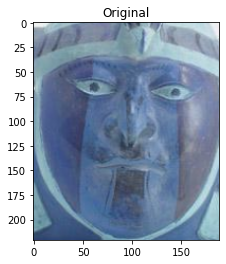

221 189
(193, 190, 382, 411)
193 isss [ 5.08791581e-02  5.10806367e-02  1.13990352e-01 -1.12904832e-01
  2.66246051e-02  2.33887415e-02  3.63542289e-02  4.27906252e-02
 -9.05308947e-02 -1.80473439e-02 -1.58975422e-02 -2.83053424e-02
 -9.12873540e-03  2.15417221e-01  1.87340334e-01 -1.20554395e-01
  2.02199668e-01 -1.06286161e-01  1.44232914e-01 -4.49337289e-02
 -6.53390065e-02  1.92362279e-01 -1.19388126e-01 -2.09472049e-02
 -1.14507927e-02  7.63425156e-02  5.28155128e-03  1.06424086e-01
  7.27470741e-02  1.00819943e-02 -5.54573387e-02 -7.24816397e-02
  7.35627860e-03 -4.28885361e-03  3.60506512e-02  5.25978841e-02
  1.34100586e-01  6.07258119e-02  6.55114427e-02  5.67179099e-02
  2.18951572e-02  1.45235062e-01 -3.30770239e-02 -1.37821540e-01
 -2.00333260e-02  2.40807071e-01 -2.38607246e-02 -1.00143515e-01
 -5.95594682e-02 -1.42523155e-01 -3.54947224e-02  1.32751822e-01
  1.15882494e-02  5.57780936e-02  3.76345590e-02  3.52298319e-02
 -3.66451479e-02  7.79706612e-02 -1.08845003e-01  7.

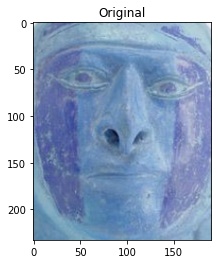

233 191
(210, 115, 401, 348)
210 isss [ 0.06896021 -0.02265502  0.0903974  -0.04925542  0.01646388  0.06218484
  0.01784399 -0.04799084 -0.02956128 -0.03161239  0.07284274  0.03955806
 -0.02480707  0.09092439  0.10383852 -0.09781075 -0.01874205 -0.00798038
  0.12498205 -0.07631693  0.07782737  0.18937355 -0.13036986 -0.02124951
  0.02846283  0.1057203  -0.02022016 -0.03526562  0.01479348  0.12061521
 -0.07527333 -0.13105848 -0.03587018 -0.0719971   0.12819292  0.05204401
  0.00028869 -0.00978258  0.12955196  0.05057371 -0.01391122  0.11533325
 -0.10814153 -0.01571321 -0.04702859  0.1126895  -0.02205903 -0.1201591
  0.01504234 -0.1298704   0.01630069  0.17334384  0.01193297  0.08543026
  0.06179585  0.01102883  0.02022461  0.03727549 -0.17308058  0.06034773
  0.0553589  -0.09382752  0.06589854  0.02562258  0.03352114 -0.12650856
  0.11951352  0.10304967  0.14049786  0.0681012   0.17540121  0.05740631
 -0.01368662 -0.16443948  0.00469076  0.10594165 -0.16744398 -0.02862696
  0.0101843   

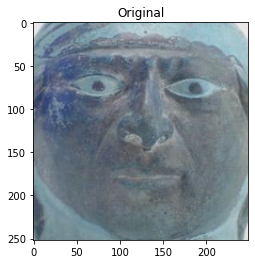

252 249
(180, 111, 429, 363)
180 isss [ 0.05535225  0.06705409 -0.04461956 -0.12346897  0.05782742  0.1125555
  0.02898793 -0.09605633 -0.01577152  0.02521622  0.07020226 -0.01352412
  0.03326289  0.19396108  0.0701554  -0.02458169  0.05759181  0.03932263
  0.06180355 -0.07842531  0.00071732  0.20510954 -0.0856763  -0.11863554
 -0.05762181  0.07510298  0.04896178  0.04484773  0.07408596  0.12664098
 -0.09242491 -0.03973795 -0.02275562 -0.11648281  0.12108567  0.09146567
  0.00499136 -0.01523686  0.04981804  0.04717383 -0.09517863  0.12545146
 -0.08598033  0.06976469 -0.07414272  0.2003611  -0.02324947 -0.01444642
 -0.09198615 -0.17389011  0.0103385   0.11202323 -0.06408056  0.00310683
 -0.04051987  0.06714531 -0.09218767  0.1376533  -0.12642068  0.13993129
  0.00163564 -0.05443679  0.14660896 -0.05095698  0.12843648 -0.10244671
  0.03462604  0.1341085   0.03616211  0.1178538   0.19411975  0.02227969
  0.037919   -0.22297935 -0.09554187  0.11165709 -0.07571554 -0.00629012
 -0.05373879 -

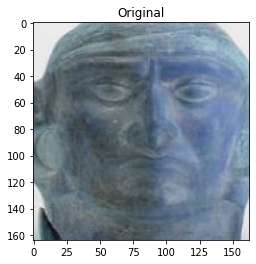

164 163
(222, 235, 385, 399)
222 isss [ 0.02590123 -0.03057886  0.08441344 -0.06013823 -0.04393967  0.02227792
  0.02605698 -0.01119453 -0.03391442 -0.01616754  0.06170077  0.02936548
  0.02552903  0.16260429  0.09571661 -0.11477772  0.00569273 -0.05106075
  0.13521142 -0.03412032  0.01597069  0.13561372 -0.00447875 -0.02151401
 -0.06914974  0.12566811 -0.02541984 -0.04180852  0.09245747  0.02534059
 -0.04589519 -0.08728067  0.00419755 -0.10022055  0.05643778  0.0184241
  0.02567231  0.21912879  0.09551077  0.14104165 -0.04599149  0.17936867
 -0.23818158 -0.10465086 -0.09993451  0.01099942 -0.05687864 -0.13584527
  0.05830804 -0.12340466 -0.05739495  0.1735894   0.02260019  0.11194783
 -0.02888257  0.005405    0.12319089  0.091586   -0.15301645  0.05665486
 -0.02370933 -0.05901697  0.08735489 -0.02429806  0.0375369  -0.03931897
  0.19330871  0.07032212  0.1024148   0.01926231  0.12840281  0.03980921
  0.01516482  0.03345472  0.07165367  0.0218537  -0.18053298 -0.09619421
  0.04705386  

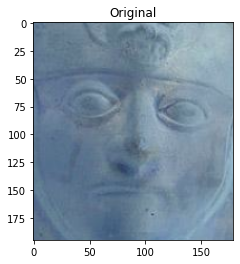

195 179
(209, 146, 388, 341)
209 isss [ 0.04474391 -0.01048008 -0.06055534 -0.15272823  0.02690526  0.10312157
  0.05333603  0.06577665 -0.00590766  0.0489952   0.07095832  0.10527891
  0.12455772  0.01193762 -0.01736526 -0.13397384 -0.0772415   0.06652955
 -0.06014137  0.11210097  0.06756502  0.05371127  0.08101806  0.15822758
 -0.14990368  0.02294677  0.0855411  -0.12108643  0.08574955  0.07992513
 -0.12031748 -0.12539777  0.02550753 -0.00890142 -0.00288478 -0.04167648
 -0.07182086  0.22499184 -0.13207921  0.05571388 -0.06711771  0.03845387
 -0.22918493  0.16275392 -0.24371755 -0.06261314  0.0230156   0.02867616
 -0.05604072  0.0989475  -0.00996732  0.04202459 -0.07941274  0.03964588
  0.05213001  0.0237212  -0.00531813  0.18029292 -0.08442888 -0.10554989
 -0.08409488 -0.07882763  0.25730342  0.00324473  0.01148908 -0.14789063
  0.06887624  0.06528974 -0.032018    0.04946884  0.06122541  0.01671397
  0.00946797 -0.00584856 -0.00845618  0.00615704 -0.13115816 -0.01540401
  0.10546514 

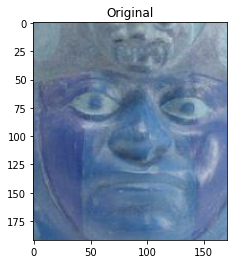

192 171
(223, 115, 394, 307)
223 isss [ 1.12696588e-01 -9.34104696e-02  1.47097096e-01 -6.31631166e-02
  1.04170382e-01  1.96856052e-01  9.18435976e-02  1.91798378e-02
 -4.22227941e-02 -5.01698628e-02 -6.68519661e-02  5.59042543e-02
  3.25101502e-02  3.45993079e-02  2.07631469e-01 -1.31575510e-01
 -5.82221895e-02 -3.15342061e-02  2.51608063e-02 -8.34001526e-02
  7.66556412e-02  1.72370479e-01  5.63504286e-02  1.12167284e-01
  1.14414375e-02 -6.15137368e-02 -8.56472999e-02 -1.24560967e-01
 -1.10550178e-02  5.52505329e-02  5.91517333e-03 -6.40902892e-02
 -1.02783941e-01  3.63687947e-02  8.84010047e-02 -3.48373912e-02
  1.58901718e-02  3.66241559e-02  3.28045785e-02  3.69765796e-02
  6.27166778e-02  7.02343434e-02 -1.65945917e-01 -9.77360755e-02
 -1.75627843e-01 -1.25984307e-02 -7.63691068e-02 -3.37538645e-02
  4.88912538e-02  5.35459304e-03  5.83802946e-02  6.74129464e-03
  1.02244437e-01  5.69415577e-02  3.76665480e-02 -1.49465976e-02
  1.09448552e-01  1.22842968e-01 -1.08406387e-01  1.

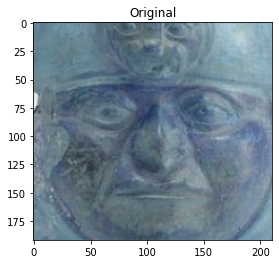

192 211
(179, 127, 390, 319)
179 isss [ 9.74571258e-02  7.19010010e-02  7.59141594e-02 -1.40538260e-01
  6.83112070e-02  1.66297302e-01  5.09694777e-02 -7.39868581e-02
 -7.30789602e-02  3.40166204e-02  2.35170200e-02  3.10528688e-02
  4.86278087e-02  1.64010346e-01  1.20543346e-01 -7.65506327e-02
 -1.40639087e-02  3.49944383e-02  3.67303193e-02 -6.51728511e-02
  5.56850731e-02  2.24899963e-01 -2.26170942e-02  7.93769881e-02
 -3.05830352e-02 -1.82890522e-04  3.07845958e-02  5.36704138e-02
  1.38712049e-01  1.63182005e-01 -1.43064976e-01 -7.98880160e-02
 -6.57520667e-02 -2.59727016e-02  8.69395286e-02  1.43435523e-02
 -9.65564139e-03  2.62603424e-02  4.65204902e-02  6.15860336e-02
 -8.18099976e-02  6.68687969e-02 -8.84626061e-02 -3.62938866e-02
 -1.24695644e-01  1.11276083e-01 -1.37095200e-02  3.12199220e-02
 -7.25405067e-02 -2.45325398e-02  1.07442431e-01  1.77633658e-01
 -3.13610621e-02  4.81383950e-02  6.33358583e-02  2.17995476e-02
  2.90543288e-02  1.73948303e-01 -1.37207910e-01  3.

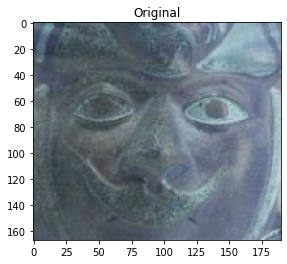

167 190
(199, 131, 389, 298)
199 isss [ 0.07068549 -0.09198911  0.08682214 -0.1427929   0.08095186  0.13091536
  0.07162348  0.08007012 -0.06764707  0.0023711  -0.03545354  0.03691304
  0.11970646  0.02225212  0.11047013 -0.13121504 -0.07512508  0.06436978
 -0.00349026  0.00837045  0.14788689  0.0878544   0.01028874  0.08406728
 -0.07056908  0.03701587 -0.10658162 -0.17092624  0.07256331  0.06574078
 -0.05363737 -0.07381129 -0.06882716 -0.00933729  0.1176767  -0.04956439
 -0.03028706  0.15188877  0.03132967 -0.01720345  0.01962652  0.09426837
 -0.18303227  0.00412681 -0.17303888 -0.04299076 -0.01278792 -0.01707335
 -0.03387381 -0.04896196 -0.05457098 -0.00981019  0.06294487  0.07625569
  0.03277499 -0.00484162  0.09999111  0.1132666  -0.12627655 -0.12971343
  0.02817442  0.00253314  0.09077977  0.00606262  0.01541202 -0.03388356
  0.10784791  0.11092407  0.03907618 -0.06320859  0.07958379  0.0659355
 -0.01953912 -0.09801065 -0.02590263  0.06920309 -0.21788655 -0.1163919
  0.17737429  0

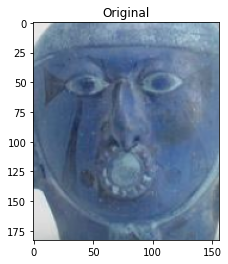

183 156
(207, 213, 363, 396)
207 isss [ 0.01188591  0.12519288  0.1258166  -0.16736846  0.05354832  0.09267736
  0.01616464  0.04675779 -0.09641993  0.0477301  -0.0359485  -0.07180846
  0.037793    0.08722156  0.15791892 -0.04418327 -0.01298003 -0.01059514
 -0.00890017 -0.06109062  0.06285277  0.13517085 -0.00842913 -0.10463052
 -0.00368775  0.03276046 -0.06850824 -0.015071    0.10685114  0.01693805
 -0.07514645 -0.08551439 -0.04473784 -0.04794089  0.0925846   0.00218356
  0.01227449  0.11617176  0.04547643  0.04147461 -0.03829213  0.07014589
 -0.10817635 -0.03611102 -0.08374333  0.23759024 -0.01391665 -0.05575737
 -0.14222969 -0.1132673   0.01105026  0.19025572 -0.05824532  0.04726641
 -0.02630836 -0.02580697  0.09350628 -0.00514159 -0.08046081 -0.0294792
  0.05198809 -0.03338504 -0.01878123  0.01240368  0.07334733 -0.09931639
  0.04413354  0.21941689  0.0934611   0.09536513  0.17480405  0.06842714
  0.00034197 -0.19344975  0.04734638  0.15275913 -0.1988382   0.03071593
  0.07713197  

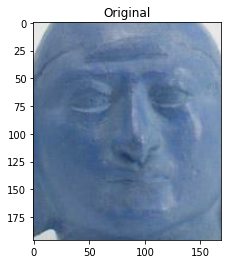

196 169
(206, 194, 375, 390)
206 isss [ 0.02654282  0.05609202 -0.01020486 -0.1631669   0.02945994  0.09133317
  0.01315166  0.06520291 -0.10171804  0.06337806  0.02037229 -0.00648436
  0.04587169  0.09932911  0.11119134 -0.06459023  0.0236028  -0.01048314
  0.13277814 -0.01083544  0.03902705  0.11335739  0.03816132 -0.11867499
 -0.04049302  0.09211541  0.01590938 -0.08354017  0.13341756  0.02131839
 -0.06480798 -0.11506721  0.00989064 -0.11180466  0.08232086  0.01065196
 -0.00306426  0.19606291  0.07858912  0.08355195 -0.09952842  0.14029318
 -0.19596685  0.0217593  -0.15036707  0.14531529  0.01559426 -0.10932241
 -0.10217271 -0.09370528 -0.05989637  0.17713915 -0.07855099  0.05866111
 -0.08517551 -0.00436047  0.0975824   0.08710726 -0.16828737  0.02946102
 -0.00247617 -0.08583869  0.15121683 -0.05739242  0.11702855 -0.13945879
  0.07383783  0.15474606  0.09808595  0.07363864  0.17516162  0.09433173
 -0.03122296 -0.0974465  -0.00206478  0.06694469 -0.17410155  0.00921814
  0.04498422 

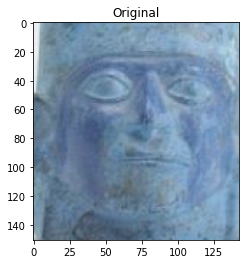

151 143
(230, 263, 373, 414)
230 isss [ 0.02101866  0.08569375  0.14567928 -0.09316596 -0.07493066  0.01823585
 -0.0406102  -0.00606214  0.00658783  0.05014358  0.05392388 -0.08851437
 -0.01142404  0.1697034   0.10167567 -0.04621669  0.01607287 -0.03609651
  0.05235896 -0.11422329  0.00864016  0.19168359 -0.07061131  0.01387362
 -0.03213873  0.01289128  0.04185709  0.12034531  0.108131    0.05776363
 -0.12099334 -0.11577214 -0.01316808 -0.05698594  0.01975634  0.0332942
  0.03673668  0.03264612  0.06885997  0.16011982 -0.12093892  0.07727906
 -0.16408677 -0.18482125  0.08376622  0.14654963 -0.09834712 -0.04587812
  0.00764489 -0.10992901  0.05891391  0.2997536   0.00067101  0.07503355
 -0.05525183  0.00203683  0.12793314 -0.07559741 -0.0771948   0.0543827
  0.07414475 -0.01215838 -0.06646531  0.06991258 -0.11450854 -0.04090903
  0.13395354  0.14923401  0.12179088  0.09688272  0.11203294 -0.0231463
 -0.02293998 -0.08937349  0.11008583  0.08793002 -0.12032195  0.00541133
  0.02596214  0.

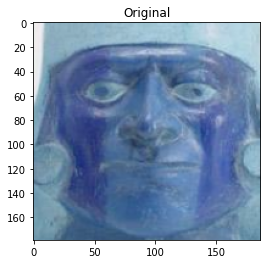

179 187
(203, 203, 390, 382)
203 isss [ 0.07538594  0.0057615   0.09899876 -0.07772343  0.02279512  0.0183222
 -0.02697533 -0.04738003  0.00043304 -0.09304612  0.05631647 -0.03840657
 -0.01250633  0.14205636  0.09510203 -0.0369539   0.0597206  -0.11482739
  0.05487369 -0.02630066  0.06527893  0.17203344 -0.13629188 -0.01010735
  0.02918739  0.11229795 -0.02214925  0.01778583  0.02846243  0.04398466
 -0.02539133 -0.15290013 -0.05691284 -0.04818957  0.08434482  0.09564906
  0.05017966  0.04829807  0.13016045  0.06236332 -0.03135022  0.15411162
 -0.08836363 -0.07390038  0.08677619  0.1892143  -0.04289399 -0.0893153
  0.00279328 -0.1410359  -0.05185602  0.12962687  0.0143902   0.0700207
  0.04201375 -0.01361002 -0.03200547  0.06679393 -0.12336402  0.05180163
  0.07894659 -0.03892593  0.00282823  0.02510442 -0.0107712  -0.08557469
  0.12706536  0.1795271   0.19466247  0.01865983  0.17485693  0.02784815
 -0.00509634 -0.18110678  0.05871764  0.10499568 -0.12713625  0.04908214
  0.02048476  0.

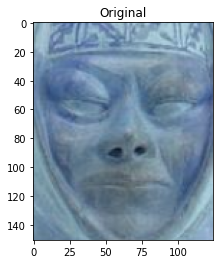

151 125
(242, 244, 367, 395)
242 isss [ 0.04483876  0.09089747  0.25467667 -0.05198434  0.06219598  0.0380429
  0.02651234  0.02495344 -0.01189501 -0.00850523  0.00473161 -0.0008252
 -0.03303539  0.0442344   0.11256251 -0.03129229  0.04146148  0.08931809
 -0.04213486 -0.02545424  0.15635249  0.18717228 -0.10282032  0.07708713
  0.03401121  0.02931979 -0.08307304  0.03039194  0.16070926  0.08898684
 -0.07466482 -0.03605853 -0.01331562  0.0204921   0.12708089 -0.01437414
  0.0417938   0.09517685  0.03206909 -0.04871012 -0.01369445  0.10360333
 -0.0141182  -0.05279427 -0.01245031  0.11901507  0.03158145 -0.07873029
 -0.1008035  -0.08438462  0.07100669  0.19058925 -0.05776346  0.03582901
  0.12158586 -0.01249511  0.01241648 -0.00605374 -0.11502437 -0.07548487
  0.05809991 -0.09192248 -0.02257664  0.03640341  0.01770557 -0.08441239
  0.03901565  0.05969083  0.00569957  0.15526043  0.13577014  0.0301155
 -0.01723887 -0.10512787  0.00659748  0.05297466 -0.11359085  0.08767995
  0.0851729  -0.

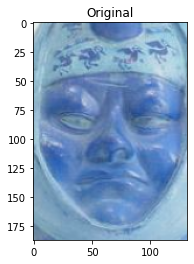

187 132
(229, 184, 361, 371)
229 isss [ 0.0148732   0.1629226   0.17430586 -0.0659896   0.00731895  0.01137182
  0.07008654  0.06993722 -0.0178952   0.04955933  0.00207488 -0.09475366
 -0.06583144  0.09159598  0.08155603 -0.0196981   0.08155333 -0.06413391
  0.03436359 -0.12984808  0.04672937  0.11674911 -0.13255051 -0.00803718
  0.03612799 -0.04657022 -0.04441782  0.1334525   0.19231983  0.03331403
 -0.09976881 -0.12989277 -0.0605627  -0.04216892  0.02112963 -0.0046587
  0.05714381 -0.01058482  0.04539901  0.07224009 -0.04191797  0.08531422
 -0.05378465 -0.1795267   0.10584548  0.2609923  -0.05807156 -0.08745818
 -0.06920002 -0.15529342  0.0083197   0.300957   -0.06932361  0.01555581
  0.00413673  0.00125996  0.07744405 -0.04959042 -0.09389824  0.07273819
  0.11310393 -0.00821941 -0.09747519  0.00687621 -0.02036115 -0.03605952
  0.05699759  0.1207303   0.09949399  0.11291726  0.12136089  0.05531988
 -0.04591124 -0.09211995  0.10259259  0.14677654 -0.03424199  0.16939962
  0.04380482 -

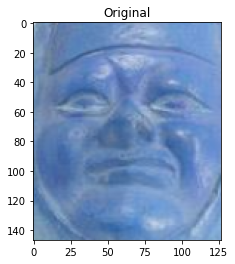

147 127
(237, 184, 364, 331)
237 isss [ 0.02640525  0.12132271  0.20440027 -0.06443771 -0.00338122 -0.02986982
  0.01831637 -0.01862467 -0.00823976 -0.01951972  0.00205529 -0.09293997
 -0.08965448  0.17985232  0.11723784 -0.01677533  0.06953766 -0.06938044
  0.04414573 -0.07334659 -0.00410478  0.22324266 -0.09420326  0.02068128
 -0.0163834  -0.03558919  0.00038061  0.18834938  0.14291002  0.04703243
 -0.14021428 -0.14632536 -0.00499758 -0.02870805  0.05877887  0.06335026
  0.09012327 -0.02042573 -0.00185173  0.08001407 -0.100866    0.11982694
 -0.01977755 -0.18207675  0.08770665  0.29596597 -0.03414988 -0.04961251
 -0.03853704 -0.04522109  0.00537507  0.23979124 -0.04632526  0.05982922
  0.05628843 -0.00071033  0.04747068 -0.04322901 -0.08473438  0.11070332
  0.09115162  0.04477245 -0.09663809  0.03112659 -0.03196304 -0.03124299
  0.05218591  0.06222483  0.0644662   0.14992449  0.1168901  -0.0126839
 -0.00436234 -0.05420366  0.10533288  0.11759234 -0.01998069  0.10888661
  0.05296561 -

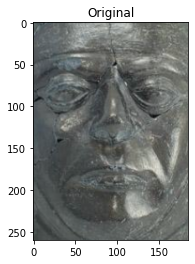

260 185
(197, 105, 382, 365)
197 isss [ 0.04746746 -0.01619645  0.23233677 -0.08130712  0.10325844  0.09948525
  0.05169201  0.05711455 -0.0162636  -0.08979335 -0.01108237  0.06239456
 -0.01992455  0.0814982   0.12344309 -0.09556436 -0.02994787 -0.03591198
 -0.02378133 -0.00706838  0.13855009  0.13607128 -0.05162214  0.00846665
  0.026699    0.03961799 -0.08183853 -0.00619606  0.08172511 -0.01888829
  0.00108491 -0.1291634  -0.06977109 -0.00269579  0.08691898  0.04744473
 -0.00996491  0.12455361  0.02953137 -0.00184153  0.05407509  0.15984298
 -0.10192544 -0.0610144  -0.09520299  0.05859851 -0.03288075 -0.11810578
 -0.03878262 -0.06288373 -0.05816418  0.10817485 -0.08771788  0.07639802
  0.10052003 -0.02168199 -0.02851863  0.12253845 -0.2016669  -0.0024675
  0.0310195  -0.04798436  0.04992199 -0.02692343  0.11374479 -0.07150777
  0.07953728  0.13378091  0.03907384  0.16142325  0.18413348  0.13449505
  0.00679665 -0.06133989  0.0155548   0.09565394 -0.12813066  0.02058691
  0.09034035  

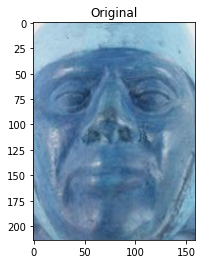

214 159
(219, 167, 378, 381)
219 isss [ 0.0408128   0.07418498  0.16920233 -0.04594667  0.02280648 -0.027973
 -0.07182825 -0.095295   -0.01059398 -0.06210652  0.04785335 -0.02661688
 -0.03833576  0.15539719  0.09434771  0.01370693  0.07229359 -0.02517297
  0.05241053 -0.0124541   0.10494579  0.15175247 -0.09945863  0.02143552
  0.06294964  0.10380051 -0.01552319  0.03914934  0.0957488   0.09992874
 -0.0828393  -0.06264145  0.02136194 -0.03032883  0.07699161  0.08062799
  0.05414303  0.05975034  0.1236865   0.01180615 -0.07818534  0.09292985
 -0.02689044 -0.12758625  0.08941097  0.25421202  0.03160592 -0.11722651
 -0.09802695 -0.16202576  0.0130626   0.1986227   0.01393942  0.05277177
  0.07421286  0.00598349  0.02744161  0.00365389 -0.12509707  0.03905255
  0.11193234 -0.04640042 -0.02240846  0.05154327  0.01688376 -0.05005239
  0.04042039  0.14491972  0.114051    0.10291981  0.12963115 -0.01209438
 -0.06814507 -0.18657139  0.10007224  0.0932098  -0.08534697  0.08104015
  0.0174138   0

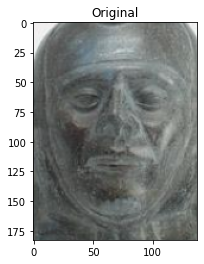

183 138
(234, 214, 372, 397)
234 isss [ 0.03768111  0.03175572  0.00721068 -0.1228468   0.08527524  0.13621633
  0.04955504 -0.02152981 -0.03461659 -0.019186    0.01010609  0.02216019
 -0.02495647  0.09147681  0.09506426 -0.13886896 -0.06608341  0.00096512
  0.12742905 -0.06689869  0.02940542  0.12782896  0.03181984 -0.01478593
  0.0211137   0.04212993  0.04180877 -0.06615506  0.11089882  0.03584576
  0.00270799 -0.20771539 -0.0351037  -0.10458366  0.1023807   0.02924718
 -0.04794285  0.08742987  0.03091018  0.06920867 -0.01247731  0.15295343
 -0.15878494  0.10209332 -0.2114744   0.07850411  0.01171624 -0.07297572
 -0.01200119 -0.05982082 -0.06641648  0.11753617 -0.03468269  0.01480663
  0.02613391  0.04274702  0.03251471  0.2294342  -0.14945844  0.02319766
 -0.04656051 -0.04306472  0.23043253 -0.04538757  0.12053352 -0.09656691
  0.08615995  0.07376306  0.05940447  0.17631721  0.16734771  0.16698736
  0.00497309 -0.0429548  -0.00207036  0.04389133 -0.17693745 -0.01823734
  0.02811692 

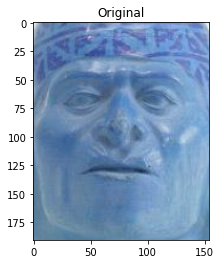

191 154
(226, 195, 380, 386)
226 isss [ 0.02266684  0.01905207  0.09685801 -0.08917262 -0.03517076  0.10034595
 -0.09512856  0.04744211 -0.0454703  -0.07003473 -0.01557028 -0.04670403
 -0.04430259  0.1482096   0.04923905 -0.10320031  0.03724133 -0.11528476
  0.11552575 -0.02823995 -0.01526423  0.20621347 -0.07959738  0.06975012
 -0.02169963  0.0727295   0.11218706  0.09624781  0.01173477 -0.03370541
 -0.05792326 -0.28180584 -0.05894189 -0.03604639  0.01973974  0.11031435
  0.01475693 -0.00479197 -0.06243749  0.11298515 -0.03968843  0.1400822
 -0.07827126 -0.00873802  0.01928474  0.109626    0.01168476 -0.04236038
  0.02862304 -0.00192535  0.06529185  0.13445465 -0.01199206  0.07300356
  0.12492506  0.01501008 -0.00810243  0.06397864  0.05902749 -0.07378256
  0.02800012  0.0402881   0.00892861  0.00567166 -0.04396728 -0.10486121
  0.18293798  0.07741015  0.1577375   0.14791267  0.13191324  0.04949347
  0.06395644 -0.0622849   0.07829808  0.05959319 -0.12917621  0.10929272
  0.05424381  

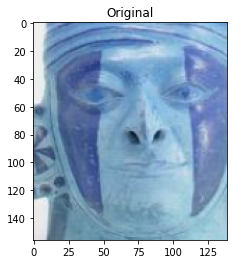

156 139
(222, 224, 361, 380)
222 isss [ 8.63150656e-02 -9.95199010e-02  9.35496539e-02 -8.35737810e-02
  7.85325021e-02  1.12931147e-01  3.84849757e-02  1.11977826e-03
 -2.29836300e-01  9.00153592e-02 -5.76749854e-02  1.07406892e-01
  6.52200356e-02  9.86115634e-02  2.02303201e-01 -1.03673778e-01
  6.47918554e-03  2.81777553e-04  1.91063315e-01  4.69145700e-02
 -2.76120449e-03  1.16446361e-01  4.43448536e-02  6.22496791e-02
 -2.46025473e-02  1.37656808e-01 -4.23266441e-02 -1.18475236e-01
  1.86633728e-02  5.40511943e-02 -1.02009758e-01 -3.65813598e-02
 -6.46814108e-02 -1.38826519e-02  1.03306957e-01 -8.50110315e-03
 -1.84753668e-02  1.21787079e-01  7.48462379e-02 -3.28176022e-02
 -3.82710695e-02  6.63343519e-02 -1.07030846e-01 -5.35202064e-02
 -1.90866888e-01  4.02243510e-02  2.96746194e-02 -3.43530178e-02
 -5.37676848e-02 -1.22522749e-02  9.20264572e-02 -1.66275147e-02
  5.64349927e-02  4.56395522e-02  1.08846888e-01 -1.66670163e-03
  5.82234487e-02  1.57254934e-01 -9.73677114e-02  1.

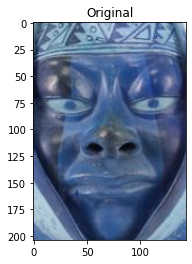

204 143
(231, 191, 374, 395)
231 isss [ 0.06784903  0.09232368  0.1159766  -0.10372865  0.06646205  0.13684814
  0.08075188  0.07031639 -0.07155059  0.03527144 -0.00410312 -0.06544074
  0.05735938  0.02353106  0.1974944  -0.10074737  0.0516769   0.03029509
 -0.02118173 -0.02331135  0.0918334   0.11609093 -0.03607767  0.02214565
  0.02963663 -0.02762913 -0.09801503 -0.0803391   0.1216702   0.05414577
 -0.00816425 -0.04851739 -0.02934641  0.01446939  0.14793406 -0.01404098
  0.04264252  0.13535914 -0.00396519 -0.09754653  0.02390222  0.01717445
 -0.08101992  0.04548286 -0.1415633   0.16764146  0.01099645  0.00955393
 -0.17262007 -0.1050576   0.02457483  0.11106393 -0.00670665 -0.01812763
  0.07436384 -0.00388317 -0.05733695  0.07058895 -0.07538709 -0.10416131
 -0.03628331 -0.07265995  0.02653802 -0.07703021  0.11863295 -0.03500422
  0.0287663   0.12222746 -0.04761122  0.06415419  0.1291045   0.04138681
 -0.05517224 -0.18768065  0.00297273  0.08019068 -0.13195029  0.03865262
  0.13889359 

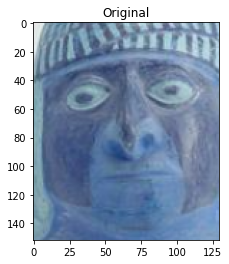

152 130
(230, 243, 360, 395)
230 isss [ 0.06781239  0.02462284  0.00176758 -0.16477402  0.0702241   0.0800608
 -0.00435602  0.06141653 -0.04829556 -0.06456308 -0.05048944  0.02836852
  0.01608391  0.11046109 -0.006785   -0.01643864  0.00091111 -0.08881783
 -0.02342962  0.01650002  0.09380388  0.19715309 -0.04057319 -0.00921668
 -0.067097    0.0699306   0.07611257  0.00969013  0.01334054  0.06839947
 -0.15099028 -0.15305893 -0.05298599 -0.01240865  0.03201791  0.02013947
  0.00145792  0.10857059 -0.06515985  0.06215624 -0.07597484  0.1478981
 -0.03919042  0.05370022 -0.02206605  0.19705424  0.0303195  -0.04898809
 -0.05999895  0.01948604  0.06017193  0.0796369  -0.08389392  0.08311654
  0.15709448 -0.02447909  0.00061137  0.11175477 -0.04218369 -0.07140633
  0.06625959 -0.03701583  0.08332153  0.01846972  0.03047521 -0.19477914
  0.02754001  0.19608995  0.12619905  0.09019684  0.1650164   0.06395727
  0.04168115 -0.15440604 -0.00398221  0.15947469 -0.09894897  0.07032731
  0.04203131 -0

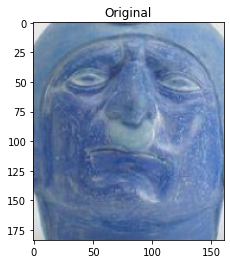

184 161
(222, 203, 383, 387)
222 isss [ 0.02980023  0.05257849 -0.02468174 -0.10892291 -0.02668941  0.07196036
 -0.0778873  -0.08838583  0.06175368 -0.06157294  0.11590102 -0.06898512
 -0.01621279  0.10947344  0.05057598  0.01260705 -0.03357812 -0.09876762
  0.08923482 -0.09174275  0.04702682  0.21584831 -0.10253017 -0.00705175
 -0.00512397  0.07770558  0.10687242  0.00736747  0.07602765  0.09589165
 -0.02402328 -0.2140994  -0.00874926 -0.11560923  0.07580046  0.1373692
  0.00531292 -0.08332052  0.08930425  0.16386361 -0.07781115  0.0935688
 -0.11345574  0.03492178  0.07968039  0.17302032 -0.0043111  -0.02719768
  0.00549465 -0.13090773 -0.05851941  0.13996269  0.01611017  0.02609945
 -0.02135343  0.05689332 -0.02338667  0.07690964 -0.10501704  0.09880093
  0.00423272 -0.03429673  0.11902399  0.04756848 -0.03309111 -0.12428089
  0.11514461  0.0973486   0.19123136  0.05077872  0.13533866  0.00982978
 -0.03690815 -0.19513439  0.08731469  0.07912447 -0.14667302  0.06878141
 -0.07319     0

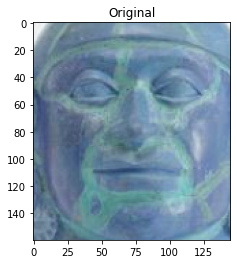

160 145
(219, 230, 364, 390)
219 isss [-0.01377705  0.11531943  0.14421323 -0.07610526 -0.04947312 -0.00283759
  0.01143082  0.04581261  0.07249695  0.04341234  0.06033098 -0.08318757
 -0.04349264  0.11141243  0.05724403 -0.04307741 -0.01466802 -0.08145141
  0.03240834 -0.09258652  0.05305127  0.15276834 -0.07298071  0.01240826
 -0.0391136  -0.00738936  0.04856588  0.08040932  0.1257146   0.04615235
 -0.10442899 -0.2164253   0.00621134 -0.04921599  0.01664679  0.04642463
  0.04712032  0.06254585 -0.03096076  0.16039917 -0.11189099  0.09377003
 -0.15691571 -0.10483773  0.06847453  0.18749264 -0.06199999 -0.07439228
  0.02788636 -0.08209773  0.02375718  0.29619157 -0.08048914  0.06187204
  0.03084251  0.02591474  0.09518768 -0.07755014 -0.08245459  0.06070406
  0.07562855 -0.07961091 -0.04175279  0.03904444 -0.01901919 -0.15514027
  0.11929967  0.12128171  0.16664247  0.17046696  0.12641782  0.03211728
 -0.01906095 -0.09394204  0.09100929  0.11350676 -0.09544113  0.1655445
  0.01189064 -

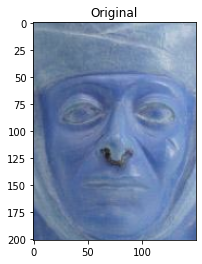

201 150
(225, 176, 375, 377)
225 isss [ 0.0613786  -0.00739282  0.01893267 -0.1375729  -0.00371104  0.11960164
 -0.04270893 -0.06477195 -0.0797555   0.01712379  0.029567   -0.00917005
  0.04064566  0.08762664  0.13016737 -0.08329477 -0.04388917  0.01885885
  0.11456114 -0.03755878  0.00444734  0.22942272 -0.11201513  0.03633964
 -0.05810163  0.14914127  0.04972976 -0.09082168  0.00294871  0.11160365
 -0.1101592  -0.09461635 -0.04913849 -0.05825643  0.14951587  0.08791295
  0.04078533 -0.0345546   0.07068773  0.03280585 -0.02898495  0.02947467
 -0.10207703  0.05405254 -0.05107038  0.18536973  0.07044031  0.00092728
 -0.10565751 -0.10859464  0.02996552  0.03119038  0.07276213  0.05979516
  0.0612254   0.04768258 -0.01808026  0.08140343 -0.05410782 -0.02564556
  0.04234023 -0.00491323  0.08757392  0.04261957  0.01291441 -0.07749658
  0.11095101  0.10654293  0.13415077  0.01473391  0.09622103 -0.01467212
 -0.0082824  -0.18430585  0.02429715  0.06417456 -0.20449683 -0.00207281
  0.0673085  

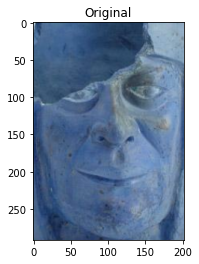

292 202
(194, 99, 396, 391)
194 isss [ 0.04687272  0.05129218  0.07170965 -0.13973303 -0.06364202  0.00744512
 -0.04027166  0.0155502  -0.05526033  0.03321489  0.00499426 -0.1479943
  0.02238754  0.16590789  0.22375172 -0.07255033  0.02351033 -0.14167568
  0.1507307  -0.06698921 -0.0491485   0.16430883 -0.00049503 -0.03788202
 -0.03564756  0.07997172  0.00582096 -0.03217376  0.0699141  -0.00408061
 -0.05361373 -0.11101527 -0.00967334 -0.0515465   0.04787664  0.07729475
  0.09655103  0.1114656   0.09345194  0.13321932 -0.10358573  0.07600403
 -0.19364753 -0.11883855  0.0106802   0.2651399  -0.01924876 -0.01657714
 -0.03258819 -0.09533041 -0.05123563  0.1877126   0.07187656  0.0621694
 -0.02924838 -0.02150635  0.13455321 -0.0079165  -0.03024304  0.01609348
  0.05025046  0.02557162 -0.04846883  0.02558602 -0.07417538 -0.01356516
  0.16464706  0.1814935   0.21672048  0.02440843  0.07367586  0.00572511
 -0.05915379 -0.06136456  0.12567356  0.02108713 -0.18090753  0.00531074
  0.08940347  0.

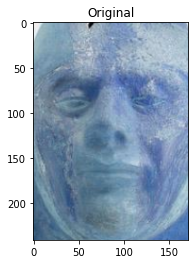

241 172
(213, 134, 385, 375)
213 isss [ 0.06298438  0.0603162   0.07571489 -0.01287085  0.03502771  0.07166625
  0.0702965  -0.11004487  0.01359066 -0.02836141  0.02634191 -0.00935554
  0.01120171  0.07949819  0.05397499 -0.12519424 -0.00379226  0.03145662
  0.03902522 -0.05458276  0.09319637  0.07225171 -0.11525241 -0.05393308
  0.05154819  0.08436286 -0.17280927 -0.01288433  0.1233765   0.11160698
  0.01943634  0.06437756 -0.07672488 -0.07367426  0.14876235  0.00438749
  0.01130382  0.10896343  0.17603175 -0.09092192  0.03064096  0.09074164
 -0.09949749 -0.04032863 -0.07017044  0.02794783 -0.03369161 -0.02006924
  0.00970204 -0.1737201  -0.07117013  0.2486864   0.0663961   0.04094993
  0.04395159 -0.03124797  0.01367608  0.06778974 -0.15285562 -0.08766386
  0.0084575  -0.03666373  0.11178153  0.01889537 -0.01573493  0.04143742
  0.13851294  0.06149792  0.04010271  0.03857635  0.13218726  0.02826749
 -0.00487492 -0.03326518 -0.02196116 -0.0098992  -0.13988197 -0.11845592
  0.06658536 

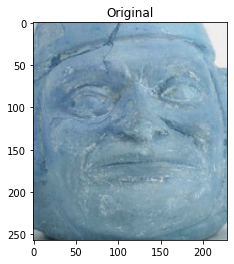

257 229
(188, 131, 417, 388)
188 isss [ 0.04568577  0.04903125  0.15324648 -0.08270221 -0.01870685  0.03433166
  0.00186884 -0.03215674 -0.02682412 -0.04067667  0.03764849 -0.06541025
 -0.05970524  0.190693    0.12712295 -0.05627262  0.04646674 -0.06310177
  0.12314381 -0.08926954  0.01134016  0.24310191 -0.15367705  0.03949435
  0.00152098  0.06676136  0.04479673  0.11904879  0.10724558  0.07845797
 -0.10152994 -0.19040097 -0.03552258 -0.05526352  0.09263469  0.11815222
  0.01937052 -0.05795004  0.02639732  0.0651897  -0.08046304  0.12522568
 -0.04583054 -0.04842214  0.06486172  0.22948153 -0.00864293 -0.06038469
 -0.04656695 -0.11038037  0.00085449  0.17288402 -0.01032572  0.03158384
  0.08249156  0.05093854 -0.05636813  0.0791463  -0.07258511  0.08749621
  0.05826894  0.0014493   0.01822046  0.0301164  -0.00495644 -0.05197037
  0.10482696  0.05183807  0.09947323  0.14092526  0.13635992  0.01327135
 -0.00778493 -0.12294028  0.04816357  0.07870045 -0.07066455  0.079778
  0.03243893 -0

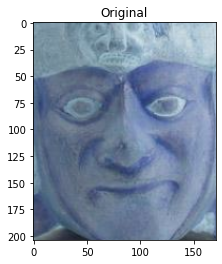

204 171
(229, 195, 400, 399)
229 isss [ 1.27522439e-01  1.88733675e-02 -3.58723588e-02 -1.42125890e-01
 -2.41201837e-02  1.33215010e-01  9.16328840e-03  4.61039133e-02
 -5.68362838e-03 -7.61386678e-02  1.37704033e-02  2.76345406e-02
  4.76628058e-02  8.28437805e-02 -1.33095235e-02 -1.22709356e-01
  1.44410320e-02 -1.06798038e-01 -2.50498876e-02 -1.27245504e-02
  7.83259235e-03  2.07945436e-01 -1.30817899e-02  3.85173932e-02
 -1.04455456e-01  6.62793592e-02  1.43278211e-01 -2.00226103e-04
 -2.78081279e-02  5.09754233e-02 -1.18791968e-01 -1.75844446e-01
 -1.84469707e-02  3.70441228e-02  8.66111275e-03 -3.08303144e-02
  5.03437631e-02  1.66745350e-01 -4.00917418e-02  9.71932933e-02
 -7.93980733e-02  9.10877064e-02 -1.28981367e-01  4.78902869e-02
 -8.70246738e-02  6.71179295e-02 -2.23756619e-02 -2.37271581e-02
 -3.01961955e-02  9.29825306e-02  8.01613927e-02  1.21843398e-01
 -1.40049160e-02  1.15832664e-01  1.03041843e-01 -2.49098148e-02
  1.16184128e-04  1.19430065e-01 -3.10772844e-02 -1.

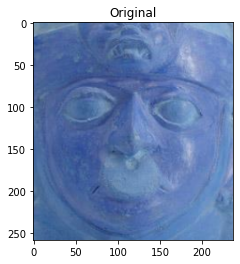

258 237
(202, 109, 439, 367)
202 isss [ 0.17211135  0.02656893 -0.00861828 -0.05014566  0.04711448  0.1527074
  0.07786698 -0.02326078 -0.18184789  0.04970812 -0.01523876 -0.00165852
  0.09656534  0.06952268  0.05176109 -0.04205674  0.08808447  0.05670572
  0.0575101  -0.0163001   0.07425693  0.14757368 -0.05820842  0.06193376
 -0.02212671  0.04600171 -0.03611453 -0.07183322  0.05588822  0.17523618
 -0.17459543  0.01396527 -0.11990372 -0.01911511  0.09742934 -0.07633774
  0.00240374  0.03234137  0.06293683 -0.04562801 -0.07940972  0.03445967
 -0.04871642  0.01470273 -0.09526223  0.1344113   0.03007802  0.00800656
 -0.09639528 -0.04427284  0.1945131   0.09739732  0.04447173  0.05924003
  0.07306743 -0.05331212  0.08784022  0.04946315  0.05111095 -0.08207671
  0.08619894 -0.01246548  0.02678595 -0.04882441 -0.00506231 -0.11551866
  0.07072885  0.10565152  0.02655762 -0.00403662  0.07560603  0.0453237
 -0.01135647 -0.16864364 -0.07176599  0.09186416 -0.0857552  -0.0113837
  0.10329164  0.

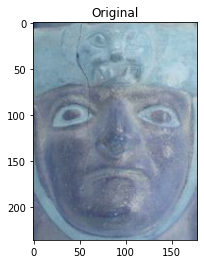

236 178
(216, 99, 394, 335)
216 isss [ 0.054742   -0.049148   -0.00489146 -0.15325579  0.03552181  0.1048983
  0.06156996  0.08389793 -0.12055267  0.08679507 -0.02564066  0.03264493
  0.10024234  0.08247571  0.10432311 -0.13256016 -0.00341031 -0.01125681
  0.13848275 -0.0344016   0.06258509  0.07780905 -0.00116397  0.022454
 -0.04811974  0.07397252  0.00426155 -0.1392558   0.0447411   0.08695877
 -0.06798837 -0.15737483 -0.06272098 -0.08339003  0.08162158 -0.02740598
 -0.0675882   0.11153073  0.02697701  0.0359868  -0.08754028  0.10709228
 -0.20388024  0.07246386 -0.12951045  0.05874038 -0.02047044 -0.02652363
 -0.03562664 -0.08499786  0.01729144  0.06849617  0.01000781  0.00583854
  0.00576113  0.01029498  0.05759032  0.14257003 -0.06546344 -0.03330697
  0.04365946 -0.05663041  0.10204595 -0.0064402   0.06247364 -0.13982525
  0.10123559  0.15408096  0.09425451 -0.01767141  0.1253902   0.11747783
 -0.03185173 -0.14941761 -0.07470213  0.09177698 -0.17802687 -0.02647473
  0.13994661  0.1

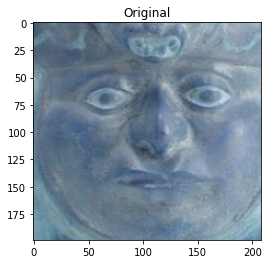

199 208
(188, 145, 396, 344)
188 isss [ 0.04094132  0.03190858  0.17519264 -0.15545347  0.07445937  0.08843721
  0.03652135  0.10002785 -0.08730718  0.02846431 -0.00460057 -0.01133097
  0.00554008  0.1462076   0.15205452 -0.0255725  -0.0215361  -0.01668665
  0.04981463 -0.04889181  0.11048021  0.22121093  0.02180359 -0.00655848
 -0.04739309 -0.00638058 -0.00458265  0.02607149  0.17952606  0.03955306
 -0.13063546 -0.16140142 -0.04331762 -0.05869498  0.05881263  0.01866145
 -0.01560701  0.10213327 -0.01296762  0.11736042 -0.08769909  0.1670258
 -0.14531527 -0.07059512 -0.10677037  0.1379003  -0.01467226 -0.07991885
 -0.05076983 -0.0263656   0.03118954  0.17882308 -0.12625799  0.07968462
  0.03828986 -0.01179839  0.11660274  0.06568778 -0.11860748  0.05384287
  0.05038972 -0.02197133  0.03033105  0.01729881  0.06879913 -0.13028899
  0.06800381  0.12920171  0.08476281  0.17916995  0.16128157  0.14583504
  0.01055414 -0.05165042  0.02030193  0.10307475 -0.13168697  0.04790291
  0.08018016 -

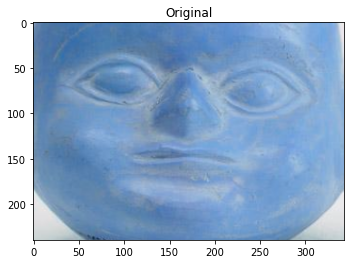

240 343
(135, 113, 478, 353)
135 isss [ 0.07509259  0.03726909  0.02636777 -0.09006733 -0.03250759  0.15461843
 -0.0120381   0.12028962  0.02291086 -0.08163435  0.00955278 -0.0552749
  0.0129553   0.00241032  0.04335214 -0.11864226 -0.10824546 -0.10984926
 -0.05209734 -0.00383904  0.06264552  0.13028835  0.00160296  0.00987849
 -0.04345224  0.02223513  0.02460538 -0.08663568 -0.01058682 -0.03827575
 -0.01549815 -0.18839481 -0.08046485  0.01290364  0.00753796  0.05450226
 -0.02546675  0.1390667  -0.10025024  0.10423466 -0.01274299  0.07660425
 -0.17793648  0.11288667 -0.07794608  0.02941216  0.0258943  -0.03144569
  0.00106906  0.08395023  0.01237549  0.12533669 -0.06101574  0.09374237
  0.09873884 -0.04714533  0.02514997  0.04285062  0.05636766 -0.19756955
 -0.03325707 -0.05869328  0.095566    0.00495036 -0.06302028 -0.17722085
  0.1915349   0.12106804  0.17995995  0.13721427  0.1372758   0.09929704
  0.07657982 -0.04129204  0.02014193 -0.00590667 -0.21634795  0.04286756
  0.0256434   

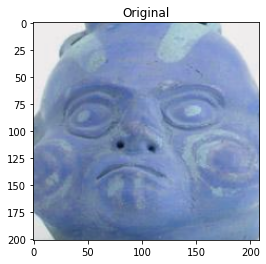

201 209
(192, 166, 401, 367)
192 isss [ 0.02308865  0.1345015   0.05662686 -0.10176302 -0.00100037  0.0481712
  0.06232073 -0.01744164 -0.05913028  0.10330339  0.05337292  0.01554379
 -0.03471872  0.11817509  0.15122464 -0.06483827  0.02905066 -0.02052259
  0.12695777 -0.0716425  -0.04576584  0.18272722 -0.02409496  0.08041558
  0.00897602  0.07852974  0.12432604  0.02698655  0.20136462  0.09036251
 -0.06946144 -0.09736001  0.01768558 -0.033033    0.02498915  0.01882175
  0.0130612   0.11608266  0.02624193  0.14449452 -0.0747944   0.08728538
 -0.08675443  0.03331653 -0.10411989  0.12918977  0.06703834 -0.07434504
 -0.0695713  -0.05370294  0.07420443  0.21025653 -0.0937548  -0.00388192
  0.06378141  0.09307405  0.00072664  0.20050494 -0.08412014  0.06677355
 -0.10490744 -0.12606232  0.16347644 -0.07116085  0.09336387 -0.06576248
  0.05043096 -0.01287445 -0.04215049  0.20737505  0.07689058  0.10099459
 -0.05095187  0.07337345  0.08040196 -0.02480287 -0.05175496  0.07928727
  0.02580847 -

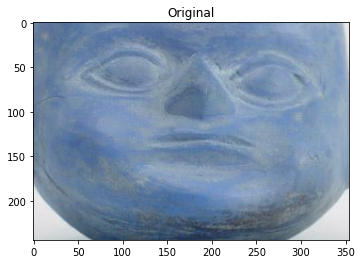

244 354
(130, 102, 484, 346)
130 isss [ 0.04582633  0.04581776  0.12283909 -0.11046597 -0.10404782  0.05348653
 -0.04351135  0.0695565  -0.02786067  0.00205496  0.03304834 -0.09231865
  0.01698033  0.1505751   0.1450612  -0.06029524 -0.05560049 -0.08856073
  0.04142145 -0.04788971  0.04180885  0.2228221  -0.03241486  0.0691006
 -0.0817439   0.07419951  0.05488703 -0.02548724  0.04022522  0.04947082
 -0.1431687  -0.14663512  0.00663661  0.02612145  0.03928965  0.07443269
  0.07273671  0.14168365 -0.04355406  0.12989376 -0.11186676  0.05891163
 -0.13004325 -0.04280803  0.00895279  0.14848745  0.04350203 -0.0505148
 -0.0473703   0.01569497  0.07368505  0.15968391 -0.00791714  0.14482968
  0.1415657   0.00839259  0.08955532 -0.02566329  0.01669658 -0.09322462
  0.01868818 -0.05611458 -0.02558702  0.02902121 -0.0661204  -0.08344454
  0.16022824  0.11375801  0.17081138  0.11273064  0.080187   -0.0108345
 -0.00413869 -0.06471669  0.1267166   0.01639187 -0.1719371   0.04706382
  0.07182898  0.

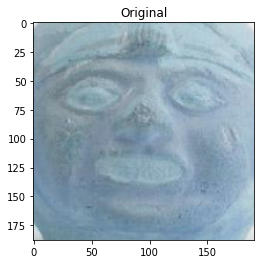

188 191
(201, 196, 392, 384)
201 isss [ 0.07350737  0.10063819  0.1771166  -0.04614634  0.05147618  0.1065836
  0.0332711  -0.13684036  0.04596383 -0.04147666  0.01768004 -0.03671637
 -0.00724835  0.13532831  0.11524914 -0.03266071 -0.03006753  0.00051681
 -0.10127605 -0.12274731  0.02954475  0.19672002 -0.10325516 -0.00542598
  0.06190937  0.00893157 -0.0682536   0.09682033  0.08533005  0.08836558
 -0.04125302  0.08958064 -0.10149511 -0.01353966  0.0749965   0.01347547
  0.04405239  0.02544277  0.1284392   0.00896665  0.05266513  0.03096443
 -0.03449742 -0.16928676  0.00245777  0.11097845 -0.07859645 -0.02700099
 -0.06504027 -0.16455595  0.04769154  0.19243528  0.06924885  0.04690314
  0.00793909 -0.0138136  -0.00667243  0.03913196 -0.11014703 -0.02253427
 -0.01807446  0.00594953 -0.02075477  0.01958846 -0.05032343  0.15235484
  0.09893667  0.16461617  0.00810561  0.10436232  0.10314473  0.02585378
  0.01318811 -0.10902645  0.09983782  0.0992145  -0.128178   -0.14183287
 -0.01405427  

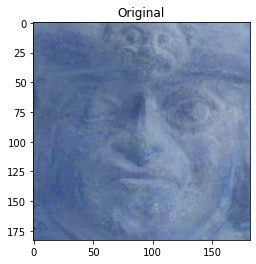

183 182
(213, 128, 395, 311)
213 isss [ 0.10532701  0.05452475  0.10295797 -0.16834871  0.0213307   0.03840989
  0.07231263  0.09936489 -0.0887228   0.02842949  0.01727149 -0.09519122
  0.04385148  0.20767751  0.20756929 -0.08082186  0.08194858 -0.06519158
  0.06143085 -0.05425718  0.04171282  0.23619547 -0.04457534 -0.04745229
 -0.05446341  0.02221993 -0.0080638   0.06225672  0.14911371  0.06784721
 -0.14387178 -0.07797328 -0.01438039 -0.00624453  0.05440909  0.01637506
  0.08652039  0.12370068  0.02879784  0.0885997  -0.07575441  0.12836862
 -0.11593414 -0.0699886  -0.05860117  0.22999947 -0.03283052 -0.03495841
 -0.04164352 -0.04980027  0.00066123  0.22853684 -0.06549557  0.09862144
  0.03368924 -0.02606898  0.08350159  0.01306506 -0.08753195  0.02392465
  0.03149303 -0.04233944 -0.02984365  0.00763285 -0.03897019 -0.07364977
  0.12109239  0.15213273  0.13151781  0.08402653  0.1414982   0.02693548
 -0.02488452 -0.07904617  0.04969771  0.08210175 -0.10737066  0.02201781
  0.07628009 

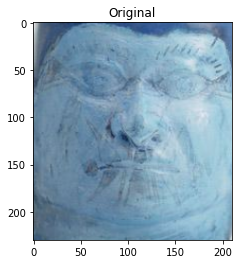

230 210
(189, 146, 399, 376)
189 isss [ 4.53077592e-02  4.74588722e-02  9.54270288e-02 -9.28571522e-02
  5.83022721e-02  7.28087202e-02  2.69692317e-02  1.10348538e-01
 -1.81088656e-01  1.26577169e-01 -1.32869240e-02 -4.93073836e-02
  1.77945197e-02  1.52909920e-01  2.51117676e-01 -7.37042874e-02
  1.51546940e-01  2.01377575e-03  2.28474617e-01 -6.59120232e-02
  2.75562126e-02  1.50706679e-01  1.93112588e-03  1.30209038e-02
  4.26674709e-02  1.71208773e-02 -1.00911669e-02  6.88040815e-03
  1.46619678e-01  4.42521945e-02 -4.39986177e-02 -1.48239657e-01
 -6.97672134e-03 -7.33032525e-02  6.90974072e-02  2.90476158e-02
  4.72911168e-03 -6.99225301e-03  1.62948240e-02  6.10232726e-02
 -5.75845949e-02  1.37440354e-01 -7.41015747e-02 -2.46111141e-03
 -1.28701419e-01  1.51205882e-01  2.53346208e-02 -5.98505698e-02
 -2.97844242e-02 -7.95719922e-02  9.94531512e-02  1.67884976e-01
 -6.31449372e-02 -3.32175638e-03  3.03857606e-02  2.71837916e-02
  8.73900950e-02  5.75606823e-02 -7.54645516e-05  3.

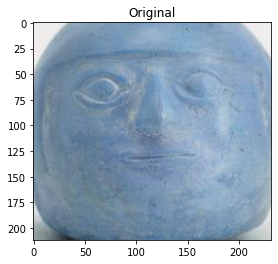

212 232
(183, 176, 415, 388)
183 isss [ 0.00781459  0.09256962  0.03077892 -0.13906144 -0.01386948  0.16114886
  0.06068888  0.09664689 -0.14370336  0.15579374 -0.0070239  -0.12066793
  0.03144725  0.07353184  0.2405058  -0.17245765 -0.04738155 -0.00088805
  0.13386658 -0.10510937 -0.10042913  0.06937607  0.07717412 -0.179514
 -0.00589363  0.00761846 -0.04296021 -0.04331351  0.07345152 -0.08590541
 -0.01607384 -0.11168376 -0.05035651 -0.07520908  0.08608367 -0.00031894
 -0.02694049  0.11104606  0.03177598  0.06652466 -0.03407833  0.0415164
 -0.21506593  0.01877332 -0.21948747  0.10009329 -0.05058524  0.01182566
 -0.08331782 -0.0682022  -0.03638605  0.17612118 -0.02606391  0.01115567
 -0.13451049 -0.00506678  0.08509318  0.03723999 -0.03661732 -0.02661812
 -0.06549787  0.00997561  0.07993186 -0.06146067  0.07981262  0.04161118
  0.11027229  0.13233526  0.04177418  0.09639367  0.11664948  0.12113207
  0.03802429 -0.01089475 -0.00575406 -0.01318015 -0.18672629 -0.12505563
  0.09638117  0.

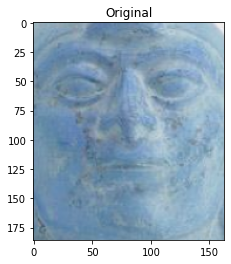

186 163
(216, 181, 379, 367)
216 isss [ 0.07828075  0.19049487  0.16292298 -0.04455275  0.04268     0.17397393
  0.03945457 -0.00160617 -0.02452814 -0.0079262   0.04889186 -0.04460502
 -0.02804864  0.04321907  0.0898536  -0.07416147 -0.05277352  0.03717545
 -0.0560381  -0.12514558  0.11625631  0.1693428  -0.01957103 -0.09451757
  0.06131221 -0.12219235 -0.06424969  0.06702305  0.09351338  0.09831717
 -0.08231361 -0.12423233 -0.07345909 -0.02031983  0.09921718 -0.04354484
  0.01327896  0.00348908  0.02720887  0.04726594 -0.06059806  0.0813221
 -0.07791807 -0.04223838 -0.11059105  0.08518708 -0.03289878 -0.0738761
 -0.078711   -0.01780812  0.09834743  0.23229404 -0.12492286  0.08223122
 -0.03878491 -0.04305128  0.03482948 -0.04293991 -0.12812646 -0.01890411
  0.05062474 -0.05560219  0.02025943 -0.06102332  0.06850661 -0.08147035
  0.08303882  0.11491271  0.00913429  0.2243143   0.16589136  0.12134956
  0.04352043 -0.12486017 -0.02494938  0.09259739 -0.11507828 -0.03840701
  0.00505948  0

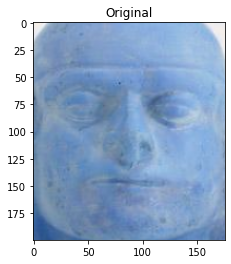

200 176
(207, 186, 383, 386)
207 isss [ 0.03861912 -0.03655844  0.09465659 -0.13601473 -0.00945832  0.02973127
  0.0029275   0.06777851 -0.10146382  0.05846803  0.0176187  -0.03797377
  0.05023773  0.15448582  0.1971121  -0.08447028 -0.00239276 -0.03696829
  0.12073681 -0.01949634  0.00741791  0.17658669  0.02278872 -0.00346482
 -0.05649456  0.10621148  0.02931326 -0.08609014  0.0455424   0.01395437
 -0.07518362 -0.15705316 -0.02980306 -0.04979131  0.05301129  0.05898134
 -0.01411696  0.16907273  0.00365725  0.145976   -0.09291012  0.14276014
 -0.21927124  0.03018738 -0.11058653  0.1491727  -0.0043026  -0.07319708
  0.01015633 -0.03792378  0.04353353  0.11153812 -0.07048832  0.0604637
  0.02683386 -0.01838658  0.09108461  0.07887941 -0.00202152  0.03021454
  0.01738482 -0.09780548  0.01229662  0.02474744  0.03641154 -0.19609618
  0.1376137   0.14988534  0.17291227  0.10735954  0.16403677  0.12801279
  0.01945626 -0.06112455 -0.0057191   0.02171442 -0.20760955  0.05105517
  0.07213388  

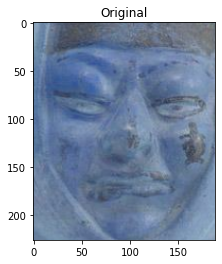

226 189
(207, 107, 396, 333)
207 isss [ 0.06508339  0.1721102   0.2233691   0.0440466   0.02166185  0.11407898
  0.03089844 -0.10682663  0.1173701  -0.03621554  0.05917942 -0.04022941
 -0.07434001  0.03915312  0.10021564 -0.10312182 -0.02296323  0.10892304
 -0.09896918 -0.17285773  0.09795492  0.18364841 -0.11602306 -0.02618831
  0.10162476 -0.13868451 -0.09573615  0.12114801  0.01818508  0.13062915
  0.01231002 -0.01250418 -0.05549495  0.0245778   0.15545534 -0.01086293
  0.05888956 -0.09490156  0.04816097 -0.02313606  0.00909813  0.05088689
  0.00812684 -0.05310952  0.00391343  0.01684327 -0.06368946 -0.02594233
 -0.00373611 -0.04935752  0.12921649  0.19794506 -0.04826317  0.034158
 -0.00705465 -0.00033116 -0.0560621  -0.09751667 -0.09905867 -0.02650509
  0.05372908 -0.06783831 -0.07611455 -0.03200841  0.00068632 -0.03852363
  0.10363363  0.0225652  -0.03327417  0.25335914  0.1358128   0.03800116
  0.04677714 -0.11707609 -0.08751211  0.01989017 -0.07974144 -0.05456284
 -0.04103566 -0

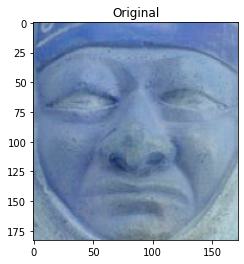

183 172
(208, 118, 380, 301)
208 isss [ 0.01468024  0.21900697  0.15785134 -0.01660266 -0.05642015  0.07411125
 -0.02557881 -0.02214969  0.0695199  -0.04083433  0.09151279 -0.06782249
 -0.1057634   0.0153132   0.03781224 -0.04203925  0.02155489 -0.04588781
 -0.01042674 -0.08720049  0.03961756  0.19347474 -0.19077569  0.0860741
  0.03400379 -0.0425187   0.0672128   0.12868422  0.12474233  0.08510254
 -0.05564309 -0.15831155 -0.01711956  0.00647055  0.04257552  0.08451926
  0.09681617 -0.12631711 -0.0124216   0.09765255 -0.02183126 -0.00716537
  0.00907952 -0.02405356  0.11837299  0.19042552  0.05932016 -0.07323156
 -0.09582241 -0.07386571  0.06711295  0.23975533 -0.0804472   0.03704815
  0.06481483  0.04994873 -0.08553088 -0.06017024 -0.05972802  0.0165665
  0.02876054 -0.05658644 -0.01509022 -0.01427537 -0.03734414 -0.12306726
  0.124817   -0.04019838  0.04375467  0.19432482  0.0831171  -0.03640904
 -0.01959954 -0.11465959  0.1147615   0.0628401  -0.04431692  0.23140652
 -0.04739433 -0

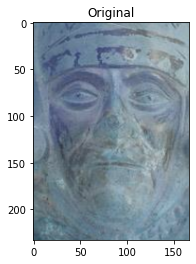

233 167
(221, 146, 388, 379)
221 isss [ 0.05674322  0.06807128  0.10328702 -0.04822815  0.02590811  0.06064448
  0.01517553 -0.13692431  0.08818233 -0.026376    0.04772508 -0.03337148
 -0.01142466  0.21395922  0.03803339 -0.04773852  0.0260549  -0.01141729
 -0.0105145  -0.08867657  0.04573508  0.19147927 -0.08341563  0.03324774
 -0.01834494 -0.02091059 -0.01413235  0.14218357  0.10339163  0.13178287
 -0.08330254 -0.0751252  -0.0337392  -0.07878201  0.07979695  0.08004946
  0.02549181  0.02221882  0.03764333  0.04758862 -0.09264673  0.12130498
 -0.10098483 -0.13828701  0.02943105  0.14498438 -0.11572652  0.01281398
  0.05308749 -0.12028188  0.03262208  0.25966653  0.02097539  0.04410008
  0.04375194  0.0098472   0.02448179  0.03727245 -0.12258718  0.06312026
  0.03804703  0.01234641  0.03451775  0.03019975 -0.03370621 -0.01953805
  0.09703922  0.14879055  0.03241691  0.15096132  0.1622824   0.01573188
  0.00614922 -0.12625398  0.03766931  0.13307111 -0.06185408 -0.02875357
  0.0012793  

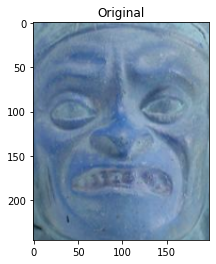

245 198
(194, 106, 392, 351)
194 isss [ 0.04372092  0.05130366  0.10547435 -0.06661446 -0.04490228  0.05828381
  0.04337122 -0.00053197 -0.10619345  0.03519843  0.07353188 -0.00957783
  0.00921355  0.13928191  0.068599   -0.12503807  0.03068962  0.06746876
  0.13451913 -0.07593715  0.05372324  0.17362045 -0.09766693  0.03149086
 -0.05629094  0.07752457  0.02213251 -0.00874483  0.12548628  0.11519448
 -0.13167588 -0.1342173  -0.04338752 -0.10085241  0.09693287  0.01693289
 -0.03068418  0.04077957  0.00916444  0.12086691 -0.10301465  0.11957806
 -0.17477521  0.05801992 -0.0708245   0.12741007  0.03361465 -0.10177457
 -0.07089805 -0.13369162  0.09223802  0.21834187 -0.07657409  0.05005516
  0.01295688  0.04321013  0.04534935  0.08485354 -0.05474479  0.05518261
  0.06596492 -0.06651001  0.0776804   0.01034419  0.06704579 -0.19974308
  0.1611819  -0.01140643  0.07664596  0.16234972  0.14750212  0.03115512
  0.03798629 -0.07355444 -0.04512573  0.0210109  -0.14566444  0.07961404
  0.03205908 

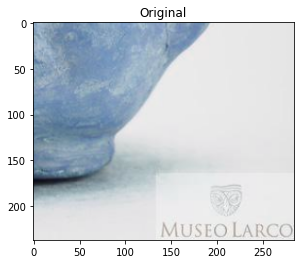

237 284
(316, 212, 665, 509)
316 isss [ 9.21915695e-02 -7.40664303e-02 -4.18101959e-02 -1.35073021e-01
  1.59100413e-01  1.19126320e-01  9.43158641e-02  7.97244236e-02
 -8.89382958e-02 -3.60040218e-02 -6.32707179e-02  7.57544786e-02
  1.65749446e-01 -2.71121245e-02  1.93192922e-02 -6.72435239e-02
 -7.35300332e-02  5.71055803e-03 -1.61389828e-01  1.84848472e-01
  1.45729825e-01 -4.18764167e-02  9.75808576e-02  2.87029613e-02
 -1.03916109e-01 -2.42873076e-02 -1.52053207e-01 -1.66921362e-01
 -1.34193746e-03  2.22988557e-02 -5.28896786e-02  7.70476367e-03
 -9.46338996e-02  5.44714294e-02  1.18642859e-02 -3.73794674e-03
 -7.93154910e-02  2.13648096e-01 -1.07292473e-01 -6.39787689e-02
  3.86642888e-02  5.87733164e-02 -9.96136963e-02  8.30582976e-02
 -1.91943169e-01  2.87983785e-05  4.14542072e-02  7.36596286e-02
 -6.77016899e-02  8.91389400e-02 -5.93085401e-02 -1.19513921e-01
 -8.05513412e-02  4.53156233e-02  9.28516090e-02 -6.23997487e-02
 -3.09523214e-02  1.53642505e-01 -5.97756170e-02 -1.

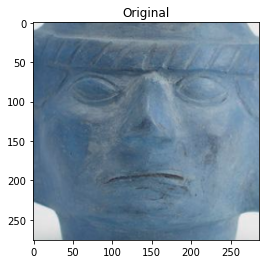

276 286
(150, 74, 436, 350)
150 isss [ 0.09487743  0.09754407  0.1091204  -0.0613578   0.0717883   0.17564513
  0.02134497 -0.03000825 -0.01706015 -0.06210141  0.00412488 -0.0328277
  0.01956735  0.100766    0.07943285 -0.12997806  0.01361086 -0.04580085
 -0.01861929 -0.06938572  0.06486999  0.1227219  -0.01225423 -0.05668216
  0.07702614 -0.03309014 -0.03179117  0.06449226  0.06899082  0.0338597
  0.01729392 -0.07478993 -0.08912534 -0.0093627   0.05742183 -0.02723115
  0.0407354   0.0996075   0.09451101  0.00945417  0.04254328  0.05551708
 -0.11176988 -0.10207308 -0.12195501  0.04512896 -0.10032296 -0.02031273
  0.02390117 -0.07767827  0.03221406  0.24277802  0.01651156  0.08652827
 -0.01651085 -0.05307298  0.07126827  0.01987002 -0.11488151 -0.0833137
 -0.0074686  -0.01803786  0.02951905 -0.06014096 -0.00304247 -0.00880649
  0.14599134  0.16203478  0.03898947  0.13462533  0.13383958  0.08468675
  0.00315723 -0.0969924   0.05365075  0.09294333 -0.11780809 -0.06603335
  0.03841104  0.1

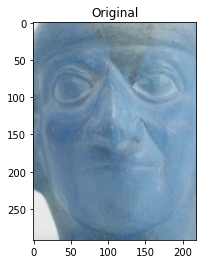

292 219
(175, 80, 394, 372)
175 isss [ 0.04894797  0.21609396  0.11122421 -0.04859079 -0.01677934  0.20506912
 -0.05199613  0.02461057 -0.09345087  0.12199345  0.09819221 -0.07044593
 -0.01444645  0.01691316  0.16505194 -0.05468068  0.01851454  0.10537129
  0.06951449 -0.12192884  0.04462421  0.18622054  0.00381698 -0.0262105
  0.04559809 -0.0952649   0.07144582  0.02989056  0.08703031  0.07500469
 -0.08416314 -0.1890885  -0.03112487 -0.01716211  0.09301796  0.00042341
  0.02606559 -0.07580692  0.01674273  0.11739493 -0.10891168  0.02568486
 -0.08869541 -0.00433506 -0.10657234  0.0540862   0.03623067 -0.04725751
 -0.11925089 -0.00270208  0.20709847  0.1877216  -0.14467272  0.04520586
 -0.0922557   0.03573138  0.04829454 -0.07544146 -0.02562764 -0.00744012
  0.01457457 -0.07756776  0.01113485 -0.12938225  0.09025718 -0.12916552
  0.0884994   0.0512276  -0.01252838  0.24515665  0.10297677  0.11548366
  0.01664249 -0.15098995 -0.0289566   0.03458666 -0.10205126  0.06808008
  0.00295446 -0

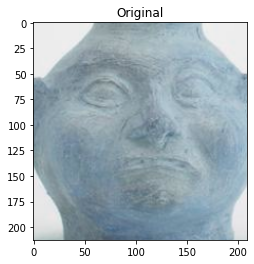

213 209
(192, 168, 401, 381)
192 isss [ 0.05398772  0.14160435  0.08131179 -0.12005203  0.0456209   0.13834392
  0.00734834 -0.03708247 -0.12340324  0.03033849  0.02897587 -0.0309979
 -0.03203507  0.17468996  0.20135675 -0.11504345  0.00221558  0.02821202
  0.11243267 -0.07857667 -0.05099795  0.22253102 -0.05749361 -0.03832983
  0.04993143  0.016459    0.06112696  0.12754941  0.126476    0.074539
 -0.09960127 -0.07295755 -0.00599482 -0.02866416  0.07094249  0.06369256
 -0.01062872 -0.08815115  0.03988933  0.03309898 -0.00638996  0.03535655
  0.02309369  0.01518594 -0.12963453  0.1683144   0.04670166 -0.02170313
 -0.15757    -0.03819242  0.02754096  0.16518664 -0.02924664  0.01737552
  0.01199872  0.06900369 -0.09086928  0.12242997 -0.09642456  0.02763912
 -0.06638195  0.02165829  0.10769839 -0.01657544  0.01847999  0.09773565
  0.04377683  0.01992389 -0.05000871  0.16875234  0.10067736  0.03258627
 -0.00180374 -0.05574564  0.05591765  0.03790298 -0.07150269 -0.10782426
  0.02880827 -0.

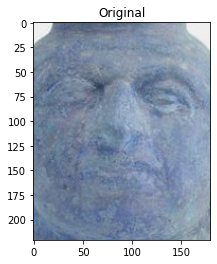

221 180
(206, 122, 386, 343)
206 isss [ 0.01474395  0.16918151  0.0936406  -0.10489415 -0.03010066  0.05157398
  0.03548181 -0.02544998 -0.0602965   0.04956043  0.06965162 -0.09571546
 -0.01962492  0.17370369  0.13720532 -0.10344176  0.0794934  -0.02595737
  0.08762993 -0.10825773 -0.06636976  0.21280977 -0.19412969 -0.02586568
 -0.01288011  0.04273393 -0.00245394  0.1675894   0.19623668  0.07587067
 -0.08896342 -0.04031308 -0.06930047 -0.05527814  0.03777859  0.08613007
  0.04104415 -0.0708335   0.06871869  0.12485553 -0.0097203   0.05978592
 -0.07384953 -0.05784702  0.03319866  0.22306764 -0.00609749 -0.01272502
 -0.08699562 -0.1857884  -0.00324914  0.29162216 -0.05318748  0.00644901
 -0.0392569   0.05696069 -0.05885386  0.05467415 -0.08392078  0.10518541
  0.00590754  0.01933172  0.01398093  0.02127433 -0.05751281  0.00931014
  0.15706493  0.01938964  0.06362867  0.10517008  0.11233229 -0.02335649
  0.01869465 -0.02933325  0.08175039  0.02692154 -0.06554753  0.06206602
  0.00677869 

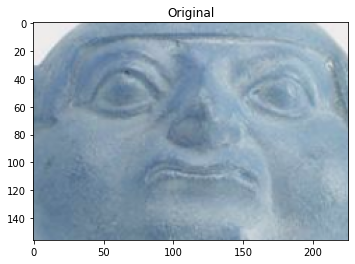

156 226
(191, 175, 417, 331)
191 isss [ 0.03070484  0.024109    0.1399481  -0.10117855 -0.06255481 -0.00893641
  0.01661277 -0.01933352  0.02916491  0.03193142  0.09895982 -0.06427597
  0.02904367  0.24023607  0.15822493 -0.05776834  0.01046017 -0.057739
  0.05064915 -0.10023802  0.0306657   0.22400728 -0.10125441  0.02456332
 -0.05202431  0.07139412  0.03966013  0.08073385  0.06832132  0.10397498
 -0.11232985 -0.13177617  0.01780233 -0.02663113  0.05095104  0.11196513
  0.03291164  0.07039955  0.02252527  0.1391223  -0.1277007   0.11253747
 -0.13706174 -0.05634516  0.04376411  0.17057934 -0.07172589 -0.04609181
  0.02893501 -0.12441505  0.03836773  0.20705405 -0.05680107  0.06849084
  0.06130412  0.05716211 -0.00749173  0.0330192  -0.07325337  0.09657403
  0.02392592 -0.10082998 -0.02506709  0.05089191 -0.02073313 -0.08756156
  0.1167895   0.14633013  0.13485311  0.12602119  0.15697826 -0.00529579
 -0.01181754 -0.12771466  0.04930563  0.07502665 -0.1143072   0.03766599
  0.01829435 -0

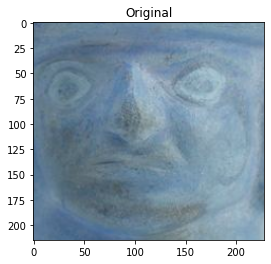

215 228
(192, 129, 420, 344)
192 isss [ 6.05674498e-02  2.00928062e-01  7.57694244e-02 -6.19687326e-02
  2.95018544e-03  8.37554783e-02  9.56321880e-02 -3.39799933e-02
 -9.85605121e-02  1.47484720e-01  7.86970779e-02 -6.72965571e-02
  5.24573214e-02  1.03035994e-01  1.95008039e-01 -1.01502396e-01
  1.90335996e-02  2.99033169e-02  2.89765727e-02 -1.19976811e-01
 -2.36197468e-03  1.29303321e-01 -1.28369093e-01 -6.37565479e-02
  5.59636727e-02 -2.69746315e-02 -7.00329170e-02  5.85460626e-02
  6.74121454e-02  1.66306883e-01 -1.46835893e-01 -1.05076786e-02
 -2.98059694e-02 -1.29529759e-02  7.87960663e-02 -2.05238163e-02
  5.64913005e-02 -4.36395481e-02  7.31532350e-02  1.74801406e-02
 -2.00668983e-02 -2.93224957e-02  6.13061944e-03 -1.98745001e-02
 -7.48563781e-02  2.12894157e-01  1.95568874e-02 -2.31775213e-02
 -1.43497035e-01 -1.32262483e-01  1.28103957e-01  1.96799919e-01
 -7.94561729e-02  3.72449644e-02  2.99061593e-02  2.72620264e-02
 -6.33516237e-02 -4.28905487e-02 -4.81167845e-02  3.

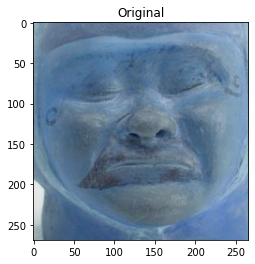

269 266
(165, 123, 431, 392)
165 isss [ 0.04793578  0.13133214  0.22099584 -0.01306644  0.0508912   0.20492622
  0.021403    0.03306713  0.03771067 -0.02737463 -0.01956481 -0.01415064
 -0.10894299 -0.01951012  0.148287   -0.08430862 -0.04216748  0.00663219
  0.01385833 -0.17006953  0.1313233   0.16956428 -0.07387152 -0.01540139
  0.13286367 -0.06489018 -0.04092765  0.0153873   0.06219317  0.04870614
  0.0259914  -0.07535009 -0.06402981  0.02398871  0.11425758 -0.00643101
  0.02075464 -0.10433055  0.03039706 -0.02372777  0.03767553  0.01418771
 -0.0228736  -0.05964896 -0.01635949  0.07157652 -0.01314295 -0.10100472
 -0.09283281 -0.05942295  0.10888612  0.19661067 -0.01700302  0.00600123
  0.03795744  0.04393356 -0.00359122 -0.03369561 -0.11569035 -0.06050578
  0.05971976 -0.05529345 -0.03096281 -0.08594327  0.08738825 -0.04964896
  0.0637411   0.05805462 -0.01493783  0.28268108  0.07417596  0.10946207
 -0.05140706 -0.15178892 -0.01850252  0.08104251 -0.09331051  0.01984727
  0.01003353 

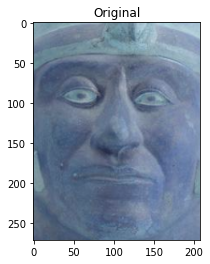

271 208
(199, 100, 407, 371)
199 isss [ 0.08524381  0.04459088  0.07627518 -0.06935241 -0.03313921  0.04802152
 -0.02982454  0.06746825 -0.11330698 -0.0443351   0.03834068 -0.01784533
 -0.01121338  0.18082465  0.07666105 -0.06867047  0.12082215 -0.07038761
  0.1291391  -0.01875457  0.03441641  0.22527072 -0.08650312  0.06213373
 -0.00733908  0.06727105  0.11426328  0.06450509  0.04682788  0.07925534
 -0.14666641 -0.19121502  0.00049801 -0.00752632  0.01250714  0.03857084
  0.04257056  0.05710193 -0.0318041   0.10221978 -0.08918849  0.14148259
 -0.03957932  0.00443653 -0.0074387   0.16380122  0.05195339 -0.12468964
 -0.0552006  -0.02871164  0.13195224  0.16392526 -0.05587542  0.09820484
  0.13103278  0.01408102 -0.00271048  0.05849029  0.0155519  -0.02129976
  0.0362787  -0.06215788  0.00382708 -0.03747796  0.00562807 -0.13706622
  0.13456625  0.0661236   0.10180773  0.12482528  0.14466085  0.0229511
  0.01601525 -0.10204045  0.05791607  0.07242618 -0.07845363  0.1016841
  0.03472456  0

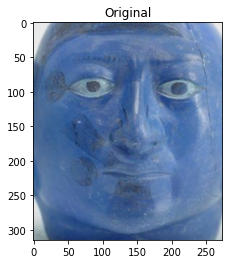

315 274
(169, 85, 443, 400)
169 isss [ 0.06407616  0.13984263  0.07471663 -0.00151416  0.02430342  0.1212801
  0.07032211 -0.07374432 -0.03117914  0.10371937  0.09054085 -0.0266735
 -0.01770769  0.0709644   0.18673405 -0.12141065  0.00103684  0.08424917
  0.1023325  -0.18750767  0.04649466  0.13256042 -0.06787723 -0.07342848
  0.11525255 -0.0528896  -0.04363591  0.00676365  0.05589273  0.16331442
 -0.03704172 -0.06644496 -0.04402415 -0.05415938  0.13554536 -0.03531173
 -0.00778768 -0.06969592  0.10228346  0.04017725 -0.02731243  0.05058361
 -0.07653619  0.02798981 -0.12670547  0.06412701 -0.0494877  -0.05712368
  0.00209778 -0.13074245  0.15070893  0.22970082 -0.0511507   0.00085795
 -0.04412767  0.03973329  0.00821084 -0.01799964 -0.0836693   0.05566762
  0.01732316 -0.1476035   0.00801296 -0.05813919  0.08111162 -0.08243403
  0.08845671  0.06434702  0.02814858  0.1607844   0.14957426  0.1226876
 -0.00063043 -0.17032574 -0.07310897  0.05688455 -0.13918085 -0.06063438
 -0.01893548  0.0

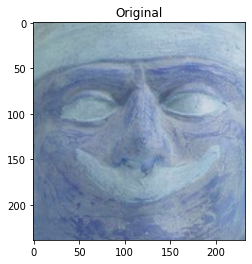

239 233
(171, 100, 404, 339)
171 isss [ 0.10323162 -0.05292141  0.08326336 -0.03409798  0.07831378  0.13809216
  0.12254658  0.00097567 -0.07807633 -0.09281583 -0.01669106  0.17198649
  0.1174062  -0.04093189 -0.0279993  -0.07943153 -0.08488283  0.01708016
 -0.12963457  0.12411834  0.16335472  0.04003185  0.02095903  0.11975451
 -0.07354709  0.01918891 -0.10195013 -0.15885164 -0.01212392  0.14459988
 -0.10451773  0.01480556 -0.06242103  0.09102194  0.03231648 -0.0910508
 -0.03606002  0.21754709 -0.02096862 -0.04060715  0.01118686  0.03005882
 -0.03481203  0.00059358 -0.15825306 -0.09837677  0.05662395 -0.09368035
 -0.07648478  0.09506799  0.07634538 -0.10084169 -0.00101669  0.11059953
  0.15554458 -0.00732363 -0.02547555  0.17510457 -0.12171906 -0.10235354
 -0.0188673  -0.03125368  0.14495182 -0.10605974  0.10319228 -0.06923243
  0.03598114  0.02121259 -0.14571416 -0.03284698  0.04563498  0.05455467
 -0.01088517  0.00457334 -0.04021312  0.08988428 -0.04188247 -0.1533377
  0.12246671  0

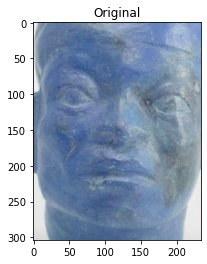

304 234
(179, 79, 413, 383)
179 isss [ 0.08725597  0.05009525  0.10620783 -0.0594436   0.08749919  0.12641291
  0.10413538 -0.03407508 -0.08548217 -0.00454304 -0.02612372 -0.0747932
 -0.05105058  0.09320018  0.24390514 -0.13699837 -0.00168909 -0.04815356
  0.12214594 -0.12464125 -0.02913733  0.17266311 -0.07123172 -0.08607274
  0.09434561 -0.03583375 -0.08940786  0.05268493  0.05733493  0.03122647
 -0.00708107 -0.13501585 -0.09408753 -0.0596267   0.17255571  0.03181871
 -0.01006372 -0.11076565  0.05517287 -0.0775521   0.03474209  0.07696114
 -0.016706    0.01397109 -0.10454947  0.20657948 -0.06505533  0.02831055
 -0.06024155 -0.09250701 -0.04318655  0.0959378   0.0595159  -0.04729225
  0.01351917  0.0013781  -0.105533    0.0967404  -0.0846187   0.05936439
  0.00403571  0.04743479  0.0269928  -0.0239583   0.07892263  0.08404928
  0.03459455  0.0700778   0.00709382  0.06559296  0.13369945  0.09666187
  0.02018453 -0.13166222 -0.04429901  0.07722233 -0.10079125 -0.12584107
  0.08594897  0

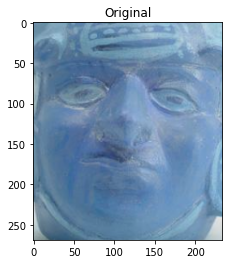

269 234
(193, 131, 427, 400)
193 isss [ 0.10237549 -0.00753639  0.04878285 -0.18641435  0.06087904  0.09345195
  0.0342749   0.15110569 -0.19726625  0.04059315 -0.03227198  0.02765603
  0.08427025  0.11327922  0.12463823 -0.05210968  0.02948321 -0.05925369
  0.05712333  0.02166403  0.06081144  0.1883961   0.00385913 -0.054974
 -0.06808654  0.09596118  0.0604059  -0.02606027  0.04113711  0.03199688
 -0.1910145  -0.13132277 -0.05082517  0.00282711  0.03076551 -0.04085224
  0.01913893  0.15488821 -0.00149201  0.06217052 -0.06224939  0.11197705
 -0.06089365  0.0205166  -0.12719637  0.13965614  0.03811915 -0.07035422
 -0.11639501  0.00763241  0.09035282  0.04693502 -0.10671911  0.12602788
  0.08565082 -0.0385928   0.02538285  0.08296077 -0.0506413  -0.04587393
  0.04892615 -0.07467587  0.04271764 -0.01696336  0.06983104 -0.12128609
  0.05586792  0.18137026  0.10437946  0.02338769  0.12393211  0.09275821
  0.03070679 -0.11162394 -0.00960624  0.1101775  -0.12323499  0.00147676
  0.12028977  0

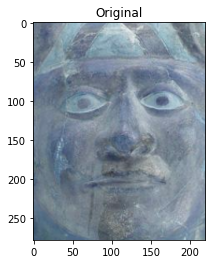

278 220
(194, 97, 414, 375)
194 isss [ 0.05051173 -0.04276742  0.05847865 -0.15203488 -0.05216848  0.17700957
 -0.04232126  0.15323567 -0.08183106  0.01754924  0.03155994  0.02247434
  0.03289225 -0.06657773  0.06840976 -0.12086128 -0.09547316 -0.01883671
  0.05319944 -0.00823108  0.04279052  0.14788413  0.01865925  0.10260872
 -0.09290693  0.13301967  0.12145809 -0.15628774  0.05686683 -0.0795869
 -0.02366952 -0.18938111 -0.06601033  0.00141132  0.02493412 -0.01969737
 -0.04153325  0.15542738 -0.00447048  0.13841891 -0.0146286   0.02479618
 -0.24011217  0.11402033 -0.133924   -0.07475803  0.04821514 -0.03810283
 -0.08369807  0.03726701  0.05246835  0.06431254 -0.04273511  0.07240703
  0.02409854 -0.00103913  0.08035035  0.13046564 -0.03526624 -0.14731045
 -0.04520568 -0.06624937  0.1821441  -0.00537324  0.00813468 -0.15787031
  0.16273482  0.05495615  0.10183509  0.11100508  0.03102736  0.06256923
 -0.00180619  0.03064865  0.02818664 -0.08607358 -0.21212776  0.0544409
  0.08881784  0.

In [ ]:
# initialize the total number of faces processed
total = 0

data = []
# loop over the image paths
for (i, imagePath) in enumerate(imagePaths):
	# extract the person name from the image path
	print("[INFO] processing image {}/{}".format(i + 1,
		len(imagePaths)))
	name = imagePath.split(os.path.sep)[-1]

	# load the image, resize it to have a width of 600 pixels (while
	# maintaining the aspect ratio), and then grab the image
	# dimensions
	image = cv2.imread(imagePath)
	image = imutils.resize(image, width=600)
	(h, w) = image.shape[:2]

	# construct a blob from the image
	imageBlob = cv2.dnn.blobFromImage(
		cv2.resize(image, (300, 300)), 1.0, (300, 300),
		(104.0, 177.0, 123.0), swapRB=False, crop=False)
 	
 	#display(imageBlob)
	# apply OpenCV's deep learning-based face detector to localize
	# faces in the input image
	detector.setInput(imageBlob)
	detections = detector.forward()

	# ensure at least one face was found
	if len(detections) > 0:
		#print("y que ")
		# we're making the assumption that each image has only ONE
		# face, so find the bounding box with the largest probability
		i = np.argmax(detections[0, 0, :, 2])
		confidencia = detections[0, 0, i, 2]
		print(confidencia)

		# ensure that the detection with the largest probability also
		# means our minimum probability test (thus helping filter out
		# weak detections)
		if confidencia > confidence:
			#print("ya estamos locos")
			# compute the (x, y)-coordinates of the bounding box for
			# the face
			boxes = detections[0, 0, i, 3:7] * np.array([w, h, w, h])
			(startX, startY, endX, endY) = boxes.astype("int")
			mandabox = (startX, startY, endX, endY) 

			# extract the face ROI and grab the ROI dimensions
			face = image[startY:endY, startX:endX]
			display_one(face)
			(fH, fW) = face.shape[:2]
			print(fH, fW)

			# ensure the face width and height are sufficiently large
			if fW < 20 or fH < 20:
				continue

			# construct a blob for the face ROI, then pass the blob
			# through our face embedding model to obtain the 128-d
			# quantification of the face
			faceBlob = cv2.dnn.blobFromImage(face, 1.0 / 255,
				(96, 96), (0, 0, 0), swapRB=True, crop=False)
			embedder.setInput(faceBlob)
			vec = embedder.forward()
			print(mandabox)

			# add the name of the person + corresponding face
			# embedding to their respective lists
			d = [{"imagePath": imagePath, "loc": mandabox, "encoding": vec[0]} for (box, enc) in zip(mandabox, vec)]
			[print(box, "isss",enc) for (box, enc) in zip(mandabox, vec)]
			data.extend(d)
			
			total += 1

# dump the facial embeddings + names to disk
print("[INFO] serializing {} encodings...".format(total))
#data = {"embeddings": knownEmbeddings, "names": knownNames}
f = open(embeddings, "wb")
f.write(pickle.dumps(data))
f.close()

In [ ]:
from sklearn.cluster import DBSCAN
from imutils import build_montages

jobs = 1
# load the serialized face encodings + bounding box locations from
# disk, then extract the set of encodings to so we can cluster on
# them
print("[INFO] loading encodings...")
#print(embeddings)
data = pickle.loads(open(embeddings, "rb").read())
data = np.array(data)
encodings = [d["encoding"] for d in data]

[INFO] loading encodings...


In [ ]:

# cluster the embeddings
print("[INFO] clustering...")
clt = DBSCAN(metric="euclidean", n_jobs=1)
clt.fit(encodings)
# determine the total number of unique faces found in the dataset
labelIDs = np.unique(clt.labels_)
numUniqueFaces = len(np.where(labelIDs > -1)[0])
print("[INFO] # unique faces: {}".format(numUniqueFaces))


[INFO] clustering...
[INFO] # unique faces: 2


[INFO] faces for face ID: -1


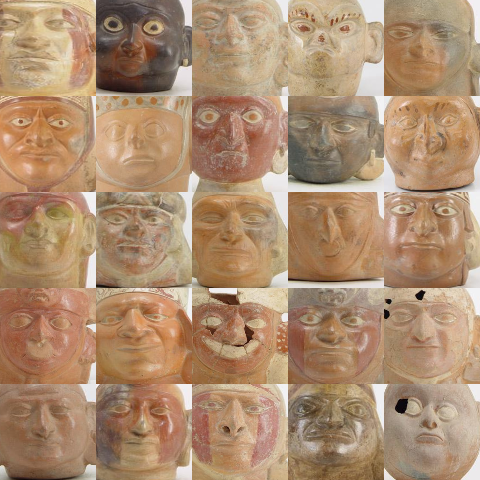

[INFO] faces for face ID: 0


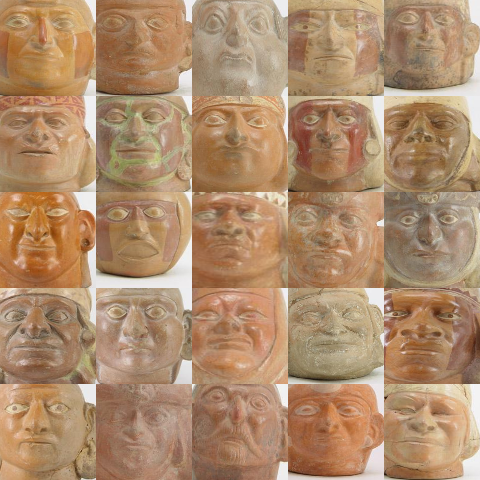

[INFO] faces for face ID: 1


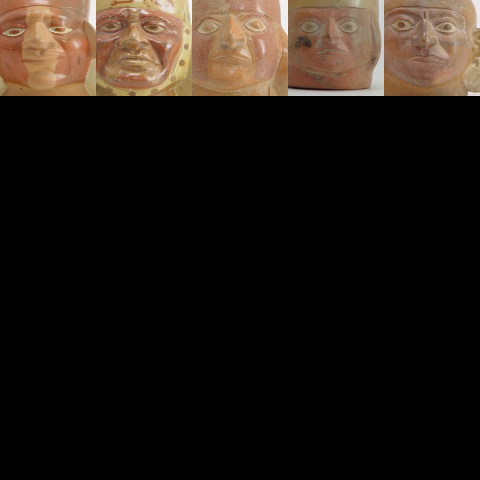

In [ ]:
from google.colab.patches import cv2_imshow
# loop over the unique face integers
for labelID in labelIDs:
	# find all indexes into the `data` array that belong to the
	# current label ID, then randomly sample a maximum of 25 indexes
	# from the set
	print("[INFO] faces for face ID: {}".format(labelID))
	idxs = np.where(clt.labels_ == labelID)[0]
	idxs = np.random.choice(idxs, size=min(25, len(idxs)),
		replace=False)
	# initialize the list of faces to include in the montage
	faces = []
	# loop over the sampled indexes
	for i in idxs:
		# load the input image and extract the face ROI
		image = cv2.imread(data[i]["imagePath"])
		#image = image_temp[20:405,103:463]
		#display_one(image)
		(startX, startY, endX, endY) = data[i]["loc"]

		# extract the face ROI and grab the ROI dimensions
		face = image[startY:endY, startX:endX]
		
		# force resize the face ROI to 96x96 and then add it to the
		# faces montage list
		face = cv2.resize(face, (96, 96))
		faces.append(face)
 	# create a montage using 96x96 "tiles" with 5 rows and 5 columns
	montage = build_montages(faces, (96, 96), (5, 5))[0]
	
	# show the output montage
	title = "Face ID #{}".format(labelID)
	title = "Unknown Faces" if labelID == -1 else title
	cv2_imshow(montage)
	cv2.waitKey(0) 

# Clusterin using face_recognition

In [ ]:
!pip install face_recognition

     |████████████████████████████████| 100.2MB 104kB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566173 sha256=eaa3afd3853c1737e9fa291aeb586bcb704ea1f17b0fced10ba28a09cdba4440
  Stored in directory: /root/.cache/pip/wheels/d2/99/18/59c6c8f01e39810415c0e63f5bede7d83dfb0ffc039865465f
Successfully built face-recognition-models


[INFO] quantifying faces...
[INFO] processing image 1/310
drive/My Drive/huacos/validimages/sifaces/ML000001a.jpg


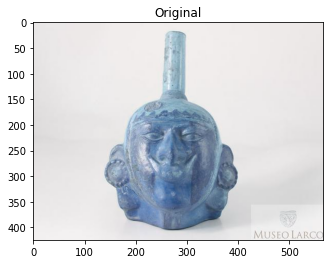

[] sino []
[INFO] processing image 2/310
drive/My Drive/huacos/validimages/sifaces/ML000002a.jpg


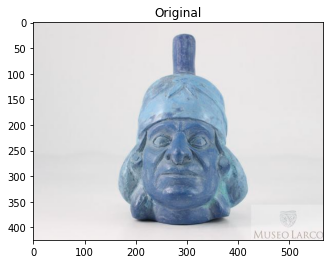

[array([-0.06197049,  0.10110661, -0.08344307, -0.08746047, -0.12568209,
        0.01374184,  0.00073552, -0.10072123,  0.18651615, -0.04200162,
        0.10569511,  0.00728354, -0.22865972, -0.0427765 , -0.01798285,
        0.07926017, -0.14063907, -0.03393584, -0.15015358, -0.10135262,
        0.04633239, -0.01061255,  0.04211208, -0.00333698, -0.13903794,
       -0.21978512, -0.10575469,  0.02452478,  0.03060948, -0.13857968,
        0.03815061,  0.09317598, -0.29711896, -0.09574006,  0.00683326,
        0.04517101, -0.08648703, -0.03615585,  0.18078499,  0.01769776,
       -0.12828122,  0.12284639,  0.11631229,  0.20442942,  0.21666282,
       -0.04354413, -0.03156883, -0.0749746 ,  0.12551722, -0.23666023,
        0.00849506,  0.18394758,  0.1683242 ,  0.05768767,  0.06827156,
       -0.05686738,  0.01861957,  0.14676136, -0.16588156,  0.09358419,
        0.1028311 , -0.10830033, -0.13599791, -0.08622662,  0.10426977,
        0.12100275, -0.112113  , -0.19281137,  0.14482148, -0.1

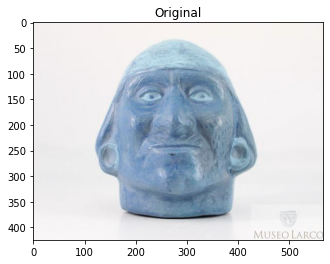

[array([-0.0996511 ,  0.08746796,  0.01177043, -0.07766792, -0.12443829,
       -0.024417  ,  0.0111706 , -0.06135414,  0.14914234, -0.03380534,
        0.10455106,  0.00247115, -0.19190904, -0.03220098, -0.06305797,
        0.07418331, -0.09368195, -0.11067465, -0.16128482, -0.11705818,
        0.04495399,  0.05510154,  0.03096492, -0.025172  , -0.10793464,
       -0.22051443, -0.05446725, -0.00911427,  0.10219114, -0.14720328,
        0.05541649, -0.00741014, -0.29962641, -0.10326605, -0.00528652,
        0.03598016, -0.10653971, -0.09011628,  0.19578806, -0.00067709,
       -0.17179221,  0.0248639 ,  0.09337727,  0.25398338,  0.18429181,
       -0.05204639, -0.02837887, -0.07320796,  0.07058675, -0.23296678,
        0.06379322,  0.1515028 ,  0.14116314,  0.10635876,  0.05504957,
       -0.03218645,  0.01280777,  0.14608124, -0.14709045,  0.10539829,
        0.11741583, -0.07281464, -0.1056573 , -0.12182569,  0.14059727,
        0.09395397, -0.09318001, -0.21828647,  0.11875084, -0.1

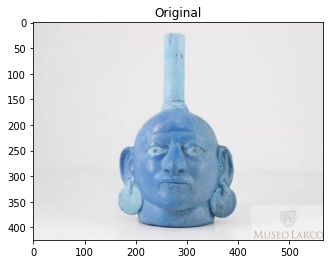

[array([-6.13116026e-02,  4.84627113e-03, -3.64349633e-02, -1.08509913e-01,
       -1.24993995e-01, -8.63191485e-03,  9.12856311e-03, -1.49005815e-01,
        1.81078374e-01, -7.53591657e-02,  8.22567195e-02,  2.59655863e-02,
       -1.63736045e-01, -1.28400594e-01,  8.54352564e-02,  1.00252144e-01,
       -1.05278626e-01, -1.66584820e-01, -1.24993488e-01, -1.13592386e-01,
       -1.10087097e-02,  2.15829983e-02,  1.10346451e-02,  2.33216211e-02,
       -1.74737260e-01, -2.21374065e-01, -1.14017323e-01, -7.33336732e-02,
        3.48917730e-02,  1.41383260e-02,  6.30223677e-02,  7.67828375e-02,
       -2.55112231e-01, -7.10325465e-02,  2.40032896e-02,  8.72372612e-02,
       -5.53033426e-02, -6.04307204e-02,  1.28285691e-01,  3.71730700e-03,
       -1.96808040e-01,  3.80631685e-02,  2.27690376e-02,  1.65390223e-01,
        1.88586265e-01, -2.10056305e-02,  6.39523417e-02, -3.75863351e-02,
        7.00580031e-02, -1.77592158e-01,  2.73948964e-02,  1.31716922e-01,
        7.81884938e-02, 

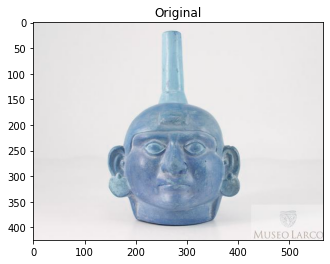

[array([-0.12581344, -0.00206386, -0.05341376, -0.07886545, -0.15142541,
       -0.10149767, -0.0187689 , -0.11583519,  0.14075479, -0.07855607,
        0.11646276,  0.00070009, -0.16425651, -0.08283001,  0.01097894,
        0.11820515, -0.0924941 , -0.09779249, -0.10543792, -0.10480748,
        0.06585585,  0.03482649,  0.00597401,  0.01052845, -0.11828822,
       -0.23066422, -0.082486  , -0.03471116, -0.00936539, -0.0224907 ,
        0.09364904,  0.04755887, -0.31806862, -0.09241852,  0.02794585,
        0.07898285, -0.09007023, -0.05336399,  0.23279276,  0.01875504,
       -0.17257488,  0.02127312,  0.05859636,  0.15853682,  0.15977484,
       -0.02888083,  0.03508506, -0.1207638 ,  0.09593099, -0.21535684,
        0.06682062,  0.16856334,  0.08794475,  0.01874593,  0.04784324,
       -0.02588569,  0.03009344,  0.12580252, -0.18944126,  0.05119607,
        0.13413583, -0.0884361 , -0.14489207, -0.12316818,  0.17982864,
        0.14200172, -0.05016713, -0.1896829 ,  0.21600185, -0.1

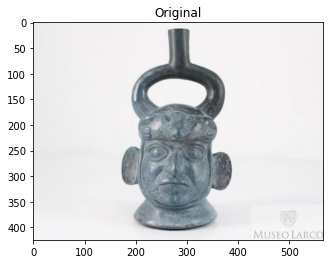

[] sino []
[INFO] processing image 7/310
drive/My Drive/huacos/validimages/sifaces/ML000007a.jpg


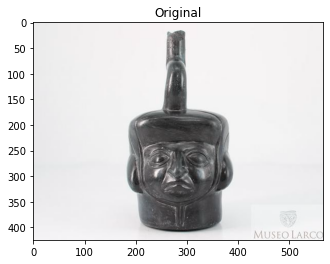

[] sino []
[INFO] processing image 8/310
drive/My Drive/huacos/validimages/sifaces/ML000008a.jpg


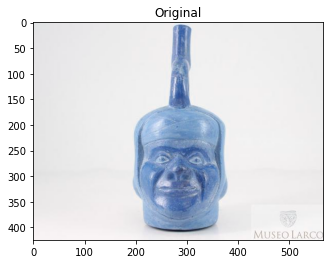

[] sino []
[INFO] processing image 9/310
drive/My Drive/huacos/validimages/sifaces/ML000009a.jpg


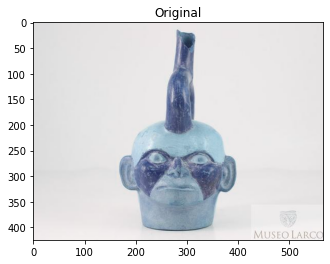

[] sino []
[INFO] processing image 10/310
drive/My Drive/huacos/validimages/sifaces/ML000010a.jpg


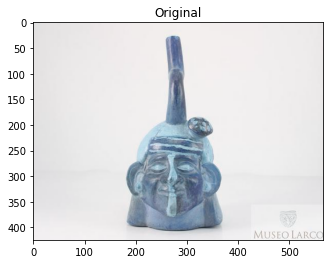

[array([-0.0185822 ,  0.09900643,  0.02696661, -0.04231475, -0.14596827,
       -0.00512023,  0.00055235, -0.04323728,  0.15739375, -0.03825024,
        0.1018061 , -0.01512463, -0.17554863,  0.0342617 , -0.05128488,
        0.08708703, -0.13511388, -0.03804168, -0.10033124, -0.16441242,
       -0.01437306,  0.09102682,  0.02784412, -0.00055983, -0.07299971,
       -0.23790935, -0.01936124, -0.04281252,  0.12701041, -0.134734  ,
        0.02930332,  0.04248123, -0.24179164, -0.05674561, -0.01701181,
        0.09899586, -0.09373078, -0.07017927,  0.18047661, -0.0029908 ,
       -0.1560978 ,  0.10083285,  0.05267092,  0.23352447,  0.20909782,
       -0.06188063, -0.04885802, -0.03024567,  0.11724155, -0.23582006,
        0.06440877,  0.16487633,  0.0942765 ,  0.06921368,  0.02305969,
       -0.10093629,  0.0028035 ,  0.13045311, -0.12872666,  0.07856241,
        0.11261676, -0.09978773, -0.02817248, -0.03594811,  0.1113899 ,
        0.03888976, -0.07802525, -0.14405918,  0.05870589, -0.1

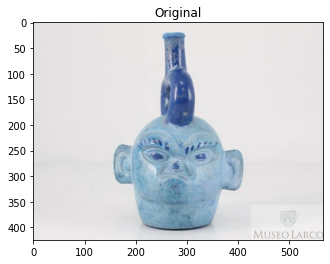

[] sino []
[INFO] processing image 12/310
drive/My Drive/huacos/validimages/sifaces/ML000012a.jpg


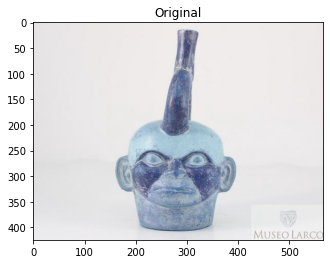

[] sino []
[INFO] processing image 13/310
drive/My Drive/huacos/validimages/sifaces/ML000013a.jpg


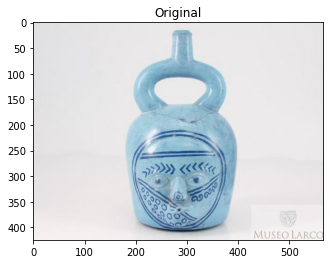

[] sino []
[INFO] processing image 14/310
drive/My Drive/huacos/validimages/sifaces/ML000014a.jpg


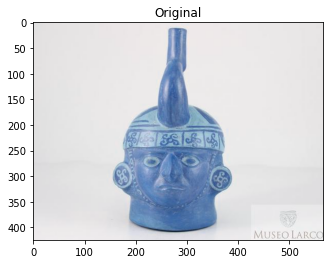

[] sino []
[INFO] processing image 15/310
drive/My Drive/huacos/validimages/sifaces/ML000015a.jpg


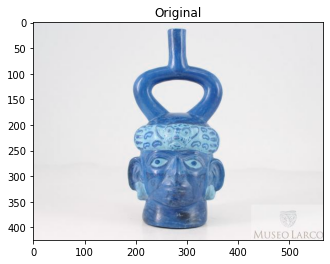

[] sino []
[INFO] processing image 16/310
drive/My Drive/huacos/validimages/sifaces/ML000016a.jpg


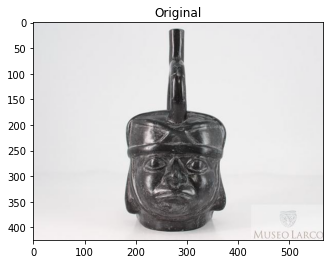

[] sino []
[INFO] processing image 17/310
drive/My Drive/huacos/validimages/sifaces/ML000017a.jpg


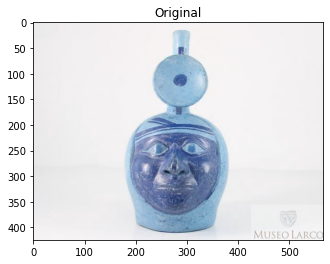

[] sino []
[INFO] processing image 18/310
drive/My Drive/huacos/validimages/sifaces/ML000018a.jpg


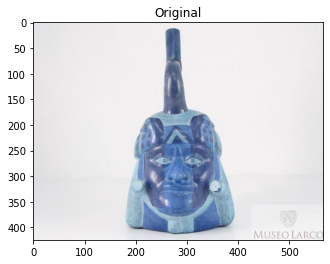

[] sino []
[INFO] processing image 19/310
drive/My Drive/huacos/validimages/sifaces/ML000019a.jpg


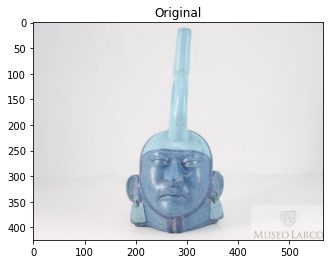

[array([-0.01273024,  0.03613543,  0.0460932 , -0.0833052 , -0.1066774 ,
       -0.11286047,  0.00729445, -0.10257766,  0.15405875,  0.00894294,
        0.19816497,  0.03852534, -0.20347273, -0.09485878,  0.00810631,
        0.05484984, -0.03339184, -0.12192619, -0.08917145, -0.0545267 ,
        0.01887676,  0.03585193,  0.05538345,  0.045121  , -0.05208801,
       -0.22467302, -0.11652193, -0.07733024,  0.06238116, -0.09391717,
        0.03946699,  0.06175085, -0.21139112, -0.11235496,  0.01595286,
        0.05504732, -0.08504955, -0.12208588,  0.17537034, -0.00171026,
       -0.18670142, -0.07681457,  0.0218224 ,  0.23201397,  0.13780619,
       -0.01298767,  0.09299797, -0.0724439 ,  0.04805597, -0.14797018,
        0.12307632,  0.12513572,  0.15529981,  0.01738665,  0.06499247,
       -0.11126091,  0.04898113,  0.11293977, -0.21760318,  0.07834334,
        0.11454343, -0.07854613, -0.07888661, -0.09363838,  0.22240222,
        0.12648007, -0.06169561, -0.18629035,  0.20125382, -0.1

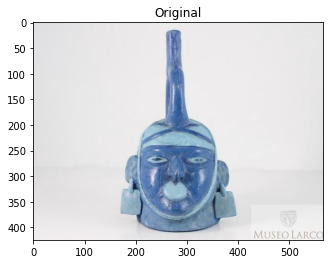

[array([-0.09607315,  0.05325424,  0.07656969, -0.03823252, -0.0621813 ,
       -0.11998233,  0.06100813, -0.01428219,  0.12136818, -0.04075171,
        0.23277153, -0.01380166, -0.22998571, -0.11558185,  0.04667108,
        0.0813275 , -0.06736387, -0.1064038 , -0.1658303 , -0.08353558,
       -0.00633694,  0.00920496, -0.04051168,  0.03159315, -0.05343097,
       -0.27744967, -0.04593287, -0.11092431,  0.05600864, -0.13355891,
        0.08770292,  0.05182126, -0.19029722, -0.07454901, -0.04300416,
        0.0650422 , -0.03242366, -0.05244507,  0.13164839, -0.03071515,
       -0.17515047, -0.10265955, -0.01993062,  0.22392908,  0.15682954,
        0.00537685,  0.04065008, -0.02745445,  0.03912276, -0.24673599,
        0.01256512,  0.10367823,  0.12778006,  0.06102429,  0.07599092,
       -0.10098583,  0.03127388,  0.05761035, -0.14043941,  0.04912708,
        0.05569353, -0.18182588, -0.08248138, -0.09531457,  0.21925038,
        0.03047339, -0.05528485, -0.0972355 ,  0.19894442, -0.1

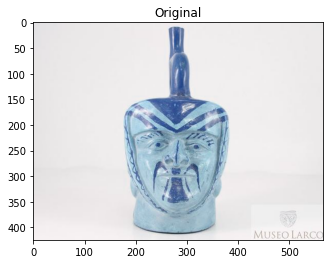

[array([-0.07479128,  0.02272975,  0.04364741, -0.02900647, -0.09296639,
       -0.08800298,  0.00796934, -0.05068254,  0.07580362, -0.0251876 ,
        0.16094384, -0.0297588 , -0.23831645, -0.03804951,  0.02363542,
        0.04334415, -0.1043162 , -0.09873196, -0.11968719, -0.08923167,
        0.04714864,  0.04120502, -0.00742097,  0.02080403, -0.06397657,
       -0.26870188, -0.1154215 , -0.09039025,  0.08773497, -0.10513849,
       -0.00359175,  0.0578861 , -0.12472118, -0.04840621,  0.04450802,
        0.10229485, -0.05925094, -0.08984728,  0.22421631, -0.01267208,
       -0.14954419, -0.08300394,  0.03355301,  0.258414  ,  0.19692668,
        0.02114877, -0.01056957,  0.00560358,  0.05343157, -0.27079377,
        0.04579594,  0.21487169,  0.08389193,  0.13665752,  0.05687437,
       -0.14471087,  0.08290235,  0.11190379, -0.1688244 ,  0.05244139,
        0.03897718, -0.1921383 , -0.0178872 , -0.04792114,  0.19962031,
        0.07813872, -0.07440194, -0.12501408,  0.11056978, -0.2

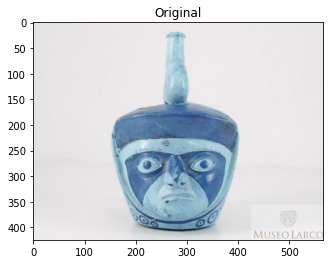

[] sino []
[INFO] processing image 23/310
drive/My Drive/huacos/validimages/sifaces/ML000023a.jpg


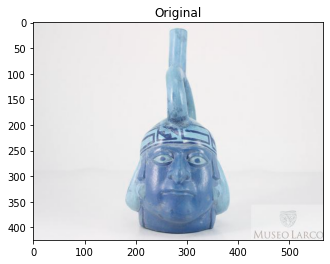

[array([-1.04876369e-01,  7.63689280e-02,  3.33551168e-02, -3.48529220e-03,
       -9.90206897e-02, -6.06824458e-02, -1.49063841e-02, -2.89873406e-02,
        1.03556536e-01, -2.54292265e-02,  1.64593548e-01, -1.32866204e-04,
       -2.18352288e-01, -2.89711505e-02, -1.59125030e-03,  1.08025752e-01,
       -1.17682502e-01, -4.83326279e-02, -1.57682598e-01, -1.26625985e-01,
        5.19723147e-02, -1.13104694e-02,  3.56747508e-02, -2.48591155e-02,
       -9.37604308e-02, -2.68098772e-01, -9.15476009e-02, -9.36288089e-02,
        8.91718641e-02, -1.17103070e-01,  2.56095305e-02,  1.20047517e-02,
       -2.21118420e-01, -6.71272874e-02,  1.89142823e-02,  6.35375977e-02,
       -6.17664084e-02, -5.79918846e-02,  2.20252320e-01, -2.42012851e-02,
       -1.75949857e-01, -7.30141997e-04,  3.18556987e-02,  2.19419003e-01,
        1.97228357e-01, -1.82435364e-02, -2.47538202e-02, -7.08825514e-02,
        9.44974795e-02, -2.78508633e-01,  2.97372937e-02,  1.92625940e-01,
        8.94285589e-02, 

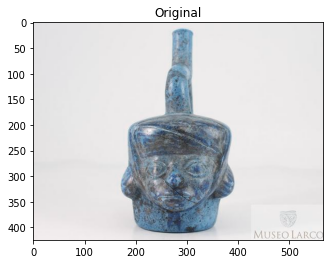

[] sino []
[INFO] processing image 25/310
drive/My Drive/huacos/validimages/sifaces/ML000025a.jpg


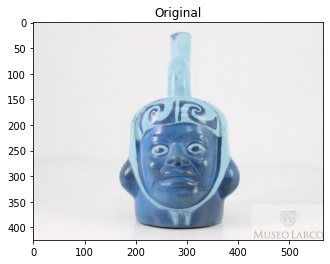

[] sino []
[INFO] processing image 26/310
drive/My Drive/huacos/validimages/sifaces/ML000026a.jpg


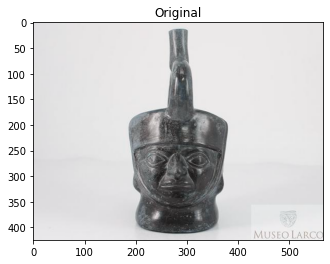

[] sino []
[INFO] processing image 27/310
drive/My Drive/huacos/validimages/sifaces/ML000027a.jpg


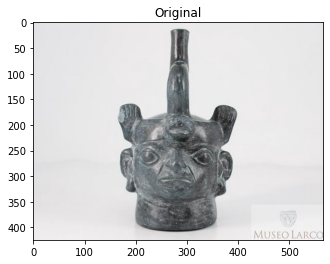

[] sino []
[INFO] processing image 28/310
drive/My Drive/huacos/validimages/sifaces/ML000028a.jpg


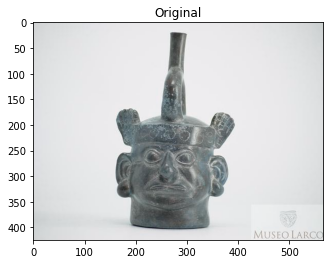

[] sino []
[INFO] processing image 29/310
drive/My Drive/huacos/validimages/sifaces/ML000029a.jpg


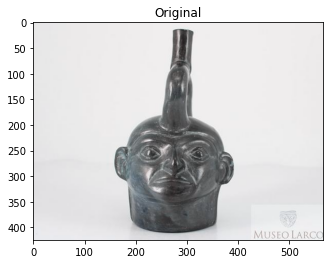

[] sino []
[INFO] processing image 30/310
drive/My Drive/huacos/validimages/sifaces/ML000030a.jpg


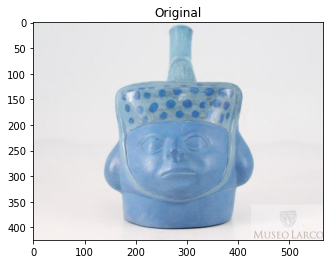

[] sino []
[INFO] processing image 31/310
drive/My Drive/huacos/validimages/sifaces/ML000031a.jpg


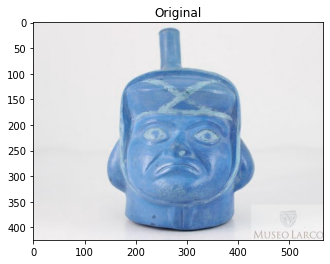

[] sino []
[INFO] processing image 32/310
drive/My Drive/huacos/validimages/sifaces/ML000032a.jpg


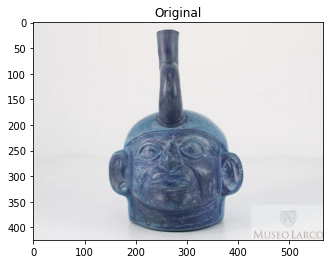

[] sino []
[INFO] processing image 33/310
drive/My Drive/huacos/validimages/sifaces/ML000033a.jpg


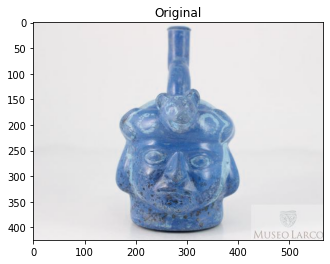

[] sino []
[INFO] processing image 34/310
drive/My Drive/huacos/validimages/sifaces/ML000034a.jpg


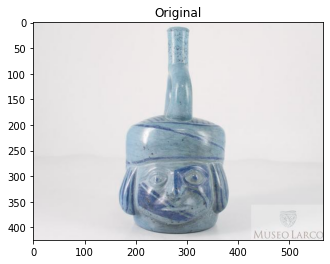

[] sino []
[INFO] processing image 35/310
drive/My Drive/huacos/validimages/sifaces/ML000035a.jpg


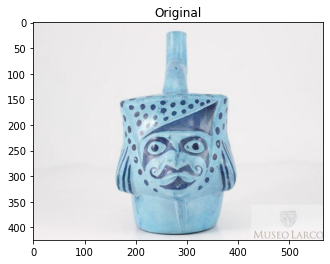

[array([-1.57462150e-01,  9.72099602e-03, -3.87283973e-02, -2.43665949e-02,
       -7.57680461e-02, -3.93385291e-02,  1.89649388e-02, -4.78407890e-02,
        1.03753380e-01, -8.93444121e-02,  1.00487798e-01,  7.83219934e-04,
       -2.14762777e-01, -6.91631883e-02,  6.79846033e-02,  1.33406267e-01,
       -8.88060778e-02, -1.05117232e-01, -1.69909284e-01, -1.31801516e-01,
        1.82642192e-02,  3.01111042e-02,  4.72089387e-02,  6.62831441e-02,
       -1.12577826e-01, -2.60055780e-01, -1.02450080e-01, -1.18535303e-01,
        6.13242872e-02, -4.96463329e-02, -1.83740631e-02, -3.22256573e-02,
       -1.89637274e-01, -6.24403246e-02,  1.62136331e-02,  7.85732642e-02,
       -3.82331312e-02, -4.55075651e-02,  2.36743927e-01,  2.57977471e-03,
       -1.89231157e-01,  2.67330930e-02,  6.68703765e-02,  2.51317710e-01,
        1.29889280e-01, -2.54110694e-02,  4.46648784e-02,  1.34354047e-02,
        7.54386783e-02, -2.11820364e-01,  5.15647829e-02,  1.06340513e-01,
        1.61395609e-01, 

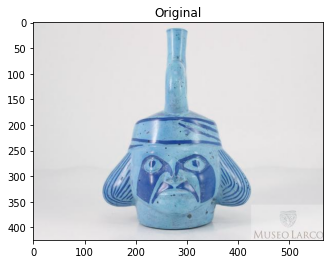

[] sino []
[INFO] processing image 37/310
drive/My Drive/huacos/validimages/sifaces/ML000037a.jpg


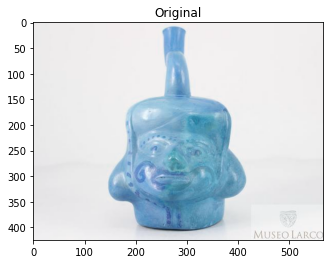

[] sino []
[INFO] processing image 38/310
drive/My Drive/huacos/validimages/sifaces/ML000038a.jpg


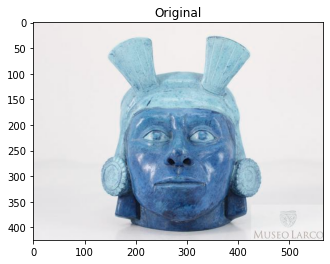

[array([-0.05977231,  0.10257597, -0.01088824, -0.04573446, -0.03443461,
       -0.04168924,  0.0513659 , -0.08648196,  0.24671644, -0.09962326,
        0.2597782 ,  0.02806637, -0.18057826, -0.06541497,  0.00471213,
        0.05396768, -0.18213284, -0.05807476, -0.07141341, -0.13959844,
        0.01588108,  0.03784725,  0.02502465,  0.01193228, -0.07188465,
       -0.21334718, -0.10407653, -0.13508633,  0.16987748, -0.08903705,
        0.07134599,  0.01880536, -0.24834479, -0.09613003, -0.02497058,
       -0.02828066, -0.03005558, -0.01869271,  0.22043423, -0.03024835,
       -0.09944513,  0.00325914,  0.0334041 ,  0.19590032,  0.17897353,
       -0.04415543, -0.00759849, -0.07809424,  0.10825377, -0.17013733,
        0.01117622,  0.133123  ,  0.19002637,  0.09247166,  0.01841432,
       -0.1155116 , -0.03448689,  0.08124454, -0.15793307,  0.10480626,
        0.09330942, -0.05831264, -0.08911473, -0.01543052,  0.18208806,
        0.07574664, -0.08447807, -0.20597576,  0.22068498, -0.2

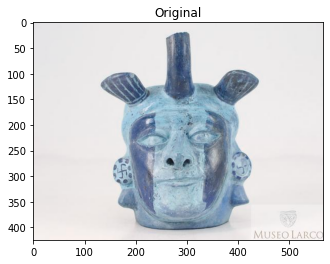

[] sino []
[INFO] processing image 40/310
drive/My Drive/huacos/validimages/sifaces/ML000040a.jpg


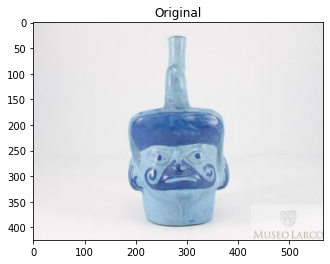

[] sino []
[INFO] processing image 41/310
drive/My Drive/huacos/validimages/sifaces/ML000041a.jpg


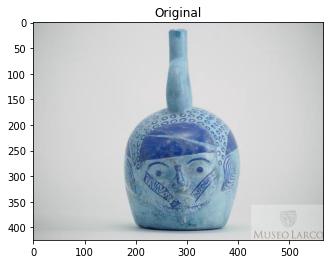

[] sino []
[INFO] processing image 42/310
drive/My Drive/huacos/validimages/sifaces/ML000042a.jpg


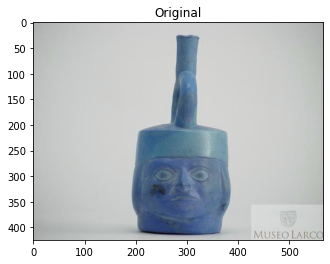

[] sino []
[INFO] processing image 43/310
drive/My Drive/huacos/validimages/sifaces/ML000043a.jpg


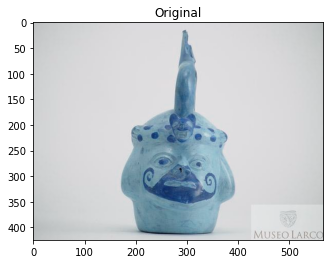

[] sino []
[INFO] processing image 44/310
drive/My Drive/huacos/validimages/sifaces/ML000044a.jpg


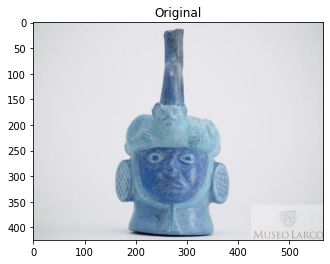

[array([-1.04312748e-01,  6.01749010e-02,  9.96333733e-03, -2.92232484e-02,
       -1.23361528e-01, -9.67672095e-02, -2.80100480e-03, -5.79835251e-02,
        1.30816489e-01, -4.10759002e-02,  1.89657360e-01, -1.84929594e-02,
       -1.80698723e-01, -1.00154772e-01,  3.72011289e-02,  1.06809609e-01,
       -9.00899544e-02, -5.90598509e-02, -1.30827650e-01, -1.40062571e-01,
        3.42254043e-02, -1.88630074e-03,  1.75717697e-02,  4.00085188e-02,
       -1.26973748e-01, -2.03903928e-01, -1.04138412e-01, -7.51329660e-02,
        4.24373746e-02, -1.05503552e-01,  4.53855097e-02,  2.63750646e-02,
       -2.76584297e-01, -1.04498327e-01, -2.94090062e-03,  8.14084113e-02,
       -2.02720053e-02, -4.31683660e-02,  1.45935610e-01, -3.08050588e-03,
       -1.06274948e-01,  3.07613015e-02,  4.59824055e-02,  1.82491392e-01,
        2.04089791e-01,  2.72184610e-03,  2.88482755e-04, -3.22822109e-03,
        8.26436952e-02, -2.40988076e-01,  1.84459761e-02,  1.37706548e-01,
        9.82867479e-02, 

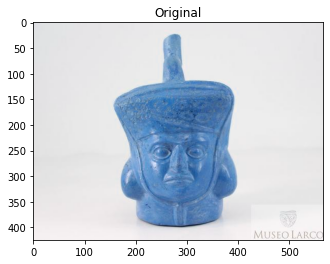

[array([-7.34449625e-02, -1.52751803e-03, -3.99218500e-03,  2.56913900e-03,
       -1.16973072e-01, -8.05835575e-02,  1.05224736e-02, -1.22751057e-01,
        1.58615068e-01, -9.52763557e-02,  1.43133342e-01, -6.86562732e-02,
       -1.98420256e-01, -8.96784961e-02,  4.38275635e-02,  1.03959501e-01,
       -7.49974027e-02, -1.34416625e-01, -1.32399917e-01, -1.26755625e-01,
        4.95340079e-02, -1.37265027e-02,  2.06642374e-02,  1.11226775e-02,
       -1.95235863e-01, -3.13587785e-01, -8.83745402e-02, -1.00626342e-01,
        3.51418667e-02, -7.21879900e-02,  3.67740095e-02,  1.09315485e-01,
       -2.76482284e-01, -4.09222022e-02, -1.17082670e-02,  9.15598869e-02,
       -2.60087941e-02, -4.12979200e-02,  1.95805669e-01, -3.26571167e-02,
       -1.85734734e-01,  1.98664516e-03,  3.46898325e-02,  1.60616815e-01,
        1.53283492e-01, -4.07565236e-02,  5.71013987e-02, -4.68515009e-02,
        9.16025415e-02, -2.11171895e-01,  3.30972672e-02,  1.67188510e-01,
        1.27589107e-01, 

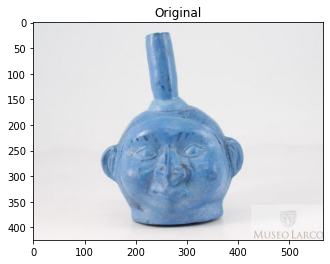

[] sino []
[INFO] processing image 47/310
drive/My Drive/huacos/validimages/sifaces/ML000047a.jpg


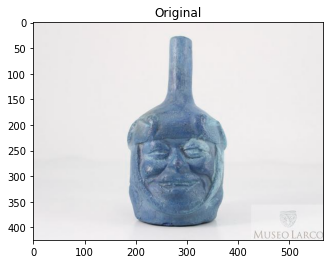

[array([-0.05043393,  0.00685047,  0.027785  , -0.0274976 , -0.15189151,
       -0.08308797,  0.06308636, -0.12500861,  0.13547972, -0.08732273,
        0.1416031 , -0.07402378, -0.27054286, -0.00165918, -0.03928538,
        0.06163523, -0.11054429, -0.09926696, -0.14262244, -0.05375264,
        0.05305754,  0.05871996,  0.04874095, -0.01268246, -0.08912252,
       -0.29047444, -0.08110631, -0.0627424 ,  0.0436432 ,  0.00487508,
        0.05802703,  0.08140777, -0.24324766, -0.08183293,  0.02249137,
        0.04410888, -0.05627289, -0.09243129,  0.19226436, -0.01400127,
       -0.19935781,  0.02122442,  0.05460116,  0.15372601,  0.17011409,
       -0.0329913 ,  0.00902703, -0.12023519,  0.05310991, -0.26849937,
       -0.02978797,  0.17929998,  0.12060818,  0.05815865,  0.0524661 ,
       -0.06701469,  0.02029574,  0.14000247, -0.16386981,  0.10836515,
        0.06580107, -0.09046286, -0.00385617, -0.07797325,  0.12553015,
        0.04273691, -0.04774389, -0.12916678,  0.18629655, -0.2

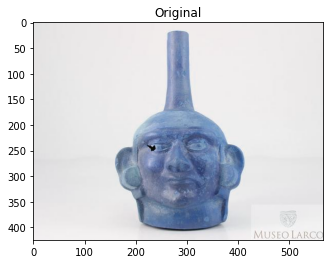

[array([-0.08972004,  0.05007806, -0.02001077, -0.07003124, -0.06646225,
       -0.05838224,  0.03565743, -0.11500964,  0.09863058, -0.06184635,
        0.16609783, -0.02683511, -0.23999153, -0.1612747 ,  0.05669827,
        0.13923229, -0.11438847, -0.16996765, -0.11378295, -0.17094314,
        0.05858611,  0.06802953,  0.04514442,  0.0386031 , -0.12641372,
       -0.27408549, -0.07389926, -0.09984459,  0.05969546, -0.10147634,
        0.08049826,  0.03855117, -0.22742832, -0.0420801 ,  0.01857291,
        0.0759394 , -0.07572136, -0.11482793,  0.1729698 , -0.00427527,
       -0.15283071, -0.03810174,  0.031428  ,  0.23321334,  0.18028539,
       -0.060795  ,  0.04264512, -0.05094492,  0.0745996 , -0.2143321 ,
        0.03660906,  0.13979265,  0.08270556,  0.09474789,  0.01817882,
       -0.04288659,  0.02503846,  0.13700366, -0.19886786,  0.04478727,
        0.07570361, -0.14318714, -0.07333936, -0.07029279,  0.17772155,
        0.09744844, -0.09695779, -0.15358183,  0.18284704, -0.1

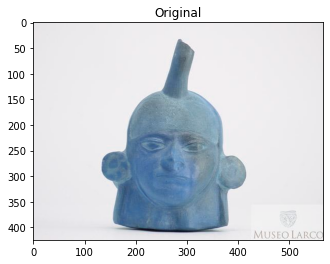

[array([-0.12417904,  0.09750462, -0.0286551 , -0.08884114, -0.1267411 ,
       -0.09626307, -0.04425873, -0.09390461,  0.11883736, -0.09845032,
        0.12435645,  0.02687909, -0.17916152, -0.02885889, -0.02676792,
        0.13431878, -0.0908021 , -0.07953803, -0.14120132, -0.12478324,
        0.0622982 ,  0.11178102,  0.05804028,  0.04999238, -0.09744152,
       -0.26620197, -0.10204908,  0.02665742,  0.05435093, -0.08869554,
        0.06010477,  0.03903573, -0.30353311, -0.06131523,  0.03142209,
        0.06140372, -0.03566083, -0.02940706,  0.18571728,  0.11296092,
       -0.15575995,  0.03797913,  0.05303395,  0.27787721,  0.17182219,
       -0.01296771,  0.04791928, -0.10465688,  0.03290318, -0.18054526,
        0.00456188,  0.13647406,  0.08544739,  0.03090457,  0.00823922,
       -0.07560255,  0.05067176,  0.12901188, -0.1805678 ,  0.07035843,
        0.10100147, -0.11369238, -0.10520515, -0.03680933,  0.20585567,
        0.08994059, -0.0658778 , -0.209411  ,  0.21265045, -0.1

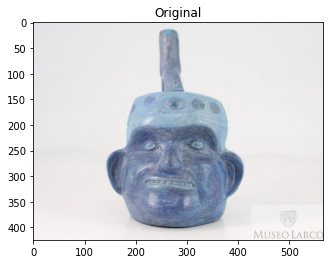

[array([-0.13493195,  0.04687795, -0.01828216, -0.08654723, -0.11771597,
       -0.07941857,  0.01217226, -0.06588642,  0.11564138, -0.01937349,
        0.13644768, -0.02421676, -0.24350734, -0.07326309, -0.03171795,
        0.10957377, -0.1484541 , -0.04510635, -0.14559764, -0.15558809,
        0.04858325,  0.05515824,  0.0416818 ,  0.02820607, -0.11047736,
       -0.21437725, -0.03912344, -0.06652993,  0.01975045, -0.11761421,
        0.081036  ,  0.0608018 , -0.29316378, -0.1180498 , -0.02207504,
        0.05566303, -0.13027769, -0.05093714,  0.21915141,  0.01375913,
       -0.12921783,  0.014255  ,  0.0578292 ,  0.22658755,  0.18918502,
       -0.05479446, -0.0398321 , -0.03260703,  0.07617672, -0.2783106 ,
        0.00133212,  0.17637739,  0.13387768,  0.07178527,  0.04002327,
       -0.04621478,  0.00917378,  0.12371585, -0.19014138,  0.08219911,
        0.07439254, -0.12274843, -0.09065831, -0.12019918,  0.16828531,
        0.08882209, -0.10695224, -0.12918884,  0.17674011, -0.1

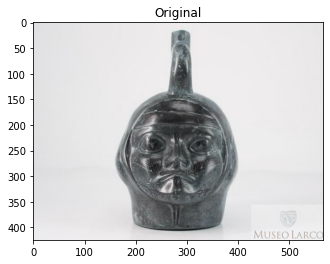

[] sino []
[INFO] processing image 52/310
drive/My Drive/huacos/validimages/sifaces/ML000052a.jpg


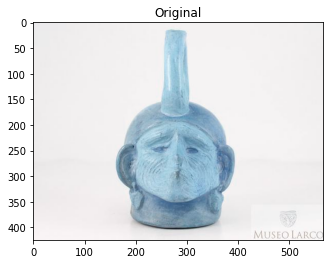

[array([-9.36112404e-02,  1.13312669e-01,  1.30212545e-01, -9.46717933e-02,
       -1.15395814e-01,  3.28845531e-02, -2.20521986e-02,  1.46619454e-02,
        9.69923362e-02, -5.85110635e-02,  1.43531978e-01,  5.32810390e-03,
       -2.42446184e-01,  2.31949240e-02, -2.43268907e-02,  1.67353585e-01,
       -1.02024302e-01, -7.98653737e-02, -1.52111202e-01, -1.26733661e-01,
        1.18765682e-02,  5.82886636e-02, -1.76232085e-02,  2.08663680e-02,
       -1.27131581e-01, -1.97115391e-01, -1.14392191e-02, -2.72267126e-02,
       -7.57042319e-04, -1.06589593e-01,  3.91297713e-02, -3.41213979e-02,
       -2.41378710e-01, -5.14349788e-02,  3.43882143e-02,  1.08017102e-02,
       -9.71963853e-02, -7.45250285e-02,  1.95039153e-01,  3.70913520e-02,
       -1.82443604e-01,  1.68743506e-02,  1.40475005e-01,  2.37932324e-01,
        1.88614056e-01, -1.02585554e-02, -1.52036548e-03, -2.99101695e-02,
        9.22825485e-02, -2.70696521e-01,  4.25226502e-02,  1.58645794e-01,
        1.54954761e-01, 

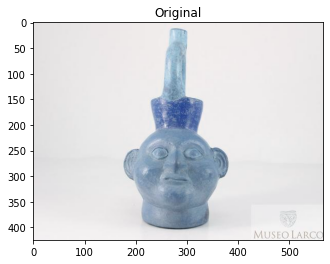

[] sino []
[INFO] processing image 54/310
drive/My Drive/huacos/validimages/sifaces/ML000054a.jpg


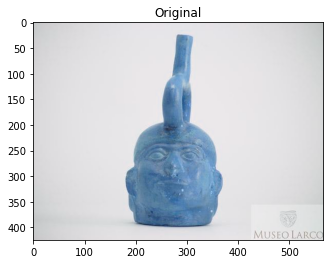

[array([-0.07038796,  0.01908716,  0.0153647 ,  0.00689465, -0.1452817 ,
       -0.10579073,  0.0156357 , -0.09570546,  0.14254488, -0.04178192,
        0.09555666, -0.02437317, -0.19976726, -0.03472902, -0.02420497,
        0.13899754, -0.12251756, -0.09403396, -0.0981577 , -0.12161866,
        0.07244074,  0.08483203,  0.00213277,  0.03926543, -0.14997551,
       -0.23995687, -0.06436631, -0.01256581,  0.04039616, -0.04068401,
        0.05403359,  0.02498672, -0.3290129 , -0.08576772,  0.02569057,
        0.08631237, -0.09073845, -0.09763314,  0.22070007,  0.06750277,
       -0.18610543,  0.05870217,  0.0581732 ,  0.2147819 ,  0.13781281,
       -0.0622171 ,  0.01374133, -0.06046004,  0.09804238, -0.21254769,
        0.02488099,  0.19619608,  0.13428888,  0.06130708,  0.02988223,
       -0.05400368,  0.0362257 ,  0.22087996, -0.17088391,  0.1541525 ,
        0.10365714, -0.16579252, -0.01225095, -0.055745  ,  0.13961388,
        0.0462264 , -0.01947787, -0.14476195,  0.20268872, -0.1

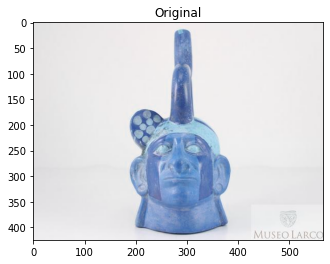

[] sino []
[INFO] processing image 56/310
drive/My Drive/huacos/validimages/sifaces/ML000056a.jpg


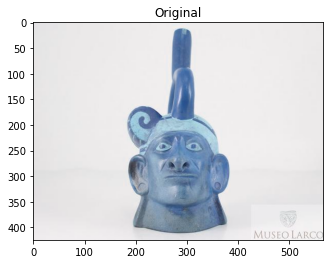

[] sino []
[INFO] processing image 57/310
drive/My Drive/huacos/validimages/sifaces/ML000057a.jpg


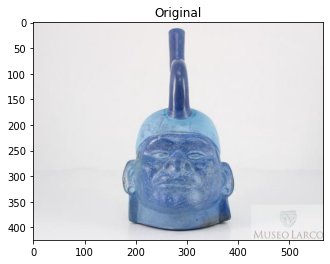

[] sino []
[INFO] processing image 58/310
drive/My Drive/huacos/validimages/sifaces/ML000058a.jpg


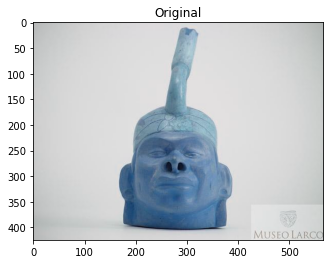

[] sino []
[INFO] processing image 59/310
drive/My Drive/huacos/validimages/sifaces/ML000059a.jpg


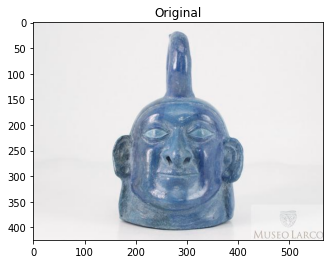

[array([-0.08411419,  0.09469721, -0.0488205 , -0.05197088, -0.12949313,
       -0.07109925,  0.03534567, -0.10241477,  0.16992036, -0.05045733,
        0.17880714, -0.02271897, -0.21875352, -0.09301038,  0.0324117 ,
        0.09215623, -0.11423184, -0.09701176, -0.08198783, -0.18207467,
        0.00989825,  0.01403427,  0.04365392,  0.0856295 , -0.06003373,
       -0.20213638, -0.04651546, -0.09408738,  0.14199609, -0.15180607,
        0.03850286,  0.02376077, -0.31136653, -0.13041753,  0.01498032,
        0.04276928, -0.07657906, -0.0789357 ,  0.22180942, -0.0074091 ,
       -0.0990531 , -0.02131955,  0.05054924,  0.21881928,  0.17793901,
       -0.02260599, -0.02351701, -0.05399569,  0.12782499, -0.21963164,
        0.0099161 ,  0.1456072 ,  0.14170887,  0.03065411,  0.0142034 ,
       -0.08882774, -0.00039363,  0.09672178, -0.18375707,  0.09249892,
        0.12559928, -0.12620021, -0.14823192, -0.10182732,  0.19923469,
        0.0854261 , -0.07098906, -0.16199219,  0.17639735, -0.1

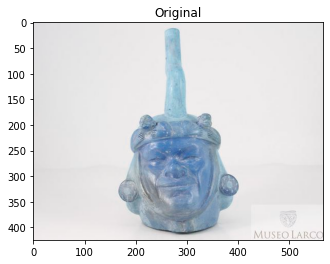

[] sino []
[INFO] processing image 61/310
drive/My Drive/huacos/validimages/sifaces/ML000061a.jpg


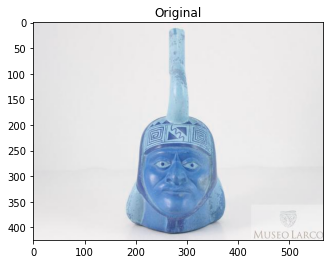

[array([-0.10659814,  0.04830093,  0.04775722, -0.02657881, -0.11784162,
       -0.06568904,  0.02303908, -0.1144849 ,  0.10480738, -0.01351412,
        0.13202062, -0.02796729, -0.20607412, -0.0986772 , -0.01084156,
        0.07238045, -0.09244555, -0.19797978, -0.16415885, -0.10445675,
       -0.0394637 ,  0.03169997,  0.00910186, -0.0088501 , -0.11138382,
       -0.2637617 , -0.09359536, -0.12985002,  0.11985964, -0.07746456,
        0.02825995,  0.00309484, -0.24418043, -0.08581349,  0.01137808,
        0.01623809, -0.08052749, -0.11153564,  0.17431486, -0.05877369,
       -0.18899372, -0.01488402,  0.04988459,  0.20598419,  0.184414  ,
       -0.00442268,  0.01440739, -0.02745939,  0.08464163, -0.20745146,
        0.07368259,  0.14805546,  0.14367788,  0.12723181,  0.03788077,
       -0.12672493,  0.05479806,  0.15034042, -0.12106858,  0.09783055,
        0.05307581, -0.11966336, -0.04129591, -0.06288692,  0.20388302,
        0.08340523, -0.03144325, -0.20947535,  0.16143993, -0.2

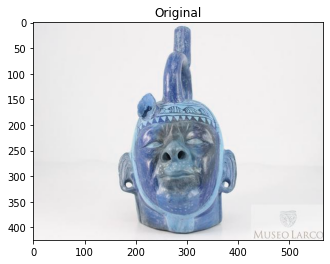

[] sino []
[INFO] processing image 63/310
drive/My Drive/huacos/validimages/sifaces/ML000063a.jpg


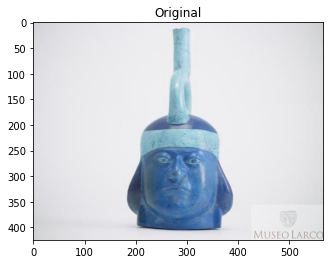

[array([-0.06184851,  0.00059567, -0.0049241 , -0.08133079, -0.14054887,
       -0.09953245,  0.00103096, -0.09350145,  0.15495844, -0.07375045,
        0.13272685,  0.01462038, -0.12823308, -0.08248778,  0.01070568,
        0.09817314, -0.04284044, -0.1128289 , -0.12525624, -0.07106252,
        0.028439  ,  0.03476857,  0.05231562,  0.03694641, -0.06835654,
       -0.21658647, -0.10039318, -0.04912486,  0.06511079, -0.03748163,
        0.07069432,  0.08162019, -0.26333731, -0.09554051,  0.00381   ,
        0.07928567, -0.03519586, -0.01527882,  0.16777477,  0.00206409,
       -0.19804186,  0.03478312,  0.0299088 ,  0.22524799,  0.19180827,
        0.00668062,  0.05569964, -0.08260757,  0.08728097, -0.20983997,
        0.08307377,  0.07751094,  0.14366168, -0.00740547,  0.07157205,
       -0.06878005,  0.02420639,  0.13039985, -0.15943806,  0.10211455,
        0.07318246, -0.06713799, -0.06199481, -0.10466758,  0.22274017,
        0.09292891, -0.04962711, -0.15322578,  0.20278969, -0.1

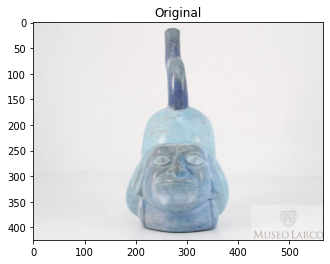

[array([-0.1193924 ,  0.05666661, -0.02167035, -0.04263096, -0.181574  ,
       -0.05879018, -0.00385927, -0.04561926,  0.10489427, -0.03183672,
        0.14088722,  0.00330148, -0.20647046, -0.01595844, -0.02260625,
        0.10518661, -0.12609322, -0.02255502, -0.12328729, -0.1756427 ,
        0.00354527,  0.05903722,  0.03846908, -0.0096802 , -0.11952065,
       -0.2144499 , -0.0719967 , -0.02193611,  0.0618322 , -0.15213791,
        0.03839692,  0.06797831, -0.28312883, -0.09206501,  0.01028524,
        0.09821959, -0.11166413, -0.08873035,  0.21142349,  0.02376208,
       -0.10336472,  0.07533365,  0.11747359,  0.21179329,  0.20349419,
       -0.05836233, -0.00833523, -0.05318998,  0.10682887, -0.24769464,
        0.05524221,  0.16460991,  0.09197627,  0.07109339,  0.05231594,
       -0.06714407, -0.01576499,  0.15966451, -0.09155823,  0.08879807,
        0.0853778 , -0.12733194, -0.09625842, -0.1083542 ,  0.11022627,
        0.08941253, -0.04694935, -0.16550985,  0.15135038, -0.1

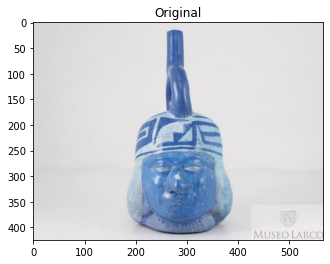

[] sino []
[INFO] processing image 66/310
drive/My Drive/huacos/validimages/sifaces/ML000066a.jpg


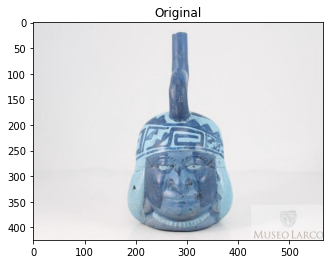

[] sino []
[INFO] processing image 67/310
drive/My Drive/huacos/validimages/sifaces/ML000067a.jpg


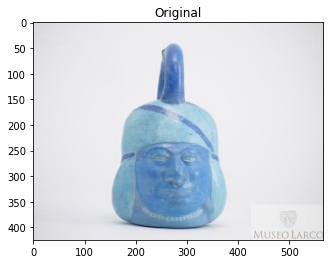

[array([-0.0595343 ,  0.0417521 ,  0.02284178, -0.04367271, -0.14300835,
       -0.05354717,  0.01954218, -0.12411466,  0.14091288, -0.03618603,
        0.14980793,  0.01153013, -0.16784099, -0.1155175 ,  0.00072307,
        0.10722855, -0.09526522, -0.14507617, -0.14436562, -0.10200396,
        0.02520461,  0.05674999,  0.02371429, -0.00705584, -0.13625489,
       -0.22576307, -0.05693002, -0.02813942,  0.1344932 , -0.09241815,
       -0.01526028,  0.0012493 , -0.29362363, -0.11505029,  0.02103616,
        0.09580259, -0.0891979 , -0.07824341,  0.12871447,  0.01908017,
       -0.1822288 ,  0.02235478,  0.00260773,  0.21635297,  0.1923905 ,
        0.00932798,  0.0186643 , -0.11667337,  0.10322759, -0.20836148,
        0.08524971,  0.11407109,  0.13436721,  0.03816497,  0.02729935,
       -0.05469842,  0.01079105,  0.16047239, -0.17016956,  0.09026716,
        0.13167313, -0.09205838, -0.05039184, -0.11566067,  0.16487013,
        0.06775717, -0.0469664 , -0.15527931,  0.18367431, -0.1

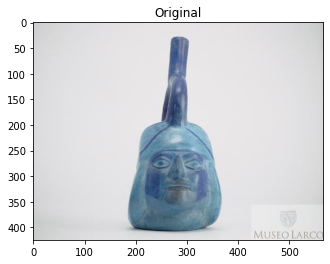

[array([-0.11869703,  0.05878638,  0.05727399, -0.02849336, -0.14031009,
       -0.03662288, -0.01762402, -0.07763934,  0.12749603, -0.07703005,
        0.09744368,  0.02686673, -0.16513634, -0.01840676, -0.05372805,
        0.116406  , -0.05724335, -0.11773825, -0.13911548, -0.18372114,
        0.0213396 ,  0.11672965,  0.04179242, -0.01048882, -0.14788413,
       -0.21665195, -0.06111994, -0.04994827,  0.05379302, -0.13827378,
        0.07832929,  0.03717423, -0.25230727, -0.0312295 ,  0.0151246 ,
        0.08723834, -0.06947396, -0.08802535,  0.19192222, -0.00792383,
       -0.13793263,  0.03509805,  0.08178267,  0.22922155,  0.17527628,
       -0.03100634, -0.01426596, -0.08782089,  0.11697077, -0.24576513,
        0.06110949,  0.11992723,  0.0950869 ,  0.07801011,  0.04379692,
       -0.05339196,  0.04734601,  0.11922944, -0.14984259,  0.10834784,
        0.09586866, -0.15179774, -0.13050222, -0.098912  ,  0.14669091,
        0.08238904, -0.08393365, -0.15352443,  0.1696732 , -0.1

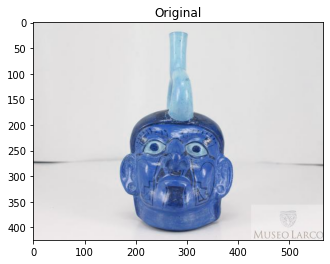

[] sino []
[INFO] processing image 70/310
drive/My Drive/huacos/validimages/sifaces/ML000070a.jpg


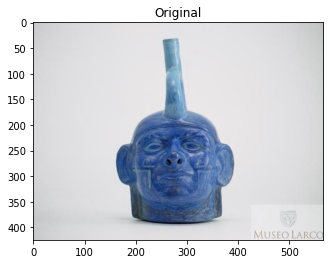

[array([-0.11751373,  0.06926099,  0.00955937, -0.07262143, -0.10361631,
       -0.08330704,  0.01660977, -0.04355367,  0.20639281, -0.01597834,
        0.18769327, -0.00550675, -0.17352363, -0.09206127,  0.01910654,
        0.08649105, -0.13361907, -0.12609582, -0.08321556, -0.1693975 ,
        0.0341894 ,  0.03697802, -0.01922444,  0.08193896, -0.10998051,
       -0.16939402, -0.04539194, -0.13943008,  0.1396279 , -0.11887477,
        0.02737135,  0.02060652, -0.29996878, -0.13405995,  0.01321101,
        0.00791045,  0.01565518, -0.05720694,  0.13997674, -0.02324211,
       -0.12856068, -0.04483919, -0.0047059 ,  0.23156485,  0.18791592,
       -0.03293359, -0.02352894, -0.02107646,  0.13005985, -0.20528118,
       -0.01835363,  0.13821262,  0.15323082,  0.02319286,  0.02227822,
       -0.13874061,  0.00152264,  0.138053  , -0.18396653,  0.11579411,
        0.04299168, -0.12150691, -0.08137533, -0.08854662,  0.19340716,
        0.02918164, -0.06735107, -0.16871721,  0.2096855 , -0.1

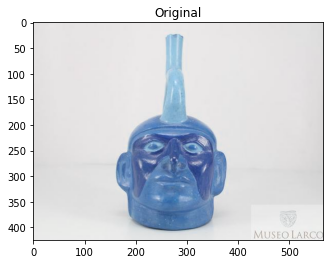

[] sino []
[INFO] processing image 72/310
drive/My Drive/huacos/validimages/sifaces/ML000072a.jpg


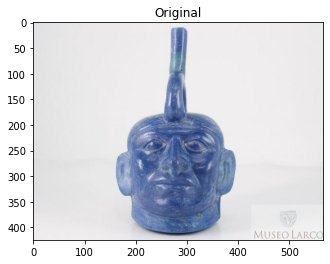

[] sino []
[INFO] processing image 73/310
drive/My Drive/huacos/validimages/sifaces/ML000073a.jpg


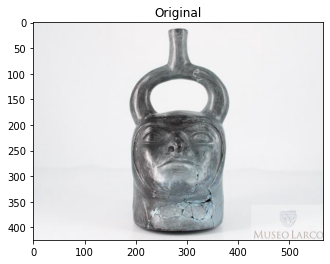

[] sino []
[INFO] processing image 74/310
drive/My Drive/huacos/validimages/sifaces/ML000074a.jpg


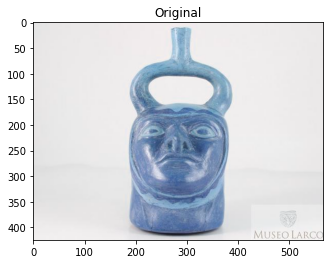

[] sino []
[INFO] processing image 75/310
drive/My Drive/huacos/validimages/sifaces/ML000075a.jpg


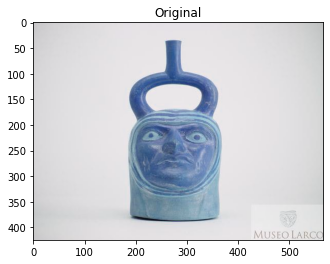

[array([-0.12907739,  0.08175237, -0.05725969, -0.08018639, -0.13183668,
       -0.03070611,  0.00892886, -0.12537774,  0.17272232, -0.01854058,
        0.15255673, -0.03886599, -0.21425945, -0.08165604, -0.0321305 ,
        0.10082047, -0.11841092, -0.07814758, -0.15295577, -0.12242731,
        0.05843881,  0.05360127,  0.01178053,  0.04801076, -0.18779492,
       -0.23593533, -0.10228061, -0.01062706,  0.04582745, -0.14381264,
        0.02942358,  0.079244  , -0.31756574, -0.13283136,  0.00810151,
        0.06553549, -0.08250891, -0.06615327,  0.21686378,  0.00233077,
       -0.12902182,  0.09265938,  0.10945109,  0.20784597,  0.17379022,
       -0.04907335, -0.02532114, -0.0702313 ,  0.0957083 , -0.21970752,
       -0.02515041,  0.21694353,  0.08619066,  0.07955797,  0.04909413,
       -0.0303188 , -0.00392622,  0.14738737, -0.17591327,  0.08493265,
        0.07746776, -0.12146461, -0.11909716, -0.10748419,  0.1225498 ,
        0.07910882, -0.08386343, -0.17096102,  0.18786822, -0.1

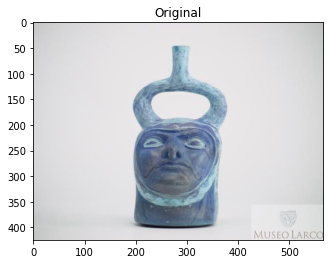

[array([-0.12199242,  0.08004641,  0.03549287, -0.04621994, -0.15272856,
       -0.01343656, -0.00220657, -0.06266838,  0.16410694,  0.01393805,
        0.12157434, -0.0278708 , -0.21707845, -0.08010639, -0.07096227,
        0.10165673, -0.1056898 , -0.10030716, -0.14016837, -0.10828266,
        0.10309816,  0.06775573, -0.03763624, -0.04032812, -0.14424172,
       -0.2849195 , -0.07953788, -0.05329537,  0.04288092, -0.1511014 ,
        0.06154803,  0.04614571, -0.27616638, -0.10428351, -0.03592107,
        0.02572658, -0.0755557 , -0.05706766,  0.16074416, -0.01045637,
       -0.16026968,  0.07053024,  0.06361239,  0.20900694,  0.17957589,
       -0.00208291, -0.01721273, -0.06058352,  0.07249099, -0.26579928,
       -0.05938353,  0.23530585,  0.0538875 ,  0.06057405,  0.10325067,
       -0.03596324,  0.0036599 ,  0.1306573 , -0.22916301,  0.11132646,
        0.02260674, -0.10098535, -0.08341226, -0.09740503,  0.13073671,
        0.07304541, -0.05923335, -0.14196929,  0.2041207 , -0.1

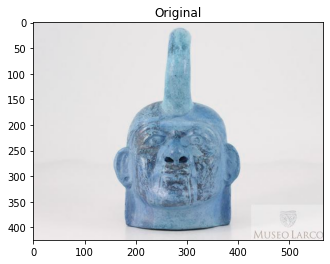

[] sino []
[INFO] processing image 78/310
drive/My Drive/huacos/validimages/sifaces/ML000078a.jpg


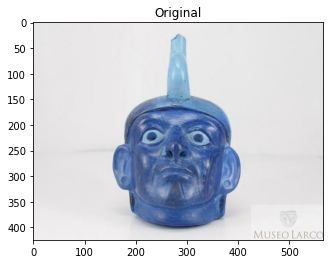

[array([-0.06842169,  0.06814768,  0.00318012, -0.02919377, -0.07951816,
       -0.03577621,  0.00662195, -0.07015143,  0.15642083, -0.06882997,
        0.21119022, -0.06553952, -0.24540959, -0.06991245, -0.00665165,
        0.09073329, -0.15592577, -0.08919141, -0.15142471, -0.15491305,
        0.13093357,  0.04802651,  0.02007875,  0.04164639, -0.20957705,
       -0.256733  , -0.04181023, -0.06759208,  0.11455277, -0.1720006 ,
        0.05802912,  0.05837743, -0.25223392, -0.06444405,  0.00930009,
        0.08513513, -0.00776274, -0.03809578,  0.20423894, -0.06021321,
       -0.16728771,  0.00427696,  0.09045097,  0.23098946,  0.16467436,
        0.03156561, -0.02581625, -0.04343693,  0.08861161, -0.2515229 ,
       -0.00820255,  0.18615335,  0.07640438,  0.11036618,  0.10676516,
       -0.15794146,  0.02216714,  0.19788885, -0.15545622,  0.103058  ,
        0.00567356, -0.15333927,  0.01555204, -0.08319871,  0.15198246,
       -0.01811742, -0.06259818, -0.17386743,  0.10516381, -0.2

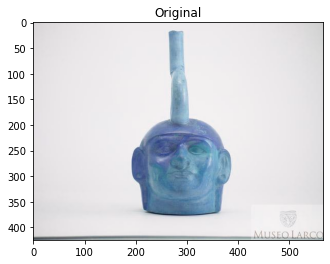

[array([-0.16927651,  0.02319777, -0.0184927 , -0.1205439 , -0.18923411,
       -0.03456089,  0.04645313, -0.0637439 ,  0.21422344, -0.0781763 ,
        0.14141494,  0.02244802, -0.16988322, -0.08939765, -0.00155067,
        0.12213103, -0.07013698, -0.12152676, -0.13694286, -0.13157567,
        0.03291458,  0.02433841, -0.01473781,  0.04361824, -0.17725308,
       -0.16145645, -0.10867209, -0.02150325,  0.01299064, -0.129319  ,
        0.07162707,  0.11508529, -0.25136894, -0.11462768,  0.02127942,
        0.08150749, -0.0889536 , -0.05252444,  0.18571322, -0.04215605,
       -0.15679133,  0.01508547,  0.09695151,  0.18569219,  0.19504814,
       -0.04119232, -0.01508007, -0.0860644 ,  0.14081423, -0.25634298,
        0.02836132,  0.16504094,  0.1096615 ,  0.05046727,  0.07708201,
       -0.04453136,  0.02057474,  0.19827951, -0.16641632,  0.0860116 ,
        0.04712796, -0.14841606, -0.15029745, -0.11507944,  0.13207769,
        0.11514478, -0.09118613, -0.18765308,  0.23125365, -0.1

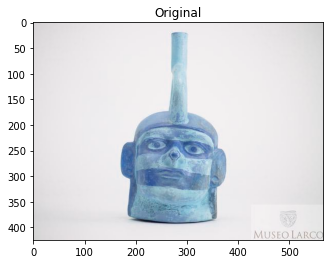

[array([-0.13356504,  0.03376884,  0.00635844, -0.09773258, -0.13991985,
       -0.02808674, -0.00297366, -0.03752872,  0.18162437, -0.09138172,
        0.0846322 , -0.00630119, -0.17195848, -0.05867186,  0.01089755,
        0.07709275, -0.07561332, -0.14041567, -0.12395541, -0.16001791,
        0.06338207,  0.09191383,  0.02323587,  0.04125466, -0.12027699,
       -0.20261997, -0.06753232, -0.11324072,  0.0893126 , -0.16560058,
        0.01809004,  0.05339795, -0.19369657, -0.05808229, -0.00882321,
        0.08188379, -0.03674503, -0.08112834,  0.16022679, -0.06598529,
       -0.1591371 , -0.03776193,  0.05483864,  0.22671136,  0.157681  ,
       -0.03994231, -0.01303985, -0.03104411,  0.1216079 , -0.25288546,
        0.04365674,  0.12989318,  0.09486036,  0.08563153,  0.09492545,
       -0.12208944,  0.03242159,  0.12946495, -0.17663993,  0.13816908,
        0.0323557 , -0.10294039, -0.10036965, -0.09453291,  0.17887202,
        0.08142397, -0.08911066, -0.1901195 ,  0.15957549, -0.1

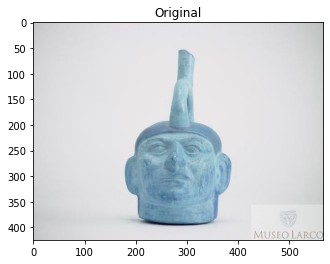

[array([-0.11055309, -0.01700462, -0.01765135, -0.02470612, -0.1700545 ,
       -0.07537273,  0.07096954, -0.0754479 ,  0.16826993, -0.05616066,
        0.09865896,  0.0330247 , -0.20306526, -0.05464224, -0.01537087,
        0.09890161, -0.07198382, -0.14189497, -0.11131029, -0.12469515,
        0.06915319,  0.0041533 , -0.00388276,  0.03188543, -0.14943385,
       -0.21854515, -0.06494267,  0.00965032,  0.06305048, -0.08273025,
        0.03537735,  0.05448709, -0.32092047, -0.1377856 ,  0.00863256,
        0.07659554, -0.04960807, -0.08206738,  0.2052266 ,  0.04622937,
       -0.17571291,  0.0464137 ,  0.07472223,  0.24730906,  0.1227047 ,
       -0.03397812,  0.04429743, -0.05638134,  0.11789587, -0.21022701,
        0.02947339,  0.15382411,  0.14468378,  0.0150946 ,  0.02267607,
       -0.05907261,  0.04786204,  0.18707757, -0.20965442,  0.12200528,
        0.10679977, -0.10637815, -0.05317939, -0.07228974,  0.14535452,
        0.05800845, -0.01961814, -0.18217258,  0.16463038, -0.1

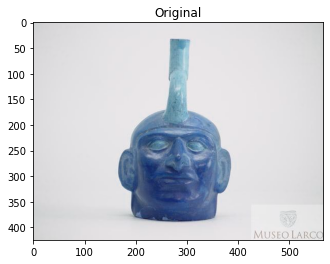

[array([-1.22595668e-01,  6.63143247e-02,  9.52933729e-03, -4.61127460e-02,
       -1.89098418e-01, -5.21574467e-02,  1.95976719e-02, -6.30477071e-02,
        1.35451138e-01, -3.26212272e-02,  1.56063497e-01,  1.77009851e-02,
       -1.67926177e-01, -1.17017657e-01, -2.09966302e-03,  7.60279819e-02,
       -1.03799120e-01, -1.35928005e-01, -1.49084419e-01, -1.54205456e-01,
        1.43907070e-02,  2.29654834e-03,  1.74390525e-03, -1.34163722e-03,
       -2.17211112e-01, -2.07013711e-01, -6.56512380e-02, -4.67972681e-02,
        6.18084185e-02, -1.16949841e-01,  8.06771219e-02,  3.41562256e-02,
       -3.07230860e-01, -1.29270330e-01,  2.01415718e-02,  9.55571830e-02,
       -8.03751349e-02, -4.68346998e-02,  1.72660634e-01, -4.37984094e-02,
       -1.48581058e-01,  5.08501977e-02,  9.26830918e-02,  1.98282644e-01,
        2.04867914e-01, -1.16096586e-02,  3.34895030e-03, -3.73666361e-02,
        1.03507668e-01, -2.65972584e-01,  2.00338215e-02,  1.81718484e-01,
        1.09335475e-01, 

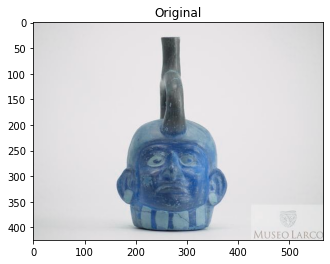

[] sino []
[INFO] processing image 84/310
drive/My Drive/huacos/validimages/sifaces/ML000084a.jpg


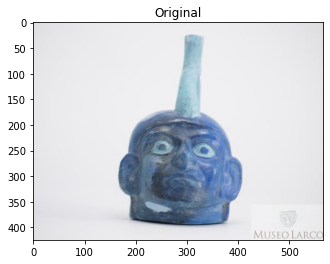

[array([-0.14463735,  0.09956551, -0.02326569, -0.028073  , -0.16079062,
       -0.06765693, -0.00371702, -0.09394065,  0.11642401, -0.05794146,
        0.10935991, -0.03929248, -0.20876583, -0.10605972,  0.00247958,
        0.12103394, -0.12292685, -0.09606464, -0.13834345, -0.12108886,
        0.05550635,  0.03025331,  0.02518169,  0.01362472, -0.12226187,
       -0.24804497, -0.04744888, -0.02646342,  0.01672878, -0.06568093,
        0.07033972,  0.05482799, -0.28426641, -0.10855067,  0.00520603,
        0.07563227, -0.08861032, -0.04158326,  0.22652726, -0.04984489,
       -0.16549166,  0.04191056,  0.11289041,  0.1954753 ,  0.18243785,
       -0.05826192, -0.02039505, -0.07191768,  0.10175745, -0.23633069,
       -0.00780851,  0.20419194,  0.13088571,  0.06244342,  0.0523776 ,
       -0.03880617,  0.03166861,  0.16029668, -0.14191622,  0.04379847,
        0.08062534, -0.13471994, -0.12149568, -0.10903361,  0.16538289,
        0.07541803, -0.08232243, -0.13941363,  0.15443532, -0.1

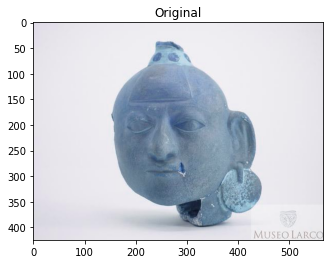

[array([-0.04156356,  0.05992357, -0.05585139, -0.09472562, -0.14280668,
       -0.05052423,  0.05353285, -0.09712612,  0.14306638, -0.02351332,
        0.08457632,  0.00354429, -0.23520406, -0.12430698,  0.07133975,
        0.12574321, -0.0810638 , -0.12656268, -0.1446096 , -0.07793658,
       -0.0046477 ,  0.05553234, -0.01385464,  0.06780806, -0.10275664,
       -0.14667538, -0.04708271, -0.04594838,  0.04038874, -0.09321136,
        0.09574915,  0.03444164, -0.2572282 , -0.07112208,  0.04071668,
        0.06257553, -0.09690606, -0.0962964 ,  0.16624917, -0.01626858,
       -0.17021163,  0.02761903,  0.05929157,  0.19167155,  0.15237179,
       -0.04641961,  0.06178039, -0.07666735,  0.1245424 , -0.18395096,
       -0.02550685,  0.09208498,  0.11562435,  0.03045415,  0.03242238,
       -0.12066557,  0.07001269,  0.17105734, -0.24178265,  0.11802354,
        0.09176909, -0.15152663, -0.0520777 , -0.02751978,  0.18978825,
        0.02437427, -0.0762278 , -0.19153677,  0.18521203, -0.2

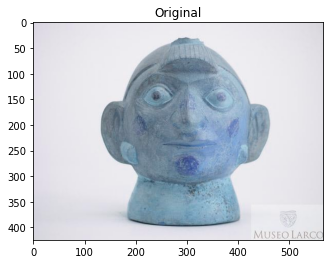

[array([-0.08397084,  0.03389751, -0.04517571, -0.00659787, -0.11657094,
       -0.08428985, -0.05998147, -0.04992865,  0.07110004, -0.04391351,
        0.0790309 ,  0.01070748, -0.17170426, -0.05159808, -0.04049571,
        0.11981168, -0.1295111 , -0.11058174, -0.15036437, -0.15237591,
        0.05545165,  0.06770456,  0.03159981,  0.01742602, -0.11952278,
       -0.16683137, -0.06290951, -0.04181889,  0.11348781, -0.10988373,
        0.00995673,  0.04894088, -0.25435904, -0.07424047,  0.07651748,
        0.07823438, -0.06161629, -0.07390537,  0.25892904, -0.01114377,
       -0.1674231 ,  0.0755439 ,  0.11426518,  0.2193757 ,  0.19504866,
       -0.05054729, -0.01706554, -0.06494309,  0.12144513, -0.20404974,
        0.01686903,  0.20584618,  0.15930369,  0.12424049,  0.01972841,
       -0.08256847,  0.03938528,  0.17374155, -0.15498386,  0.0919912 ,
        0.03396331, -0.1377992 , -0.06233438, -0.07321939,  0.13441235,
        0.06800289, -0.09859134, -0.21283537,  0.15354098, -0.1

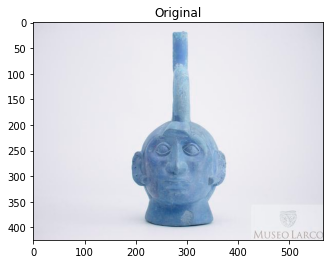

[array([-4.72833514e-02,  4.06596735e-02,  1.42557994e-02, -8.42217207e-02,
       -7.56874830e-02, -1.94012821e-02,  2.64916196e-03, -4.82168719e-02,
        1.76850319e-01, -7.05277771e-02,  1.22445248e-01,  2.88471319e-02,
       -1.63307875e-01, -4.94908728e-02, -5.32412529e-03,  1.29409641e-01,
       -7.48388618e-02, -8.61249119e-02, -1.66775659e-01, -1.31103978e-01,
        5.12867868e-02,  7.16796890e-02,  7.38031566e-02,  7.60291144e-03,
       -1.02731116e-01, -2.03267291e-01, -7.86056519e-02, -2.36744806e-03,
        7.42577463e-02, -1.57882318e-01,  5.30219898e-02, -1.01214275e-02,
       -2.66674817e-01, -6.54904023e-02,  1.68047100e-02,  4.36489731e-02,
       -3.05891465e-02, -7.69324675e-02,  1.94764078e-01,  1.26530901e-02,
       -1.59042224e-01,  7.47222155e-02,  8.95891711e-02,  2.06419021e-01,
        1.68639302e-01, -4.63435054e-02,  1.53718516e-02, -1.02710448e-01,
        1.08214445e-01, -2.06824377e-01,  4.71401960e-02,  7.09983110e-02,
        1.40713602e-01, 

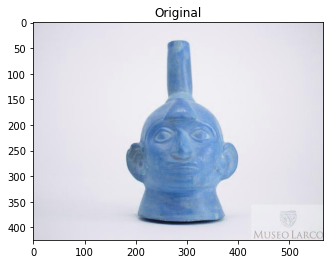

[array([-0.08851363,  0.07621077,  0.00319626, -0.02257189, -0.14259624,
       -0.05682373,  0.02541632, -0.06910542,  0.1238708 , -0.0084812 ,
        0.16370496,  0.00583516, -0.21419217, -0.09394824, -0.03547056,
        0.08564056, -0.12149032, -0.08545896, -0.16467132, -0.13095719,
        0.06368597,  0.04555783,  0.05263318,  0.00614922, -0.14415042,
       -0.22819899, -0.04251772,  0.01320473,  0.0702197 , -0.14840813,
        0.05809484,  0.06930943, -0.27850723, -0.09263414,  0.05110279,
        0.08302072, -0.06460378, -0.04997615,  0.19123143, -0.00677964,
       -0.16314909,  0.0309126 ,  0.09411284,  0.24193168,  0.17583136,
       -0.01672244, -0.02014564, -0.07574464,  0.08742929, -0.24327846,
        0.02192025,  0.18142125,  0.11614462,  0.05781048,  0.01957788,
       -0.08846283, -0.04279437,  0.19947439, -0.13550778,  0.10977226,
        0.0476466 , -0.18195811, -0.10768041, -0.13006234,  0.14621271,
        0.09835953, -0.11740673, -0.17531702,  0.14466685, -0.1

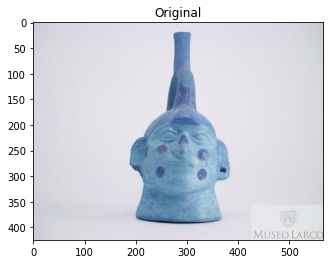

[] sino []
[INFO] processing image 90/310
drive/My Drive/huacos/validimages/sifaces/ML000090a.jpg


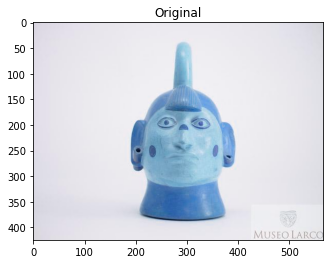

[array([-0.11807437,  0.02958008,  0.04879669, -0.09714505, -0.0893655 ,
       -0.0179922 ,  0.02147019, -0.01156568,  0.16190408, -0.06521811,
        0.14909908, -0.05109973, -0.31163561, -0.03166044,  0.02566341,
        0.13895845, -0.15342206, -0.1233425 , -0.15205422, -0.08360579,
        0.02052119,  0.09194724, -0.0282852 ,  0.03054569, -0.05565549,
       -0.21872839, -0.08009204, -0.11642151,  0.02360541, -0.10754187,
        0.04397458,  0.06457534, -0.13419923, -0.03579195,  0.0300406 ,
        0.05306511, -0.02557582, -0.11093885,  0.19339253, -0.04176138,
       -0.20015508, -0.1391287 ,  0.07442049,  0.25375146,  0.17186701,
       -0.04551905, -0.01599981, -0.03451763,  0.06310866, -0.33623695,
       -0.01266013,  0.14704195,  0.0904258 ,  0.13672651,  0.05372633,
       -0.18310466,  0.00238018,  0.14554231, -0.15093039,  0.05456415,
        0.02695986, -0.15617809, -0.06520823, -0.12615557,  0.24696569,
        0.07533655, -0.16713889, -0.19654095,  0.17325476, -0.1

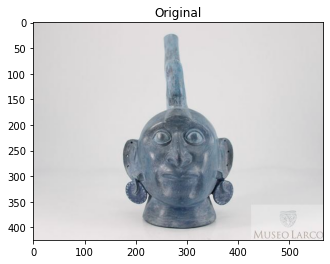

[] sino []
[INFO] processing image 92/310
drive/My Drive/huacos/validimages/sifaces/ML000092a.jpg


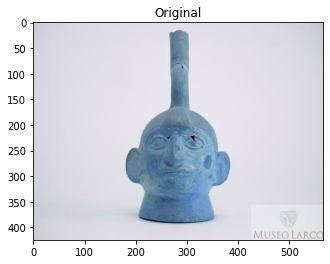

[] sino []
[INFO] processing image 93/310
drive/My Drive/huacos/validimages/sifaces/ML000093a.jpg


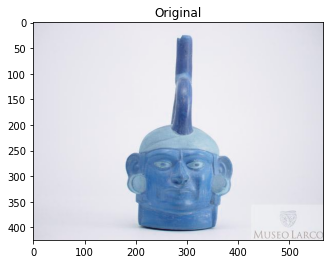

[array([-1.11302376e-01,  1.01670623e-03,  2.00375915e-02, -8.72849822e-02,
       -1.33290663e-01, -1.11566968e-01,  7.59485364e-03, -8.99068713e-02,
        1.57700494e-01, -9.82835293e-02,  1.42996863e-01,  1.22667253e-02,
       -1.43284231e-01, -8.72976631e-02,  1.20063424e-02,  1.01279452e-01,
       -1.04595959e-01, -1.27425253e-01, -1.02363542e-01, -1.43269002e-01,
        2.92345285e-02,  9.59570557e-02,  4.21105847e-02,  5.07153496e-02,
       -1.07518487e-01, -1.94668233e-01, -1.18288353e-01, -3.55992317e-02,
        7.00593740e-02, -6.66901991e-02,  5.54706752e-02,  9.03434679e-02,
       -2.27500573e-01, -8.37174207e-02,  3.04688588e-02,  1.04292274e-01,
       -3.79932597e-02, -7.83827603e-02,  2.06055492e-01,  1.79734416e-02,
       -1.54142916e-01, -2.26675570e-02,  3.75768319e-02,  2.26992726e-01,
        1.50941581e-01, -4.51530963e-02,  1.98636353e-02, -6.39578477e-02,
        8.56886059e-02, -2.00813413e-01,  6.31192029e-02,  1.54108241e-01,
        1.26116246e-01, 

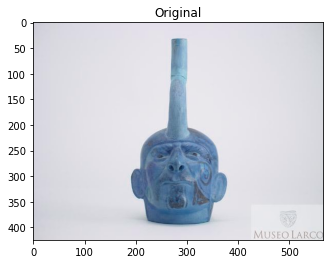

[] sino []
[INFO] processing image 95/310
drive/My Drive/huacos/validimages/sifaces/ML000095a.jpg


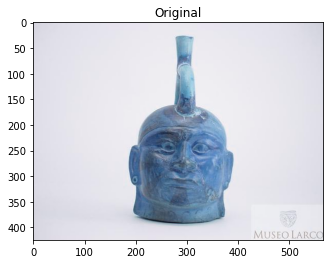

[array([-0.12973301,  0.01061675,  0.01718584, -0.08237731, -0.14603238,
       -0.03303431, -0.0085818 , -0.04531958,  0.09407996, -0.0822982 ,
        0.1673625 , -0.03638718, -0.25256786, -0.08055555, -0.00433584,
        0.08914848, -0.07853417, -0.10098544, -0.08132615, -0.15468648,
        0.04316452,  0.01702169,  0.02956409,  0.00884752, -0.13662948,
       -0.26178268, -0.07418829, -0.05610492,  0.01853155, -0.14112124,
        0.08901123,  0.03116788, -0.25587422, -0.03556714, -0.01212611,
        0.08214374, -0.0574429 , -0.11733039,  0.20492704, -0.01955127,
       -0.13065496, -0.00407385,  0.05731993,  0.22135217,  0.10458325,
       -0.04575224,  0.02082296, -0.06367017,  0.10805908, -0.20813936,
        0.03974753,  0.16001207,  0.12875918,  0.02280263,  0.06876163,
       -0.01994108,  0.04617313,  0.15560524, -0.14563389,  0.07269192,
        0.05993029, -0.06149166, -0.10877175, -0.13616973,  0.18533723,
        0.10798425, -0.06818517, -0.17694902,  0.21068272, -0.1

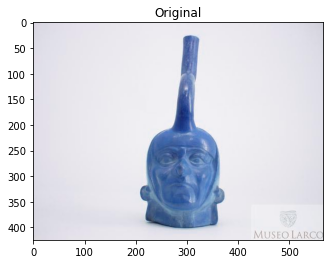

[array([-0.10906987,  0.03157805,  0.0259416 , -0.03824543, -0.09821239,
       -0.11818656,  0.02734306, -0.07581685,  0.15572831, -0.05786211,
        0.14724937,  0.04634157, -0.16789976, -0.09250164,  0.00407228,
        0.12903307, -0.0789318 , -0.13320629, -0.15598559, -0.08801093,
        0.02759212,  0.04438549,  0.02585112,  0.02531221, -0.08155413,
       -0.20040756, -0.10928155, -0.04513958,  0.08885197, -0.12090469,
        0.07277244,  0.00576616, -0.26203781, -0.09647126,  0.02008366,
        0.0325564 , -0.0528685 , -0.0876221 ,  0.25281009,  0.03253911,
       -0.20875753,  0.03175162,  0.03594229,  0.23490702,  0.16202651,
       -0.05802492,  0.02019211, -0.06985996,  0.07515173, -0.19883375,
       -0.01645716,  0.13168012,  0.13292211,  0.04384239,  0.02286636,
       -0.09182319,  0.06627524,  0.15089452, -0.22249292,  0.11324334,
        0.09805141, -0.1829794 , -0.0888072 , -0.01458906,  0.16169186,
        0.05275166, -0.07754374, -0.18893084,  0.20334944, -0.1

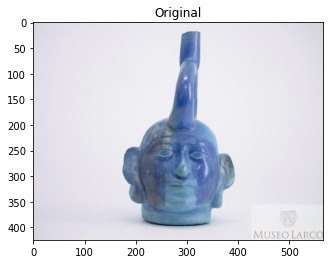

[] sino []
[INFO] processing image 98/310
drive/My Drive/huacos/validimages/sifaces/ML000098a.jpg


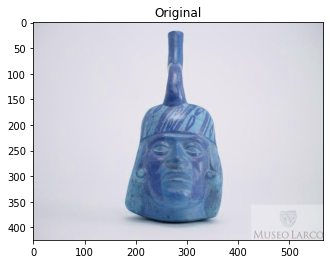

[array([-1.20911777e-01, -4.21326980e-03,  5.89992031e-02, -6.38971850e-02,
       -1.75198615e-01, -7.61357099e-02,  6.53593242e-03, -3.61818634e-02,
        1.32623926e-01, -6.08510897e-02,  1.58633545e-01,  5.47515452e-02,
       -1.56152159e-01, -5.35703376e-02, -4.56917286e-03,  8.57690424e-02,
       -1.07061133e-01, -8.31912607e-02, -1.08007386e-01, -1.25132158e-01,
        3.94248292e-02,  8.01432282e-02,  5.54989837e-02,  2.89931893e-03,
       -1.43139452e-01, -2.21207738e-01, -1.17886402e-01,  2.48458497e-02,
        6.70832098e-02, -7.78688341e-02,  5.19763231e-02,  2.71604508e-02,
       -3.09453815e-01, -1.13284774e-01,  4.67679463e-02,  4.43568192e-02,
       -7.72213042e-02, -4.57706153e-02,  1.96588129e-01,  7.04642832e-02,
       -1.72967389e-01,  5.40277362e-02,  5.00983931e-02,  2.51714587e-01,
        1.86860889e-01,  1.87978148e-04, -3.21326703e-02, -4.85158414e-02,
        1.03546120e-01, -2.24913627e-01,  5.92530556e-02,  1.61658496e-01,
        1.33189112e-01, 

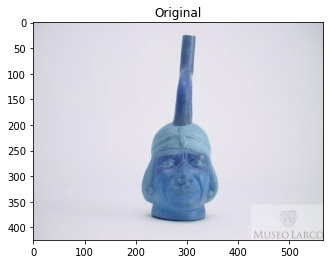

[array([-0.0437682 ,  0.04167206, -0.02416614, -0.043673  , -0.11699679,
       -0.05314723, -0.00403372, -0.0607461 ,  0.15569571, -0.04561628,
        0.14053079,  0.03712473, -0.15166825, -0.10938862,  0.00690836,
        0.06508699, -0.07385617, -0.06225107, -0.15662545, -0.08701864,
       -0.01347758,  0.04812805,  0.11077844,  0.03794004, -0.16255669,
       -0.2221268 , -0.09008868, -0.03952995,  0.04316994, -0.13788781,
        0.01270622,  0.03611458, -0.29424751, -0.13615863, -0.0015749 ,
        0.05882198, -0.08978503, -0.06548832,  0.21019295,  0.05432533,
       -0.16477813,  0.05032092, -0.0111897 ,  0.20972303,  0.19895297,
       -0.08267809,  0.0128419 , -0.06708162,  0.11472397, -0.21645622,
        0.03089821,  0.16643211,  0.08992971,  0.05395942,  0.02319274,
       -0.00437711, -0.01819533,  0.20813265, -0.1442938 ,  0.08807512,
        0.05764074, -0.08653667, -0.04335192, -0.09628034,  0.11260836,
        0.10654287, -0.08207562, -0.18826255,  0.15631065, -0.1

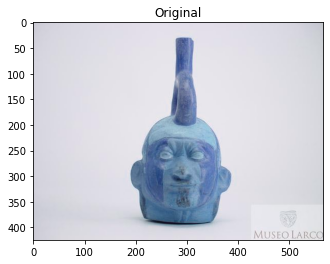

[] sino []
[INFO] processing image 101/310
drive/My Drive/huacos/validimages/sifaces/ML000101a.jpg


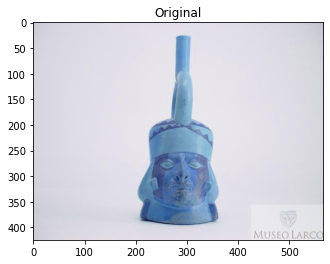

[array([-0.13238041,  0.03550216,  0.05298327, -0.10353835, -0.08681262,
       -0.06481352,  0.01375403, -0.06803461,  0.15990072, -0.03574836,
        0.05896338, -0.04917118, -0.17178507, -0.1054491 ,  0.03001732,
        0.11778136, -0.10369656, -0.16300616, -0.05039985, -0.10349914,
        0.0398362 ,  0.11127051, -0.0195839 ,  0.0307632 , -0.06389992,
       -0.21526903, -0.09368817, -0.07951389,  0.0436306 , -0.09107667,
        0.08069668,  0.08849737, -0.2322015 , -0.08162092,  0.04474322,
        0.09621586, -0.05345136, -0.0703511 ,  0.15308632, -0.01969618,
       -0.16803524, -0.04340269,  0.08476488,  0.26277825,  0.18192679,
       -0.03410824, -0.03117146, -0.03619529,  0.12172526, -0.23307732,
        0.0342176 ,  0.14202391,  0.10439998,  0.04252105,  0.0944466 ,
       -0.10857949,  0.03287553,  0.13706198, -0.21165644,  0.10718717,
        0.06255916, -0.14163737, -0.05344837, -0.09035366,  0.14874902,
        0.09071439, -0.05384578, -0.18670954,  0.21539035, -0.1

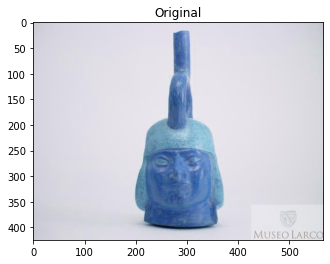

[array([-1.20316058e-01,  7.38528147e-02,  4.90433797e-02, -3.52381840e-02,
       -1.22791030e-01, -1.11134544e-01,  6.73103333e-03, -1.00216806e-01,
        1.37227625e-01, -5.92332482e-02,  1.36249185e-01, -8.54983926e-03,
       -2.27589607e-01, -1.09066635e-01,  1.82068348e-03,  1.17779605e-01,
       -1.08611844e-01, -1.00732163e-01, -1.08431414e-01, -1.25242159e-01,
        7.25493282e-02,  8.41795281e-02,  4.96831499e-02,  2.52841040e-02,
       -1.22928269e-01, -2.12899148e-01, -8.21103156e-02, -7.32569546e-02,
        4.37283851e-02, -1.14957914e-01,  4.61063311e-02,  5.27168140e-02,
       -2.61407375e-01, -1.06306858e-01, -1.35122985e-03,  7.95647129e-02,
       -3.44208404e-02, -5.43390885e-02,  1.87200531e-01, -7.51863047e-03,
       -1.56391680e-01,  5.52386791e-03,  2.86749639e-02,  2.35566258e-01,
        1.72908574e-01, -3.65793854e-02,  1.15153268e-02, -1.03347182e-01,
        9.75495279e-02, -1.99947074e-01, -2.23927647e-02,  1.64003819e-01,
        8.31014663e-02, 

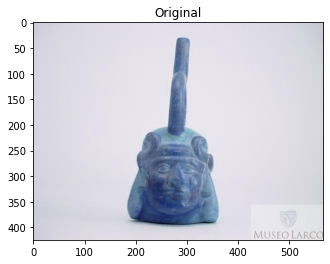

[array([-0.04112485,  0.05803109,  0.03787134, -0.00719047, -0.16722962,
       -0.10203302, -0.02340233, -0.084813  ,  0.10374541, -0.04092467,
        0.11337683, -0.02817559, -0.20560013, -0.03891695, -0.02247545,
        0.11194336, -0.15435098, -0.108932  , -0.07144073, -0.15802068,
        0.07391776,  0.06899673,  0.01157935,  0.00200742, -0.08357998,
       -0.21511881, -0.07105197, -0.06739262,  0.13332582, -0.07889425,
        0.01791367,  0.04619601, -0.29471967, -0.11311465,  0.02377537,
        0.03576758, -0.05585206, -0.12715214,  0.23174125,  0.00511979,
       -0.14670852,  0.06367841,  0.0412267 ,  0.19906755,  0.20478216,
       -0.06184255,  0.00500577, -0.06226031,  0.11620384, -0.19077086,
        0.01818215,  0.23786348,  0.18970041,  0.07273195, -0.0096493 ,
       -0.10390757,  0.03662178,  0.14091341, -0.18844862,  0.09312603,
        0.10344575, -0.08351916, -0.00357461, -0.05845535,  0.14907038,
        0.04759251, -0.03758337, -0.18698156,  0.17494571, -0.1

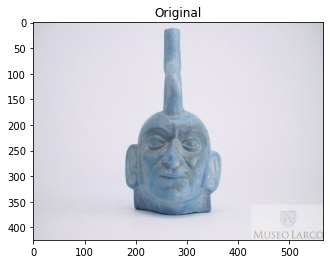

[array([-4.27360833e-02,  6.13240823e-02,  2.17191018e-02, -3.17139849e-02,
       -1.06232643e-01, -7.77952522e-02, -1.98486149e-02, -6.05118945e-02,
        6.97721317e-02, -5.80726266e-02,  1.01704553e-01, -1.80035830e-04,
       -2.22923800e-01, -1.70708373e-02,  8.08919966e-03,  1.13701701e-01,
       -6.60229623e-02, -1.20261855e-01, -1.15410462e-01, -1.13147527e-01,
        2.37513632e-02,  4.40447330e-02,  2.91274786e-02,  5.14920130e-02,
       -4.57356572e-02, -2.06563607e-01, -8.03395063e-02,  2.39678975e-02,
        9.79992077e-02, -3.49956676e-02, -2.10937113e-02, -1.50133669e-03,
       -2.70896882e-01, -1.08850710e-01,  5.12080938e-02,  6.84361160e-02,
       -6.58240616e-02, -8.30561519e-02,  1.99193269e-01,  9.96153057e-03,
       -1.70823708e-01,  6.67896271e-02,  1.04365900e-01,  2.37477258e-01,
        1.80020228e-01, -1.58123374e-02,  2.97038183e-02, -4.17318642e-02,
        6.02002963e-02, -2.48985603e-01,  5.58678657e-02,  1.46917880e-01,
        1.48873210e-01, 

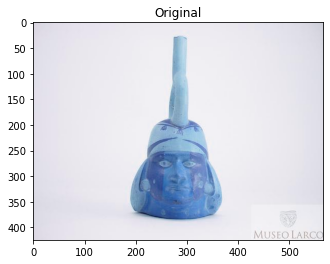

[array([-0.0955715 ,  0.06081555,  0.02627986, -0.12440644, -0.13532959,
       -0.03246394, -0.04804361, -0.06194011,  0.17385232, -0.01715846,
        0.13029452,  0.04325436, -0.17935669, -0.11472983,  0.00476614,
        0.09033285, -0.08720113, -0.10241915, -0.08829464, -0.14786269,
       -0.0167965 ,  0.04691897,  0.03709439,  0.02856077, -0.07714537,
       -0.18158379, -0.07827025, -0.05366654,  0.07541765, -0.13923338,
        0.06487453,  0.02118224, -0.27472731, -0.11632745, -0.00790229,
        0.04763537, -0.0622159 , -0.06347547,  0.14110264, -0.0239816 ,
       -0.15239383, -0.02162374,  0.02226852,  0.2162278 ,  0.22314078,
       -0.01849212, -0.01687654, -0.06407746,  0.10014205, -0.1822046 ,
        0.05493701,  0.13453223,  0.13219391,  0.01465691,  0.04149229,
       -0.0565407 ,  0.00227386,  0.14702898, -0.17086492,  0.04756486,
        0.06523949, -0.09909312, -0.0678933 , -0.12491604,  0.17348152,
        0.11222554, -0.05453294, -0.20847884,  0.19458757, -0.1

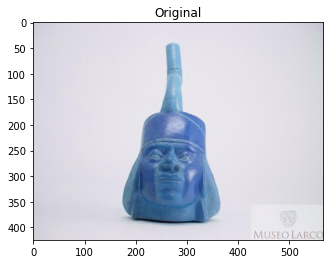

[array([-1.25798479e-01,  5.06976694e-02,  5.51705062e-03, -3.47890034e-02,
       -1.34973153e-01, -1.04565710e-01,  5.99598065e-02, -1.03077970e-01,
        1.17679961e-01, -6.01848587e-02,  2.29950413e-01,  1.25791132e-02,
       -2.08812505e-01, -1.18456692e-01,  3.84695381e-02,  4.20053378e-02,
       -7.42497072e-02, -7.81143308e-02, -1.15299568e-01, -1.06004521e-01,
        3.18809450e-02, -2.24120170e-03,  7.38307461e-02,  3.73472348e-02,
       -1.35251194e-01, -2.25963265e-01, -9.82969031e-02, -1.98296513e-02,
        1.76394545e-02, -1.22158729e-01,  1.09817274e-01,  8.37102532e-02,
       -2.76024193e-01, -1.13338739e-01, -2.57849097e-02,  7.50494748e-02,
       -6.18660189e-02, -4.26068008e-02,  2.01738253e-01, -3.87781784e-02,
       -1.37873739e-01,  4.92961705e-03,  3.94025296e-02,  2.46184841e-01,
        1.63520887e-01, -5.78861237e-02, -1.64142121e-02, -6.87860996e-02,
        6.02509454e-02, -2.35302448e-01, -1.23982057e-02,  1.49897173e-01,
        9.23256651e-02, 

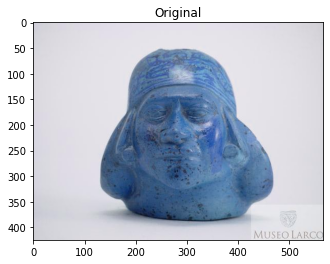

[array([-4.48788255e-02,  6.66927248e-02,  4.01149914e-02, -4.65408415e-02,
       -5.07889912e-02, -7.12588578e-02, -1.09920427e-02, -5.80197349e-02,
        1.93018109e-01, -8.20299760e-02,  2.06994832e-01,  2.42389701e-02,
       -1.93066195e-01, -9.99380127e-02,  5.80497496e-02,  1.23254031e-01,
       -8.34517777e-02, -1.27453119e-01, -1.40658855e-01, -1.55971766e-01,
       -2.85918117e-02,  4.14482392e-02,  2.82520652e-02,  1.85500607e-02,
       -1.06489897e-01, -2.25437701e-01, -6.30228668e-02, -9.81518924e-02,
        6.26266971e-02, -1.08319797e-01,  7.34163523e-02,  3.95591222e-02,
       -2.20696464e-01, -8.76225829e-02, -1.53487213e-02,  3.47467214e-02,
        2.21580639e-02, -3.06247249e-02,  1.17840499e-01, -1.18676983e-02,
       -1.56774908e-01,  1.84658691e-02, -4.42942902e-02,  2.33510643e-01,
        1.85687244e-01, -3.15330401e-02,  2.30744816e-02, -8.18670392e-02,
        5.95668480e-02, -2.28490800e-01,  1.91098824e-03,  5.49616888e-02,
       -5.27396798e-04, 

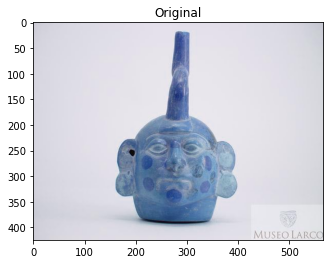

[array([-0.0699714 ,  0.04314811,  0.06287368, -0.0179223 , -0.08750686,
       -0.06506113,  0.04130064, -0.05417582,  0.19164211, -0.05447242,
        0.17867017, -0.00099646, -0.16797404, -0.13751781,  0.05650588,
        0.137775  , -0.10335869, -0.15564834, -0.1223225 , -0.1201237 ,
        0.00873759,  0.04300623, -0.00049584,  0.0122692 , -0.11890194,
       -0.26419324, -0.05286282, -0.13748017,  0.09135588, -0.10986505,
        0.04284779,  0.0331211 , -0.2104523 , -0.04440603,  0.0161429 ,
        0.05553611, -0.00120179, -0.07413702,  0.12879118, -0.01997317,
       -0.19714247, -0.03025336, -0.01892753,  0.20223734,  0.15121034,
       -0.02662683,  0.02179321, -0.06838356,  0.09266421, -0.15651143,
        0.0276187 ,  0.10109765,  0.09690115,  0.03775546,  0.00705191,
       -0.08135189,  0.01616822,  0.1212562 , -0.19501866,  0.06889256,
        0.07904295, -0.1814454 , -0.11597916, -0.04303966,  0.18552178,
        0.07189436, -0.04969642, -0.16990368,  0.17689672, -0.1

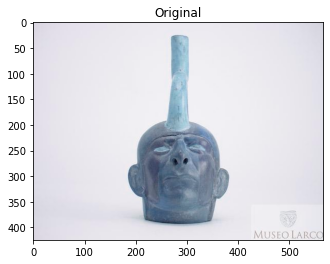

[] sino []
[INFO] processing image 110/310
drive/My Drive/huacos/validimages/sifaces/ML000110a.jpg


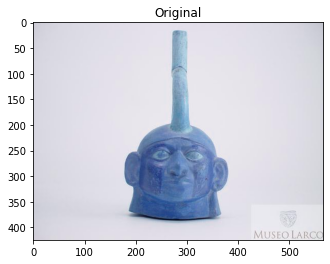

[array([-0.10979861,  0.07519227,  0.06530973, -0.0137772 , -0.0897547 ,
       -0.10796879,  0.04548435, -0.08737801,  0.1987876 , -0.05463731,
        0.25089827,  0.02765158, -0.15490896, -0.16339424,  0.01944625,
        0.12502152, -0.12049381, -0.11382192, -0.08044527, -0.1280677 ,
        0.05237702,  0.0126414 ,  0.02102249,  0.03498277, -0.1161704 ,
       -0.23200107, -0.08370131, -0.09136131,  0.10671894, -0.14345482,
        0.06721296,  0.02373935, -0.28408054, -0.1099764 , -0.03277555,
        0.05471618,  0.03283196, -0.03916319,  0.1659577 , -0.0308495 ,
       -0.14814502,  0.02869901,  0.02179647,  0.16761842,  0.16168778,
       -0.03094707,  0.02349693, -0.04574016,  0.05902687, -0.13754807,
        0.0106728 ,  0.08276321,  0.15184301,  0.01652159, -0.02094832,
       -0.0880746 , -0.06645884,  0.13703093, -0.18301074,  0.08298929,
        0.0879993 , -0.14819235, -0.11256592, -0.03322573,  0.1773545 ,
        0.07978047, -0.05576915, -0.18722467,  0.22130217, -0.1

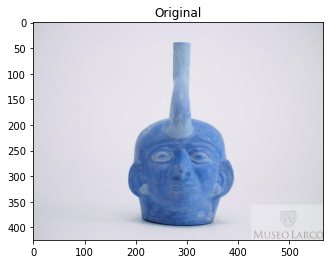

[array([-6.57971352e-02,  5.40519208e-02,  6.32752478e-03, -6.47430718e-02,
       -1.25744179e-01, -4.01669443e-02, -9.86498594e-03, -4.97585610e-02,
        1.36813745e-01, -3.44193205e-02,  1.49835780e-01, -4.68618423e-03,
       -1.24667488e-01, -9.19372737e-02, -2.59638578e-02,  1.29750535e-01,
       -1.34908855e-01, -9.64419842e-02, -1.57009751e-01, -1.20486915e-01,
        4.44666743e-02,  6.04453832e-02,  2.62996331e-02,  2.52786614e-02,
       -1.17245749e-01, -2.50690401e-01, -8.11746940e-02, -2.09948383e-02,
        1.36125386e-01, -1.05428904e-01,  3.93484011e-02,  2.58884206e-02,
       -2.77940750e-01, -6.00399859e-02,  2.37135217e-02,  6.41815960e-02,
       -4.00287174e-02, -6.52666613e-02,  1.98427498e-01,  1.92894526e-02,
       -1.82208911e-01,  1.01837084e-01,  4.33544293e-02,  2.22651333e-01,
        2.07915813e-01, -2.20639706e-02, -1.81853846e-02, -6.99362904e-02,
        9.27601382e-02, -2.00612649e-01,  2.72777453e-02,  1.67237759e-01,
        1.17390841e-01, 

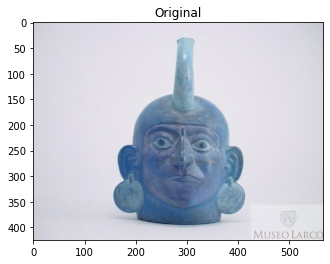

[array([-0.09795842,  0.02035812, -0.00182352, -0.04738703, -0.11275685,
       -0.09692776,  0.02038675, -0.08291626,  0.12392844, -0.0268494 ,
        0.0558548 ,  0.01521851, -0.17912197, -0.042007  ,  0.02699395,
        0.1135989 , -0.13768363, -0.14420992, -0.13153522, -0.06773958,
        0.06836492,  0.07649598,  0.06460907,  0.01281403, -0.11121457,
       -0.26609707, -0.10731643, -0.04448461,  0.08099503, -0.06046234,
        0.09794496, -0.00811274, -0.27369094, -0.07918398,  0.0260457 ,
        0.02124115, -0.09759595, -0.0906363 ,  0.22451347,  0.06475849,
       -0.2279999 ,  0.02189589,  0.01184392,  0.24449444,  0.16557984,
       -0.01844408,  0.04703247, -0.11850253,  0.05532957, -0.1806078 ,
        0.08621913,  0.15409942,  0.12700805,  0.03788714,  0.04854136,
       -0.02816634,  0.04502669,  0.15650174, -0.19707224,  0.07797816,
        0.1280351 , -0.07857233, -0.04374636, -0.09745407,  0.12396254,
        0.04865804, -0.03259223, -0.15154968,  0.18643463, -0.1

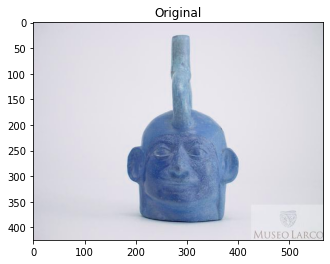

[array([-7.90046901e-02,  1.72440447e-02, -1.02866292e-02, -5.68497181e-02,
       -9.46156010e-02, -6.71283305e-02, -3.06080170e-02, -5.82363382e-02,
        1.00294441e-01, -2.29980052e-02,  1.52931377e-01, -3.71878594e-03,
       -2.00140893e-01, -8.90023559e-02,  3.92939746e-02,  1.09288186e-01,
       -1.44656330e-01, -8.48730654e-02, -1.45534307e-01, -5.64590506e-02,
        2.82707661e-02,  4.36639041e-02,  7.04242811e-02,  4.29419801e-03,
       -1.03351787e-01, -2.66615272e-01, -5.36131151e-02, -8.97737443e-02,
        7.24460185e-02, -6.50719106e-02,  7.20756650e-02, -6.15243614e-03,
       -2.60652155e-01, -6.21332563e-02,  6.30405545e-03,  5.21744601e-02,
       -5.05285561e-02, -5.39143905e-02,  2.07175568e-01,  3.85403261e-02,
       -1.93635046e-01,  3.31217535e-02, -3.45958769e-03,  2.18566805e-01,
        1.99926779e-01,  2.07990408e-04,  5.58724105e-02, -1.22611701e-01,
        7.07811341e-02, -2.00638637e-01,  3.00845727e-02,  1.48274422e-01,
        1.16863579e-01, 

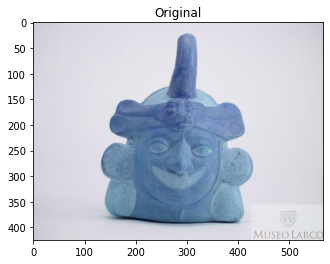

[] sino []
[INFO] processing image 115/310
drive/My Drive/huacos/validimages/sifaces/ML000115a.jpg


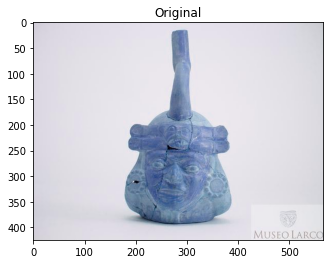

[] sino []
[INFO] processing image 116/310
drive/My Drive/huacos/validimages/sifaces/ML000116a.jpg


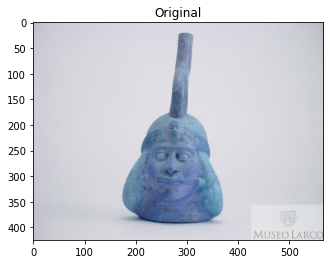

[array([ 1.28261149e-02, -4.04406339e-03, -9.07340646e-03, -7.31646270e-02,
       -1.36969507e-01, -3.88517976e-04, -2.63035633e-02, -1.01851121e-01,
        1.66670218e-01, -7.58894533e-02,  1.42778009e-01,  2.80246884e-03,
       -1.37086973e-01, -9.74161848e-02,  3.57200652e-02,  1.06977060e-01,
       -1.19882718e-01, -1.11003697e-01, -7.10244626e-02, -8.95510167e-02,
       -2.15229094e-02,  3.88362631e-02,  8.32270235e-02, -1.53332949e-05,
       -1.35757923e-01, -2.43841603e-01, -1.22922003e-01, -4.71739769e-02,
        1.16908714e-01, -5.33623174e-02, -3.27754021e-02,  5.70383854e-02,
       -2.48187497e-01, -5.19850105e-02,  4.81478758e-02,  8.53274837e-02,
       -6.85710460e-02, -7.61803687e-02,  1.49468660e-01,  7.78017938e-03,
       -1.51567712e-01,  8.35255384e-02,  4.22271788e-02,  1.46990225e-01,
        2.12128788e-01, -2.36866921e-02,  2.48052441e-02, -1.07703328e-01,
        7.83309042e-02, -1.45285726e-01,  8.57814252e-02,  1.28510833e-01,
        1.33476019e-01, 

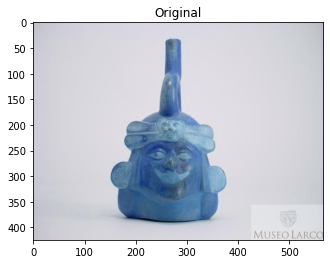

[] sino []
[INFO] processing image 118/310
drive/My Drive/huacos/validimages/sifaces/ML000118a.jpg


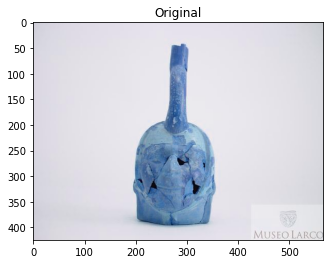

[] sino []
[INFO] processing image 119/310
drive/My Drive/huacos/validimages/sifaces/ML000119a.jpg


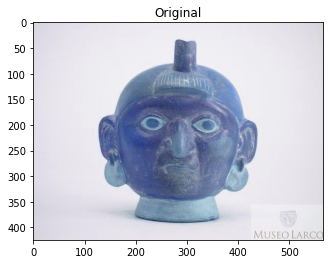

[] sino []
[INFO] processing image 120/310
drive/My Drive/huacos/validimages/sifaces/ML000120a.jpg


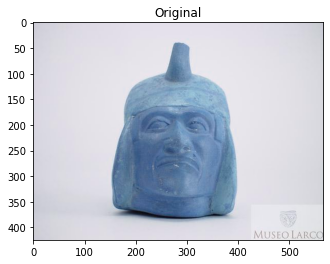

[array([-0.11299801,  0.10040189,  0.07047937, -0.03045163, -0.1195007 ,
       -0.04410389, -0.02637261, -0.0621944 ,  0.10175111, -0.03701498,
        0.16877495, -0.00576954, -0.19118842, -0.04322966,  0.01626071,
        0.1472256 , -0.08961366, -0.0838722 , -0.13021609, -0.06303215,
        0.01001745,  0.03761615,  0.04441676, -0.01930856, -0.05381516,
       -0.27746069, -0.03481495,  0.08915176,  0.10417822, -0.06640719,
       -0.03459672,  0.02053295, -0.29693675, -0.09573148,  0.05157613,
        0.09604212, -0.06412417, -0.03438828,  0.15080401,  0.00236625,
       -0.18803635,  0.05658437,  0.06300806,  0.21478109,  0.1767588 ,
        0.03462015,  0.00178111, -0.03829738,  0.04327464, -0.23428267,
        0.0608494 ,  0.14081508,  0.13714704,  0.02590997,  0.00691547,
       -0.09831873, -0.02096822,  0.16325834, -0.13183036,  0.08364415,
        0.09155534, -0.09533082, -0.0611994 , -0.08846271,  0.14926486,
        0.08851373, -0.07991347, -0.20978919,  0.1152907 , -0.1

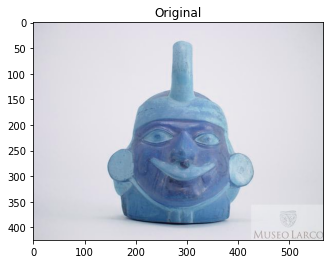

[array([-0.05435094,  0.02734261, -0.00774082, -0.02871297, -0.08693586,
       -0.0837145 , -0.00535897, -0.05933283,  0.13689011, -0.03351082,
        0.16257256, -0.00108856, -0.2142444 , -0.09084319,  0.0328131 ,
        0.07696002, -0.09715394, -0.07752602, -0.14903504, -0.06112413,
        0.08483654,  0.04147137,  0.00778104, -0.00264454, -0.14004071,
       -0.21828213, -0.11285327, -0.07979405,  0.00848683, -0.06916311,
        0.10767994,  0.03594629, -0.2314508 , -0.11343758,  0.04570808,
        0.06269883, -0.05036952, -0.04875087,  0.1698401 , -0.02898937,
       -0.18297482, -0.00084227,  0.05492991,  0.15742445,  0.20057625,
        0.02810836,  0.02180718, -0.15059488,  0.09023186, -0.25183398,
        0.04282923,  0.16664717,  0.10150203,  0.08006555,  0.0867523 ,
       -0.06103615,  0.05079051,  0.14123225, -0.17020564,  0.06748776,
        0.07865913, -0.15084775, -0.05562527, -0.11477404,  0.091537  ,
        0.03683443, -0.05164174, -0.1648283 ,  0.19435197, -0.2

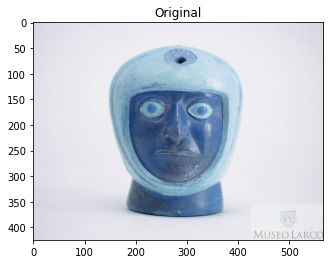

[] sino []
[INFO] processing image 123/310
drive/My Drive/huacos/validimages/sifaces/ML000123a.jpg


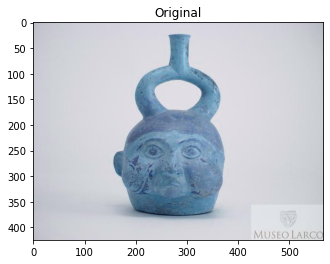

[array([-1.30831286e-01,  6.48318827e-02,  3.62967141e-02, -1.01432510e-01,
       -1.36506185e-01, -6.50407672e-02,  2.91664153e-03, -7.99348578e-02,
        1.06571972e-01, -8.00410360e-02,  9.40743238e-02, -7.13832080e-02,
       -2.54276574e-01, -2.88122296e-02,  8.66691768e-03,  1.97122440e-01,
       -1.33775502e-01, -9.01066959e-02, -1.39673665e-01, -1.16487421e-01,
        7.98626989e-02,  6.13722838e-02,  6.43858686e-03,  1.76144689e-02,
       -7.05018491e-02, -2.98469901e-01, -9.24516022e-02, -3.62466834e-02,
        4.88031581e-02, -3.96877676e-02,  3.87928113e-02,  1.38961896e-03,
       -2.45803386e-01, -3.62178311e-02,  2.90479288e-02,  8.21763575e-02,
       -7.16146678e-02, -8.77744555e-02,  2.23924652e-01,  2.71780193e-02,
       -2.19924733e-01,  1.27363279e-02,  9.39627662e-02,  1.90115243e-01,
        1.58791721e-01, -1.85901821e-02,  5.07048368e-02, -8.21196735e-02,
        1.20908305e-01, -2.19925135e-01,  7.41968863e-03,  1.65359512e-01,
        1.52372137e-01, 

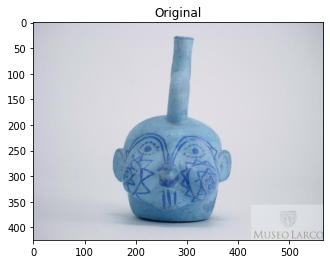

[] sino []
[INFO] processing image 125/310
drive/My Drive/huacos/validimages/sifaces/ML000125a.jpg


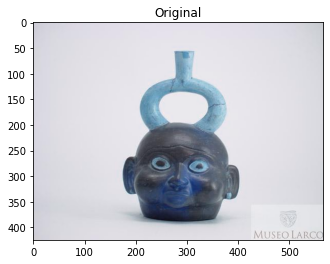

[] sino []
[INFO] processing image 126/310
drive/My Drive/huacos/validimages/sifaces/ML000126a.jpg


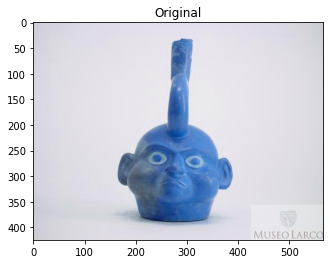

[array([-0.16384932,  0.02247332,  0.0411859 , -0.02844352, -0.10524168,
       -0.14569376,  0.01023628, -0.08894187,  0.10577561, -0.04631528,
        0.1915828 , -0.03091319, -0.20724052, -0.07671703,  0.00803334,
        0.11782648, -0.09472381, -0.0776915 , -0.0867846 , -0.12205082,
        0.08606347, -0.00228876,  0.00723996,  0.04782085, -0.1330899 ,
       -0.24568826, -0.06674047, -0.04958257, -0.00342482, -0.04617582,
        0.0830138 ,  0.10925539, -0.2560291 , -0.05390344,  0.01352647,
        0.10398354, -0.00824872, -0.03362283,  0.1710379 , -0.03301194,
       -0.14179182, -0.07961418,  0.0579884 ,  0.19831716,  0.20037061,
       -0.05392651,  0.03369868, -0.03432526,  0.07584809, -0.22997111,
        0.0339512 ,  0.12243687,  0.18422119,  0.02458661,  0.06107935,
       -0.09790155,  0.03672056,  0.12608808, -0.1723371 ,  0.04763202,
        0.04949122, -0.13714963, -0.09533337, -0.07031009,  0.19063881,
        0.11089246, -0.06561768, -0.11385311,  0.24007541, -0.1

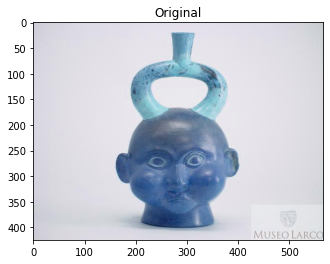

[array([-0.17454422,  0.03744039,  0.03140396, -0.10646985, -0.15275653,
       -0.05185312, -0.01643417, -0.12930852,  0.08802911, -0.12051792,
        0.09537718, -0.10097618, -0.21828534,  0.01461721, -0.00798364,
        0.15654121, -0.1321986 , -0.12359633, -0.1256755 , -0.15268636,
        0.03647837,  0.1218213 , -0.0180165 ,  0.00783363, -0.08967617,
       -0.28240475, -0.08045147, -0.02239225,  0.04780681,  0.0080218 ,
        0.01796915,  0.04994602, -0.23099115, -0.01686339,  0.04780416,
        0.09801299, -0.05183835, -0.07813223,  0.21612683, -0.0082013 ,
       -0.17689985, -0.01129782,  0.09695515,  0.20286897,  0.14521545,
       -0.03526673,  0.01029933, -0.05556937,  0.06863596, -0.2079201 ,
        0.01522532,  0.19567105,  0.09215715,  0.05330526, -0.01556316,
       -0.10862957,  0.02026366,  0.15036081, -0.19115008,  0.03798158,
        0.12396807, -0.10546777, -0.08934468, -0.04880624,  0.22038126,
        0.14958183, -0.11404085, -0.20732465,  0.18669601, -0.1

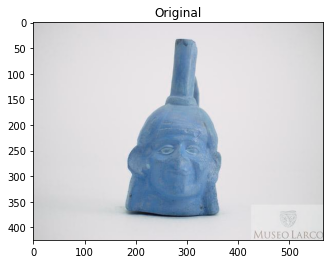

[array([-0.09891725, -0.00599155,  0.02991813, -0.04320679, -0.10208927,
       -0.01332472, -0.00317234, -0.00471716,  0.11447378, -0.11854871,
        0.14146659,  0.02581742, -0.2027176 , -0.06215828,  0.01292302,
        0.16498519, -0.07878898, -0.07905653, -0.17330627, -0.13650626,
       -0.01558416,  0.02080181, -0.00037   , -0.0257176 , -0.12709667,
       -0.19703111, -0.06390321, -0.01414781,  0.05939943, -0.07048089,
        0.03197594,  0.00925862, -0.30198765, -0.09665906,  0.01298247,
        0.02239118, -0.07583389, -0.01833085,  0.20557371,  0.04466536,
       -0.15465811,  0.06526502,  0.06735919,  0.25445324,  0.16455525,
       -0.01752461,  0.00975642, -0.05988678,  0.08106451, -0.27072889,
        0.02567785,  0.09827637,  0.18066005,  0.07923521,  0.01377488,
       -0.07411715,  0.04637954,  0.18873404, -0.17327273,  0.15108907,
        0.04436867, -0.11766895, -0.1034458 , -0.05333825,  0.18912354,
        0.08888396, -0.08479932, -0.21527991,  0.21357395, -0.1

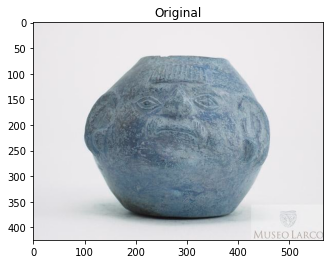

[] sino []
[INFO] processing image 130/310
drive/My Drive/huacos/validimages/sifaces/ML000131a.jpg


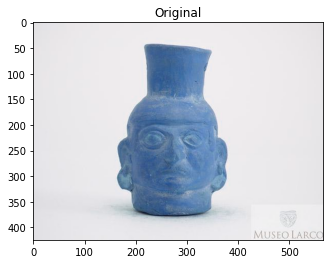

[array([-0.11681452,  0.03106418, -0.0059159 , -0.03901493, -0.16559824,
       -0.06674989, -0.01326649, -0.08273307,  0.1190563 , -0.03692493,
        0.1191944 , -0.00619294, -0.18316436, -0.05760898, -0.04471145,
        0.11452772, -0.10583894, -0.06625675, -0.14862978, -0.06947003,
       -0.01516512,  0.0470413 ,  0.04989436, -0.00107779, -0.09129997,
       -0.23236257, -0.07953157,  0.01316442,  0.04251609, -0.06667857,
        0.0391826 ,  0.11318211, -0.25872296, -0.1069524 ,  0.02193546,
        0.09922815, -0.10301973, -0.037748  ,  0.19820724,  0.07603882,
       -0.16557869,  0.02800835,  0.08786112,  0.28720665,  0.1827314 ,
       -0.05723377,  0.00594541, -0.0478989 ,  0.10743313, -0.25241882,
        0.01970273,  0.14752443,  0.16899157,  0.05769488,  0.04810965,
       -0.07768948,  0.05067273,  0.18869513, -0.15824732,  0.1154549 ,
        0.06176895, -0.14233473, -0.07131965, -0.08098869,  0.15978098,
        0.10100035, -0.05473567, -0.17443234,  0.17661656, -0.0

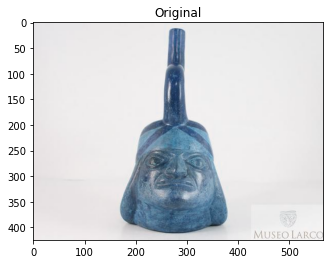

[] sino []
[INFO] processing image 132/310
drive/My Drive/huacos/validimages/sifaces/ML000133a.jpg


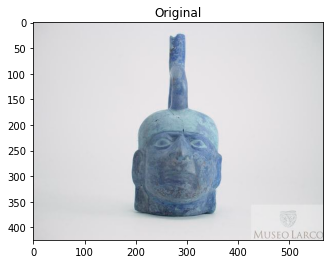

[] sino []
[INFO] processing image 133/310
drive/My Drive/huacos/validimages/sifaces/ML000134a.jpg


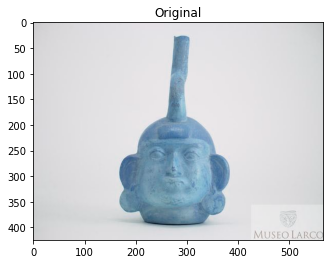

[array([-8.98562372e-02,  2.20947750e-02,  5.43725118e-03, -5.65478429e-02,
       -1.21798746e-01, -9.27645564e-02,  3.14254016e-02, -1.61024630e-01,
        9.43496600e-02, -7.07956254e-02,  1.23002276e-01, -1.40953809e-02,
       -1.84198394e-01, -1.27438769e-01,  7.14419037e-03,  9.96610150e-02,
       -1.45650879e-01, -1.08784035e-01, -1.00967333e-01, -5.57145588e-02,
        2.86530405e-02,  2.54082941e-02,  7.10919499e-02,  1.21532679e-02,
       -8.22712779e-02, -2.29462355e-01, -9.70119685e-02,  4.04725559e-02,
        6.38578385e-02, -4.94818166e-02,  1.33667216e-02,  4.88027930e-02,
       -2.61665285e-01, -6.26905113e-02,  9.54308361e-03,  1.01767436e-01,
       -7.06788525e-02, -7.09443912e-02,  2.08697721e-01,  3.85671109e-03,
       -2.13044271e-01, -6.64840639e-03,  3.03897113e-02,  2.39317775e-01,
        2.10620344e-01, -5.48969060e-02, -2.37852708e-02, -6.76740184e-02,
        1.12876959e-01, -2.36612886e-01,  1.66180171e-03,  1.47406340e-01,
        7.23226443e-02, 

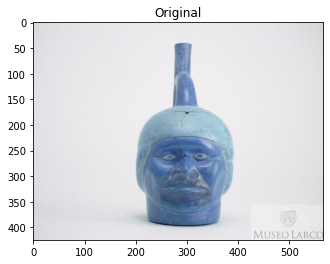

[array([-0.16972601,  0.06144317,  0.0795183 , -0.11627915, -0.10965175,
       -0.04142496,  0.02392555, -0.03543793,  0.12746966, -0.03698134,
        0.20839842,  0.00782274, -0.24412066, -0.0731653 ,  0.01861958,
        0.07292055, -0.08954108, -0.12204523, -0.12326939, -0.12086329,
        0.00132343,  0.02338724,  0.03077574, -0.0497906 , -0.09337968,
       -0.25945938, -0.06809371, -0.09480355,  0.08095597, -0.12652802,
        0.02607141, -0.00077142, -0.23761959, -0.09585129, -0.03432672,
        0.08917625, -0.08446961, -0.08651256,  0.15002614, -0.0290643 ,
       -0.11642776, -0.04820638,  0.06486274,  0.19548777,  0.18741724,
        0.00146726,  0.00957896, -0.05119398,  0.08315738, -0.26455152,
        0.09486379,  0.10598363,  0.14520547,  0.13389026,  0.04949974,
       -0.05703342,  0.0441138 ,  0.11136451, -0.12989457,  0.08397132,
        0.10800835, -0.08744118, -0.11865661, -0.113429  ,  0.21665955,
        0.09260714, -0.07274862, -0.1323612 ,  0.18579227, -0.1

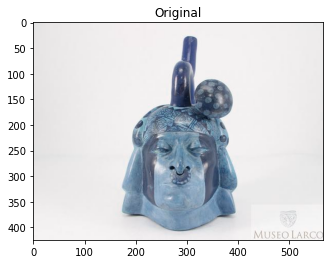

[array([-2.90421396e-02,  9.28608328e-02, -3.43289226e-04, -3.07496265e-02,
       -1.11741960e-01, -5.35337627e-02, -8.57947022e-03, -9.65348929e-02,
        1.49470210e-01, -6.83921948e-02,  1.26335144e-01, -2.72842869e-03,
       -2.32943296e-01, -1.59350038e-02, -2.27967650e-03,  8.69037360e-02,
       -8.48334059e-02, -5.65243289e-02, -1.44706339e-01, -1.06764980e-01,
        1.03220344e-02,  5.47301546e-02,  1.17425919e-02,  4.40405607e-02,
       -4.30299789e-02, -1.69145271e-01, -5.64739779e-02, -1.35176666e-02,
        1.26136243e-01, -7.19609559e-02, -2.04581618e-02,  5.72882593e-02,
       -2.94079810e-01, -9.61462557e-02,  2.18320787e-02,  8.61169025e-03,
       -1.34893321e-02, -7.57233873e-02,  1.53244972e-01,  5.00959903e-03,
       -1.77189082e-01,  3.85371596e-03,  8.53451639e-02,  2.12495297e-01,
        1.71034425e-01, -5.50990328e-02, -5.99475577e-03, -5.57385013e-02,
        9.43019241e-02, -1.68059617e-01, -2.13446803e-02,  1.31586790e-01,
        1.94644809e-01, 

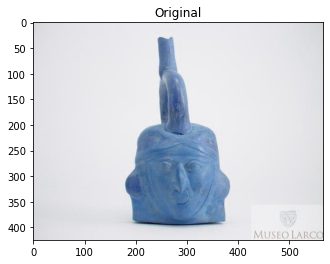

[] sino []
[INFO] processing image 137/310
drive/My Drive/huacos/validimages/sifaces/ML000138a.jpg


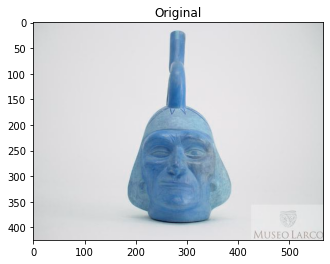

[array([-0.14187139,  0.07081863,  0.05366752, -0.10753357, -0.12758318,
       -0.02980478,  0.00653857, -0.0353193 ,  0.13566957, -0.05037442,
        0.21179262,  0.02396564, -0.18135002, -0.06451974, -0.0307745 ,
        0.12261958, -0.11079716, -0.07890761, -0.14797515, -0.13309306,
        0.051118  ,  0.03995399,  0.036179  ,  0.01748155, -0.1485177 ,
       -0.16895747, -0.06354402, -0.00074145,  0.06122122, -0.14643297,
        0.03466908, -0.00614408, -0.29574353, -0.10569656,  0.01545726,
        0.10518225, -0.10917135, -0.0845878 ,  0.20329615,  0.06634723,
       -0.15739252,  0.0863178 ,  0.07064882,  0.24872206,  0.18157314,
       -0.01355925, -0.004224  , -0.11113261,  0.10059001, -0.24686882,
        0.06872495,  0.19494841,  0.15115693,  0.04245636,  0.03352046,
        0.00520588,  0.02092996,  0.15765804, -0.15961914,  0.05995438,
        0.13869536, -0.09069183, -0.1214448 , -0.14712128,  0.10144508,
        0.12301841, -0.09432876, -0.17814678,  0.16993561, -0.1

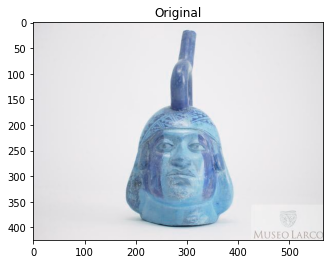

[array([-0.08072236,  0.06503259,  0.08714129, -0.06656254, -0.1369632 ,
       -0.11048816,  0.02172223, -0.05196847,  0.15863118, -0.08667139,
        0.13320515,  0.01974891, -0.17770308, -0.07713346,  0.00312321,
        0.11322491, -0.0944183 , -0.13460934, -0.11552981, -0.09976348,
        0.01395732,  0.00681484,  0.05888949,  0.03654492, -0.06960368,
       -0.29850972, -0.0763889 , -0.03079113,  0.08288956, -0.10149311,
        0.02612443,  0.00200558, -0.22345397, -0.09845864, -0.00495769,
        0.05264708, -0.0758734 , -0.05838207,  0.14872681,  0.01274699,
       -0.19260472, -0.02741416,  0.00721913,  0.26192307,  0.21019901,
        0.02732307,  0.04979603, -0.07570138,  0.07439051, -0.17129764,
        0.05623069,  0.10087833,  0.12939179,  0.03767366,  0.06839827,
       -0.08319321,  0.03821045,  0.12594326, -0.22001961,  0.10632217,
        0.09805237, -0.0982655 , -0.04829255, -0.07685628,  0.17623368,
        0.09640249, -0.06846049, -0.17325222,  0.19301642, -0.2

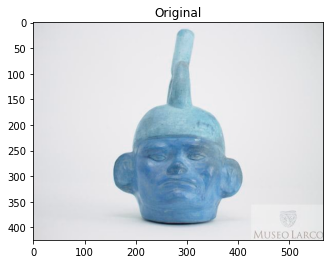

[array([-0.12812597,  0.04396421,  0.04772994, -0.09693588, -0.13621104,
       -0.09277682,  0.01604263, -0.09325556,  0.14741211, -0.01674823,
        0.1863977 , -0.01311018, -0.20304313, -0.09800406, -0.02753209,
        0.07368733, -0.11543839, -0.12920296, -0.06722599, -0.07990798,
        0.07016245,  0.0315276 ,  0.03840233,  0.05045105, -0.09231071,
       -0.213129  , -0.09183057, -0.01670297,  0.0462865 , -0.12678501,
        0.05949324,  0.08910969, -0.2696723 , -0.09803369, -0.03375274,
        0.08499973, -0.05809316, -0.08115949,  0.1831167 ,  0.01357241,
       -0.13456728, -0.02229688,  0.03275142,  0.24284591,  0.21981776,
       -0.07081024, -0.00274915, -0.0061868 ,  0.0469073 , -0.27061629,
       -0.05832418,  0.18828769,  0.13057503,  0.0496022 , -0.0004064 ,
       -0.06516133, -0.01162799,  0.17274505, -0.17203137,  0.10616362,
        0.01505192, -0.15591194, -0.03423662, -0.0938848 ,  0.1805681 ,
        0.10083692, -0.08101887, -0.15701842,  0.1754292 , -0.1

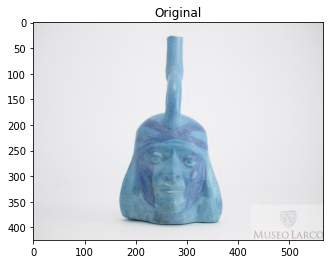

[] sino []
[INFO] processing image 141/310
drive/My Drive/huacos/validimages/sifaces/ML000142a.jpg


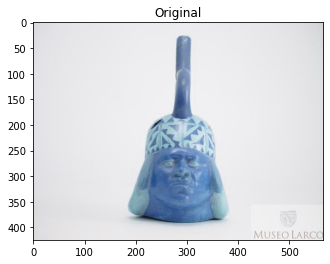

[] sino []
[INFO] processing image 142/310
drive/My Drive/huacos/validimages/sifaces/ML000143a.jpg


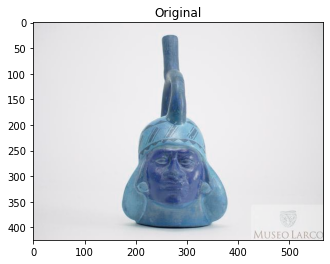

[array([ 0.01308031,  0.03483007,  0.01839525, -0.01912253, -0.15855236,
       -0.0861955 , -0.03301778, -0.07707655,  0.14484541, -0.10894612,
        0.16359264, -0.00103293, -0.18019542, -0.08202899, -0.03227942,
        0.10082913, -0.08785289, -0.09579983, -0.14316696, -0.13476148,
       -0.01704572,  0.00685102,  0.04939183, -0.01312813, -0.12286108,
       -0.20612536, -0.04881111, -0.01655314,  0.12862597, -0.08857725,
       -0.01382115,  0.04367568, -0.2895413 , -0.13453333,  0.01260005,
        0.04580475, -0.09244845, -0.07897295,  0.21349733,  0.01250119,
       -0.1648687 ,  0.06031025,  0.01641176,  0.18797681,  0.20469537,
       -0.05742031,  0.03613792, -0.10970341,  0.08928278, -0.20199159,
        0.00826165,  0.16663824,  0.14625308,  0.08431735, -0.00387231,
       -0.04677792,  0.01100485,  0.19029386, -0.14234495,  0.10300721,
        0.1009805 , -0.10279131, -0.04387173, -0.06479441,  0.18752286,
        0.07723083, -0.06185994, -0.20075089,  0.16987494, -0.1

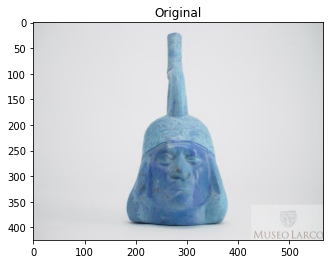

[] sino []
[INFO] processing image 144/310
drive/My Drive/huacos/validimages/sifaces/ML000145a.jpg


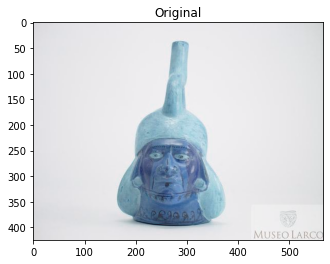

[array([-0.13473588,  0.05868139,  0.05401163, -0.00347874, -0.09472838,
       -0.07917207,  0.04632635, -0.04088576,  0.168304  , -0.03877005,
        0.18753383,  0.02785115, -0.12784843, -0.18456391,  0.02957679,
        0.06131086, -0.11077011, -0.1366308 , -0.07245152, -0.154622  ,
        0.03652023,  0.0163499 , -0.00326122, -0.00064449, -0.11387321,
       -0.24810278, -0.08909074, -0.14393204,  0.11258039, -0.11905713,
        0.02522723,  0.04753679, -0.25565982, -0.12560624, -0.03591636,
        0.04175027, -0.0131426 ,  0.00081494,  0.11761793, -0.02447503,
       -0.108719  ,  0.0085887 ,  0.01424525,  0.27042004,  0.1651172 ,
       -0.04949205, -0.00442309,  0.01576859,  0.04697512, -0.17854711,
       -0.00561195,  0.14043482,  0.1682301 ,  0.05621395,  0.01147423,
       -0.07383904, -0.02055844,  0.06071721, -0.17722668,  0.10717618,
        0.04658319, -0.14512767, -0.13162303, -0.04804025,  0.21652246,
        0.08232732, -0.06465758, -0.1766938 ,  0.18132846, -0.1

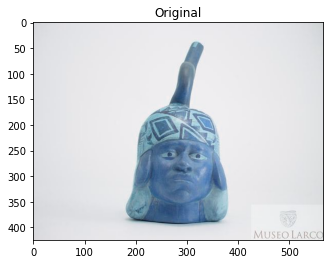

[array([-0.1072858 ,  0.01943838, -0.02527694, -0.05541173, -0.12204321,
       -0.05421306,  0.04587121, -0.07264866,  0.14233907, -0.10194883,
        0.17547379, -0.01380493, -0.17321183, -0.14570041,  0.03256837,
        0.10198987, -0.09190707, -0.14281654, -0.12603553, -0.10156554,
        0.02862662, -0.01142137,  0.02879905,  0.00627989, -0.08769719,
       -0.2425231 , -0.14540729, -0.06566082,  0.06161441, -0.04336207,
        0.03090443,  0.05876118, -0.240045  , -0.11707139,  0.00924467,
        0.03239857, -0.06297763, -0.01800093,  0.13640729, -0.02186178,
       -0.15873086,  0.01267704,  0.04838878,  0.22557503,  0.164386  ,
       -0.03672291, -0.02029984, -0.03427118,  0.03058227, -0.195034  ,
        0.04482758,  0.10949242,  0.23730738,  0.05307397, -0.00794516,
       -0.04489312,  0.04449111,  0.13109463, -0.19234428,  0.06156686,
        0.0415219 , -0.1352822 , -0.11330348, -0.00182218,  0.20019966,
        0.16093728, -0.05562082, -0.19714069,  0.23021069, -0.1

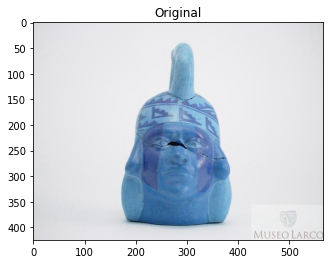

[] sino []
[INFO] processing image 147/310
drive/My Drive/huacos/validimages/sifaces/ML000148a.jpg


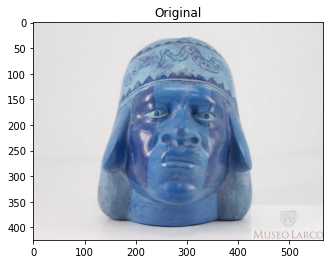

[] sino []
[INFO] processing image 148/310
drive/My Drive/huacos/validimages/sifaces/ML000149a.jpg


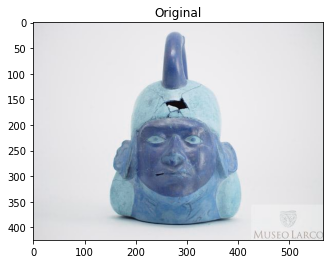

[array([-0.12238026,  0.1222802 ,  0.06612223, -0.04076526, -0.10642711,
       -0.0441989 ,  0.00710222, -0.03240697,  0.14666986, -0.06437299,
        0.23035061,  0.00906346, -0.17431968, -0.1494551 ,  0.01797127,
        0.12898624, -0.13933313, -0.09718645, -0.16507913, -0.09800623,
        0.01834936,  0.03177924,  0.01415495, -0.00617673, -0.11215178,
       -0.24647072, -0.03478517, -0.09170797,  0.04495525, -0.12011427,
        0.04058424, -0.0175163 , -0.28012773, -0.11381994, -0.03109696,
        0.05731616, -0.03394749, -0.00304675,  0.14217713, -0.00533097,
       -0.16423216,  0.0739517 , -0.01011112,  0.20016742,  0.2084215 ,
       -0.01597561, -0.01976341, -0.05945865,  0.0883543 , -0.23988578,
       -0.01288403,  0.15148975,  0.11039191,  0.04009555,  0.00196368,
       -0.03275374, -0.02262911,  0.12630716, -0.15823556,  0.07191598,
        0.08311796, -0.15840235, -0.09360211, -0.07320595,  0.17112514,
        0.06572725, -0.0797562 , -0.15958723,  0.19062684, -0.1

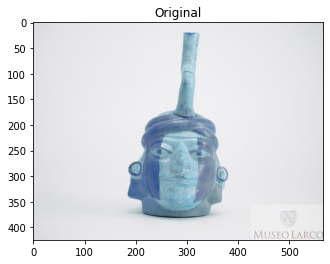

[array([-0.08945844,  0.03789685, -0.00080798, -0.02829605, -0.10086148,
       -0.14421839, -0.0044379 , -0.08417749,  0.12258543, -0.08301145,
        0.08268742,  0.00293197, -0.22787684, -0.07678382,  0.04979353,
        0.13554856, -0.06703173, -0.10037439, -0.16807331, -0.15134859,
        0.00941919,  0.03542322,  0.04969645,  0.02521567, -0.06593406,
       -0.21743989, -0.09489237, -0.04990502,  0.03399367, -0.09168194,
        0.04085007,  0.04601234, -0.29695082, -0.09708354,  0.0170553 ,
        0.05968943, -0.06550045, -0.08012744,  0.19964342, -0.00963731,
       -0.16933069, -0.00995989,  0.0690207 ,  0.20137879,  0.18790267,
       -0.05975518,  0.0278171 , -0.07985228,  0.0788366 , -0.19440714,
       -0.00048006,  0.12617972,  0.14478992,  0.05363796,  0.05906169,
       -0.08014335,  0.04608543,  0.16501415, -0.19041166,  0.08663843,
        0.09818899, -0.1498671 , -0.12070684, -0.0912563 ,  0.21416013,
        0.08231087, -0.09277987, -0.1477991 ,  0.19936001, -0.1

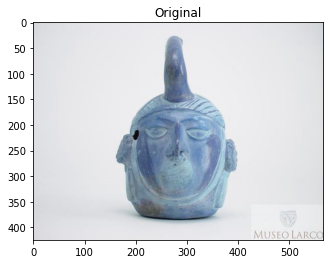

[] sino []
[INFO] processing image 151/310
drive/My Drive/huacos/validimages/sifaces/ML000152a.jpg


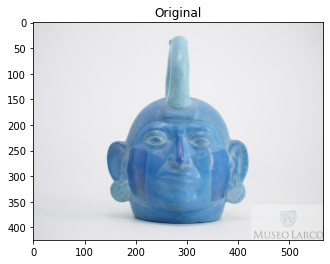

[array([-0.11819828,  0.0434985 ,  0.04911835, -0.00552068, -0.23131046,
       -0.05438061,  0.00393289, -0.08672201,  0.09700885, -0.10442641,
        0.11200586, -0.02022374, -0.22205538, -0.04430106,  0.00993928,
        0.15683033, -0.10246923, -0.131578  , -0.14947841, -0.09199255,
        0.03835182,  0.07297902,  0.05383239,  0.04155318, -0.14216921,
       -0.26334664, -0.03749095, -0.00875004,  0.04916723, -0.07384054,
       -0.00240017,  0.0360106 , -0.27850714, -0.07215115,  0.03535369,
        0.09061973, -0.08113539, -0.06486459,  0.1997893 ,  0.0232346 ,
       -0.21152422,  0.01057825,  0.0711097 ,  0.18875842,  0.18382643,
       -0.03042807,  0.02208852, -0.0540596 ,  0.09294621, -0.28304762,
        0.00328916,  0.14389005,  0.12627262,  0.05067091,  0.01750953,
       -0.06272255,  0.02934102,  0.1694984 , -0.1454329 ,  0.11030608,
        0.09759767, -0.19428587, -0.07117859, -0.05778022,  0.17624348,
        0.08649296, -0.03497471, -0.18543655,  0.16999221, -0.2

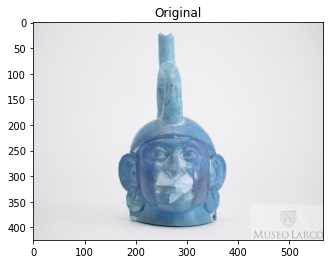

[array([-0.092842  ,  0.04451458,  0.06429441, -0.05466169, -0.10488226,
       -0.10672289, -0.00425458, -0.06851694,  0.16026138, -0.10555496,
        0.13342945, -0.05208221, -0.24827592,  0.00584855, -0.06989583,
        0.17242576, -0.10798541, -0.0620273 , -0.1732177 , -0.16672292,
        0.0606175 ,  0.14619461,  0.05428386,  0.01282815, -0.05004068,
       -0.23681581, -0.07317324, -0.05607925,  0.06402066, -0.13038376,
        0.05542134,  0.09646928, -0.21848904, -0.08802228,  0.06116924,
        0.02037799, -0.06231149, -0.08205859,  0.25961208,  0.00837734,
       -0.18338725, -0.01160647,  0.12213416,  0.23081368,  0.20428666,
       -0.02343298,  0.00596885, -0.13068742,  0.1034239 , -0.26939628,
       -0.03899284,  0.16146781,  0.09534672,  0.07593486,  0.08056995,
       -0.11673368,  0.01595183,  0.1727545 , -0.19631231,  0.12365887,
        0.09849453, -0.18550836, -0.08959463, -0.04029473,  0.18188944,
        0.04951213, -0.1092796 , -0.19065115,  0.24211925, -0.1

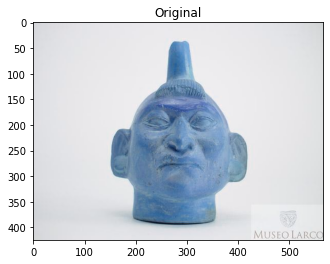

[array([-6.91851377e-02,  4.35446575e-03,  1.63922384e-02, -3.77108082e-02,
       -1.61597401e-01, -1.31814942e-01,  1.91333033e-02, -6.39815703e-02,
        9.78477895e-02, -6.69366866e-03,  9.31230709e-02, -1.10893548e-02,
       -2.36070544e-01, -7.66132772e-02,  4.24747169e-03,  1.03711210e-01,
       -6.78130761e-02, -1.08025506e-01, -1.66316718e-01, -1.63868472e-01,
        5.18018007e-03,  6.69503212e-02,  1.91975310e-02,  1.49676278e-02,
       -8.51368606e-02, -1.73623145e-01, -6.08910993e-02, -4.47899103e-04,
        6.52478635e-02, -6.50510266e-02,  6.34635612e-02,  6.15306273e-02,
       -2.91926146e-01, -1.31541088e-01,  7.35516846e-02,  5.22092283e-02,
       -4.95602190e-02, -9.87491012e-02,  1.38709456e-01, -3.91062535e-02,
       -1.85918003e-01,  2.48160660e-02,  5.89481220e-02,  2.12896764e-01,
        2.03678012e-01, -3.12325060e-02, -4.36913222e-04, -7.61170760e-02,
        1.16342373e-01, -2.44373411e-01,  3.35754976e-02,  1.38877481e-01,
        1.05719805e-01, 

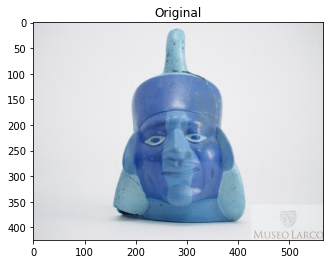

[array([-0.11627394,  0.08276318,  0.0710664 , -0.02165892, -0.05761487,
       -0.05583434, -0.03396204, -0.12041734,  0.14304093, -0.08228567,
        0.13773642, -0.01514437, -0.21879467, -0.05905136,  0.00353152,
        0.16902554, -0.07264547, -0.17757523, -0.16365612, -0.11321861,
       -0.04228722,  0.03372933,  0.02214366, -0.00451795, -0.17049883,
       -0.26507866, -0.06102145, -0.08203366,  0.00082551, -0.0815856 ,
        0.01742487,  0.05183237, -0.27934361, -0.05368872,  0.03956632,
        0.07999042, -0.03424291, -0.02157686,  0.15974489,  0.03131634,
       -0.19236553,  0.03986145,  0.03387748,  0.23235017,  0.20943254,
       -0.03337416, -0.01138081, -0.06283316,  0.03127583, -0.25893995,
       -0.01672018,  0.13406318,  0.12222075,  0.07035705,  0.0513601 ,
       -0.08097823,  0.02043568,  0.10762046, -0.22499062,  0.07350279,
        0.05654419, -0.14191961, -0.10897177, -0.06215277,  0.21912308,
        0.1447067 , -0.09182119, -0.19408725,  0.20523952, -0.1

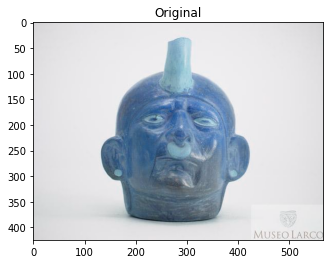

[] sino []
[INFO] processing image 156/310
drive/My Drive/huacos/validimages/sifaces/ML000157a.jpg


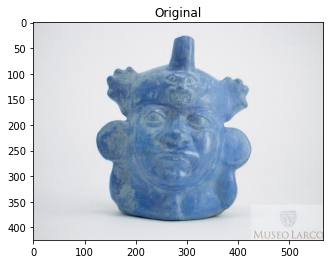

[] sino []
[INFO] processing image 157/310
drive/My Drive/huacos/validimages/sifaces/ML000158a.jpg


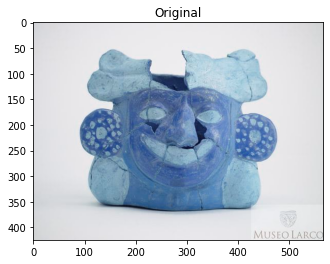

[] sino []
[INFO] processing image 158/310
drive/My Drive/huacos/validimages/sifaces/ML000159a.jpg


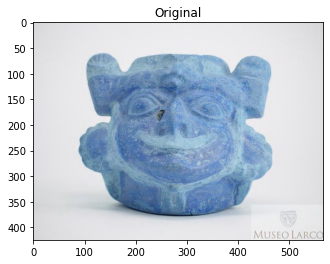

[] sino []
[INFO] processing image 159/310
drive/My Drive/huacos/validimages/sifaces/ML000160a.jpg


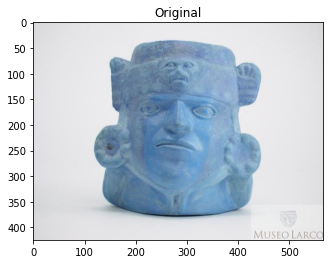

[array([-0.12693539,  0.06558332,  0.01740313, -0.08004964, -0.20068091,
       -0.00189848,  0.03216547, -0.10257974,  0.09760797, -0.00422984,
        0.15645173,  0.00387122, -0.23967782, -0.05058011,  0.04062787,
        0.11582046, -0.04912426, -0.12015128, -0.13770509, -0.06205512,
        0.00573154, -0.02571768,  0.05141591,  0.06507788, -0.17445111,
       -0.20223545, -0.08264163,  0.01496684,  0.0060405 , -0.07843158,
        0.04573358,  0.07874352, -0.27525643, -0.07486833,  0.0023827 ,
        0.0921528 , -0.0859255 , -0.05172309,  0.17529429, -0.00861394,
       -0.16387542,  0.06398806,  0.0969888 ,  0.18909386,  0.20987347,
       -0.01214838,  0.04286617,  0.01510539,  0.05653979, -0.27054805,
       -0.03098479,  0.10964821,  0.13445544,  0.02957404, -0.00366819,
       -0.0829971 ,  0.028168  ,  0.19193541, -0.17308897,  0.13461417,
        0.0472305 , -0.18438704, -0.08745629, -0.10209926,  0.18689893,
        0.13727209, -0.08147319, -0.17777501,  0.16287488, -0.1

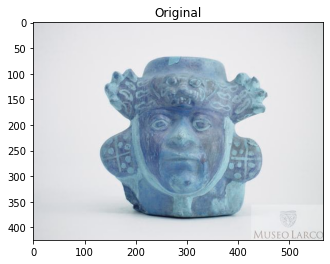

[array([-8.23710263e-02,  6.84089214e-03,  2.25499272e-04, -6.69779107e-02,
       -9.67780054e-02, -8.89273286e-02,  2.02251188e-02, -6.03283308e-02,
        1.20838106e-01, -3.79549563e-02,  1.81502730e-01,  4.76601198e-02,
       -1.70955226e-01, -1.10379808e-01,  1.54778957e-02,  7.95348287e-02,
       -8.36876333e-02, -9.34194922e-02, -1.15154944e-01, -1.06348254e-01,
        6.78455830e-03,  5.54792434e-02,  7.61644244e-02,  4.43124846e-02,
       -1.21658951e-01, -2.06463486e-01, -1.00269817e-01, -6.75146282e-02,
        8.26096237e-02, -4.69630249e-02,  4.55890074e-02,  1.39852837e-02,
       -3.05260569e-01, -5.99580482e-02,  3.32197249e-02,  3.53046507e-02,
       -4.11441475e-02, -5.20124361e-02,  2.20941454e-01,  4.68954220e-02,
       -1.73381194e-01, -2.84429342e-02,  4.20042649e-02,  2.32291937e-01,
        2.06411183e-01, -9.55178589e-02,  1.06999278e-03, -2.49280483e-02,
        6.30304068e-02, -2.03970939e-01,  5.26850149e-02,  1.41053498e-01,
        1.76753640e-01, 

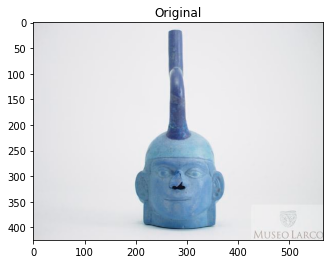

[] sino []
[INFO] processing image 162/310
drive/My Drive/huacos/validimages/sifaces/ML000163a.jpg


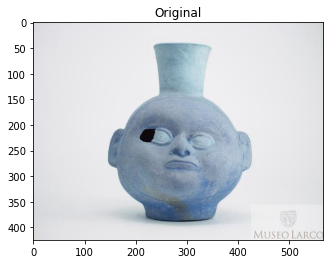

[] sino []
[INFO] processing image 163/310
drive/My Drive/huacos/validimages/sifaces/ML000164a.jpg


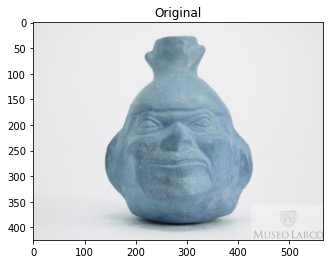

[] sino []
[INFO] processing image 164/310
drive/My Drive/huacos/validimages/sifaces/ML000165a.jpg


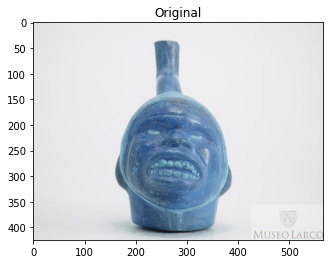

[] sino []
[INFO] processing image 165/310
drive/My Drive/huacos/validimages/sifaces/ML000166a.jpg


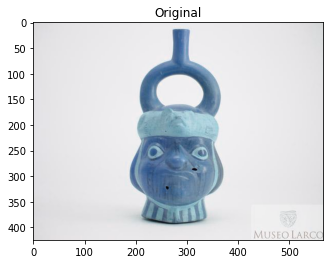

[] sino []
[INFO] processing image 166/310
drive/My Drive/huacos/validimages/sifaces/ML000167a.jpg


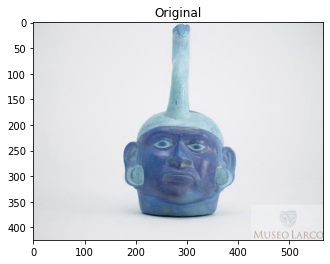

[array([-1.28230706e-01,  6.37070611e-02,  3.10310125e-02, -6.13724738e-02,
       -1.33831635e-01, -8.78431126e-02,  2.63695195e-02, -6.29207343e-02,
        1.35743111e-01, -3.34917605e-02,  2.45229423e-01,  1.20001435e-02,
       -1.74686000e-01, -1.64841563e-01,  6.77766651e-03,  9.62726846e-02,
       -1.23228021e-01, -1.37431592e-01, -1.08901128e-01, -1.29362404e-01,
        6.80035353e-03, -3.02039459e-03,  1.60603225e-02, -1.30854510e-02,
       -7.36022145e-02, -2.59997338e-01, -6.63563982e-02, -9.17847455e-02,
        8.79054517e-02, -9.38231871e-02,  7.95135275e-02,  9.32818651e-03,
       -3.02252918e-01, -1.42951757e-01, -1.17856711e-02,  4.83703315e-02,
       -5.99075854e-02, -4.78478558e-02,  1.54295802e-01, -2.55210996e-02,
       -1.26095191e-01,  2.11208686e-02, -1.14821605e-02,  2.20212892e-01,
        1.92103416e-01, -2.66358256e-03,  1.02692172e-02, -6.08659312e-02,
        8.19535330e-02, -2.20857918e-01,  2.49731727e-02,  1.37836367e-01,
        1.68087125e-01, 

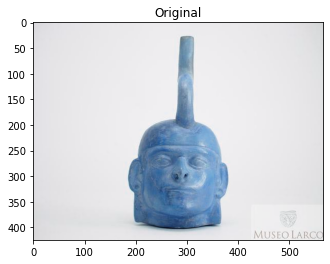

[array([-0.09558289,  0.00040813, -0.02427794, -0.09999066, -0.17551816,
       -0.06046607, -0.00791095, -0.08737013,  0.12711185, -0.01086648,
        0.18331757, -0.01731016, -0.1960291 , -0.11120135, -0.02762577,
        0.06438904, -0.12666711, -0.10631191, -0.10074314, -0.0974154 ,
        0.03088441, -0.01459865, -0.00613429,  0.03080664, -0.10849579,
       -0.19334473, -0.0982079 , -0.05123494,  0.10446256, -0.14563176,
        0.06691036,  0.08563451, -0.29598418, -0.07801944, -0.01782965,
        0.05048884, -0.0382291 , -0.0887561 ,  0.22321492, -0.0351216 ,
       -0.15764737, -0.01271909,  0.03775936,  0.18305427,  0.13522744,
       -0.0426943 ,  0.01633729, -0.0223178 ,  0.13892511, -0.21557757,
       -0.00504671,  0.20404008,  0.12717769,  0.01665865,  0.0543941 ,
       -0.09144755,  0.06368095,  0.14751178, -0.20424531,  0.09534752,
        0.02987497, -0.11596212, -0.06206759, -0.09738542,  0.13979186,
        0.09138333, -0.00570676, -0.22452053,  0.24549775, -0.1

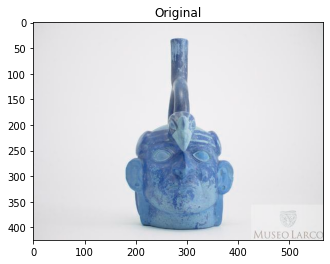

[] sino []
[INFO] processing image 169/310
drive/My Drive/huacos/validimages/sifaces/ML000170a.jpg


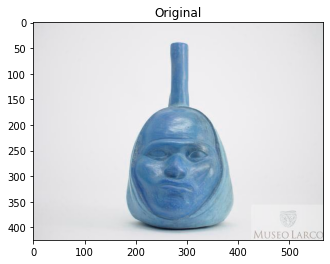

[array([-0.15607432,  0.09928104, -0.0086193 , -0.11357151, -0.12699354,
       -0.0468841 , -0.01302981, -0.0910606 ,  0.13259321, -0.05630845,
        0.18837774, -0.01018097, -0.26852787, -0.1119383 ,  0.02900042,
        0.11278867, -0.08597558, -0.12055985, -0.15098301, -0.12163787,
        0.04635659,  0.04046588,  0.01948796, -0.01248929, -0.15437363,
       -0.2525298 , -0.06130438,  0.02637533, -0.02502854, -0.10325209,
        0.08333841,  0.03268328, -0.29024994, -0.11127005,  0.00525049,
        0.10255405, -0.10576023, -0.0644196 ,  0.14555398,  0.02280235,
       -0.17191647, -0.00364114,  0.09621647,  0.22368278,  0.1754081 ,
       -0.02115022, -0.02142631, -0.0576525 ,  0.05921346, -0.27397323,
       -0.02171153,  0.17728657,  0.07707421,  0.05038711,  0.06455079,
       -0.02297603,  0.02181775,  0.14211078, -0.16543567,  0.04158631,
        0.0950048 , -0.11658817, -0.12472108, -0.14857027,  0.17819518,
        0.11183432, -0.11407491, -0.16422129,  0.17223845, -0.1

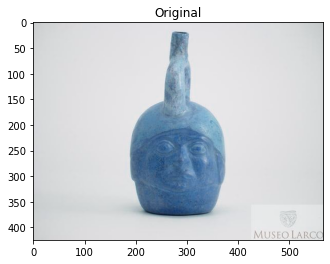

[] sino []
[INFO] processing image 171/310
drive/My Drive/huacos/validimages/sifaces/ML000172a.jpg


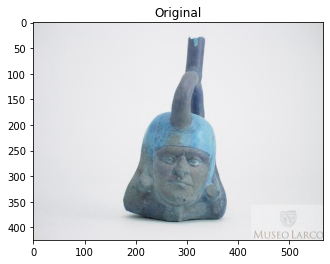

[array([-0.11582078,  0.06971388,  0.00960308, -0.04640713, -0.19082427,
       -0.04265778,  0.03925443, -0.05623496,  0.17387807, -0.06531712,
        0.14200962,  0.04918969, -0.21183246, -0.06913792, -0.05491144,
        0.11613979, -0.06175211, -0.14793514, -0.0811467 , -0.07819373,
        0.07726768,  0.02965433,  0.01980377,  0.01036264, -0.12832841,
       -0.18503764, -0.05747358, -0.04550769, -0.00367808, -0.1020376 ,
        0.103278  ,  0.05597699, -0.29645082, -0.09214194, -0.02496789,
        0.07845119, -0.0332044 , -0.06757329,  0.19100368, -0.02321342,
       -0.16507998,  0.0467513 ,  0.0861492 ,  0.18946402,  0.15554404,
       -0.0721958 ,  0.01884404, -0.07721338,  0.10710693, -0.23136267,
        0.0238745 ,  0.12167753,  0.16848648,  0.0324815 ,  0.04661597,
       -0.05177666,  0.0530302 ,  0.17483944, -0.20262656,  0.11021931,
        0.07050203, -0.07089796, -0.06633431, -0.0534443 ,  0.16454253,
        0.10353085, -0.02953962, -0.16759732,  0.23294485, -0.1

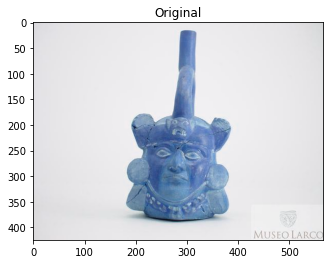

[array([-0.13446781,  0.08130395,  0.0383933 , -0.0525431 , -0.13716099,
       -0.10794993,  0.01199475, -0.10453489,  0.12866363, -0.05946045,
        0.19232015,  0.00611145, -0.14920482, -0.11398666,  0.0098051 ,
        0.1139105 , -0.06258526, -0.12685098, -0.10099512, -0.11949579,
        0.01053172,  0.00530101,  0.03955675,  0.04582978, -0.10505152,
       -0.23868629, -0.07882787, -0.04127916,  0.02851803, -0.09430137,
        0.09168403,  0.05884214, -0.2860491 , -0.08842464, -0.00670363,
        0.09649226, -0.02402738, -0.06572551,  0.23114358, -0.01556767,
       -0.14295048,  0.04802252,  0.0537812 ,  0.19494367,  0.16319942,
       -0.05680779,  0.02394385, -0.04133032,  0.07898378, -0.21118328,
        0.0060858 ,  0.13096274,  0.07751784,  0.01094706, -0.00143646,
       -0.06587638,  0.03780036,  0.13008672, -0.14571482,  0.06178348,
        0.04848123, -0.17214148, -0.12965035, -0.03952999,  0.18205503,
        0.11434006, -0.02456523, -0.14955142,  0.1834327 , -0.1

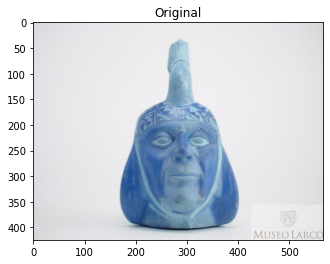

[array([-0.02374867, -0.02076726,  0.04942713, -0.0364227 , -0.10747588,
       -0.05297737,  0.02397212, -0.01571998,  0.14157918, -0.0541508 ,
        0.26621446,  0.05578144, -0.19862649, -0.09649298,  0.04064287,
        0.04016555, -0.06675315, -0.0686833 , -0.16022918, -0.12259184,
       -0.01555637, -0.00855729,  0.04754963, -0.02738532, -0.16599685,
       -0.18079478, -0.13383864, -0.05175308,  0.0795799 , -0.19121893,
        0.0702514 ,  0.04737927, -0.26135325, -0.12471312,  0.03215998,
        0.02757872, -0.02362446, -0.03858467,  0.19793104,  0.00669186,
       -0.11921468,  0.00360241,  0.01842883,  0.23165569,  0.20007741,
       -0.01529481,  0.00552969, -0.04555589,  0.08595292, -0.28992313,
        0.04528959,  0.1234681 ,  0.12191136,  0.06693083,  0.05951205,
       -0.0553896 ,  0.0291603 ,  0.19725114, -0.12829016,  0.11422046,
        0.04235039, -0.16876094, -0.08944607, -0.06417122,  0.12170803,
        0.04682527, -0.06923852, -0.16446838,  0.14621036, -0.1

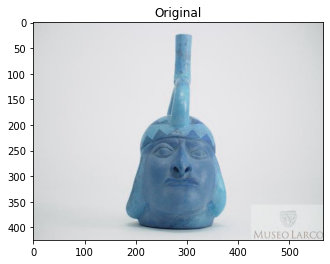

[array([-8.22491199e-02,  5.49760312e-02,  1.18342787e-03, -8.42555389e-02,
       -1.36355028e-01, -4.46607322e-02, -4.01038304e-03, -1.02705136e-01,
        1.90592617e-01, -8.12121034e-02,  5.96538484e-02,  3.25933099e-03,
       -2.15835810e-01, -4.91548255e-02, -2.70910487e-02,  1.21585682e-01,
       -1.48088604e-01, -1.43292189e-01, -1.22350454e-01, -1.53758034e-01,
        2.14544833e-02,  1.18959792e-01, -1.17530674e-03,  3.37233841e-02,
       -8.22336525e-02, -2.18625098e-01, -7.06535876e-02, -2.86584813e-02,
        1.16145596e-01, -7.51817301e-02,  1.03773400e-02,  5.84574193e-02,
       -2.14296818e-01, -6.89784586e-02,  7.29936585e-02,  1.04351610e-01,
       -7.10371733e-02, -1.29731879e-01,  1.79911539e-01, -1.69947743e-05,
       -1.75660402e-01, -1.81820616e-02,  7.09012821e-02,  2.07577422e-01,
        1.63536876e-01,  4.29566205e-03,  1.18449777e-02, -8.86255726e-02,
        1.46783993e-01, -1.83595195e-01,  3.91811021e-02,  1.73481107e-01,
        1.07194908e-01, 

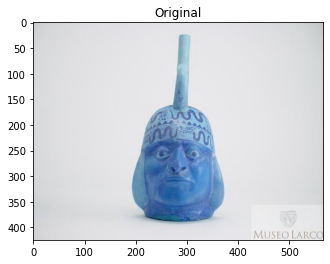

[array([-0.11134186, -0.0010813 , -0.05700479, -0.09100341, -0.13162136,
       -0.0626196 ,  0.04687189, -0.09093411,  0.15091369, -0.0873692 ,
        0.07783821,  0.01280569, -0.19126046, -0.08324154, -0.03619672,
        0.09515502, -0.07829431, -0.19329776, -0.11420733, -0.12354583,
        0.04355073,  0.02299526,  0.0143069 ,  0.05646079, -0.12301131,
       -0.18014884, -0.12168454, -0.06325155,  0.10504226, -0.02927057,
        0.05578657,  0.03774816, -0.27734685, -0.06004072,  0.05694075,
        0.03190406, -0.02176042, -0.04128446,  0.22356185,  0.00479628,
       -0.18821789, -0.02727282,  0.11240237,  0.2343031 ,  0.12988026,
       -0.01660331,  0.01649411, -0.03447536,  0.11158021, -0.20761238,
        0.06028609,  0.13790588,  0.20714185,  0.05137051,  0.06406283,
       -0.10693584,  0.07704322,  0.15729177, -0.16902156,  0.15131061,
        0.04728485, -0.11629198, -0.09483245, -0.0442565 ,  0.17346786,
        0.08634725, -0.05879466, -0.22699319,  0.2314336 , -0.2

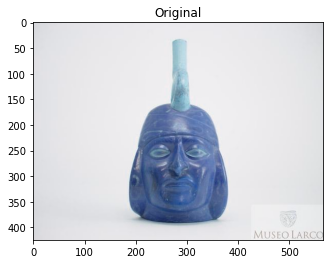

[array([-0.07530595,  0.10900701,  0.05411816, -0.04261509, -0.19503663,
       -0.03814241, -0.03761713, -0.03569287,  0.12401854, -0.07044253,
        0.12305249, -0.01133981, -0.15524018,  0.04379803, -0.10249215,
        0.10523924, -0.11561636, -0.1078285 , -0.10633554, -0.1197354 ,
        0.02410889,  0.08683056,  0.01942631,  0.00320712, -0.11074502,
       -0.22553457, -0.07160337, -0.06343733,  0.06574184, -0.15881704,
       -0.00349075,  0.02694438, -0.2299597 , -0.07304955,  0.01278842,
        0.0397104 , -0.06537138, -0.07729626,  0.23551185,  0.01340577,
       -0.16603196,  0.05069344,  0.13452598,  0.23205934,  0.18943445,
       -0.0232317 , -0.04358646, -0.04661496,  0.06859995, -0.26727086,
        0.03956207,  0.1563729 ,  0.09385294,  0.10284585,  0.00832436,
       -0.07676088,  0.02377803,  0.11891446, -0.12280132,  0.10711959,
        0.08678235, -0.1668694 , -0.1055789 , -0.05180526,  0.20841235,
        0.11919597, -0.05135045, -0.19876945,  0.15931565, -0.1

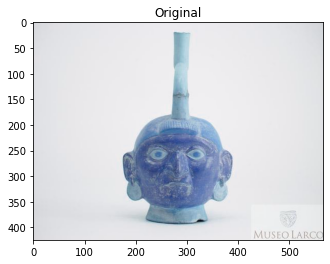

[] sino []
[INFO] processing image 178/310
drive/My Drive/huacos/validimages/sifaces/ML000179a.jpg


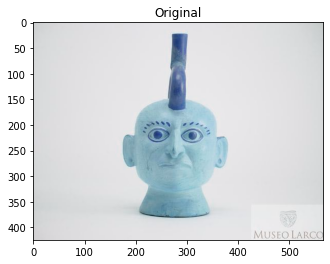

[array([-0.13161345,  0.00381692, -0.02645227, -0.07028937, -0.14674181,
       -0.07296382, -0.02660914, -0.03851567,  0.09159707, -0.08996607,
        0.05445322, -0.06820309, -0.21414305,  0.0342015 ,  0.01766004,
        0.15818468, -0.09636315, -0.07997313, -0.13462269, -0.16208655,
        0.0693111 ,  0.05716609,  0.00670921,  0.0480125 , -0.1085915 ,
       -0.21941137, -0.10167249, -0.02132744,  0.08294433, -0.0933601 ,
        0.0159746 ,  0.03199889, -0.21550542, -0.03770527,  0.06490009,
        0.07781707, -0.05688337, -0.08351739,  0.21596208,  0.04073284,
       -0.16988504,  0.03427051,  0.08802337,  0.21192789,  0.17246944,
        0.01822124,  0.01573122, -0.05373742,  0.08552797, -0.19858113,
        0.06757986,  0.12656906,  0.14616002,  0.07398066,  0.05533145,
       -0.10805143,  0.03408308,  0.14039095, -0.15612234,  0.04281287,
        0.07681178, -0.07615069, -0.06079149, -0.05102589,  0.15601066,
        0.1087831 , -0.06646784, -0.18491119,  0.17767778, -0.1

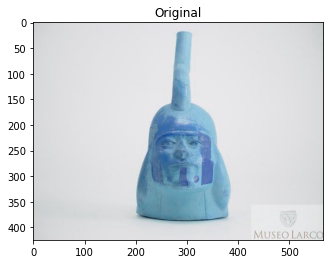

[] sino []
[INFO] processing image 180/310
drive/My Drive/huacos/validimages/sifaces/ML000181a.jpg


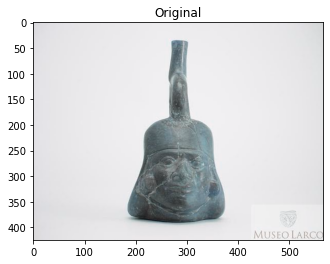

[] sino []
[INFO] processing image 181/310
drive/My Drive/huacos/validimages/sifaces/ML000182a.jpg


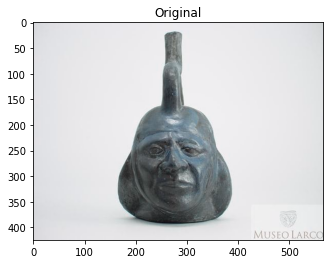

[array([-0.14717487,  0.07555478,  0.01656389, -0.04442317, -0.04460635,
       -0.08022299,  0.03633342, -0.07186345,  0.2043221 , -0.06687671,
        0.20658097,  0.06927407, -0.17548254, -0.1266893 ,  0.05587098,
        0.09206749, -0.08500119, -0.14152156, -0.13068888, -0.08180329,
        0.04367886,  0.00299319,  0.0304824 , -0.0234386 , -0.09902773,
       -0.26396891, -0.07150367, -0.09807494,  0.01386156, -0.15511419,
        0.04610342, -0.02841802, -0.30346856, -0.11469949, -0.03345265,
        0.0548164 , -0.0328445 , -0.00992525,  0.17638893,  0.03291768,
       -0.15510851,  0.04081089,  0.02963188,  0.19630751,  0.19397826,
        0.00242281, -0.00035209, -0.0758765 ,  0.07442557, -0.21139728,
        0.04993557,  0.07937737,  0.19917905,  0.07319772,  0.0320687 ,
       -0.10163672,  0.01234715,  0.07589003, -0.18373528,  0.05822898,
        0.10673319, -0.06735753, -0.13067912, -0.01504959,  0.21847287,
        0.11038244, -0.07336166, -0.14159673,  0.15426362, -0.1

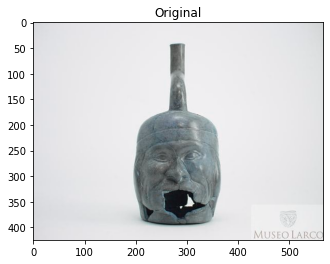

[array([-0.12524575,  0.12494662,  0.01109176, -0.07141884, -0.11089668,
       -0.054409  ,  0.00690432, -0.08920846,  0.13651638, -0.07361327,
        0.16630669, -0.01368485, -0.20079505, -0.08377349,  0.00431756,
        0.16042134, -0.13050272, -0.05530903, -0.10807869, -0.08106501,
        0.02816576,  0.02856434,  0.0157696 ,  0.04746695,  0.01595396,
       -0.21375984, -0.0769578 , -0.03749057,  0.06948757, -0.11994567,
        0.03533581, -0.02006846, -0.27150664, -0.12246978, -0.02088524,
        0.03134743, -0.06401486, -0.03995161,  0.21052556,  0.02008896,
       -0.1430065 ,  0.04885855,  0.07756397,  0.1744349 ,  0.17108947,
        0.02143289, -0.01438197, -0.08184486,  0.11932404, -0.17408957,
       -0.02107686,  0.13479674,  0.14695095,  0.054397  , -0.03491549,
       -0.07694419,  0.00564304,  0.11733316, -0.19233446,  0.07837016,
        0.14341709, -0.12182428, -0.11949125, -0.04607914,  0.20167398,
        0.10123096, -0.09638172, -0.18537417,  0.19791681, -0.1

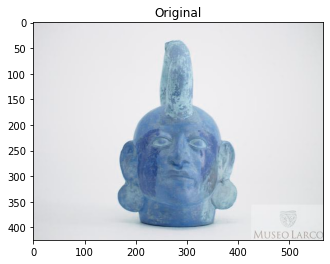

[array([-7.27581829e-02,  8.32709074e-02,  2.51562465e-02, -9.37750563e-02,
       -1.42540559e-01, -6.77303672e-02, -3.25307138e-02, -8.73986706e-02,
        1.46979555e-01, -3.55281904e-02,  9.62928236e-02, -3.40151414e-02,
       -2.18888640e-01, -6.51808381e-02,  5.11531159e-02,  1.39091372e-01,
       -8.47127065e-02, -9.75668877e-02, -1.15473546e-01, -1.01368725e-01,
       -2.24742293e-02,  7.39484280e-02,  2.81456225e-02,  6.55630827e-02,
       -5.62454313e-02, -1.95788741e-01, -2.83963084e-02,  4.94524091e-03,
        1.91964507e-02, -6.41267002e-02,  4.41350788e-03,  7.65961707e-02,
       -2.95475960e-01, -9.55356210e-02,  2.27665380e-02,  1.03433572e-01,
       -5.91756850e-02, -9.26902741e-02,  1.29318342e-01, -1.78672522e-02,
       -1.58856362e-01,  2.64954865e-02,  5.55247739e-02,  1.88475162e-01,
        2.14112788e-01, -1.79806650e-02,  4.17962670e-03, -5.39872013e-02,
        9.51017365e-02, -2.20485851e-01,  1.71161406e-02,  1.35131031e-01,
        9.92332175e-02, 

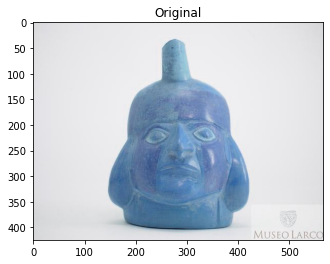

[array([-0.13868098,  0.05534457,  0.03516408, -0.04603769, -0.14018831,
       -0.07896916, -0.01285717, -0.05836374,  0.10408745, -0.04154993,
        0.10539361, -0.00753189, -0.1681314 , -0.04294398,  0.05826213,
        0.14761831, -0.08763529, -0.08482449, -0.1451342 , -0.08476929,
       -0.00807215,  0.01330895,  0.02816457,  0.03444993, -0.06131729,
       -0.24788098, -0.08760038, -0.02490094,  0.02462214, -0.06663157,
        0.07864077,  0.02164758, -0.28319883, -0.06642497, -0.00367065,
        0.05730297, -0.05565367, -0.03586721,  0.17339146,  0.0246553 ,
       -0.19318992,  0.03101554,  0.05245363,  0.20923355,  0.17850465,
       -0.01753458,  0.04618658, -0.01806482,  0.09018441, -0.20077156,
        0.03027644,  0.09325723,  0.16503584,  0.01053837,  0.07164493,
       -0.10975128,  0.03162692,  0.15615949, -0.14427321,  0.07654904,
        0.04987186, -0.08193544, -0.07545704, -0.03806452,  0.20450769,
        0.10159059, -0.07544288, -0.14989793,  0.18171515, -0.0

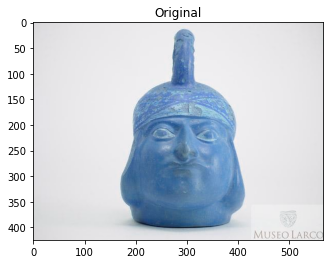

[array([-0.11544323,  0.05230014,  0.02739215, -0.02508877, -0.16074693,
       -0.02481882, -0.00102571, -0.09418227,  0.11661521, -0.05610146,
        0.07130855,  0.00619421, -0.21152584, -0.00500534, -0.01852643,
        0.11177524, -0.11160213, -0.08677801, -0.15734018, -0.13082483,
        0.05736485,  0.10515782,  0.05236454,  0.01483342, -0.13317083,
       -0.24576616, -0.07918255,  0.00199622,  0.03702516, -0.09217677,
        0.01613162,  0.02227922, -0.2793391 , -0.10000309,  0.04240759,
        0.04670517, -0.08937482, -0.06249305,  0.16974625,  0.01465382,
       -0.17092976,  0.02706821,  0.08569451,  0.20263056,  0.18251382,
        0.00381544, -0.00042533, -0.10647377,  0.0750386 , -0.22968972,
        0.02136038,  0.15743132,  0.12642868,  0.0564741 ,  0.03543014,
       -0.07085191, -0.00154073,  0.14222433, -0.12094943,  0.10529806,
        0.08220033, -0.14090045, -0.05140182, -0.09451576,  0.15363441,
        0.09176552, -0.06158093, -0.19412102,  0.19987234, -0.1

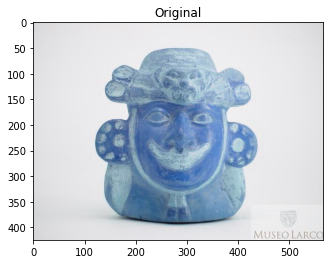

[] sino []
[INFO] processing image 187/310
drive/My Drive/huacos/validimages/sifaces/ML000188a.jpg


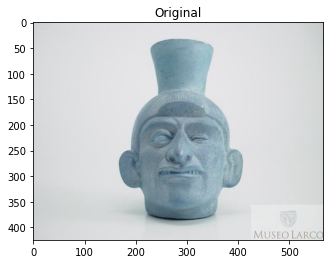

[array([-0.0710178 ,  0.09420846,  0.00326635, -0.04579073, -0.190173  ,
       -0.04255635,  0.00709579, -0.09158126,  0.13026787, -0.02223857,
        0.15861502, -0.023009  , -0.16666697, -0.04195224, -0.02455021,
        0.14177397, -0.07314438, -0.08809582, -0.09899266, -0.09952677,
        0.01846686,  0.00207747,  0.03013999,  0.04333982, -0.11603028,
       -0.19567038, -0.07326761, -0.00892026,  0.07693524, -0.1270473 ,
        0.04060428, -0.00754286, -0.30698442, -0.09033702, -0.00199324,
        0.02776204, -0.09967534, -0.14930037,  0.21300493, -0.01800182,
       -0.14394875,  0.08784572,  0.11335483,  0.13041577,  0.14480883,
       -0.05443833,  0.05804259, -0.1034535 ,  0.0844745 , -0.1572279 ,
        0.00128827,  0.12097993,  0.12754166,  0.05738492, -0.01261044,
       -0.05972669,  0.00352049,  0.14840515, -0.18363538,  0.07599352,
        0.07040273,  0.00155462, -0.09737693, -0.07309227,  0.17428845,
        0.1407263 , -0.05036573, -0.22052191,  0.18629907, -0.1

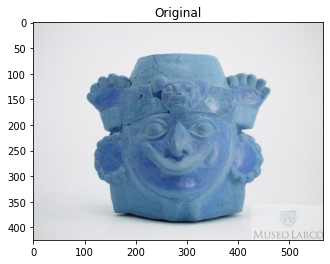

[] sino []
[INFO] processing image 189/310
drive/My Drive/huacos/validimages/sifaces/ML000190a.jpg


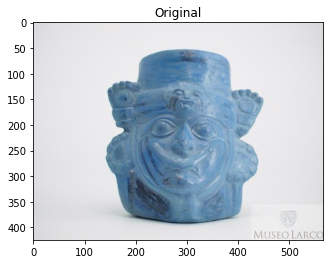

[] sino []
[INFO] processing image 190/310
drive/My Drive/huacos/validimages/sifaces/ML000192a.jpg


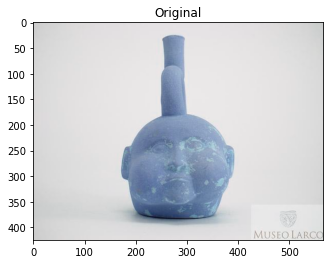

[array([-1.17978603e-01,  9.30155665e-02, -5.67975789e-02, -1.19936831e-01,
       -1.85644060e-01, -4.89169061e-02, -1.40371285e-02, -7.54902661e-02,
        1.23368233e-01, -3.59333530e-02,  1.42703444e-01, -7.57921934e-02,
       -2.78453588e-01, -8.16550106e-02, -7.99851120e-03,  1.37045473e-01,
       -1.71515673e-01, -7.67951831e-02, -1.42226174e-01, -1.67900532e-01,
       -1.77599192e-02,  3.95255908e-02, -3.82113457e-03, -3.45465504e-02,
       -3.64722535e-02, -2.77726710e-01, -4.73857373e-02, -3.51243839e-02,
        4.89270501e-02, -9.77846310e-02,  8.73366222e-02,  8.42207670e-02,
       -2.55795151e-01, -8.77896398e-02,  3.14340070e-02,  5.48359044e-02,
       -8.75594914e-02, -9.28794146e-02,  1.83878541e-01, -2.84927413e-02,
       -9.07038003e-02, -8.01789761e-03,  1.32871509e-01,  2.01906845e-01,
        1.85536131e-01, -3.58660668e-02,  1.48800872e-02, -4.87538315e-02,
        1.32943019e-01, -2.19608292e-01, -2.24850327e-03,  1.50959060e-01,
        1.57239124e-01, 

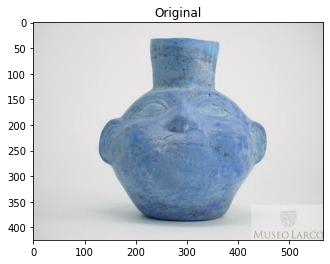

[] sino []
[INFO] processing image 192/310
drive/My Drive/huacos/validimages/sifaces/ML000194a.jpg


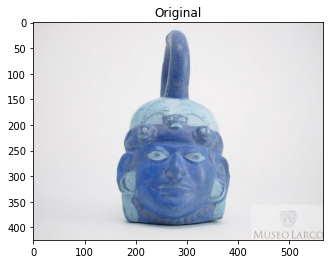

[array([-0.11960727,  0.10808288,  0.08070377, -0.01400386, -0.09199072,
       -0.10455502,  0.02335306, -0.09709676,  0.12631474, -0.02504821,
        0.26374003, -0.07614879, -0.16952883, -0.17689207,  0.027119  ,
        0.10893989, -0.11003221, -0.0953184 , -0.10124816, -0.06699485,
       -0.01410836,  0.00315732,  0.05991221,  0.00303246, -0.09528664,
       -0.28843194, -0.07982208, -0.08838043,  0.09271198, -0.12573233,
       -0.0132083 ,  0.04480628, -0.28111437, -0.11668535, -0.05412036,
        0.08672929, -0.02948308, -0.01867398,  0.13209194,  0.00507833,
       -0.11859891, -0.03087947, -0.03717203,  0.21817872,  0.20678224,
       -0.04046665, -0.01693319,  0.00070197,  0.00848615, -0.23390898,
        0.02633842,  0.13829766,  0.13333766,  0.04536933, -0.00470933,
       -0.05255395, -0.02221256,  0.11321493, -0.09797393,  0.07577629,
        0.09373714, -0.11714482, -0.08790803, -0.04216294,  0.24782671,
        0.09283245, -0.06248928, -0.1065877 ,  0.17179924, -0.0

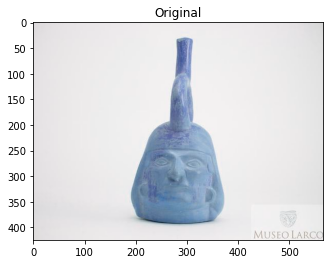

[] sino []
[INFO] processing image 194/310
drive/My Drive/huacos/validimages/sifaces/ML000196a.jpg


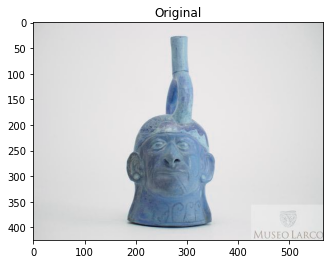

[] sino []
[INFO] processing image 195/310
drive/My Drive/huacos/validimages/sifaces/ML000197a.jpg


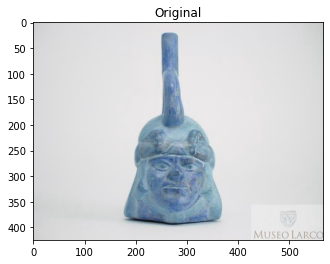

[] sino []
[INFO] processing image 196/310
drive/My Drive/huacos/validimages/sifaces/ML000198a.jpg


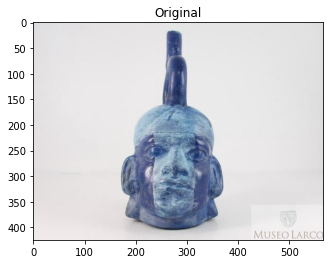

[array([-3.70314419e-02,  6.99516386e-02,  5.15952930e-02, -1.86136886e-02,
       -2.71261744e-02, -1.28762707e-01,  6.08719885e-04, -1.01468727e-01,
        1.33909777e-01, -4.57911789e-02,  1.51166067e-01, -1.99693367e-02,
       -2.22775221e-01, -1.11258253e-01,  4.53981385e-02,  9.13039818e-02,
       -1.33363858e-01, -6.96691498e-02, -1.00682385e-01, -1.31873697e-01,
        5.65249324e-02,  2.71679461e-02,  7.60145187e-02,  2.38116905e-02,
       -1.19977646e-01, -2.53839374e-01, -4.74204794e-02, -5.48821129e-02,
        1.31805800e-02, -9.37763453e-02,  3.91338021e-02,  2.88114157e-02,
       -2.68565089e-01, -6.84774518e-02, -2.27243155e-02,  3.95528562e-02,
        8.59952904e-03, -8.30649957e-03,  1.62114993e-01,  5.79684451e-02,
       -1.65672719e-01, -7.17553496e-03,  1.25453100e-02,  2.25835383e-01,
        2.19171643e-01,  1.11795515e-02, -2.48189643e-03,  9.67141241e-04,
        7.38971531e-02, -2.06001878e-01, -5.84339909e-03,  1.26938611e-01,
        1.13950491e-01, 

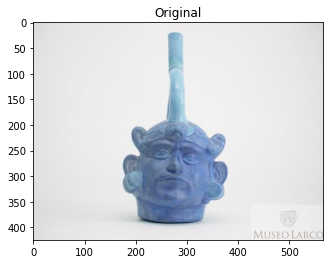

[array([-0.12036484,  0.04543408,  0.04224215, -0.08024888, -0.18621252,
        0.00495322, -0.03780897, -0.06011812,  0.1041491 , -0.05285737,
        0.1382055 ,  0.02470636, -0.17578743, -0.01029071,  0.01257452,
        0.09462728, -0.06370902, -0.08547853, -0.11910219, -0.10422935,
       -0.00113375,  0.04679935,  0.01717488,  0.01353288, -0.12459739,
       -0.21717755, -0.1010246 ,  0.04885401,  0.06420968, -0.07790928,
        0.04658953,  0.0165818 , -0.28006414, -0.07745124,  0.02061014,
        0.07837747, -0.13243601, -0.06452295,  0.20142417,  0.02982314,
       -0.17042638,  0.0468364 ,  0.10030539,  0.21315144,  0.17480473,
       -0.01949434,  0.03676882, -0.0118079 ,  0.06208691, -0.23710188,
       -0.00411126,  0.18857899,  0.16401617,  0.04051998,  0.02663299,
       -0.0457623 ,  0.03493623,  0.21185678, -0.13561565,  0.1223711 ,
        0.06904681, -0.10550205, -0.0456186 , -0.04485947,  0.1767772 ,
        0.10049403, -0.07603529, -0.2185322 ,  0.1448195 , -0.1

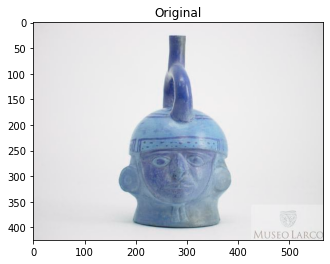

[array([-9.29781646e-02,  2.75465474e-02,  2.88257003e-03, -3.66097987e-02,
       -1.27835482e-01, -9.16307569e-02, -1.67297460e-02, -3.82542759e-02,
        1.18870415e-01, -5.77994883e-02,  1.51880652e-01, -8.11219215e-05,
       -1.58849627e-01, -9.35280621e-02, -1.90823972e-02,  1.20186567e-01,
       -9.32178274e-02, -1.29866555e-01, -1.04555830e-01, -1.27448261e-01,
        5.16299605e-02, -1.33878291e-02, -3.27107832e-02,  1.45399570e-03,
       -1.88090533e-01, -1.78856134e-01, -5.37324175e-02, -9.95572656e-02,
        8.91906917e-02, -1.11086711e-01,  2.92296931e-02,  5.83775118e-02,
       -2.50411510e-01, -7.33332038e-02,  1.09406710e-02,  8.10602605e-02,
       -4.06522825e-02, -6.54070675e-02,  1.80693567e-01,  5.03265448e-02,
       -1.68135017e-01,  6.87787905e-02,  6.91339374e-03,  1.93535641e-01,
        1.90945834e-01, -2.19910443e-02,  1.11067779e-02, -6.31054789e-02,
        1.16976477e-01, -2.65344322e-01,  8.37098807e-04,  1.80141732e-01,
        1.26035795e-01, 

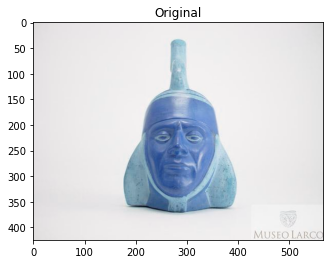

[array([-0.11624929,  0.05023295,  0.02555898, -0.07548296, -0.11849891,
       -0.02465208,  0.03368444, -0.10139063,  0.11183209, -0.06696722,
        0.22419932,  0.02745745, -0.18394235, -0.09617606,  0.04401305,
        0.07698289, -0.0943298 , -0.0926924 , -0.15069014, -0.13387839,
        0.02436115,  0.02742567,  0.03918656,  0.00458694, -0.1825251 ,
       -0.21338069, -0.06701813, -0.05278575,  0.0017361 , -0.12090024,
        0.06468544,  0.00500149, -0.28144541, -0.07679939,  0.01606237,
        0.07371335, -0.11019164, -0.06111138,  0.20088886, -0.01632726,
       -0.11628024,  0.03030034,  0.08101627,  0.23084626,  0.14961319,
       -0.08127639,  0.01040899, -0.05117536,  0.10910639, -0.23370287,
        0.0345608 ,  0.13589646,  0.14938681,  0.09702249,  0.05356269,
       -0.03080326,  0.04458339,  0.18616363, -0.15510881,  0.10388244,
        0.07269394, -0.1338484 , -0.10276084, -0.0951167 ,  0.18813646,
        0.13200296, -0.07567786, -0.19773987,  0.13095418, -0.0

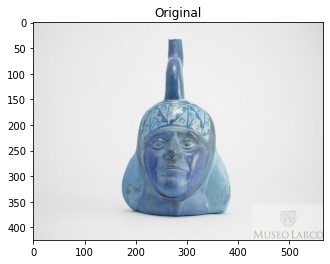

[array([-1.31162912e-01,  2.27038190e-02,  3.16014141e-03, -5.47093078e-02,
       -1.48606017e-01, -3.33888382e-02,  4.95012850e-04, -4.32714857e-02,
        1.36351407e-01, -8.23595375e-02,  1.61633477e-01,  4.47250307e-02,
       -2.04495803e-01, -4.74585667e-02,  1.04092881e-02,  1.00426845e-01,
       -9.24045146e-02, -6.36873841e-02, -1.72731295e-01, -1.57079354e-01,
        3.66145670e-02,  5.36472499e-02,  3.71915698e-02, -3.90750393e-02,
       -1.90392032e-01, -2.28504568e-01, -1.08436890e-01, -4.30334359e-02,
       -1.00814179e-02, -1.16249278e-01,  6.85748830e-02,  5.05737215e-03,
       -3.12328994e-01, -1.04827017e-01,  5.27439937e-02,  1.73239447e-02,
       -7.75925741e-02, -3.04148793e-02,  2.19645604e-01,  3.18433642e-02,
       -1.52162075e-01,  4.21844423e-02,  1.29442468e-01,  1.81431353e-01,
        1.95977047e-01,  1.97020173e-03, -3.56363058e-02, -8.57529268e-02,
        9.89172831e-02, -2.88284063e-01,  2.14029215e-02,  1.72723860e-01,
        9.51421261e-02, 

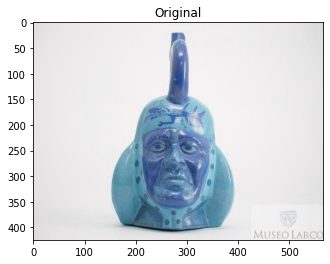

[array([-0.12944391,  0.11281308,  0.05088576, -0.05707587, -0.0997961 ,
       -0.0944015 ,  0.02195185, -0.09839044,  0.12892866, -0.07884771,
        0.21572509, -0.04282261, -0.1544321 , -0.09057522,  0.02657874,
        0.08430409, -0.06979483, -0.13866264, -0.09913993, -0.14481789,
        0.007837  , -0.01223937,  0.00726349,  0.03377156, -0.08664385,
       -0.26578107, -0.09657654, -0.08752492,  0.03721198, -0.09990036,
        0.06812366, -0.01576146, -0.3020654 , -0.09869234, -0.04681025,
        0.03025822, -0.03355923, -0.03110212,  0.19082038, -0.01381198,
       -0.12631941,  0.05583626,  0.01669497,  0.23882864,  0.15070462,
       -0.03513773, -0.01860594, -0.01280072,  0.02656408, -0.20244628,
        0.04855683,  0.13855015,  0.15239725,  0.04353885, -0.00903257,
       -0.0191316 ,  0.01259205,  0.05504806, -0.16644779,  0.03166139,
        0.09897051, -0.11201335, -0.15364735, -0.04318702,  0.22604018,
        0.1295099 , -0.04586725, -0.13075657,  0.19698368, -0.1

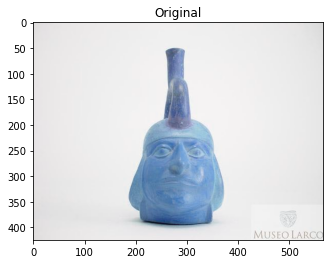

[array([-0.04001114, -0.00150319, -0.02523874, -0.01157358, -0.13887051,
       -0.08743887,  0.00234389, -0.04983567,  0.15821549, -0.08131304,
        0.15135366, -0.00182512, -0.25009671, -0.04008789, -0.00906359,
        0.09872329, -0.07928015, -0.06393443, -0.21646355, -0.09042542,
        0.04274702,  0.02956614, -0.00546815, -0.02021768, -0.12569374,
       -0.25174379, -0.1113072 , -0.02752609,  0.04772685, -0.08556475,
        0.07205674,  0.01392272, -0.2439561 , -0.10987933,  0.03261375,
        0.01115312, -0.07200623, -0.0435908 ,  0.16769865, -0.01286949,
       -0.20157579,  0.03105111,  0.03865512,  0.16454709,  0.15985005,
        0.02916804,  0.02901028, -0.16744824,  0.08084916, -0.24932262,
        0.04883169,  0.13889323,  0.13008681,  0.06526519,  0.11638146,
       -0.0794715 ,  0.02400983,  0.18169954, -0.180245  ,  0.08400872,
        0.05605219, -0.0865804 , -0.07856882, -0.11060507,  0.11573106,
        0.06309599, -0.04784936, -0.20408279,  0.22391638, -0.2

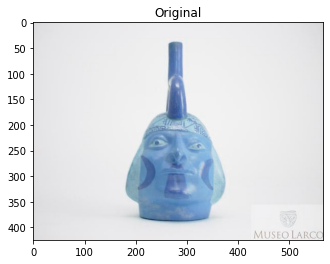

[array([-1.00746453e-01,  1.47704147e-02, -2.53905803e-02, -1.71338841e-02,
       -8.81930813e-02, -6.23845160e-02,  4.53855358e-02, -7.48623461e-02,
        1.26136526e-01, -7.20845014e-02,  1.13317579e-01,  2.49741077e-02,
       -2.31042340e-01, -1.04181632e-01,  3.25204730e-02,  1.09933138e-01,
       -1.16346441e-01, -1.64581105e-01, -1.53734952e-01, -1.08714469e-01,
        5.50484955e-02,  3.38419303e-02,  1.64789744e-02,  3.37904505e-02,
       -1.40364692e-01, -2.11598128e-01, -1.04991034e-01, -1.25966929e-02,
        5.12742102e-02, -8.91734585e-02,  4.95741069e-02,  7.52993524e-02,
       -2.19004497e-01, -7.53858685e-02,  8.62890482e-02,  5.08825555e-02,
        1.29218176e-02, -1.66658722e-02,  1.79329887e-01, -8.68517905e-03,
       -2.09321529e-01, -1.39140189e-02,  7.93125331e-02,  2.39000693e-01,
        1.43329471e-01, -1.18170679e-03,  8.69609788e-03, -5.65132312e-02,
        7.85746276e-02, -1.86282873e-01, -1.09516233e-02,  1.58684686e-01,
        1.38011187e-01, 

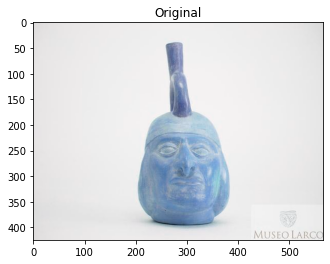

[array([-1.23826697e-01,  6.64379150e-02, -1.70631483e-02, -7.80606568e-02,
       -1.67778909e-01, -5.77027351e-02, -2.85450742e-02, -9.68599021e-02,
        1.59084812e-01, -6.11232594e-02,  1.01203412e-01,  3.06350142e-02,
       -1.40907332e-01, -6.73894882e-02, -3.82966176e-02,  1.04457632e-01,
       -8.41603950e-02, -1.02820687e-01, -1.14154398e-01, -1.61113620e-01,
        5.67640215e-02,  5.09223938e-02,  7.70800561e-03,  1.72269680e-02,
       -1.64530739e-01, -1.68924198e-01, -7.94400424e-02, -3.35666612e-02,
        5.86441010e-02, -1.05663136e-01,  5.18042147e-02, -1.70178413e-02,
       -3.22491437e-01, -1.11164771e-01,  2.59902924e-02,  6.40597567e-02,
       -7.23920390e-02, -8.56285319e-02,  1.97632656e-01,  1.11610219e-02,
       -1.30216554e-01,  6.58414736e-02,  7.46199936e-02,  1.96190327e-01,
        1.46316335e-01, -5.57563603e-02,  5.70791028e-03, -7.25538209e-02,
        1.35994911e-01, -1.79840922e-01,  3.59031633e-02,  1.38880506e-01,
        1.25747487e-01, 

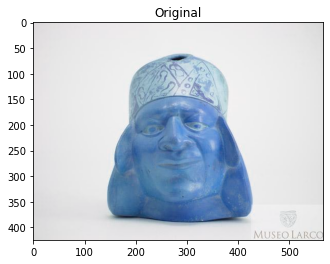

[array([-9.48258936e-02,  6.71031475e-02,  3.14950161e-02, -1.17373466e-02,
       -1.20284326e-01, -3.37366313e-02,  3.24064493e-03, -5.50105609e-02,
        1.31416649e-01, -3.18039730e-02,  1.79823399e-01, -1.87921673e-02,
       -2.33739436e-01, -9.73541364e-02,  4.41779792e-02,  1.05949879e-01,
       -8.89392644e-02, -1.34905845e-01, -2.07777768e-01, -1.19802475e-01,
       -5.38225770e-02, -1.85060389e-02,  1.81261450e-03, -2.53023021e-02,
       -2.26367399e-01, -2.49533027e-01, -4.35253941e-02, -8.41889381e-02,
        6.41488880e-02, -1.20050356e-01,  1.95112899e-02,  6.18970692e-02,
       -2.53581971e-01, -9.54448581e-02,  6.24270774e-02,  9.13670659e-02,
       -6.67482093e-02, -2.22919583e-02,  1.62562951e-01, -2.69893352e-02,
       -1.48666412e-01, -2.84038484e-04,  7.74153769e-02,  2.19101310e-01,
        2.16936514e-01,  2.77515426e-02, -1.81882903e-02, -6.96319044e-02,
        1.41609997e-01, -2.91769624e-01,  3.74076962e-02,  1.29561841e-01,
        1.28015116e-01, 

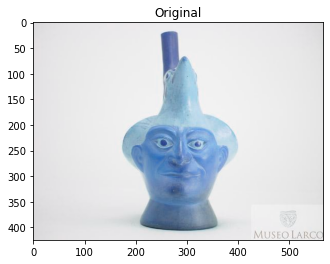

[array([-0.05705073,  0.00065125,  0.00642569, -0.03278448, -0.10931317,
       -0.07259025, -0.0048837 , -0.11638427,  0.11253649, -0.1214888 ,
        0.10716732,  0.00592251, -0.19739686, -0.0479742 ,  0.0261401 ,
        0.11112244, -0.09463154, -0.13122152, -0.14459114, -0.12566763,
        0.01999465,  0.04007142,  0.10658373,  0.00261202, -0.11558084,
       -0.22452173, -0.12891223, -0.04875718,  0.10995887, -0.04000271,
        0.01878533,  0.03321752, -0.2519457 , -0.08448041,  0.018208  ,
        0.08479682, -0.06862044, -0.11523943,  0.21271622,  0.02036541,
       -0.1590113 ,  0.00309771,  0.03769918,  0.19854939,  0.18137553,
       -0.05558542,  0.05116815, -0.06588644,  0.0287862 , -0.16188033,
        0.05208749,  0.11354491,  0.21369657,  0.08330073,  0.02373771,
       -0.05080493,  0.05277706,  0.21838993, -0.18305866,  0.04224112,
        0.07013126, -0.04787471, -0.02743364, -0.04537382,  0.19984053,
        0.12029816, -0.06129026, -0.13636917,  0.17321576, -0.1

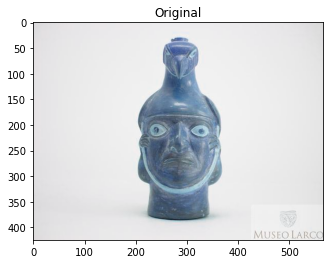

[array([-0.11721915,  0.0970029 ,  0.01185383, -0.02301902, -0.13029993,
       -0.04479402,  0.02077798, -0.04136031,  0.11755076,  0.00358334,
        0.16843358, -0.01403442, -0.24068227, -0.04107581, -0.05238909,
        0.0897215 , -0.10275361, -0.05629631, -0.17517275, -0.12689736,
        0.03411841,  0.04853731,  0.00549939, -0.01313693, -0.1163107 ,
       -0.19635379, -0.03471577, -0.08142985,  0.0586241 , -0.18715571,
        0.04837465,  0.00874602, -0.26045591, -0.09468029, -0.01374349,
        0.04888362, -0.06199847, -0.02637623,  0.19144616, -0.0123621 ,
       -0.14158577,  0.06454091,  0.06402567,  0.21738008,  0.1626817 ,
        0.00171292, -0.07467084, -0.05354705,  0.11662398, -0.28378487,
        0.02957932,  0.15027779,  0.08932573,  0.08251546,  0.04742685,
       -0.07230946, -0.00329843,  0.13409722, -0.16595298,  0.09094698,
        0.07850928, -0.16207527, -0.11986996, -0.12308185,  0.14026816,
        0.08874857, -0.07000765, -0.13691804,  0.17048885, -0.1

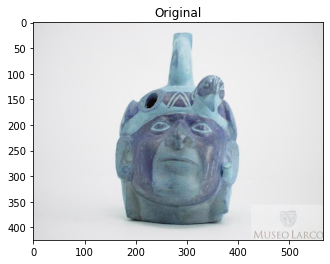

[] sino []
[INFO] processing image 209/310
drive/My Drive/huacos/validimages/sifaces/ML000211a.jpg


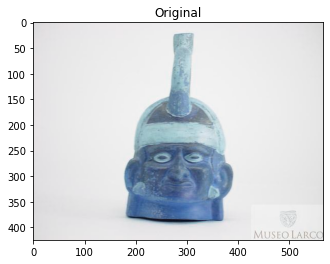

[] sino []
[INFO] processing image 210/310
drive/My Drive/huacos/validimages/sifaces/ML000212a.jpg


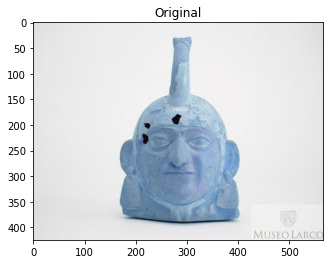

[] sino []
[INFO] processing image 211/310
drive/My Drive/huacos/validimages/sifaces/ML000213a.jpg


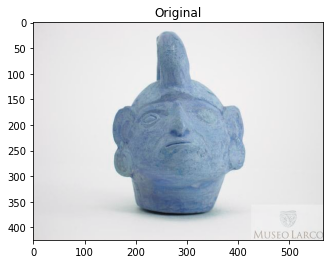

[] sino []
[INFO] processing image 212/310
drive/My Drive/huacos/validimages/sifaces/ML000214a.jpg


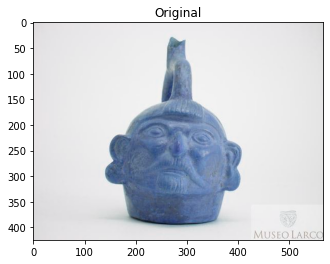

[] sino []
[INFO] processing image 213/310
drive/My Drive/huacos/validimages/sifaces/ML000215a.jpg


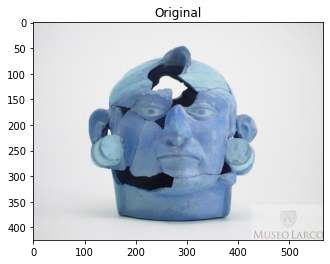

[] sino []
[INFO] processing image 214/310
drive/My Drive/huacos/validimages/sifaces/ML000216a.jpg


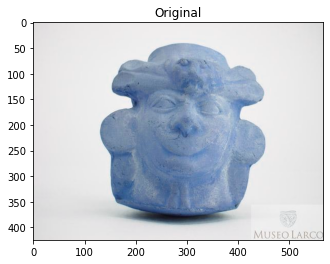

[] sino []
[INFO] processing image 215/310
drive/My Drive/huacos/validimages/sifaces/ML000217a.jpg


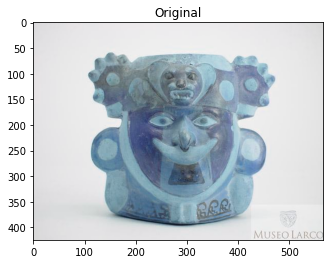

[array([-1.31904602e-01,  1.12781681e-01,  4.44378927e-02, -5.94579950e-02,
       -8.69041234e-02, -5.92918694e-02,  1.64184496e-02, -9.96200815e-02,
        1.08757526e-01, -1.39130652e-02,  1.19266361e-01, -5.11611402e-02,
       -3.05099845e-01, -7.24790171e-02,  4.43228856e-02,  1.13310680e-01,
       -9.92546752e-02, -1.13923192e-01, -1.80944324e-01, -1.39292017e-01,
        6.63082302e-02,  8.42887163e-02,  5.63210398e-02,  4.59654108e-02,
       -1.90428376e-01, -1.87221676e-01, -1.37723386e-02, -5.34976870e-02,
       -2.60371119e-02, -1.36665851e-01,  6.31201267e-02,  1.06818438e-01,
       -2.32887402e-01, -8.08363855e-02,  1.33900940e-02,  1.04485244e-01,
       -2.87570581e-02, -9.31934863e-02,  1.29061416e-01, -4.22694460e-02,
       -1.58539504e-01, -5.76665848e-02,  1.16794735e-01,  2.44323254e-01,
        1.79815799e-01, -4.32062596e-02,  1.52277313e-02,  1.85929239e-02,
        7.15464875e-02, -2.79190183e-01, -4.91838269e-02,  1.35993108e-01,
        1.07530348e-01, 

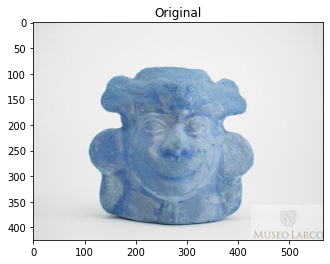

[] sino []
[INFO] processing image 217/310
drive/My Drive/huacos/validimages/sifaces/ML000219a.jpg


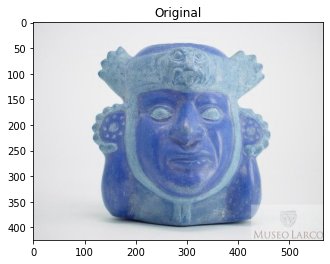

[array([-0.05251142,  0.07356467, -0.01424749, -0.06094825, -0.10968284,
       -0.07224923,  0.01304311, -0.09110718,  0.1346111 , -0.02575213,
        0.21574819,  0.01390937, -0.17479306, -0.13902487, -0.02034466,
        0.08470708, -0.11988387, -0.05365307, -0.11859545, -0.11023451,
        0.0038895 , -0.02115787,  0.03384767,  0.01965025, -0.12460166,
       -0.18306343, -0.07636008, -0.01453616,  0.03783607, -0.08200776,
        0.10150314,  0.0746789 , -0.27828673, -0.12539466,  0.02014691,
        0.05818974, -0.06724227, -0.02929525,  0.19120142, -0.00177774,
       -0.10046223,  0.05614498,  0.03797057,  0.24733078,  0.198827  ,
       -0.03520308,  0.00328377, -0.06181731,  0.11087468, -0.21099639,
       -0.00553772,  0.177141  ,  0.18363911,  0.01084963,  0.01220982,
       -0.02862796,  0.01115261,  0.15645525, -0.20641449,  0.05662343,
        0.04514283, -0.10812103, -0.09993622, -0.10495581,  0.15642963,
        0.10955389, -0.09383484, -0.18275341,  0.21257895, -0.1

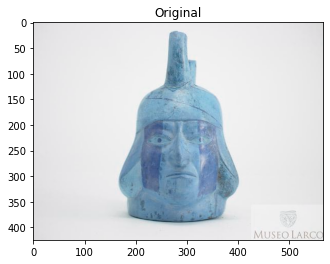

[] sino []
[INFO] processing image 219/310
drive/My Drive/huacos/validimages/sifaces/ML000221a.jpg


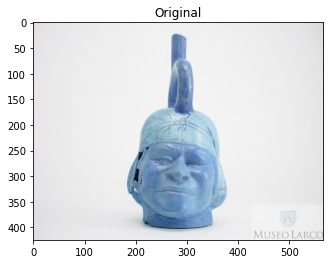

[array([-0.08977827,  0.04666237, -0.01332524, -0.0911551 , -0.15021409,
       -0.07992505, -0.0277613 , -0.1406433 ,  0.14784649, -0.01240589,
        0.18581629,  0.00261617, -0.2020312 , -0.077415  , -0.01067922,
        0.07399182, -0.09012242, -0.10343639, -0.12560159, -0.01981946,
       -0.01294252, -0.02545102,  0.08121616,  0.01142602, -0.06117807,
       -0.22583464, -0.1181579 , -0.02492786,  0.07105576, -0.07102872,
        0.08673561,  0.07594083, -0.31193471, -0.12540935,  0.01811267,
        0.03113119, -0.1040886 , -0.09012436,  0.20319907, -0.03722076,
       -0.14710516,  0.03537721,  0.03370328,  0.15622297,  0.20649092,
        0.02021045,  0.05107915, -0.11872347,  0.09813503, -0.14867754,
        0.00453486,  0.1516638 ,  0.14573024,  0.00763036,  0.03317592,
       -0.03289686,  0.02023904,  0.1596401 , -0.19743048,  0.06232619,
        0.07049412, -0.0096954 , -0.07473256, -0.12219356,  0.18083146,
        0.09967552, -0.06522048, -0.19832881,  0.24222577, -0.1

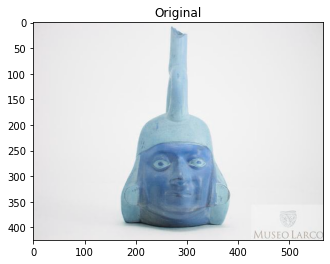

[array([-1.54061064e-01,  1.03925690e-02,  3.13366987e-02, -5.03488183e-02,
       -5.25805019e-02, -7.92238712e-02,  3.91577184e-03, -1.09060742e-01,
        1.35450959e-01, -8.98749679e-02,  1.59342825e-01,  1.47370994e-02,
       -1.49599627e-01, -1.10832624e-01,  9.37554240e-03,  1.16651401e-01,
       -1.48525655e-01, -1.30156383e-01, -9.06171352e-02, -1.38711512e-01,
        3.29311192e-02,  8.48660767e-02,  4.79534790e-02,  1.75743066e-02,
       -1.12184271e-01, -1.85473680e-01, -6.30165562e-02, -1.15470357e-01,
        9.16961804e-02, -5.74198514e-02,  9.03296992e-02,  5.96105158e-02,
       -2.18661413e-01, -2.29718648e-02,  7.92008638e-03,  3.09998095e-02,
        3.25799435e-02, -1.88047811e-02,  1.79301128e-01, -7.98790157e-03,
       -1.62282363e-01, -9.96742994e-02,  3.43644470e-02,  2.38429546e-01,
        1.77348852e-01, -4.84221429e-03, -2.31874362e-03, -3.04020680e-02,
        6.36762604e-02, -2.08052725e-01,  3.32907476e-02,  9.29943398e-02,
        1.03422247e-01, 

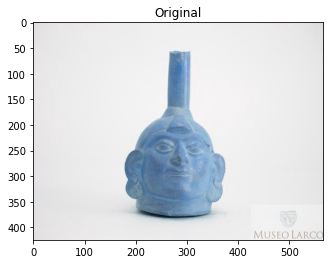

[array([-0.13215752, -0.03440909,  0.04006823, -0.04906732, -0.1736325 ,
       -0.11733918,  0.00190228, -0.07154223,  0.11268875, -0.05637814,
        0.13531263,  0.00632673, -0.18562931, -0.05449586,  0.00803664,
        0.12308981, -0.11907086, -0.08751298, -0.10482241, -0.14364593,
        0.05630096,  0.08905292,  0.04510011, -0.02119742, -0.12892276,
       -0.22008024, -0.08160768,  0.00062921,  0.06904867, -0.0549887 ,
        0.03309814,  0.08794685, -0.24814034, -0.06356707,  0.07450077,
        0.05527031, -0.05587599, -0.10235252,  0.20085998,  0.00850796,
       -0.14986703, -0.02523826,  0.0974655 ,  0.18660831,  0.19801176,
       -0.0351737 ,  0.02255613, -0.06038557,  0.08602162, -0.18662764,
        0.06264991,  0.12108368,  0.13421264,  0.0525671 ,  0.04254194,
       -0.10268284, -0.00594315,  0.18433453, -0.15971363,  0.08568421,
        0.07192757, -0.14237045, -0.07407195, -0.11035413,  0.16193116,
        0.11849812, -0.06216394, -0.22530408,  0.15960188, -0.1

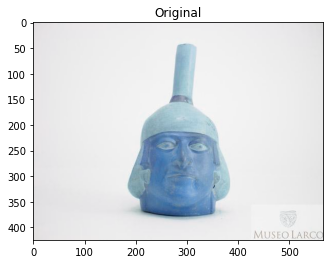

[array([-0.09397885,  0.06813383,  0.0346685 , -0.0556319 , -0.18761627,
       -0.0221101 , -0.0276699 , -0.05532461,  0.17884526, -0.04128876,
        0.1841037 ,  0.02802861, -0.16603276, -0.06805263, -0.01470664,
        0.11693653, -0.04232801, -0.0778829 , -0.16965741, -0.1454685 ,
        0.01420976,  0.05809376,  0.05488418,  0.01753587, -0.16657013,
       -0.17776485, -0.06495082, -0.05155594,  0.09618678, -0.17552289,
       -0.00650652,  0.01083733, -0.26926333, -0.11810672, -0.01526667,
        0.07750435, -0.11065068, -0.08187002,  0.15465462, -0.01703698,
       -0.16444287,  0.0457347 ,  0.00892997,  0.22508797,  0.23073834,
       -0.01028563,  0.01376123, -0.06578231,  0.10255064, -0.24410351,
        0.0573874 ,  0.11762039,  0.12975271,  0.02747308,  0.04831606,
       -0.05516396, -0.00398016,  0.18061733, -0.14309025,  0.08565995,
        0.07917693, -0.12479441, -0.08957616, -0.11659624,  0.18130094,
        0.12411206, -0.05320781, -0.16099447,  0.20219243, -0.1

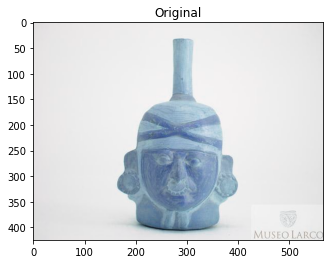

[] sino []
[INFO] processing image 224/310
drive/My Drive/huacos/validimages/sifaces/ML000226a.jpg


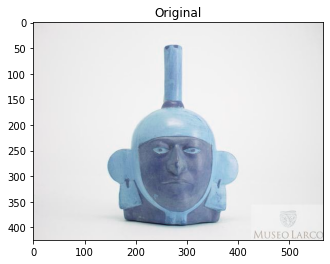

[array([-0.01319572,  0.0434949 , -0.03090298, -0.07212088, -0.08985581,
       -0.05375621, -0.02360951, -0.07727737,  0.1659099 , -0.06296898,
        0.12815198,  0.04292443, -0.17176962, -0.09959574,  0.01552887,
        0.10913523, -0.04068586, -0.11052735, -0.14434202, -0.09164552,
        0.03841238,  0.05423199,  0.04162119,  0.00849918, -0.10610127,
       -0.17149541, -0.08196074, -0.04536909,  0.06656148, -0.09748971,
        0.06758964,  0.00995416, -0.2923986 , -0.08627899,  0.00303409,
        0.08487413, -0.04594483, -0.03940549,  0.14346179,  0.03281328,
       -0.18306834,  0.04768791,  0.02273017,  0.2009812 ,  0.17755739,
       -0.01419483,  0.04476165, -0.07254431,  0.06929289, -0.22944865,
        0.07570416,  0.07048701,  0.15478665,  0.02689186,  0.06437497,
       -0.08426961,  0.03075813,  0.14160961, -0.17680433,  0.10893084,
        0.10274754, -0.07434023, -0.09768611, -0.06679981,  0.17650092,
        0.08235607, -0.06377912, -0.17717427,  0.18911421, -0.1

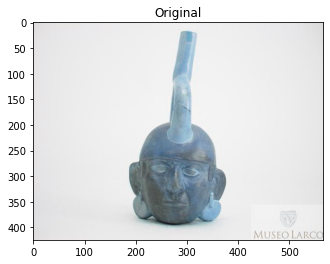

[array([-0.04077309,  0.08870488,  0.08696604, -0.03304023, -0.18114945,
       -0.08151147, -0.02266886, -0.06780201,  0.13813595, -0.0546357 ,
        0.17084692,  0.00048499, -0.20148394,  0.00531475, -0.00412854,
        0.14836767, -0.12975082, -0.05567215, -0.12431286, -0.09730742,
       -0.01751758,  0.05763039,  0.0574499 , -0.01869923, -0.07668915,
       -0.23902017, -0.09727804, -0.04312734,  0.05379991, -0.09495701,
        0.02898271,  0.01056224, -0.21945076, -0.0904986 ,  0.0020388 ,
        0.02615644, -0.05655205, -0.12255147,  0.22983348,  0.0248725 ,
       -0.15959437,  0.08732451,  0.03498271,  0.21407664,  0.23552108,
       -0.04176126,  0.003383  , -0.05919626,  0.11284088, -0.28464943,
        0.04906303,  0.10719143,  0.06689779,  0.0513891 ,  0.01876535,
       -0.08188124,  0.01240971,  0.17920132, -0.16693139,  0.05874097,
        0.13316336, -0.1273613 , -0.0885115 , -0.09208393,  0.17411005,
        0.14406806, -0.06285376, -0.16670987,  0.13048704, -0.1

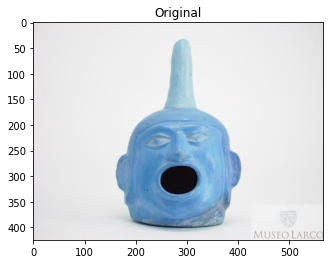

[] sino []
[INFO] processing image 227/310
drive/My Drive/huacos/validimages/sifaces/ML000229a.jpg


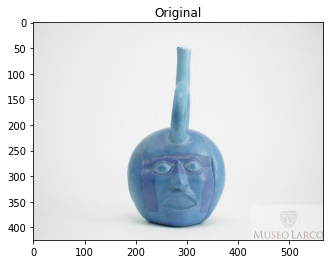

[array([-1.32587865e-01,  3.17240655e-02,  1.05407432e-01, -1.68615133e-02,
       -9.49746221e-02, -7.57451802e-02, -1.89143345e-02, -5.87522499e-02,
        1.10147059e-01, -4.35275808e-02,  2.48148158e-01,  1.83189809e-02,
       -1.52910486e-01, -6.96118847e-02,  2.19141468e-02,  9.78186280e-02,
       -7.99037814e-02, -8.78650695e-02, -1.47817299e-01, -5.80558926e-02,
       -7.44256377e-03, -2.01104805e-02,  6.40894473e-02,  2.53214836e-02,
       -1.17468052e-01, -2.19402403e-01, -9.37088281e-02, -6.86685964e-02,
        1.14258491e-01, -9.51866359e-02,  2.04550326e-02,  1.05451681e-02,
       -2.24269733e-01, -3.59250903e-02, -2.70462707e-02,  9.87231359e-02,
       -1.11452863e-02, -4.52463999e-02,  1.71813637e-01, -4.57529575e-02,
       -1.75274342e-01,  2.24918276e-02,  1.37654692e-02,  1.68053612e-01,
        1.89715862e-01, -4.49610651e-02,  7.57158101e-02, -5.02932817e-04,
        2.61321962e-02, -1.98521569e-01,  4.52751219e-02,  9.93467048e-02,
        1.78296745e-01, 

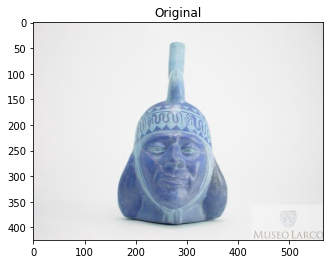

[array([-0.16178387,  0.07503156,  0.05306894, -0.0410005 , -0.16700429,
       -0.05322659,  0.0048412 , -0.09007014,  0.12387194, -0.01751845,
        0.15595829, -0.00242632, -0.19824922, -0.03108867, -0.05972639,
        0.07943401, -0.09972247, -0.09862374, -0.15285397, -0.14293385,
        0.04436655,  0.04741754,  0.07991545, -0.01816217, -0.18334559,
       -0.23230383, -0.08438449, -0.05648791,  0.02291695, -0.12005165,
        0.05565192,  0.02483845, -0.29554743, -0.06660553,  0.0223093 ,
        0.07450531, -0.07492818, -0.08234218,  0.21829389, -0.01115598,
       -0.15021013,  0.03656206,  0.09108612,  0.19456704,  0.19690935,
       -0.02840322, -0.02827116, -0.10066403,  0.13252807, -0.26569772,
        0.05191711,  0.22175185,  0.0891497 ,  0.12162064,  0.04370493,
       -0.0044912 ,  0.05091697,  0.1528987 , -0.13082981,  0.04464497,
        0.07967626, -0.0916473 , -0.10491893, -0.13144881,  0.15755993,
        0.12382207, -0.08690351, -0.1631643 ,  0.16293319, -0.1

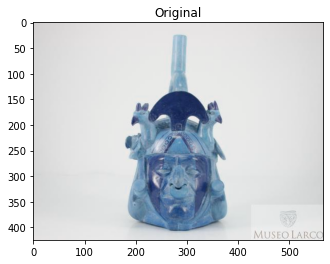

[] sino []
[INFO] processing image 230/310
drive/My Drive/huacos/validimages/sifaces/ML000232a.jpg


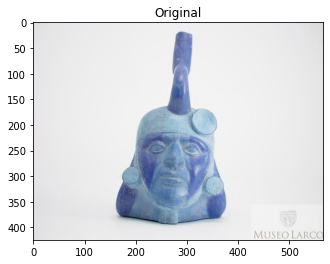

[array([-0.12530109,  0.04687207, -0.00493997, -0.02659068, -0.1627059 ,
       -0.07454047,  0.04520867, -0.07868689,  0.11710616, -0.01991253,
        0.11969058, -0.02159988, -0.19612728, -0.03279149, -0.03305463,
        0.09798426, -0.11231357, -0.06411658, -0.11793269, -0.10135746,
        0.07602572,  0.0386826 ,  0.03325836,  0.04861583, -0.15216626,
       -0.21295878, -0.03978139,  0.0052114 , -0.02138241, -0.12110828,
        0.07954787,  0.05554995, -0.34867248, -0.10895293,  0.01559068,
        0.07507262, -0.08616522, -0.06367803,  0.18814506, -0.00481937,
       -0.15247712,  0.0513175 ,  0.10841666,  0.21010493,  0.17066234,
       -0.03299949, -0.02186121, -0.0820865 ,  0.07651703, -0.27255201,
        0.01263184,  0.16689515,  0.11668189,  0.05191615,  0.03537011,
       -0.04794809,  0.02034225,  0.15943909, -0.1601539 ,  0.08444469,
        0.07843481, -0.06926495, -0.04304897, -0.10601708,  0.16479349,
        0.10447992, -0.07512628, -0.15488577,  0.14769949, -0.1

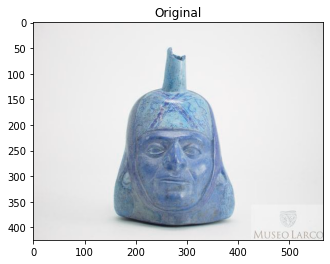

[array([-0.06720689,  0.00833318, -0.00449504, -0.04830164, -0.16903409,
       -0.08934559,  0.04332553, -0.07548438,  0.14101675, -0.04170284,
        0.12314382, -0.0144294 , -0.19562627, -0.05091632,  0.01878054,
        0.07051994, -0.08724557, -0.09817805, -0.1293028 , -0.10730623,
        0.0592095 , -0.03214901,  0.0162688 ,  0.02044848, -0.2014017 ,
       -0.20874327, -0.11268336, -0.01563821,  0.06009715, -0.02264426,
        0.0934131 ,  0.11231964, -0.31545073, -0.13123508,  0.05847614,
        0.04109356, -0.04937229, -0.04156339,  0.22413002, -0.0179192 ,
       -0.15103689,  0.03821268,  0.12238906,  0.16356686,  0.16259654,
       -0.02666704,  0.03123234, -0.05230909,  0.12595248, -0.24452619,
        0.01104709,  0.16726248,  0.16015336,  0.07703875,  0.08552106,
       -0.04628972,  0.06265435,  0.20269705, -0.2167317 ,  0.14651616,
        0.06392667, -0.14167909, -0.09593201, -0.10365441,  0.14204893,
        0.11559051, -0.04282937, -0.21075101,  0.23500013, -0.1

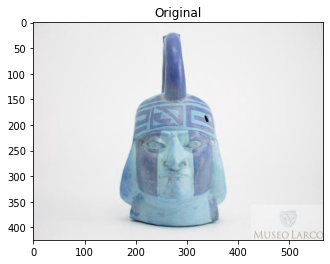

[] sino []
[INFO] processing image 233/310
drive/My Drive/huacos/validimages/sifaces/ML000235a.jpg


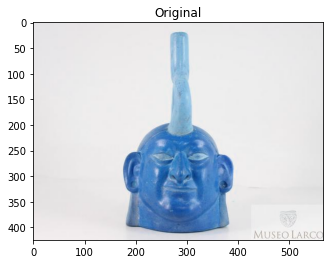

[array([-0.05223998,  0.04257588, -0.00911268, -0.04859125, -0.13838559,
       -0.07557447,  0.02246838, -0.06854534,  0.12771668, -0.05101936,
        0.16868483, -0.02456318, -0.22770491, -0.08598434,  0.00842918,
        0.08913418, -0.06452045, -0.06532198, -0.19096854, -0.14256218,
       -0.03116827,  0.03556401,  0.01832341,  0.00521778, -0.08898131,
       -0.214102  , -0.01576141, -0.06195733,  0.05832602, -0.1074742 ,
        0.05371328,  0.04221277, -0.28448156, -0.10187546,  0.01310407,
        0.08135546, -0.11333805, -0.07140235,  0.19043711, -0.02749812,
       -0.12367799,  0.00182319,  0.02141417,  0.18270117,  0.21473832,
       -0.01733398, -0.00241008, -0.0704485 ,  0.14040901, -0.26321316,
        0.05430343,  0.12595683,  0.1217887 ,  0.05477681,  0.06702563,
       -0.07112365,  0.00172574,  0.16548964, -0.11134236,  0.07804777,
        0.08534694, -0.15574181, -0.10087593, -0.14569741,  0.21128535,
        0.06152061, -0.08430342, -0.12140509,  0.17044634, -0.1

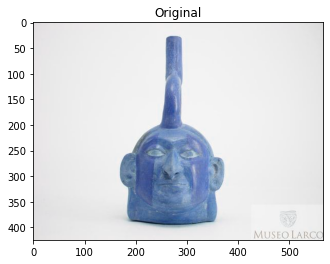

[array([-5.56468368e-02,  3.65468189e-02,  4.93528023e-02, -5.54230809e-03,
       -1.05956554e-01, -7.37211704e-02,  2.03628875e-02, -8.53317231e-02,
        1.03217520e-01, -3.59078050e-02,  1.46061450e-01, -5.04075959e-02,
       -1.98979944e-01, -7.94304013e-02, -5.40257245e-03,  1.28464013e-01,
       -1.05354317e-01, -1.13074340e-01, -1.67629585e-01, -9.61433500e-02,
        2.63757259e-02,  5.88935502e-02,  3.15244421e-02, -1.56769231e-02,
       -7.35886246e-02, -2.76118398e-01, -2.42262483e-02, -2.86712460e-02,
        1.21855825e-01, -1.11193836e-01,  1.59273520e-02,  1.45192631e-02,
       -2.93706000e-01, -9.97311622e-02,  2.42422000e-02,  1.30848482e-01,
       -1.00701734e-01, -6.77803829e-02,  1.90815121e-01, -1.61136314e-02,
       -1.75414890e-01,  4.09865417e-02,  5.20584881e-02,  2.15956867e-01,
        1.71429053e-01, -1.68772042e-03, -1.73479319e-04, -9.65941921e-02,
        8.03040639e-02, -2.42283523e-01,  5.00358567e-02,  1.21224828e-01,
        1.63418561e-01, 

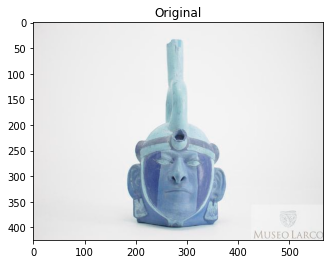

[] sino []
[INFO] processing image 236/310
drive/My Drive/huacos/validimages/sifaces/ML000238a.jpg


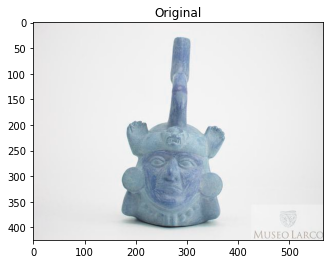

[array([-0.10763738,  0.07649876,  0.01055107, -0.02596916, -0.0860582 ,
       -0.10161195,  0.02561117, -0.10466862,  0.14110297, -0.0663082 ,
        0.25724876,  0.04861327, -0.18299858, -0.14787528,  0.03227139,
        0.08938976, -0.10119961, -0.07750033, -0.1499453 , -0.1103589 ,
        0.03074464,  0.00922263,  0.03015047,  0.00095091, -0.12850571,
       -0.23111872, -0.08649192, -0.02721434,  0.04023611, -0.0863788 ,
        0.1087648 ,  0.06516206, -0.26067007, -0.06684517, -0.0057328 ,
        0.09551567, -0.04915613, -0.00712201,  0.19730568,  0.01074769,
       -0.11830094,  0.01299403, -0.00151199,  0.20543559,  0.21221365,
       -0.05707937,  0.02258577, -0.06219135,  0.07692158, -0.23122977,
       -0.0019186 ,  0.15973237,  0.10959665,  0.0642882 ,  0.01629076,
       -0.05676409,  0.02440396,  0.14485955, -0.13723023,  0.05616338,
        0.05179309, -0.19967969, -0.11987182, -0.02941381,  0.13060071,
        0.06150807, -0.07045534, -0.12244639,  0.20001391, -0.1

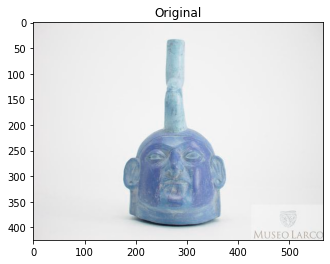

[array([-1.17842644e-01,  5.18533587e-02,  3.42802256e-02, -9.24900025e-02,
       -1.34784669e-01, -4.88932282e-02,  1.96877122e-03, -3.92667428e-02,
        1.21891439e-01, -5.34955561e-02,  1.49116024e-01,  2.55659223e-04,
       -2.09634602e-01, -6.57114834e-02, -3.11838090e-03,  1.00171141e-01,
       -5.00630513e-02, -7.84930661e-02, -1.57236487e-01, -1.64920971e-01,
        2.67253220e-02,  3.79689261e-02,  2.05434524e-02,  1.75792947e-02,
       -1.16107270e-01, -1.83043838e-01, -8.80362466e-02, -2.06971914e-02,
        5.02304174e-02, -1.68472856e-01,  7.04963282e-02,  2.56415531e-02,
       -2.72555828e-01, -7.48806000e-02, -3.11069191e-04,  7.45926946e-02,
       -7.61901513e-02, -6.69579655e-02,  1.60727113e-01, -3.04528326e-02,
       -1.40386924e-01,  1.25949234e-02,  7.78228343e-02,  2.25819051e-01,
        1.63057387e-01, -2.99842954e-02, -7.06112012e-03, -5.26278913e-02,
        1.01897940e-01, -2.53349572e-01,  1.96738336e-02,  1.29543960e-01,
        1.13460802e-01, 

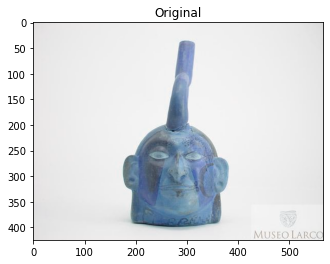

[] sino []
[INFO] processing image 239/310
drive/My Drive/huacos/validimages/sifaces/ML000241a.jpg


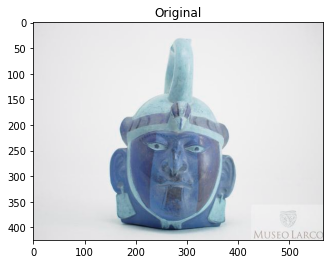

[] sino []
[INFO] processing image 240/310
drive/My Drive/huacos/validimages/sifaces/ML000242a.jpg


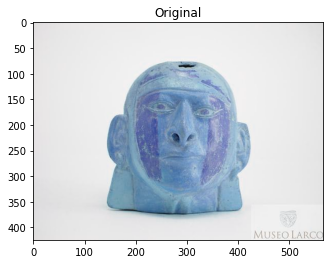

[] sino []
[INFO] processing image 241/310
drive/My Drive/huacos/validimages/sifaces/ML000243a.jpg


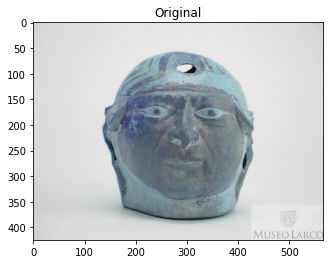

[] sino []
[INFO] processing image 242/310
drive/My Drive/huacos/validimages/sifaces/ML000244a.jpg


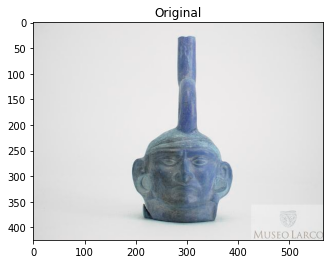

[array([-0.115858  ,  0.0628808 ,  0.03987763, -0.07175661, -0.16299526,
       -0.03974143,  0.0182751 , -0.0496216 ,  0.17043762, -0.04031004,
        0.11664028,  0.04817395, -0.23640925, -0.07315864,  0.00493665,
        0.1563136 , -0.13500425, -0.14303648, -0.09151071, -0.15397835,
       -0.00967999,  0.10367215,  0.03012674,  0.01065571, -0.12950301,
       -0.24646151, -0.09803598, -0.04663697,  0.1037275 , -0.14346705,
        0.01741435,  0.03569699, -0.2588816 , -0.10181597,  0.00651486,
        0.03180027, -0.10240255, -0.12118517,  0.23913865,  0.05960912,
       -0.18261126,  0.04335117,  0.06639206,  0.2554706 ,  0.21508357,
       -0.09747337,  0.03289219, -0.08291596,  0.09963472, -0.19563746,
        0.02724666,  0.18381864,  0.12162696,  0.07092158,  0.00557122,
       -0.03520642, -0.01939192,  0.19033766, -0.18136667,  0.08373117,
        0.1248467 , -0.12287539, -0.07817246, -0.07660606,  0.17339253,
        0.07682463, -0.08474761, -0.22209266,  0.18077792, -0.1

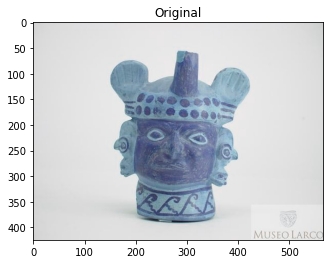

[] sino []
[INFO] processing image 244/310
drive/My Drive/huacos/validimages/sifaces/ML000246a.jpg


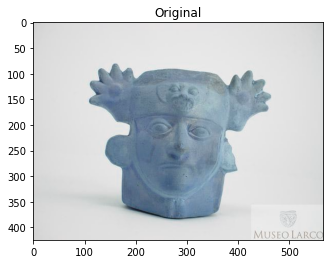

[] sino []
[INFO] processing image 245/310
drive/My Drive/huacos/validimages/sifaces/ML000247a.jpg


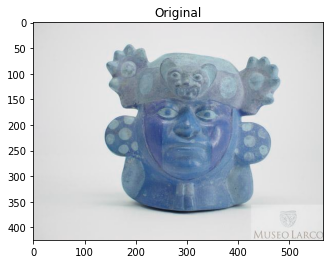

[] sino []
[INFO] processing image 246/310
drive/My Drive/huacos/validimages/sifaces/ML000248a.jpg


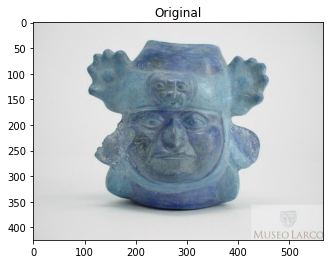

[] sino []
[INFO] processing image 247/310
drive/My Drive/huacos/validimages/sifaces/ML000249a.jpg


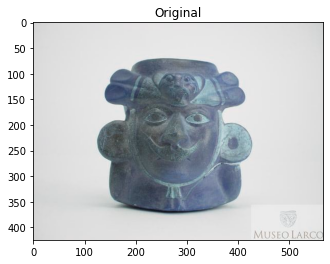

[] sino []
[INFO] processing image 248/310
drive/My Drive/huacos/validimages/sifaces/ML000251a.jpg


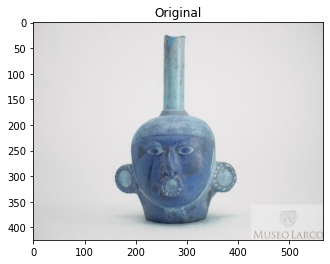

[] sino []
[INFO] processing image 249/310
drive/My Drive/huacos/validimages/sifaces/ML000252a.jpg


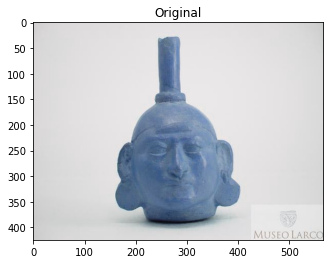

[array([-5.37246764e-02,  4.23987135e-02,  3.34235281e-02, -8.69316235e-02,
       -1.65897429e-01, -4.65445071e-02, -1.07393451e-02, -7.32294321e-02,
        1.39357910e-01, -8.79470706e-02,  7.32598454e-02,  5.99955022e-03,
       -1.85472339e-01, -9.38085169e-02,  2.40034014e-02,  1.34334832e-01,
       -8.48582685e-02, -1.29033148e-01, -1.59213394e-01, -1.29870757e-01,
       -1.82656199e-02,  1.08891413e-01,  8.88729095e-03, -2.84231752e-02,
       -1.13963902e-01, -2.07614988e-01, -6.14627711e-02, -1.88309047e-02,
        5.98004162e-02, -8.10661092e-02,  2.54846588e-02,  2.65815519e-02,
       -2.50044018e-01, -9.69203338e-02,  3.90394628e-02,  6.47163466e-02,
       -9.14230570e-02, -6.77247643e-02,  1.32288635e-01,  5.19173779e-02,
       -1.88782185e-01,  1.76467001e-02,  7.07214326e-02,  2.38970041e-01,
        2.45153546e-01, -2.13769078e-02, -8.00760835e-03, -7.46419355e-02,
        1.48268491e-01, -2.60381222e-01,  2.64480244e-02,  1.02215037e-01,
        9.49818864e-02, 

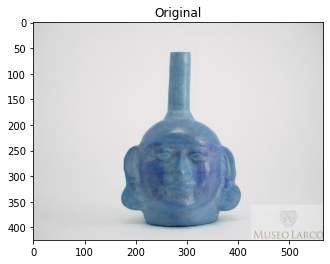

[] sino []
[INFO] processing image 251/310
drive/My Drive/huacos/validimages/sifaces/ML000254a.jpg


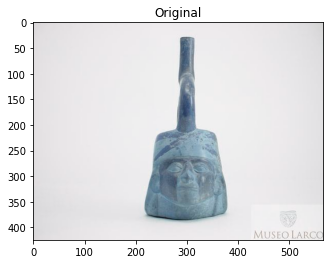

[] sino []
[INFO] processing image 252/310
drive/My Drive/huacos/validimages/sifaces/ML000255a.jpg


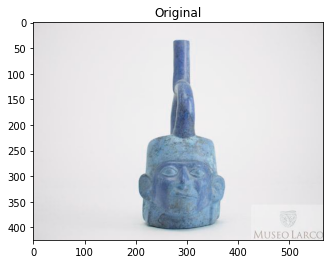

[] sino []
[INFO] processing image 253/310
drive/My Drive/huacos/validimages/sifaces/ML000256a.jpg


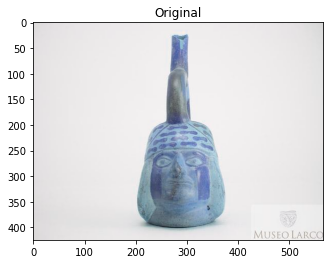

[] sino []
[INFO] processing image 254/310
drive/My Drive/huacos/validimages/sifaces/ML000257a.jpg


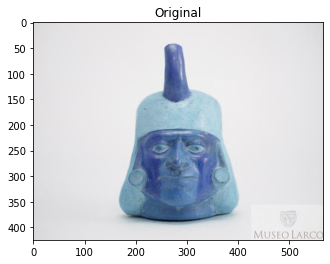

[] sino []
[INFO] processing image 255/310
drive/My Drive/huacos/validimages/sifaces/ML000258a.jpg


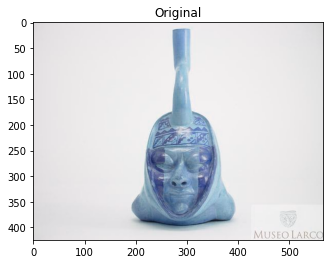

[] sino []
[INFO] processing image 256/310
drive/My Drive/huacos/validimages/sifaces/ML000259a.jpg


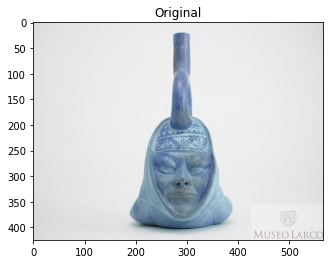

[array([-0.02218498,  0.0677546 ,  0.00269021, -0.06293996, -0.11041427,
       -0.09702926,  0.03513476, -0.12465405,  0.19021641, -0.05442975,
        0.2015779 , -0.06383148, -0.23665112, -0.11380446,  0.0761948 ,
        0.05867729, -0.13242181, -0.10370222, -0.04961139, -0.07825457,
        0.03145957,  0.10431576,  0.06213285,  0.07545377, -0.07010137,
       -0.27960461, -0.08716935, -0.09385976,  0.04694571, -0.11848427,
        0.040996  ,  0.11186518, -0.21134292, -0.08084719,  0.00709401,
        0.03216691, -0.12968567, -0.09983294,  0.14760797,  0.00228382,
       -0.15633984, -0.06216626, -0.00356233,  0.1888946 ,  0.18339793,
       -0.00268704,  0.00958145, -0.13931979,  0.07662554, -0.15682155,
        0.01029369,  0.21289785,  0.07348491,  0.05824579,  0.0434477 ,
       -0.09036634,  0.02001817,  0.12579961, -0.24341449,  0.09077176,
        0.08555157, -0.09492111,  0.01722004, -0.04785988,  0.14598666,
        0.07095958, -0.05068272, -0.1704286 ,  0.11375526, -0.2

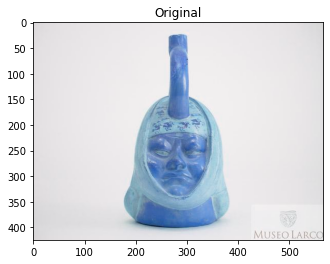

[array([-0.08291687,  0.04802826,  0.0333607 , -0.08474088, -0.16268626,
       -0.06373613,  0.06706455, -0.1240878 ,  0.1881647 , -0.13739184,
        0.18586139, -0.00319725, -0.2360369 , -0.06646601,  0.10164575,
        0.08573374, -0.04296323, -0.16595706, -0.13014595, -0.07673627,
       -0.02679917,  0.02458922,  0.03962929,  0.02868869, -0.08551398,
       -0.26520711, -0.08983336, -0.02420294, -0.02867626, -0.05078551,
        0.09188452,  0.13709995, -0.22319043, -0.07787816, -0.01096302,
        0.05352145, -0.13060912, -0.05487059,  0.1833134 , -0.01985749,
       -0.19242223, -0.08473428, -0.02488204,  0.23191339,  0.15431604,
       -0.03837056,  0.03638724, -0.10085358,  0.08269936, -0.23392412,
        0.0557705 ,  0.15896016,  0.06296286,  0.0452106 ,  0.03260235,
       -0.04522799,  0.04958572,  0.12696201, -0.17875226,  0.05808522,
        0.08937559, -0.14143959, -0.07413645, -0.10604782,  0.2341947 ,
        0.13821626, -0.04947496, -0.16417845,  0.19597025, -0.1

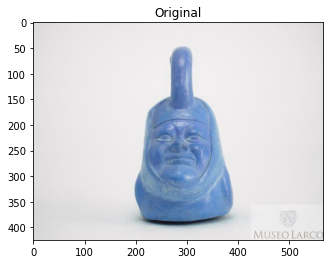

[array([-0.09869972, -0.00295062, -0.02739194, -0.09417723, -0.15791649,
       -0.10977045,  0.0428761 , -0.11772473,  0.09260154, -0.09644894,
        0.14584771, -0.06061509, -0.2426018 , -0.13794962,  0.08524702,
        0.0976866 , -0.10875994, -0.09971453, -0.18466263, -0.08643134,
       -0.00280635, -0.02237525,  0.02097025,  0.00687507, -0.11169751,
       -0.23828092, -0.07752407,  0.00994417,  0.00906391, -0.08068614,
        0.06544243,  0.11667982, -0.34121644, -0.15186714, -0.00776773,
        0.07270828, -0.12672706, -0.06939051,  0.20833214,  0.01925228,
       -0.1579342 ,  0.04686471,  0.06186976,  0.17762728,  0.18288775,
       -0.05209222,  0.01530638, -0.10346937,  0.11389568, -0.26667768,
        0.00211111,  0.18257959,  0.11655676,  0.05531477,  0.05110855,
       -0.0255682 ,  0.04990689,  0.17572075, -0.18212323,  0.09808153,
        0.11074636, -0.12988102, -0.09599099, -0.09918738,  0.15096393,
        0.07368931, -0.04450751, -0.14152808,  0.218537  , -0.1

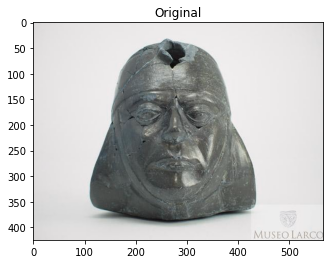

[] sino []
[INFO] processing image 260/310
drive/My Drive/huacos/validimages/sifaces/ML000263a.jpg


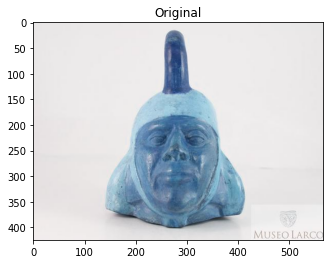

[array([-0.07438518,  0.07351697,  0.03094711, -0.0648874 , -0.07936616,
       -0.033398  , -0.00771138, -0.09029637,  0.16791809, -0.01534338,
        0.25918421,  0.0463279 , -0.23367381, -0.10874338,  0.04112666,
        0.05938058, -0.12773493, -0.01684128, -0.13459235, -0.06517197,
        0.02647336,  0.0084685 ,  0.11822201, -0.02197909, -0.13885441,
       -0.27977833, -0.11354518, -0.07568687,  0.02968907, -0.14475939,
        0.04305723, -0.00596017, -0.25668794, -0.1053769 , -0.01441655,
        0.0120113 , -0.06087134, -0.0626931 ,  0.17996326, -0.0337839 ,
       -0.10546319,  0.0536317 ,  0.04605039,  0.16740799,  0.17297536,
       -0.01423672,  0.04554006, -0.08642734,  0.09137592, -0.23684703,
        0.05844746,  0.13420114,  0.06644076,  0.04589704,  0.07478262,
       -0.03814666,  0.00299124,  0.16270404, -0.18054132,  0.1144657 ,
        0.11358134, -0.0646411 , -0.13246827, -0.07878203,  0.11828358,
        0.13645259, -0.07875917, -0.21931982,  0.09744555, -0.1

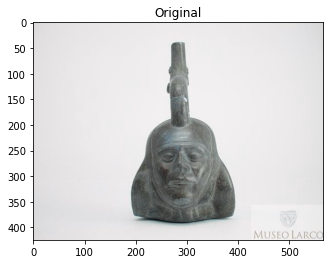

[array([-1.34063512e-02,  3.70926559e-02,  5.30929826e-02, -9.20941904e-02,
       -9.43743885e-02, -5.60532510e-02, -1.81544982e-02, -1.02535859e-02,
        1.54915228e-01, -5.42407930e-02,  1.15476221e-01,  8.33526105e-02,
       -1.94299042e-01, -1.00932777e-01, -5.71366400e-03,  1.21418349e-01,
       -1.00386888e-01, -1.20060466e-01, -1.15091354e-01, -1.42461523e-01,
        7.90208578e-05,  7.57521018e-02,  5.77172861e-02, -5.65518439e-03,
       -1.50204390e-01, -2.04618677e-01, -6.88114166e-02, -1.04470864e-01,
        5.92121109e-02, -1.16317570e-01,  3.81493717e-02,  1.64047480e-02,
       -2.69691139e-01, -7.64405578e-02,  1.57881454e-02,  3.44089642e-02,
       -7.92803466e-02, -1.06561676e-01,  2.26432726e-01,  8.62412676e-02,
       -1.70374423e-01,  3.19512188e-02,  4.60917540e-02,  2.19237164e-01,
        1.93225503e-01, -7.65539706e-02,  3.42344977e-02, -5.22129647e-02,
        1.19536996e-01, -2.18276262e-01,  8.51897150e-02,  1.32792026e-01,
        1.13630593e-01, 

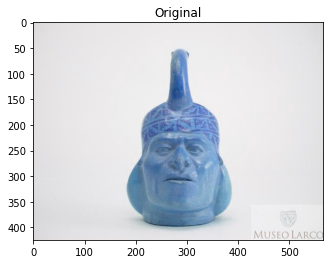

[array([-9.36995149e-02,  2.67082136e-02,  1.58267692e-02, -7.69414604e-02,
       -1.71600342e-01, -4.90078628e-02,  4.07658480e-02, -5.00094891e-02,
        1.18831165e-01, -2.84180045e-04,  1.30978644e-01,  2.01284811e-02,
       -1.85934767e-01, -6.37166053e-02,  6.30915165e-03,  9.08326507e-02,
       -8.69302973e-02, -8.28182623e-02, -1.23957165e-01, -5.33997454e-02,
        3.58954072e-03, -8.77398998e-03,  6.58984780e-02,  1.01875626e-02,
       -1.25562578e-01, -2.08085805e-01, -1.09152295e-01,  1.50412656e-02,
        9.01550725e-02, -5.90818673e-02,  5.62303364e-02,  5.64689562e-02,
       -3.08435172e-01, -1.09201595e-01,  6.07066974e-02,  2.48166770e-02,
       -4.95982431e-02, -1.00466892e-01,  1.81504801e-01,  8.78253952e-03,
       -1.55524358e-01,  2.80568674e-02,  1.12831660e-01,  1.52361989e-01,
        1.59923255e-01,  3.36956978e-03,  1.10738724e-02, -7.39296898e-02,
        9.10114720e-02, -2.09918559e-01,  3.68537456e-02,  1.10730059e-01,
        1.26656085e-01, 

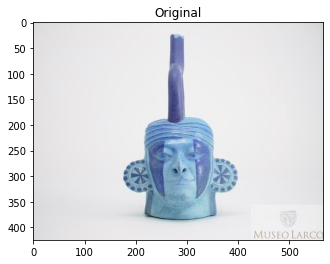

[array([-7.43430257e-02,  7.00334683e-02, -2.38410458e-02, -4.53601554e-02,
       -1.14809670e-01, -1.00026682e-01, -7.22743571e-05, -1.34336248e-01,
        1.23741344e-01, -4.05142978e-02,  1.22616835e-01, -7.17218220e-02,
       -2.47644812e-01, -7.80924633e-02,  4.55984324e-02,  1.30329430e-01,
       -8.25459883e-02, -1.36359751e-01, -1.08790942e-01, -1.12099379e-01,
        6.42329454e-03,  9.30394977e-03,  2.83409283e-02,  1.14759609e-01,
       -2.88769230e-02, -2.00796753e-01, -7.71081373e-02, -5.31749390e-02,
        1.30871698e-01, -8.00301060e-02, -3.28900963e-02,  2.79172249e-02,
       -2.73371518e-01, -1.00846976e-01,  6.03910163e-02,  5.68309203e-02,
       -5.16193062e-02, -7.96152875e-02,  2.44303063e-01, -1.30858868e-02,
       -1.76453531e-01, -3.24743614e-02,  4.63832431e-02,  2.61352420e-01,
        1.60938650e-01,  6.75284863e-03,  3.27900387e-02, -3.50488424e-02,
        1.15046822e-01, -1.74167305e-01,  7.56956413e-02,  1.63813829e-01,
        1.53986782e-01, 

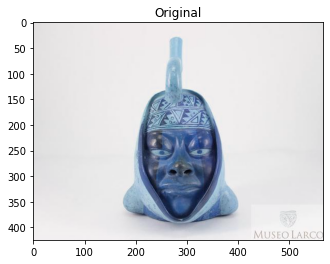

[] sino []
[INFO] processing image 265/310
drive/My Drive/huacos/validimages/sifaces/ML000268a.jpg


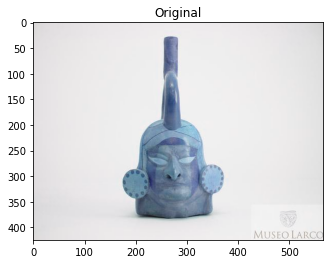

[array([-0.01829691,  0.1000554 ,  0.0237318 , -0.05187096, -0.14332578,
       -0.06580456,  0.00903919, -0.08100683,  0.1315012 , -0.08813722,
        0.09682697, -0.02690973, -0.24735034, -0.05675986,  0.01782718,
        0.11309607, -0.07362963, -0.12715662, -0.13725829, -0.122521  ,
        0.00280216,  0.04903183, -0.01949388,  0.02662566, -0.03457563,
       -0.18836538, -0.05241639, -0.02422127,  0.11681255, -0.10168508,
        0.02380981,  0.0493156 , -0.20901561, -0.07914964,  0.02879024,
        0.05822013, -0.11196769, -0.10803884,  0.17232642, -0.06082152,
       -0.15717146, -0.01312844,  0.08812624,  0.18598372,  0.18296203,
       -0.01337963,  0.02396382, -0.11402179,  0.11885528, -0.16750431,
        0.03543974,  0.14971915,  0.13168249,  0.11035031,  0.06937937,
       -0.14251256,  0.02823467,  0.15785947, -0.15008177,  0.06771456,
        0.09466596, -0.11415615, -0.07534051, -0.11267014,  0.15853894,
        0.05240291, -0.06622076, -0.18816885,  0.16753916, -0.2

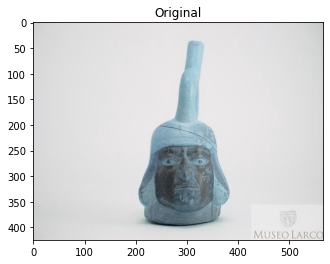

[] sino []
[INFO] processing image 267/310
drive/My Drive/huacos/validimages/sifaces/ML000270a.jpg


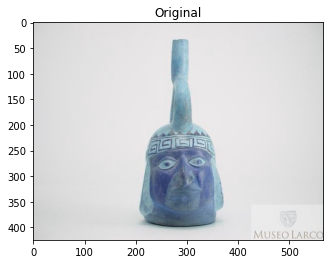

[] sino []
[INFO] processing image 268/310
drive/My Drive/huacos/validimages/sifaces/ML000271a.jpg


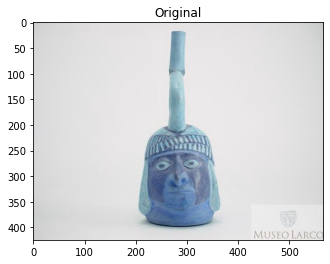

[array([-0.07161273,  0.02804393,  0.13673191, -0.08737206, -0.1754207 ,
       -0.04934758, -0.00541433, -0.01428078,  0.08587886, -0.06202071,
        0.16304275, -0.00971958, -0.22517738,  0.07748948, -0.06367039,
        0.09936382, -0.11785371, -0.12182617, -0.18511003, -0.11391284,
       -0.04773656,  0.05317529,  0.03330279,  0.00065361, -0.11135665,
       -0.23817478, -0.09591158, -0.03427044,  0.10277038, -0.12321065,
        0.02385551,  0.02898852, -0.26233184, -0.07551619,  0.04875281,
        0.029729  , -0.10936962, -0.09841766,  0.24095124,  0.00493094,
       -0.2042423 ,  0.03858712,  0.07702584,  0.2286087 ,  0.22314773,
        0.00807121, -0.04073525, -0.06946254,  0.0885243 , -0.30435938,
        0.02583703,  0.17471993,  0.12350395,  0.12472539,  0.01063304,
       -0.08307493,  0.05731039,  0.17341876, -0.14584254,  0.08092855,
        0.07076743, -0.19472   , -0.03923537, -0.11212212,  0.17895359,
        0.07185057, -0.08314545, -0.19834515,  0.20027518, -0.1

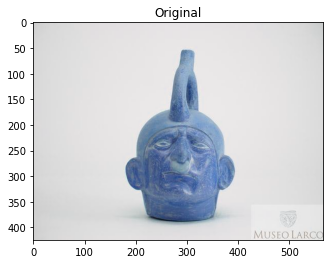

[array([-3.97174805e-02,  5.13415411e-03, -1.54632181e-02, -2.11106092e-02,
       -1.44532621e-01, -2.56891698e-02,  1.96810067e-03, -1.17700025e-02,
        1.19363591e-01, -2.87195295e-02,  1.93209946e-01,  4.88241762e-03,
       -1.59943774e-01, -7.19699636e-02, -1.18009001e-02,  1.47116005e-01,
       -4.85309064e-02, -6.65063858e-02, -1.79252610e-01, -9.49294120e-02,
        4.39339578e-02,  8.52787495e-03,  3.22046727e-02,  2.65741050e-02,
       -2.03637481e-01, -1.80912018e-01, -8.90886039e-02, -4.61715609e-02,
        2.97516584e-03, -1.52956381e-01,  6.18637279e-02,  7.11246133e-02,
       -2.70845681e-01, -9.72445458e-02,  4.07502800e-02,  6.10670336e-02,
       -4.24112305e-02, -3.66736911e-02,  2.10152596e-01,  4.52964380e-02,
       -1.64054915e-01,  1.36393204e-01,  8.87344778e-02,  1.87451214e-01,
        1.76724002e-01, -3.22251916e-02,  4.01487239e-02, -9.73860025e-02,
        1.02240771e-01, -2.62518734e-01,  3.66695002e-02,  1.17449462e-01,
        1.36838138e-01, 

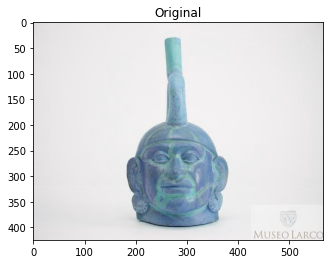

[array([-0.04001206,  0.02691693,  0.03340343, -0.05267654, -0.18315153,
       -0.05430876, -0.02265848, -0.07801884,  0.10924733, -0.03726102,
        0.14141145, -0.01846401, -0.19809207, -0.02282374, -0.02282924,
        0.10887228, -0.0952445 , -0.0877496 , -0.11407354, -0.0836658 ,
       -0.01286167, -0.00078645,  0.06455317,  0.00381758, -0.11773749,
       -0.24911876, -0.07779522,  0.02965784,  0.09502653, -0.06181838,
        0.03528519,  0.07034031, -0.31860378, -0.12086559,  0.0229337 ,
        0.11330316, -0.1111201 , -0.10080725,  0.19790538,  0.04501122,
       -0.14577456,  0.10092692,  0.04519327,  0.18939251,  0.18515819,
       -0.02833961,  0.04362091, -0.10509767,  0.07841918, -0.20566452,
        0.00992276,  0.17781639,  0.16023321,  0.03771001, -0.00303401,
        0.01106112,  0.03785001,  0.19921665, -0.21825016,  0.12476608,
        0.12662819, -0.05895624, -0.02448752, -0.12570542,  0.15588874,
        0.09414423, -0.07330282, -0.14826205,  0.20732862, -0.1

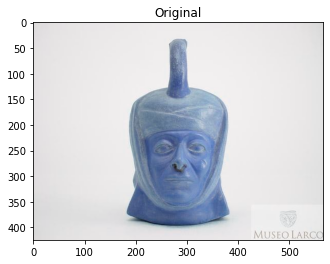

[array([-0.03842378,  0.04827352,  0.0103137 , -0.03413959, -0.07164218,
       -0.06216772,  0.05834318, -0.10246377,  0.19125867, -0.10901945,
        0.15675867,  0.00576299, -0.16377521, -0.0442852 ,  0.01382447,
        0.07076084, -0.13508265, -0.12923132, -0.09718078, -0.09660584,
        0.09811203,  0.05591398,  0.0383037 ,  0.02425162, -0.14254606,
       -0.24565409, -0.10590997, -0.07250809,  0.17531916, -0.11739246,
       -0.00394484,  0.03577308, -0.25669932, -0.0340829 ,  0.00279424,
        0.07101668, -0.04974318, -0.02552703,  0.14833926,  0.06568976,
       -0.19789203,  0.02485903,  0.02784431,  0.21359728,  0.21269712,
        0.00067174, -0.01071454, -0.06671497,  0.04343859, -0.18443866,
        0.03378091,  0.13972798,  0.18344916,  0.09956285,  0.03286885,
       -0.11290094,  0.01286437,  0.08251071, -0.17705931,  0.14526862,
        0.11390895, -0.12490535, -0.02735465, -0.00910984,  0.12214717,
        0.01875531, -0.0688671 , -0.15833189,  0.18551594, -0.2

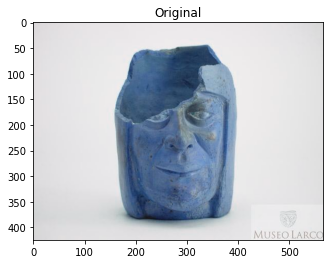

[array([-0.04821804,  0.01774   ,  0.01903255, -0.04839875, -0.12546392,
       -0.00496294, -0.00595924, -0.02733179,  0.11419676, -0.02077894,
        0.16387792,  0.00187702, -0.24554139, -0.05680302,  0.06009642,
        0.06353406, -0.09193809, -0.11353897, -0.14941338, -0.11139002,
       -0.05384636, -0.02396282,  0.01564238, -0.02874713, -0.12252916,
       -0.16309099, -0.08242438, -0.11709124,  0.09598314, -0.09485253,
        0.0103893 , -0.03697589, -0.2304381 , -0.10323824,  0.01742266,
        0.06985453, -0.08439223, -0.05035733,  0.14789042, -0.03216818,
       -0.10750851,  0.0160842 , -0.01229949,  0.21411446,  0.19713722,
        0.01603884,  0.00424006, -0.05851911,  0.07089204, -0.28576344,
        0.08521743,  0.11442894,  0.14715572,  0.07452472,  0.0252897 ,
       -0.10023242,  0.04906873,  0.17647374, -0.13315818,  0.12264778,
        0.09409471, -0.11991942, -0.0781566 , -0.06545512,  0.22163758,
        0.09814011, -0.05724989, -0.16282663,  0.17464682, -0.1

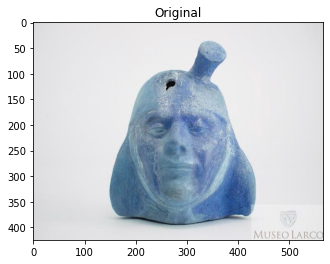

[array([-0.02532335,  0.00505202,  0.02273698, -0.06397785, -0.02694084,
       -0.06077303,  0.02496219, -0.01911524,  0.17124382, -0.04469945,
        0.23548199,  0.02074961, -0.22303   , -0.11973655, -0.0079942 ,
        0.06525721, -0.11554971, -0.018743  , -0.14364319, -0.12139718,
        0.06393637,  0.01713132,  0.07089467, -0.02231608, -0.16324997,
       -0.21900518, -0.10457082, -0.08934   ,  0.01636072, -0.12544921,
        0.09422009,  0.02223247, -0.29066759, -0.10329589, -0.00802059,
        0.0441041 , -0.03710418, -0.0574325 ,  0.19993368,  0.03769351,
       -0.09143387,  0.06246644,  0.0391079 ,  0.21415937,  0.17793429,
       -0.02755752,  0.01387436, -0.07769711,  0.13083559, -0.2826007 ,
        0.02190693,  0.16632934,  0.07564691,  0.10110983,  0.0638973 ,
       -0.02327327,  0.06333655,  0.20541853, -0.20134403,  0.12945718,
        0.05145765, -0.13390982, -0.06459498, -0.0565061 ,  0.11700687,
        0.07546353, -0.08033846, -0.1785455 ,  0.14265375, -0.1

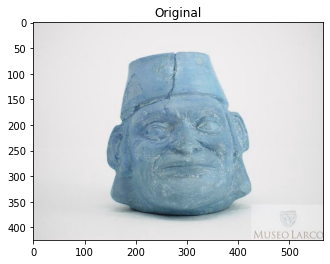

[array([-0.15315264,  0.13863683,  0.01704655, -0.04630296, -0.20467329,
       -0.04227667, -0.03212932, -0.08372088,  0.04099556, -0.02618997,
        0.1205268 , -0.01428239, -0.25498736, -0.03662161, -0.01326516,
        0.10320593, -0.10280149, -0.11090001, -0.15050083, -0.12300735,
        0.0031403 ,  0.00892462,  0.00133837,  0.00060567, -0.08581872,
       -0.21461655, -0.05393475, -0.01032052, -0.00539111, -0.06862672,
        0.02172913,  0.04163627, -0.29269096, -0.11252057,  0.00221489,
        0.05097893, -0.09010466, -0.08679201,  0.13432293, -0.02306874,
       -0.11822659,  0.04894014,  0.10343312,  0.19888824,  0.21233156,
       -0.04826097, -0.00090821, -0.02934228,  0.10764803, -0.2674765 ,
       -0.01780394,  0.16455708,  0.13579309,  0.03745582,  0.04343721,
       -0.08720481,  0.02619004,  0.17216234, -0.15637241,  0.08310778,
        0.04885584, -0.14800578, -0.1300825 , -0.16392587,  0.10142538,
        0.12009146, -0.04871954, -0.17995323,  0.18080957, -0.1

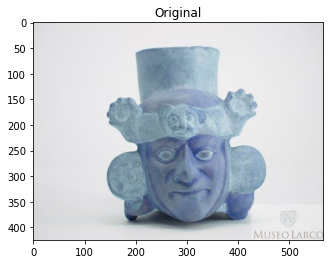

[array([-0.0419209 ,  0.01559755,  0.04152992, -0.06878592, -0.07438696,
       -0.00601418,  0.00765133, -0.04222472,  0.13699363, -0.02886568,
        0.10292537,  0.02838494, -0.1855332 , -0.07546853,  0.02252209,
        0.10548775, -0.08149424, -0.09647663, -0.13247877, -0.08145644,
       -0.01345628,  0.06229227,  0.09281389, -0.01309275, -0.13477962,
       -0.24355543, -0.15619791, -0.02460365,  0.09745425, -0.07094721,
        0.02694912,  0.02073678, -0.2463946 , -0.05098052,  0.02923209,
        0.03434765, -0.07711097, -0.03324712,  0.12974086,  0.06395856,
       -0.15750954,  0.04312497,  0.01308635,  0.2201989 ,  0.25615531,
        0.01994298,  0.02523544, -0.11052749,  0.00345845, -0.21034619,
        0.12047048,  0.13040873,  0.11997757,  0.04762004,  0.0371957 ,
        0.01035135, -0.01092891,  0.1814106 , -0.16292469,  0.1069627 ,
        0.06908525, -0.08726582, -0.07711865, -0.06898276,  0.10588594,
        0.0853788 , -0.08373274, -0.20744708,  0.14326239, -0.2

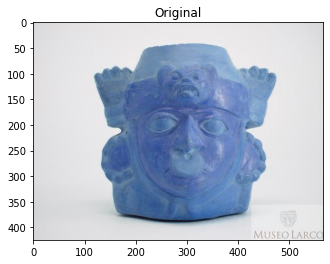

[array([-0.07476674,  0.03989455,  0.07333759, -0.00958717, -0.11458832,
       -0.08273816, -0.02742296, -0.06789944,  0.07254285, -0.02897926,
        0.21047114, -0.05559921, -0.17908996, -0.06361799,  0.00136656,
        0.10564463, -0.10262732, -0.09487404, -0.13614093, -0.0573012 ,
       -0.0107847 ,  0.05271623,  0.0403308 ,  0.02950503, -0.07780615,
       -0.25229925, -0.08743548, -0.0597045 ,  0.10838106, -0.06584306,
        0.00343318,  0.0641542 , -0.20213522, -0.06680022,  0.05456197,
        0.08732973,  0.03317682,  0.01624463,  0.15256934, -0.00051095,
       -0.18284597,  0.00106363,  0.04556423,  0.22794946,  0.23100436,
        0.05410866, -0.00450616, -0.03467494,  0.0306894 , -0.24818924,
        0.04497493,  0.13817066,  0.16506194,  0.03349145,  0.00583343,
       -0.10300948, -0.04171082,  0.16434664, -0.14638661,  0.07876086,
        0.0212683 , -0.14685592, -0.05123524, -0.06916129,  0.19142102,
        0.07206597, -0.08605282, -0.1587013 ,  0.18542731, -0.1

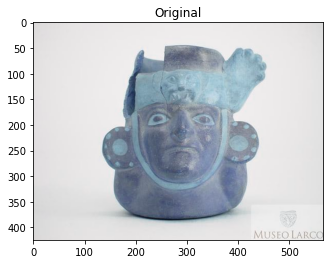

[] sino []
[INFO] processing image 278/310
drive/My Drive/huacos/validimages/sifaces/ML000281a.jpg


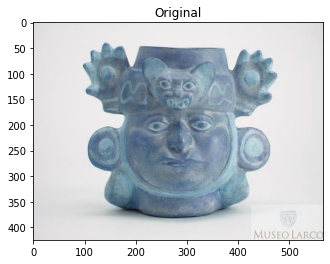

[] sino []
[INFO] processing image 279/310
drive/My Drive/huacos/validimages/sifaces/ML000306a.jpg


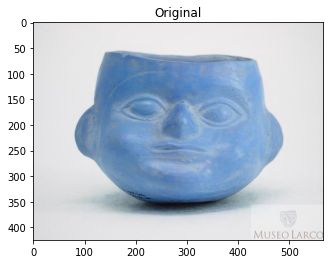

[] sino []
[INFO] processing image 280/310
drive/My Drive/huacos/validimages/sifaces/ML000307a.jpg


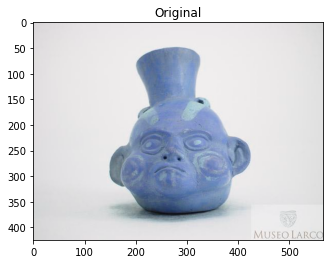

[array([-0.1583149 ,  0.07770735, -0.0094979 , -0.10629732, -0.16949686,
       -0.07128447,  0.01796779, -0.11264151,  0.1653432 , -0.07647349,
        0.18442523, -0.02107829, -0.19431299, -0.11151687,  0.04322739,
        0.11355279, -0.11076198, -0.06262409, -0.08515954, -0.1500794 ,
        0.08277495,  0.04154277,  0.03754076,  0.05534831, -0.10172334,
       -0.25904289, -0.11093825, -0.06081871,  0.01760851, -0.07498531,
        0.05826414,  0.07057637, -0.24576822, -0.12436098, -0.00425894,
        0.10283704, -0.06208797, -0.06253601,  0.16412337, -0.01859973,
       -0.08930156, -0.04156047,  0.06076681,  0.21658686,  0.19019084,
       -0.04169078,  0.04090491, -0.03909347,  0.09207708, -0.23516284,
        0.01776244,  0.14495645,  0.05989436,  0.03284286,  0.07397266,
       -0.01150031,  0.04138494,  0.14137274, -0.19211966,  0.04010027,
        0.12330238, -0.14643332, -0.14471151, -0.1008793 ,  0.17590564,
        0.13641575, -0.0387505 , -0.16924417,  0.20143908, -0.1

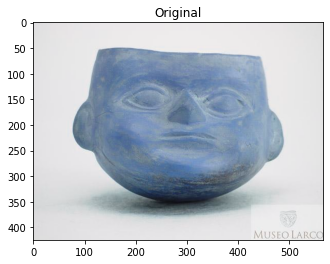

[] sino []
[INFO] processing image 282/310
drive/My Drive/huacos/validimages/sifaces/ML000309a.jpg


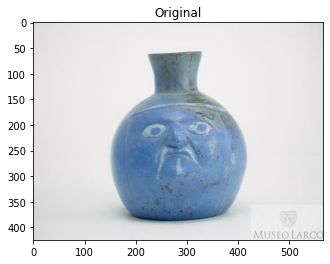

[] sino []
[INFO] processing image 283/310
drive/My Drive/huacos/validimages/sifaces/ML000310a.jpg


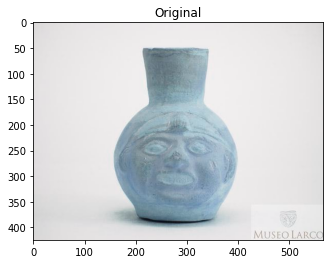

[] sino []
[INFO] processing image 284/310
drive/My Drive/huacos/validimages/sifaces/ML000311a.jpg


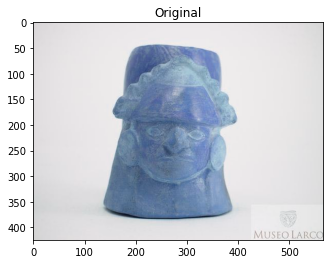

[] sino []
[INFO] processing image 285/310
drive/My Drive/huacos/validimages/sifaces/ML000312a.jpg


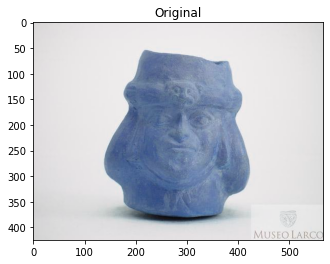

[] sino []
[INFO] processing image 286/310
drive/My Drive/huacos/validimages/sifaces/ML000313a.jpg


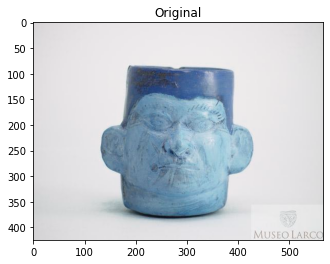

[] sino []
[INFO] processing image 287/310
drive/My Drive/huacos/validimages/sifaces/ML000314a.jpg


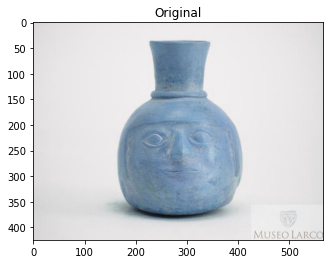

[] sino []
[INFO] processing image 288/310
drive/My Drive/huacos/validimages/sifaces/ML000315a.jpg


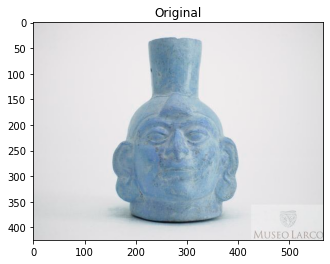

[] sino []
[INFO] processing image 289/310
drive/My Drive/huacos/validimages/sifaces/ML000316a.jpg


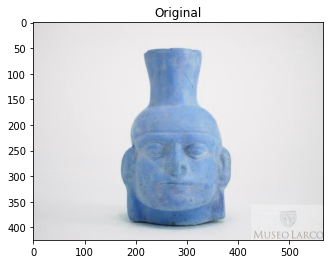

[array([-0.08683051,  0.04166305, -0.02644594, -0.10358623, -0.19663301,
       -0.00131468, -0.0108561 , -0.08282032,  0.16117328, -0.06229246,
        0.11288936,  0.05821364, -0.1979509 , -0.11597524,  0.02611059,
        0.11502361, -0.10248023, -0.11566147, -0.0993784 , -0.10954458,
       -0.02693668, -0.00147463,  0.0508853 ,  0.01198965, -0.14352064,
       -0.17354105, -0.10081745, -0.0076814 ,  0.05294789, -0.10214268,
        0.07061426,  0.06561146, -0.2715812 , -0.09519951,  0.00185721,
        0.09530959, -0.04485514, -0.07892384,  0.15940785, -0.03405489,
       -0.15190588,  0.047625  ,  0.06405416,  0.17671958,  0.20602441,
       -0.04243819,  0.0198561 , -0.02865848,  0.11581188, -0.25418368,
        0.03552734,  0.11904249,  0.05916768, -0.00821553,  0.03031011,
       -0.05343013,  0.00938138,  0.22053407, -0.15455812,  0.08341064,
        0.0386394 , -0.14699823, -0.09571154, -0.08221618,  0.12980396,
        0.1196508 , -0.04589904, -0.20971745,  0.20126343, -0.1

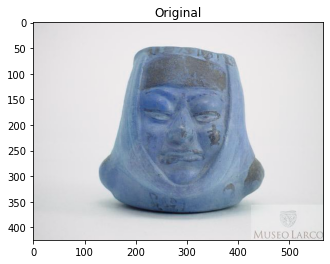

[array([-0.07557395,  0.05095749,  0.04699864, -0.07304167, -0.11814488,
       -0.1003767 ,  0.02360139, -0.12230925,  0.17008096, -0.04582101,
        0.17309475, -0.01550208, -0.20437472, -0.09883691,  0.03453542,
        0.10964092, -0.06448545, -0.15578601, -0.08643213, -0.07005037,
        0.03335008,  0.08372068,  0.03691681,  0.05897573, -0.12615404,
       -0.19943589, -0.0997073 , -0.06170519,  0.0241907 , -0.12220818,
        0.0355846 ,  0.12802553, -0.22085774, -0.06455816,  0.0521377 ,
        0.10260629, -0.05580169, -0.04401553,  0.14590216, -0.00557209,
       -0.22551963, -0.03926186,  0.01496445,  0.20903744,  0.171152  ,
        0.00903475,  0.03609556, -0.13266182,  0.0631727 , -0.13986552,
        0.02548283,  0.17523608,  0.07802779,  0.03508318,  0.02615187,
       -0.08666004,  0.035218  ,  0.10057715, -0.18310915,  0.06063198,
        0.11549789, -0.1395116 , -0.01664678, -0.06058331,  0.15118329,
        0.02444401, -0.06411387, -0.16488421,  0.1939078 , -0.2

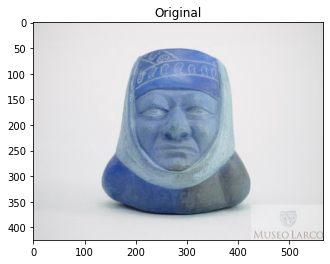

[array([-0.05384353,  0.06104446, -0.02049379, -0.07232901, -0.12568346,
       -0.11053502,  0.01408875, -0.1311734 ,  0.08258243, -0.01084809,
        0.19150946, -0.03764623, -0.19476914, -0.19721243,  0.05970631,
        0.09671925, -0.09850925, -0.15175134, -0.11901852, -0.04397625,
       -0.02307427,  0.00422569, -0.00228857,  0.03500227, -0.07940878,
       -0.24942705, -0.0678236 , -0.05168173,  0.09900048, -0.10225803,
        0.04846423,  0.0716438 , -0.24921131, -0.11073366,  0.04143458,
        0.05851994, -0.07947674, -0.07132013,  0.14758152, -0.03723843,
       -0.19479173, -0.00273585,  0.04422919,  0.23324724,  0.18932176,
        0.00561818,  0.03660162, -0.09619591,  0.10137469, -0.11411832,
        0.01370964,  0.16011073,  0.07467596,  0.0407021 ,  0.00782233,
       -0.07122211,  0.03694887,  0.13702175, -0.21651675,  0.06064717,
        0.12116648, -0.09415591, -0.09004165, -0.12631255,  0.15735725,
        0.03701275, -0.06836311, -0.20901582,  0.16124369, -0.2

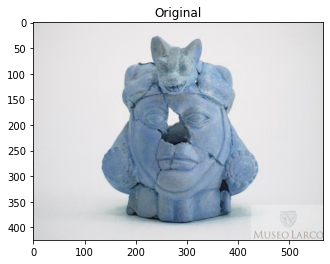

[] sino []
[INFO] processing image 293/310
drive/My Drive/huacos/validimages/sifaces/ML000320a.jpg


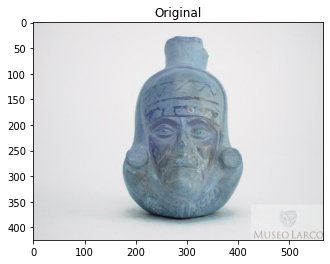

[array([-0.0919846 ,  0.04921174,  0.01901386, -0.05263526, -0.14426632,
       -0.05608624,  0.03459816, -0.05677042,  0.16668281, -0.02025832,
        0.08739904,  0.05474425, -0.18313424, -0.07296078, -0.03975732,
        0.06955591, -0.12118684, -0.06914138, -0.09804966, -0.11146291,
        0.03976816,  0.09970052,  0.09054607, -0.01543772, -0.09356374,
       -0.25937447, -0.08942892, -0.05298957,  0.03780315, -0.16527286,
        0.04973095,  0.00874901, -0.3043189 , -0.11663014, -0.00277352,
        0.05506943, -0.08130957, -0.08069884,  0.24617404,  0.03892216,
       -0.16341694,  0.08697027,  0.08095513,  0.21462758,  0.18307182,
       -0.09009264, -0.02569778, -0.07128306,  0.1502862 , -0.22139329,
        0.08673821,  0.18076602,  0.12021084,  0.0510989 ,  0.01834817,
       -0.04295865,  0.00948988,  0.18322876, -0.20036502,  0.10538445,
        0.11339851, -0.09474654, -0.07215647, -0.01621852,  0.14111757,
        0.12623838, -0.08626278, -0.19853783,  0.12474646, -0.1

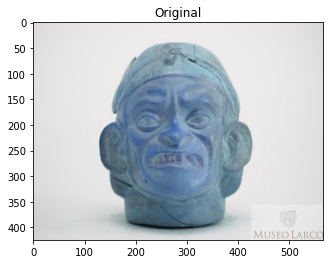

[array([-0.08684075,  0.04040704,  0.00105083, -0.07755804, -0.08802836,
       -0.07089676, -0.01109856, -0.11881835,  0.13990913, -0.1031877 ,
        0.1241131 ,  0.03704639, -0.21284145, -0.09577854, -0.01182129,
        0.0952763 , -0.11511011, -0.10237706, -0.10857011, -0.14008342,
       -0.015994  ,  0.0626194 ,  0.08147696,  0.01610022, -0.06287357,
       -0.2174643 , -0.12363049, -0.00789972,  0.06852752, -0.0587199 ,
        0.04058569,  0.0878169 , -0.2534669 , -0.08684397,  0.02295917,
        0.0570322 , -0.08756477, -0.05130822,  0.24903798,  0.04490353,
       -0.15198728, -0.01035095,  0.12221789,  0.23718625,  0.18214864,
       -0.05199814, -0.02884064,  0.01480132,  0.10810901, -0.19905907,
       -0.02667123,  0.18585418,  0.20544648,  0.07300907,  0.00597446,
       -0.08463973,  0.04126106,  0.18757704, -0.18240523,  0.09655605,
        0.04600755, -0.20108284, -0.0475569 ,  0.0087717 ,  0.16908629,
        0.10225301, -0.09874646, -0.17595246,  0.16075116, -0.1

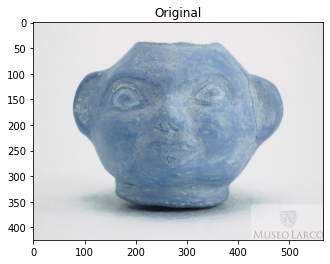

[] sino []
[INFO] processing image 296/310
drive/My Drive/huacos/validimages/sifaces/ML000323a.jpg


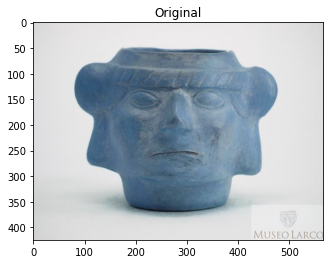

[array([-0.0647188 ,  0.08859327, -0.01499321, -0.02960077, -0.17595993,
       -0.07763246, -0.04570291, -0.06598073,  0.09503034, -0.03036082,
        0.15277687,  0.02914942, -0.21007255, -0.07001185, -0.06086401,
        0.10957089, -0.10154416, -0.06375386, -0.14672953, -0.16075245,
        0.01499331,  0.01811886,  0.02153259,  0.00060068, -0.16537829,
       -0.17632701, -0.0684064 , -0.07433498,  0.04351776, -0.10961513,
        0.06561301,  0.03486774, -0.2531755 , -0.06311144,  0.00880735,
        0.0601886 , -0.06894417, -0.09694548,  0.25891718, -0.01490874,
       -0.12118073,  0.097063  ,  0.05345296,  0.18227927,  0.2066977 ,
       -0.10117109,  0.04781573, -0.05845746,  0.15001743, -0.22842488,
       -0.01919536,  0.19769667,  0.0820662 ,  0.03168762,  0.03270696,
       -0.0442313 ,  0.0205241 ,  0.19995542, -0.18422148,  0.0829082 ,
        0.02985904, -0.16111401, -0.1265576 , -0.06794652,  0.11905882,
        0.09057178, -0.066689  , -0.19473569,  0.22043337, -0.1

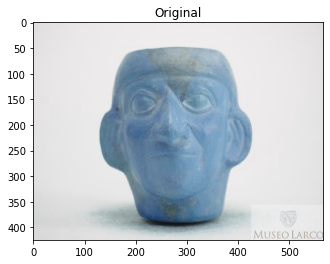

[array([-0.09190424,  0.00501723,  0.00170602,  0.01848432, -0.10510053,
       -0.07561736,  0.01394016, -0.09803893,  0.12647888, -0.08041483,
        0.09438363, -0.00663876, -0.18255061, -0.08211932,  0.05186887,
        0.10734728, -0.09142538, -0.0850933 , -0.16968556, -0.132973  ,
        0.03766015,  0.07717018,  0.06871308, -0.0034332 , -0.16977082,
       -0.25704247, -0.05617383, -0.02125835,  0.08871567, -0.06075056,
       -0.01803909, -0.01903144, -0.31317651, -0.09562589,  0.05328955,
        0.07730868, -0.06517688, -0.04635506,  0.19571523,  0.01821216,
       -0.19417909,  0.03778638,  0.03096122,  0.18322816,  0.17650774,
       -0.04671796, -0.01860693, -0.08255294,  0.11296711, -0.20650153,
        0.0330056 ,  0.13568135,  0.12021793,  0.04258425,  0.02985415,
       -0.05042028, -0.01242881,  0.19290739, -0.16111498,  0.09176528,
        0.10140482, -0.11930364, -0.06856602, -0.06950419,  0.13282961,
        0.06907284, -0.08616473, -0.1802288 ,  0.13182123, -0.1

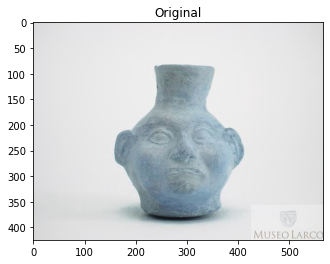

[array([-0.06427164,  0.08353379, -0.00360376, -0.03377769, -0.07806914,
       -0.07357967, -0.02293576, -0.09913582,  0.12784663, -0.03048801,
        0.16798121, -0.07739323, -0.24429417, -0.05867595,  0.00612664,
        0.10981381, -0.18168175, -0.00579538, -0.10623816, -0.14259285,
        0.12913603,  0.06711711,  0.01916193, -0.02238053, -0.10989275,
       -0.25446802, -0.07278108, -0.02127884,  0.06115226, -0.06389142,
        0.05897933,  0.07170452, -0.23413882, -0.05351304,  0.04473294,
        0.12450863, -0.05882434, -0.07977961,  0.19803359,  0.00571917,
       -0.13223645,  0.01640125,  0.08425236,  0.17549777,  0.20922811,
       -0.0311487 , -0.00931838, -0.10414331,  0.11191432, -0.17753702,
       -0.00415606,  0.2160473 ,  0.16132087,  0.07099765,  0.07485519,
       -0.05415809,  0.03781727,  0.16450119, -0.18500598,  0.01391225,
        0.12277156, -0.13037527, -0.05201682, -0.07266539,  0.12006979,
        0.07245968, -0.06425381, -0.16675788,  0.18058252, -0.1

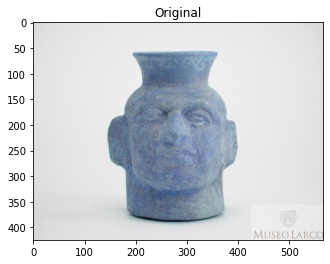

[array([-0.13629189,  0.04204132, -0.0135957 , -0.04200692, -0.15757746,
       -0.0459758 ,  0.00892686, -0.04255821,  0.13539973, -0.02086715,
        0.15435012, -0.0045239 , -0.19231848, -0.08522487, -0.03198109,
        0.13985234, -0.06421787, -0.05186372, -0.19191253, -0.15399939,
       -0.02493009,  0.04653537, -0.00759797,  0.03461618, -0.11589012,
       -0.19364092, -0.02954534, -0.03576895,  0.03684774, -0.12193677,
        0.09457876,  0.00660109, -0.31188291, -0.1331211 ,  0.01924387,
        0.05907937, -0.02981808, -0.01897726,  0.18483932, -0.02692999,
       -0.13482912,  0.0719474 ,  0.10002211,  0.25358915,  0.17791457,
       -0.01070923,  0.00273774, -0.05400989,  0.14525811, -0.26937097,
        0.00438277,  0.08766884,  0.13748631,  0.01982508,  0.06384481,
       -0.0545087 ,  0.00403595,  0.20346585, -0.18854122,  0.12335575,
        0.05776716, -0.08423534, -0.10802943, -0.10937854,  0.19494349,
        0.05758238, -0.09324029, -0.1688146 ,  0.19488952, -0.1

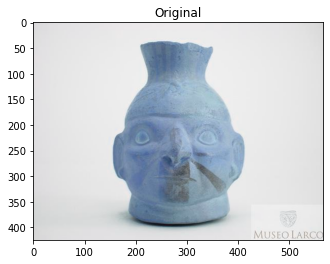

[] sino []
[INFO] processing image 301/310
drive/My Drive/huacos/validimages/sifaces/ML000341a.jpg


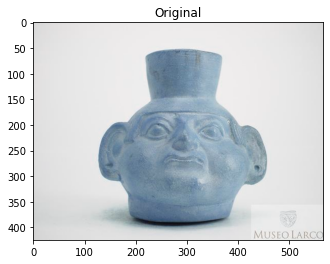

[] sino []
[INFO] processing image 302/310
drive/My Drive/huacos/validimages/sifaces/ML000342a.jpg


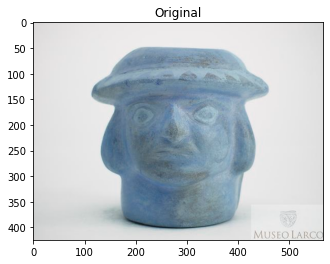

[] sino []
[INFO] processing image 303/310
drive/My Drive/huacos/validimages/sifaces/ML000343a.jpg


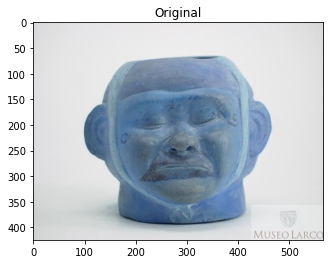

[array([-0.06971546,  0.07355771,  0.08626379, -0.05102177, -0.10770605,
       -0.07683914,  0.05149141, -0.04174495,  0.12676893, -0.06172504,
        0.20468052, -0.0462638 , -0.2525517 , -0.10883055,  0.03879958,
        0.12815961, -0.12609488, -0.13082834, -0.07017101, -0.11856556,
        0.03046225,  0.03277328,  0.0337625 , -0.02819688, -0.06804919,
       -0.29362202, -0.06701673, -0.05653513,  0.01752084, -0.0846259 ,
        0.0556889 ,  0.06686807, -0.19311076, -0.06459268, -0.0359209 ,
        0.07075687, -0.09409501, -0.09780171,  0.12879086, -0.01414999,
       -0.15885466, -0.022803  ,  0.04889192,  0.23695922,  0.23239696,
        0.01566181,  0.01052435, -0.07778952,  0.08423142, -0.21256259,
        0.00890504,  0.15574127,  0.16361709,  0.07851604,  0.01296051,
       -0.03130656,  0.04555105,  0.11851516, -0.18069559,  0.05406315,
        0.1022073 , -0.11639657,  0.01797328, -0.07493342,  0.21341342,
        0.03861378, -0.07600748, -0.0945803 ,  0.18444794, -0.1

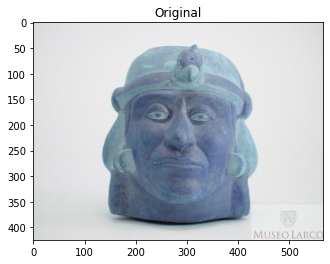

[array([-3.75690758e-02,  7.78547972e-02, -4.58547473e-03, -7.58493394e-02,
       -1.25747278e-01,  2.58295685e-02,  2.56295763e-02, -1.00720942e-01,
        1.46155119e-01, -5.77645302e-02,  1.54637203e-01, -2.37764418e-03,
       -2.28708312e-01, -5.50082102e-02, -5.66393882e-03,  7.25820214e-02,
       -6.90120608e-02, -6.44387305e-02, -1.53419122e-01, -7.20257834e-02,
        3.82972509e-02,  5.93350083e-03,  3.69673371e-02,  1.45178288e-04,
       -1.12433337e-01, -2.20160902e-01, -6.33021593e-02,  3.11792754e-02,
        4.34177369e-02, -1.28999650e-01,  4.51526046e-02, -6.13829494e-03,
       -2.80275404e-01, -1.02424353e-01, -1.15249604e-02,  3.32585722e-02,
       -1.02935039e-01, -6.08670488e-02,  1.80657208e-01, -6.29059225e-03,
       -1.77580863e-01,  7.00752139e-02,  6.31903708e-02,  1.77025422e-01,
        1.69295102e-01, -2.77627409e-02,  2.30601989e-03, -1.31017789e-01,
        6.93724751e-02, -2.21806154e-01,  4.27861661e-02,  1.61480248e-01,
        1.46618411e-01, 

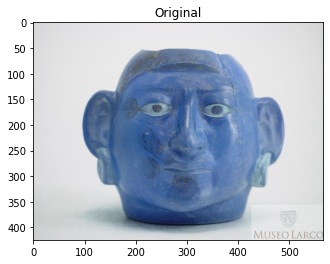

[array([-0.05871311, -0.0241117 , -0.02562295, -0.02806136, -0.13332535,
       -0.08183657,  0.02290413, -0.11770306,  0.10265758, -0.10776487,
        0.10665745, -0.01729973, -0.14201292, -0.06057946,  0.00706206,
        0.11951247, -0.10456412, -0.15704209, -0.14207052, -0.07113405,
        0.01076731,  0.01182867, -0.0050796 ,  0.01378493, -0.09721136,
       -0.22564188, -0.09470117, -0.04864543,  0.07937595, -0.03229515,
        0.00717667, -0.0037444 , -0.21796551, -0.0666988 ,  0.06003701,
        0.06260172, -0.08358471, -0.07189181,  0.14935708, -0.00253072,
       -0.20800111,  0.00116836,  0.05872334,  0.23374429,  0.19159555,
       -0.00755966,  0.031246  , -0.07632795,  0.06540563, -0.181321  ,
        0.03526063,  0.08900896,  0.19722641,  0.05070852,  0.02486911,
       -0.05134364,  0.05533791,  0.14623722, -0.16048723,  0.09261012,
        0.12036166, -0.10620821, -0.03716702, -0.04051983,  0.22283952,
        0.09176534, -0.07101668, -0.18122959,  0.1754335 , -0.2

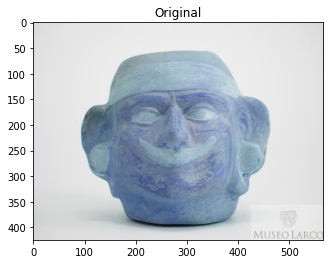

[array([-0.04544643,  0.0449024 ,  0.03221801, -0.08599694, -0.14209007,
       -0.00525732, -0.01509112, -0.07298028,  0.13013874, -0.00261524,
        0.23954579, -0.01069016, -0.19246693, -0.05933629, -0.00459718,
        0.10877801, -0.12540741, -0.08730136, -0.12652718, -0.07774711,
       -0.00651687,  0.05358515,  0.05954255,  0.00593026, -0.11359414,
       -0.20252401, -0.1088798 , -0.07220303,  0.08635516, -0.10560527,
        0.04066394,  0.07090481, -0.25934842, -0.0991365 ,  0.03742454,
        0.07523806, -0.09669564, -0.09261548,  0.20990443, -0.04490333,
       -0.13555524,  0.07125516,  0.06237119,  0.16963764,  0.19878997,
       -0.04373533,  0.04840856, -0.09481957,  0.05926643, -0.24177226,
        0.0391771 ,  0.17360258,  0.14896554,  0.04962201,  0.00876369,
       -0.01574372, -0.02600591,  0.20464572, -0.16427948,  0.09131244,
        0.06695233, -0.12427735, -0.05936288, -0.11570552,  0.14092021,
        0.10294218, -0.07107555, -0.20407322,  0.20900477, -0.1

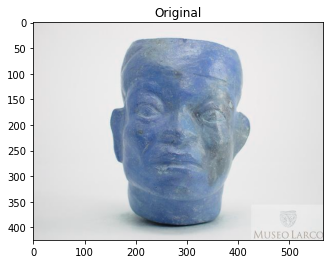

[array([-0.11573663,  0.0762485 ,  0.01021807, -0.06112169, -0.12252569,
       -0.14649951, -0.00159118, -0.13429786,  0.09676103, -0.01940212,
        0.16194119, -0.06340639, -0.2282815 , -0.10818342, -0.01142104,
        0.09488842, -0.14561512, -0.08881678, -0.10472319, -0.10019862,
       -0.00551672, -0.00437023,  0.0350491 ,  0.08379844, -0.03789364,
       -0.22718112, -0.07615211, -0.04555719,  0.02536906, -0.09754525,
        0.02355402,  0.08321473, -0.24408768, -0.09898894, -0.00282433,
        0.04284718, -0.02205278, -0.09909935,  0.17421612, -0.01930603,
       -0.12137274, -0.03493218,  0.02969539,  0.23922643,  0.20395735,
       -0.05649593, -0.0071313 ,  0.0025805 ,  0.06831644, -0.23226264,
       -0.04696775,  0.1597046 ,  0.10496809, -0.03618938,  0.03078046,
       -0.10770645, -0.0211902 ,  0.14290214, -0.14756767,  0.05426699,
        0.00698087, -0.15884793, -0.09172478, -0.09831834,  0.19540332,
        0.14134273, -0.07522528, -0.13593382,  0.2177666 , -0.1

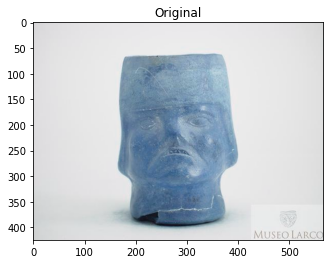

[] sino []
[INFO] processing image 309/310
drive/My Drive/huacos/validimages/sifaces/ML000349a.jpg


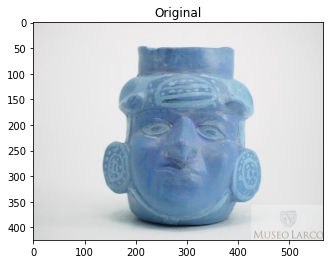

[array([-0.12163498,  0.04528623, -0.05142453, -0.03860899, -0.15984508,
       -0.04326339,  0.04390801, -0.09984836,  0.16328484, -0.06876439,
        0.08499564, -0.03053419, -0.15868136, -0.09171857, -0.01212262,
        0.10112195, -0.08967258, -0.1144608 , -0.16889699, -0.1095452 ,
        0.03318822,  0.01344869,  0.01353801,  0.03375643, -0.14855257,
       -0.24792495, -0.07582363, -0.00941941,  0.05019657, -0.04078739,
        0.09136848,  0.06564321, -0.32164127, -0.09397148,  0.0234554 ,
        0.06848463, -0.07554948, -0.01444881,  0.17473322, -0.00533616,
       -0.18769827,  0.06700116,  0.0588093 ,  0.20730941,  0.18429142,
       -0.00857492, -0.02201487, -0.08722006,  0.09377894, -0.25082421,
        0.01095027,  0.18314941,  0.13031697,  0.02337223,  0.06075396,
       -0.02078795,  0.01707436,  0.14189881, -0.15924087,  0.07514835,
        0.03741394, -0.10220645, -0.09196442, -0.11223309,  0.14431107,
        0.09314323, -0.066343  , -0.1676183 ,  0.1940181 , -0.1

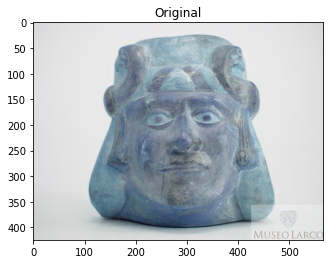

[array([-0.10220793,  0.07268129, -0.00896062,  0.0055463 , -0.1387859 ,
       -0.00628869,  0.03390139, -0.04041123,  0.15721127, -0.10413689,
        0.08187827,  0.02082232, -0.21823291, -0.0863293 ,  0.00735503,
        0.14131987, -0.1173736 , -0.10427122, -0.13053843, -0.13638057,
        0.05296126,  0.09559605,  0.04264153,  0.01190928, -0.10203084,
       -0.25713956, -0.07450017, -0.02572752,  0.04220459, -0.08366403,
        0.04011856, -0.02737723, -0.30593723, -0.09118702,  0.01663326,
        0.04066495, -0.07670987, -0.05647025,  0.17817503,  0.03194956,
       -0.18316922,  0.06606986,  0.0548588 ,  0.20975164,  0.16980895,
       -0.01829222, -0.04951704, -0.09709778,  0.08106679, -0.23830405,
        0.04039652,  0.19787158,  0.12365437,  0.0803325 ,  0.0047328 ,
       -0.05896378,  0.0232063 ,  0.13898262, -0.13719672,  0.06425372,
        0.06171474, -0.089424  , -0.04769276, -0.02705278,  0.12477918,
        0.07947076, -0.05759772, -0.21885937,  0.14845026, -0.2

In [ ]:
import face_recognition
# grab the paths to the input images in our dataset, then initialize
# out data list (which we'll soon populate)
print("[INFO] quantifying faces...")
imagePaths = list(paths.list_images(dataset1))
#imagePaths1 = list(paths.list_images(dataset1))
#imagePaths.extend(imagePaths1)


data = []

# loop over the image paths
for (i, imagePath) in enumerate(imagePaths):
	# load the input image and convert it from RGB (OpenCV ordering)
	# to dlib ordering (RGB)
	print("[INFO] processing image {}/{}".format(i + 1,
		len(imagePaths)))
	print(imagePath)
	imagen = cv2.imread(imagePath)
	#imagecropped = imagen[20:405,103:463]
	#blur = cv2.GaussianBlur(imagecropped, (5, 5), 0)
	image =imagen
	display_one(image)
	rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
		# detect the (x, y)-coordinates of the bounding boxes
	# corresponding to each face in the input image
	boxes = face_recognition.face_locations(rgb,model="cnn")

	# compute the facial embedding for the face
	encodings = face_recognition.face_encodings(rgb, boxes)
	# build a dictionary of the image path, bounding box location,
	# and facial encodings for the current image
	print(encodings, "sino", boxes)
	[print(box,"sera", enc) for (box, enc) in zip(boxes, encodings)]	
	d = [{"imagePath": imagePath, "loc": box, "encoding": enc}
		for (box, enc) in zip(boxes, encodings)]
	data.extend(d)
# dump the facial encodings data to disk
print("[INFO] serializing encodings...")
f = open(embeddings1, "wb")
f.write(pickle.dumps(data))
f.close()

In [ ]:
from sklearn.cluster import DBSCAN
from imutils import build_montages

jobs = 1
# load the serialized face encodings + bounding box locations from
# disk, then extract the set of encodings to so we can cluster on
# them
print("[INFO] loading encodings...")
#print(embeddings)
data = pickle.loads(open(embeddings1, "rb").read())
data = np.array(data)
encodings = [d["encoding"] for d in data]

[INFO] loading encodings...


In [ ]:

# cluster the embeddings
print("[INFO] clustering...")
clt = DBSCAN(metric="euclidean", n_jobs=1)
clt.fit(encodings)
# determine the total number of unique faces found in the dataset
labelIDs = np.unique(clt.labels_)
numUniqueFaces = len(np.where(labelIDs > -1)[0])
print("[INFO] # unique faces: {}".format(numUniqueFaces))


[INFO] clustering...
[INFO] # unique faces: 1


[INFO] faces for face ID: -1


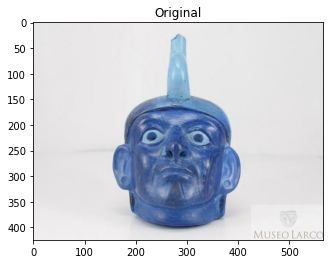

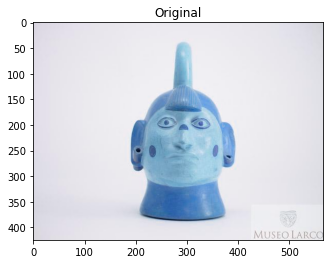

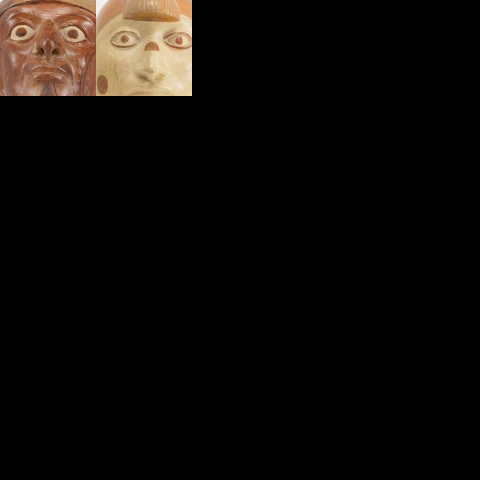

[INFO] faces for face ID: 0


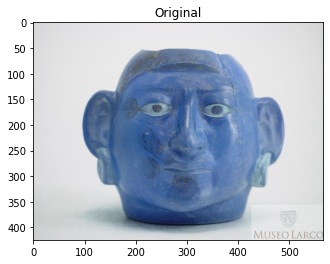

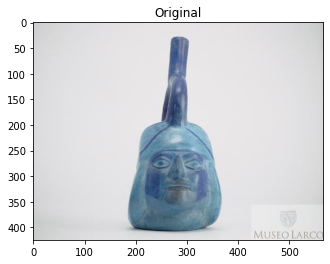

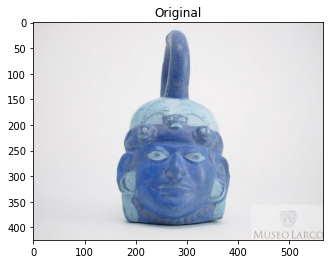

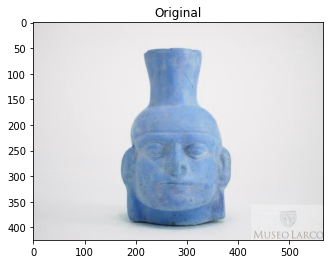

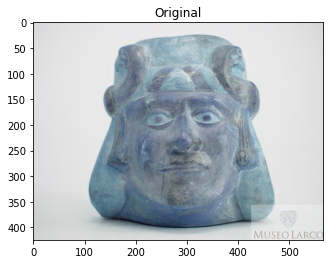

...

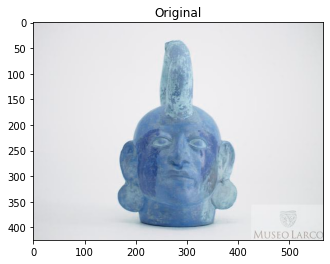

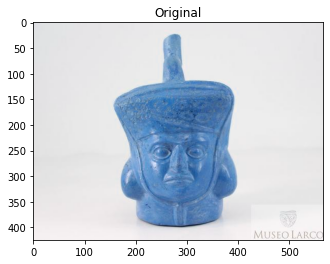

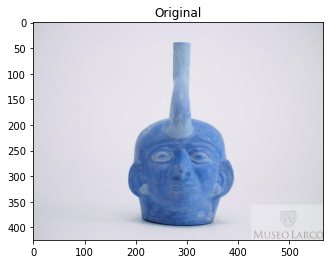

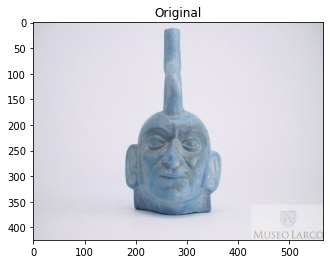

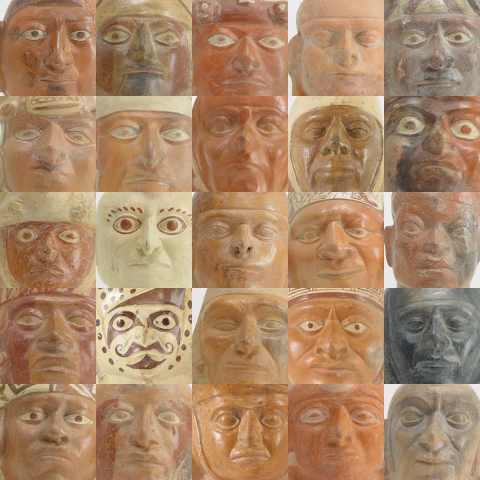

In [ ]:
from google.colab.patches import cv2_imshow
# loop over the unique face integers
for labelID in labelIDs:
	# find all indexes into the `data` array that belong to the
	# current label ID, then randomly sample a maximum of 25 indexes
	# from the set
	print("[INFO] faces for face ID: {}".format(labelID))
	idxs = np.where(clt.labels_ == labelID)[0]
	idxs = np.random.choice(idxs, size=min(25, len(idxs)),
		replace=False)
	# initialize the list of faces to include in the montage
	faces = []
	# loop over the sampled indexes
	for i in idxs:
		# load the input image and extract the face ROI
		image = cv2.imread(data[i]["imagePath"])
		#image = image_temp[20:405,103:463]
		display_one(image)
		(top, right, bottom, left) = data[i]["loc"]
		face = image[top:bottom, left:right]
		# force resize the face ROI to 96x96 and then add it to the
		# faces montage list
		face = cv2.resize(face, (96, 96))
		faces.append(face)
 	# create a montage using 96x96 "tiles" with 5 rows and 5 columns
	montage = build_montages(faces, (96, 96), (5, 5))[0]
	
	# show the output montage
	title = "Face ID #{}".format(labelID)
	title = "Unknown Faces" if labelID == -1 else title
	cv2_imshow(montage)
	cv2.waitKey(0) 